DONE BY:
- AZIZI Walid
- KEBIR Ahmed Rayane

<center><h1>1-ab: Introduction to Neural Networks</h1></center>


In [ ]:
!wget https://github.com/rdfia/rdfia.github.io/raw/master/data/2-ab.zip
!unzip -j 2-ab.zip
!wget https://github.com/rdfia/rdfia.github.io/raw/master/code/2-ab/utils-data.py

In [ ]:
import math
import torch
from torch.autograd import Variable
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%run 'utils-data.py'

# Part 1 : Forward and backward passes "by hands"

In [ ]:
def init_params(nx, nh, ny):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for Wh, Wy, bh, by

    params["Wh"] = torch.normal(mean=0, std=0.3, size=(nh,nx))
    params["Wy"] = torch.normal(mean=0, std=0.3, size=(ny,nh))
    params["bh"] = torch.normal(mean=0, std=0.3, size=(nh))
    params["by"] = torch.normal(mean=0, std=0.3, size=(ny,))

    ####################
    ##      END        #
    ####################
    return params

In [ ]:
import torch

def forward(params, X):
    """
    params: dictionary
    X: (n_batch, dimension)
    """
    bsize = X.size(0)
    nh = params['Wh'].size(0)
    ny = params['Wy'].size(0)
    outputs = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for X, htilde, h, ytilde, yhat

    outputs["X"] = X

    # Compute the linear transformation for hidden layer
    outputs["htilde"] = torch.matmul(X, params['Wh'].T) + params['bh'].unsqueeze(0).expand(bsize, -1)
    outputs["h"] = torch.tanh(outputs["htilde"])  # activation function for hidden layer

    # Compute the linear transformation for output layer
    outputs["ytilde"] = torch.matmul(outputs["h"], params['Wy'].T) + params['by'].unsqueeze(0).expand(bsize, -1)

    # Manually compute softmax
    exp_ytilde = torch.exp(outputs["ytilde"])  # exponentiate each element in ytilde
    sum_exp_ytilde = torch.sum(exp_ytilde, dim=1, keepdim=True)  # sum over classes, keeping dimensions for broadcasting
    outputs["yhat"] = exp_ytilde / sum_exp_ytilde  # normalize by dividing by the sum

    ####################
    ##      END        #
    ####################

    return outputs['yhat'], outputs


In [ ]:
def loss_accuracy(Yhat, Y):
    """
    Computes the loss and accuracy.
    Yhat: predicted output
    Y: true output
    """
    # Cross-entropy loss
    L = -torch.mean(torch.sum(Y * torch.log(Yhat + 1e-12), dim=1))  # Added epsilon for numerical stability
    acc = (torch.argmax(Yhat, dim=1) == torch.argmax(Y, dim=1)).float().mean()

    return L, acc

In [ ]:
import torch

def backward(params, outputs, Y):
    bsize = Y.shape[0]
    grads = {}

    #####################
    ## Your code here  ##
    #####################

    # 1. Compute Δy = Ŷ - Y
    DeltaY = outputs['yhat'] - Y

    # 2. Gradient of Wy: Δy^T * H
    grads["Wy"] = torch.matmul(DeltaY.T, outputs["h"]) / bsize

    # 3. Gradient of by: sum over rows of Δy
    grads["by"] = torch.sum(DeltaY, dim=0) / bsize

    # 4. Compute ΔH = (Δy * Wy) ⊙ (1 - H^2)
    DeltaH = torch.matmul(DeltaY, params["Wy"]) * (1 - outputs["h"].pow(2))

    # 5. Gradient of Wh: ΔH^T * X
    grads["Wh"] = torch.matmul(DeltaH.T, outputs["X"]) / bsize

    # 6. Gradient of bh: sum over rows of ΔH
    grads["bh"] = torch.sum(DeltaH, dim=0) / bsize

    ####################
    ##      END        #
    ####################

    return grads


In [ ]:
def sgd(params, grads, eta):

    #####################
    ## Your code here  ##
    #####################
    # update the params values

    params["Wh"] = params["Wh"] - eta * grads['Wh']
    params["Wy"] = params["Wy"] - eta * grads['Wy']
    params["bh"] = params["bh"] - eta * grads['bh']
    params["by"] = params["by"] - eta * grads['by']

    ####################
    ##      END        #
    ####################
    return params

## Global learning procedure "by hands"

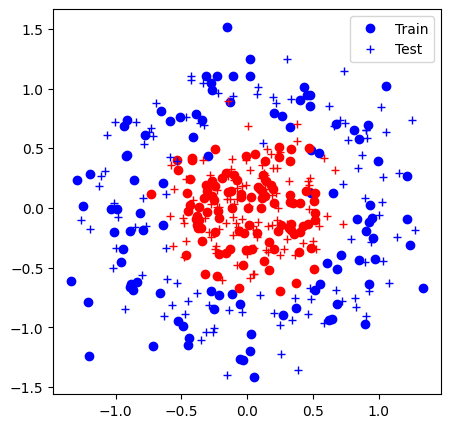

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:1736: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return self._call_impl(*args, **kwargs)


Iter 0: Acc train 0.6% (0.67), acc test 0.6% (0.68)


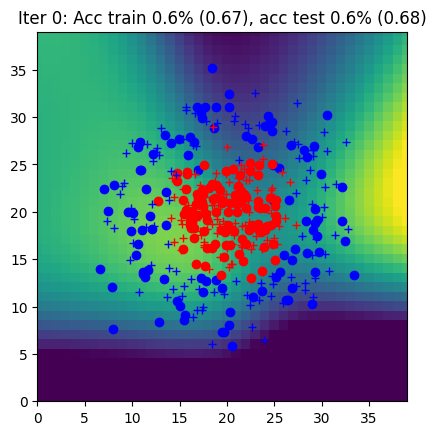

Iter 1: Acc train 0.6% (0.71), acc test 0.6% (0.71)


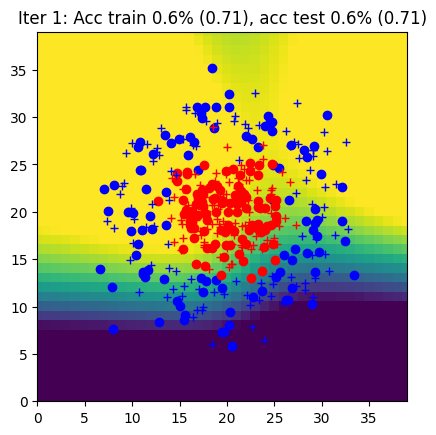

Iter 2: Acc train 0.5% (0.70), acc test 0.5% (0.69)


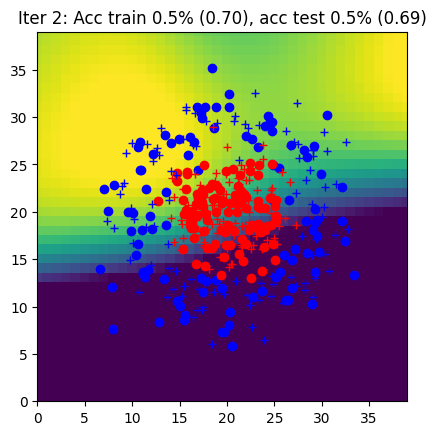

Iter 3: Acc train 0.4% (0.72), acc test 0.4% (0.71)


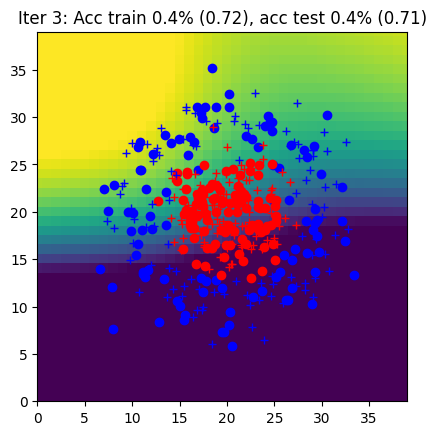

Iter 4: Acc train 0.5% (0.68), acc test 0.5% (0.68)


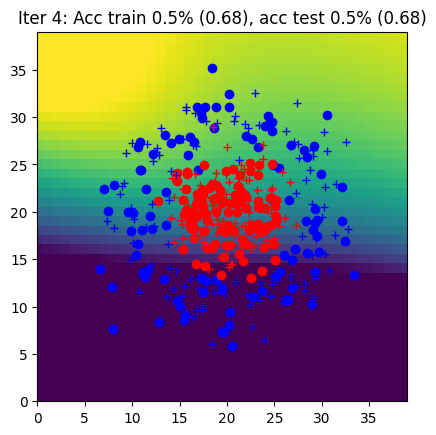

Iter 5: Acc train 0.6% (0.66), acc test 0.6% (0.66)


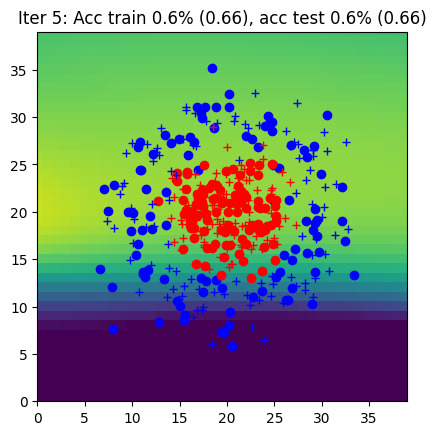

Iter 6: Acc train 0.5% (0.64), acc test 0.5% (0.64)


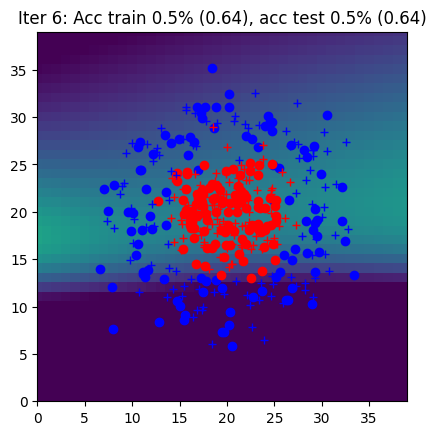

Iter 7: Acc train 0.7% (0.60), acc test 0.7% (0.60)


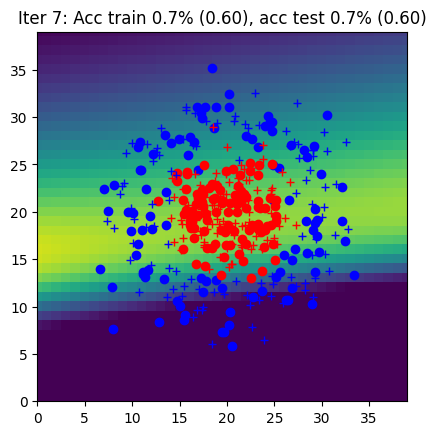

Iter 8: Acc train 0.7% (0.61), acc test 0.7% (0.60)


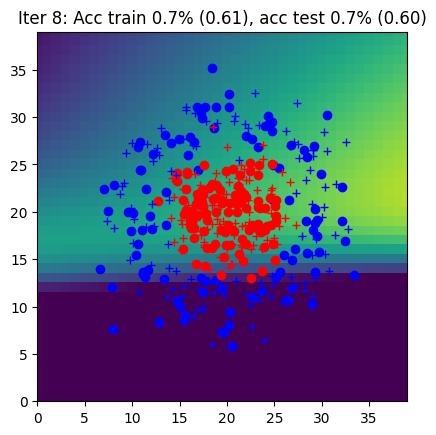

Iter 9: Acc train 0.6% (0.63), acc test 0.6% (0.62)


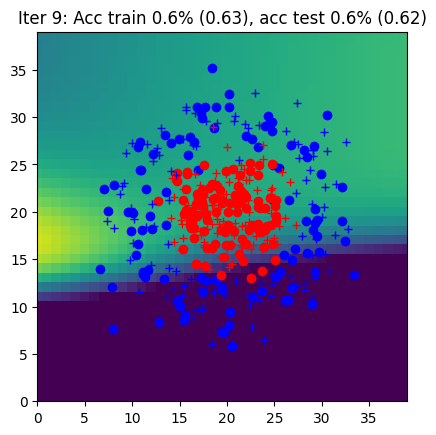

Iter 10: Acc train 0.7% (0.60), acc test 0.7% (0.59)


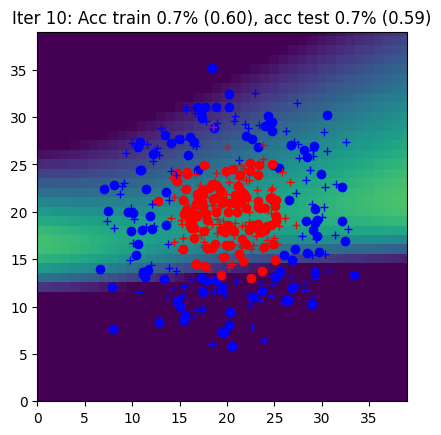

Iter 11: Acc train 0.7% (0.58), acc test 0.8% (0.57)


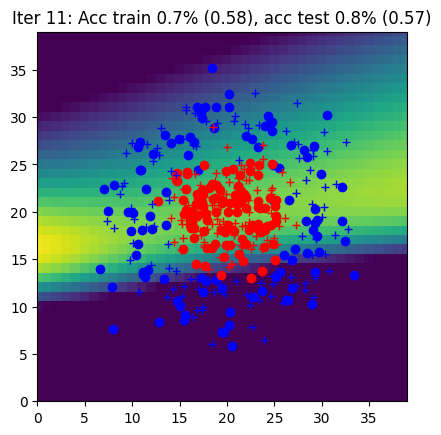

Iter 12: Acc train 0.8% (0.56), acc test 0.8% (0.54)


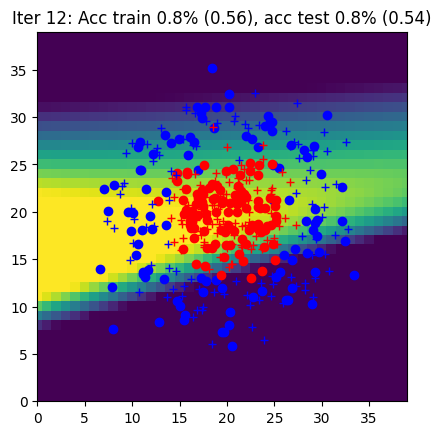

Iter 13: Acc train 0.7% (0.55), acc test 0.8% (0.53)


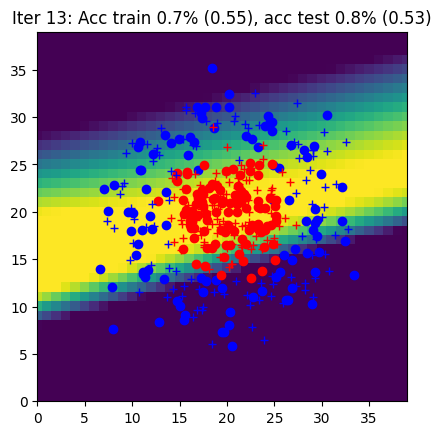

Iter 14: Acc train 0.8% (0.53), acc test 0.8% (0.52)


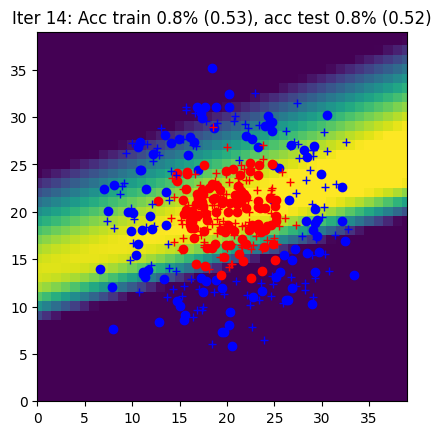

Iter 15: Acc train 0.8% (0.52), acc test 0.8% (0.51)


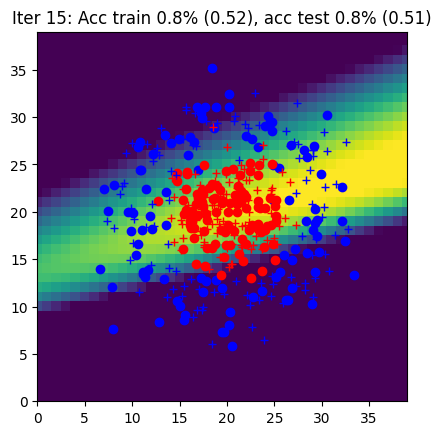

Iter 16: Acc train 0.8% (0.49), acc test 0.8% (0.48)


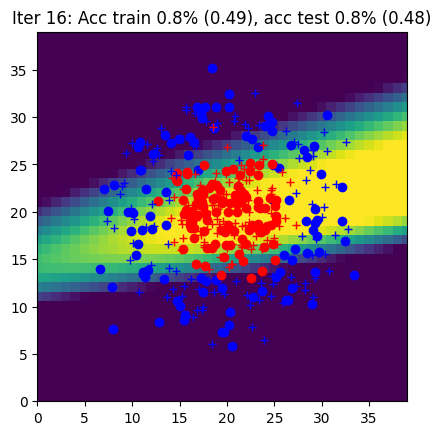

Iter 17: Acc train 0.8% (0.49), acc test 0.8% (0.48)


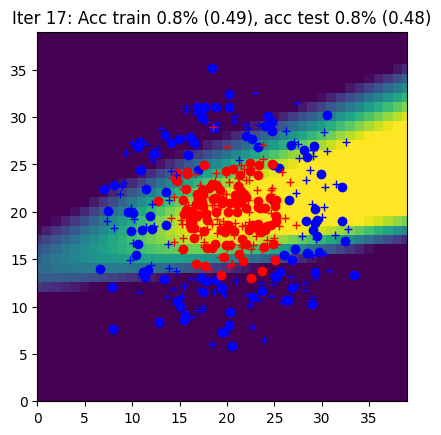

Iter 18: Acc train 0.8% (0.49), acc test 0.8% (0.48)


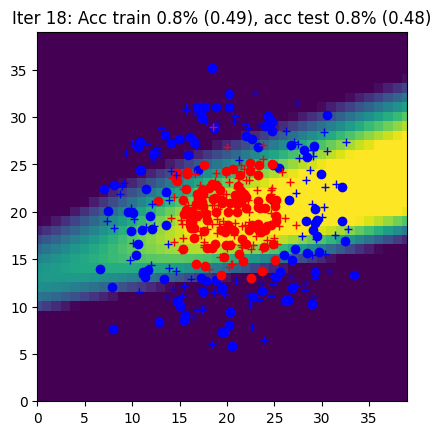

Iter 19: Acc train 0.8% (0.48), acc test 0.8% (0.47)


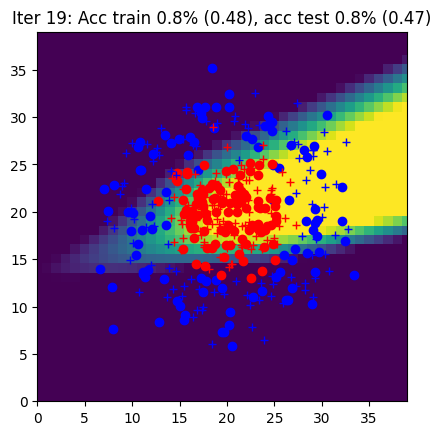

Iter 20: Acc train 0.8% (0.49), acc test 0.8% (0.48)


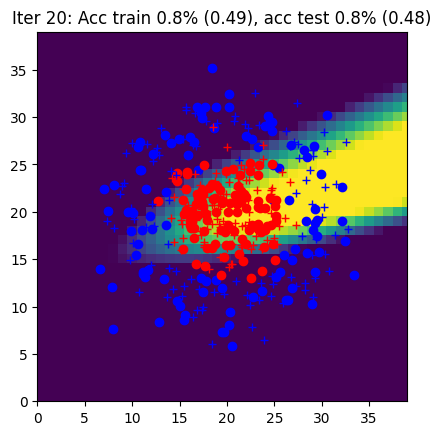

Iter 21: Acc train 0.8% (0.43), acc test 0.8% (0.43)


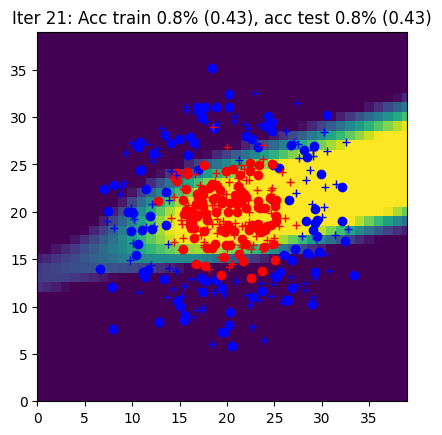

Iter 22: Acc train 0.8% (0.44), acc test 0.8% (0.43)


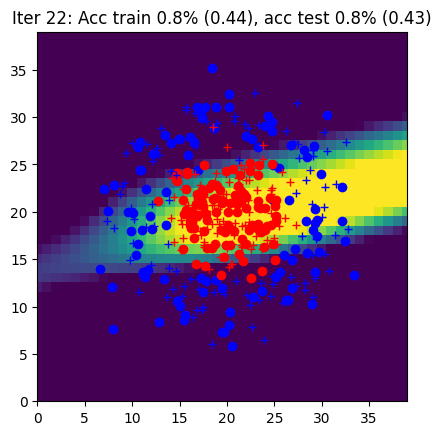

Iter 23: Acc train 0.8% (0.44), acc test 0.8% (0.43)


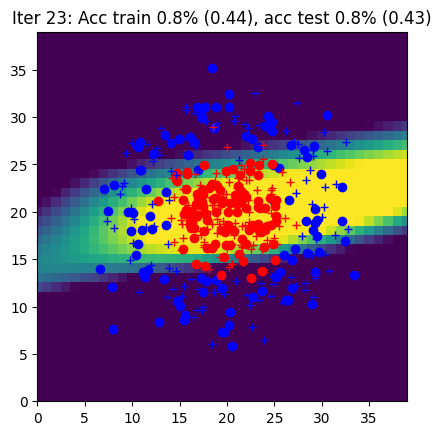

Iter 24: Acc train 0.8% (0.46), acc test 0.8% (0.45)


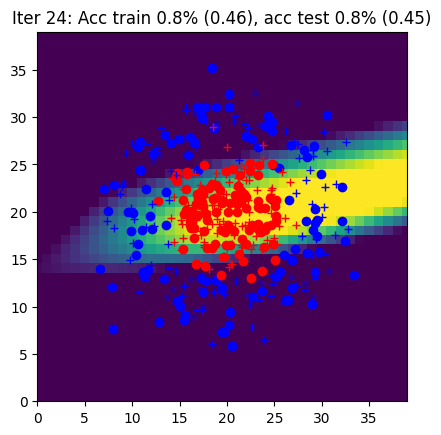

Iter 25: Acc train 0.8% (0.43), acc test 0.8% (0.42)


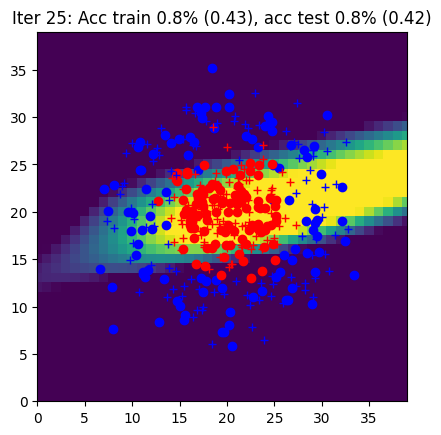

Iter 26: Acc train 0.8% (0.42), acc test 0.8% (0.41)


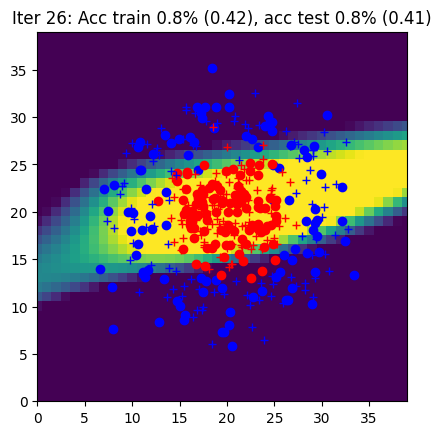

Iter 27: Acc train 0.8% (0.41), acc test 0.8% (0.40)


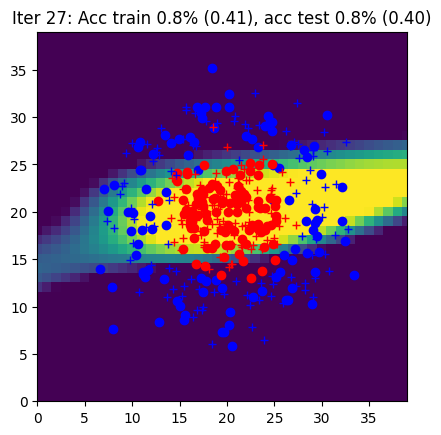

Iter 28: Acc train 0.8% (0.41), acc test 0.8% (0.40)


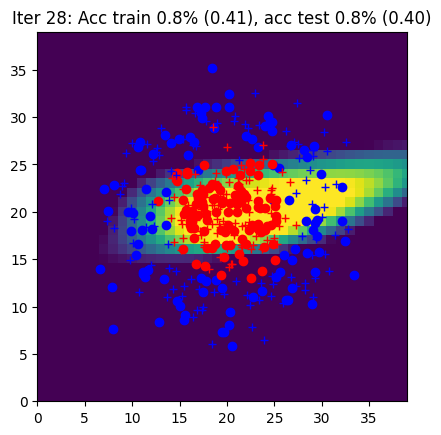

Iter 29: Acc train 0.8% (0.40), acc test 0.9% (0.39)


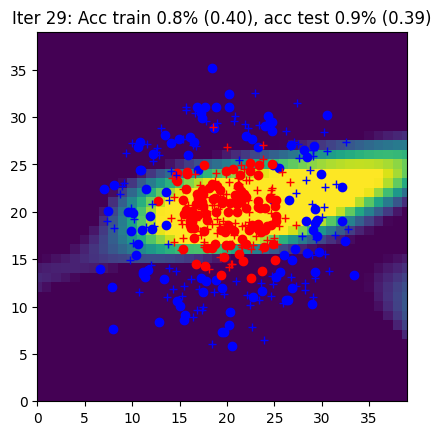

Iter 30: Acc train 0.8% (0.41), acc test 0.9% (0.40)


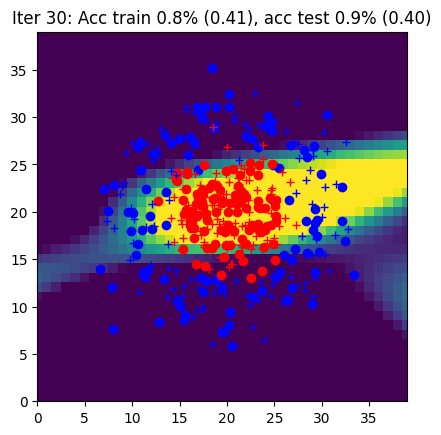

Iter 31: Acc train 0.8% (0.40), acc test 0.8% (0.40)


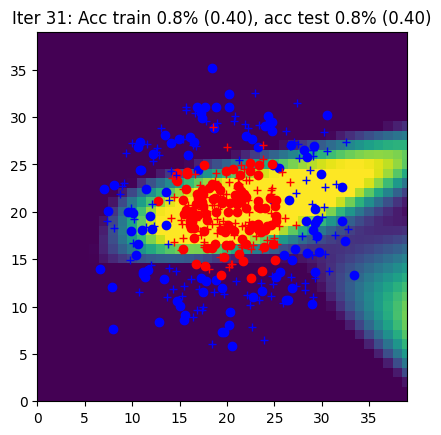

Iter 32: Acc train 0.8% (0.41), acc test 0.8% (0.42)


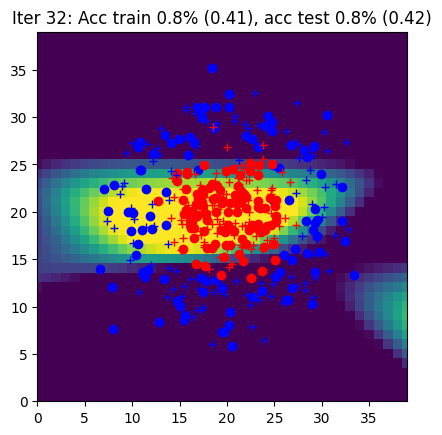

Iter 33: Acc train 0.8% (0.43), acc test 0.8% (0.44)


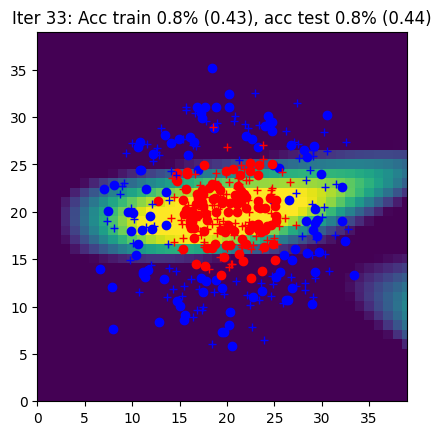

Iter 34: Acc train 0.8% (0.45), acc test 0.8% (0.46)


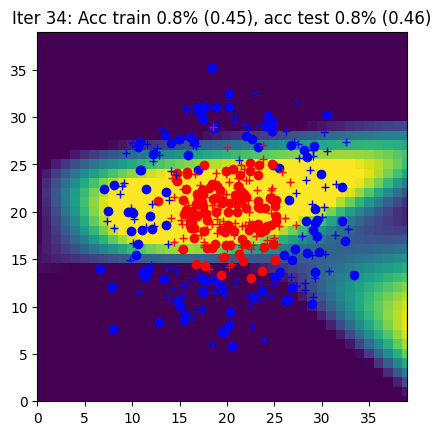

Iter 35: Acc train 0.8% (0.45), acc test 0.8% (0.47)


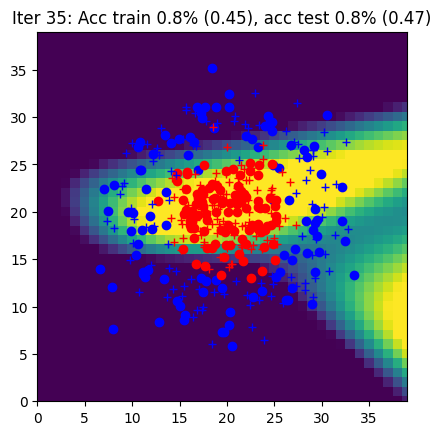

Iter 36: Acc train 0.8% (0.46), acc test 0.8% (0.48)


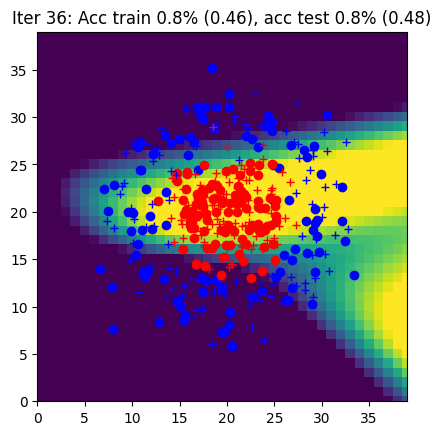

Iter 37: Acc train 0.8% (0.46), acc test 0.8% (0.47)


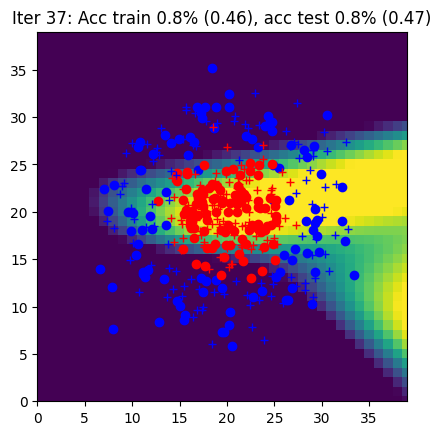

Iter 38: Acc train 0.8% (0.46), acc test 0.8% (0.46)


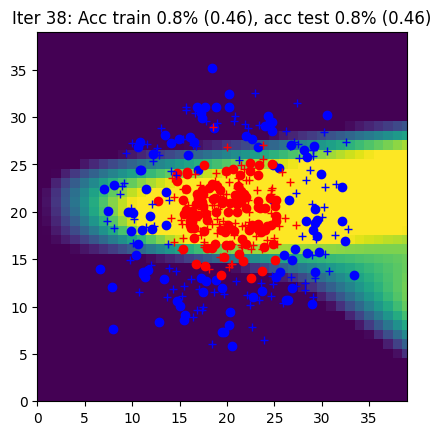

Iter 39: Acc train 0.8% (0.46), acc test 0.8% (0.45)


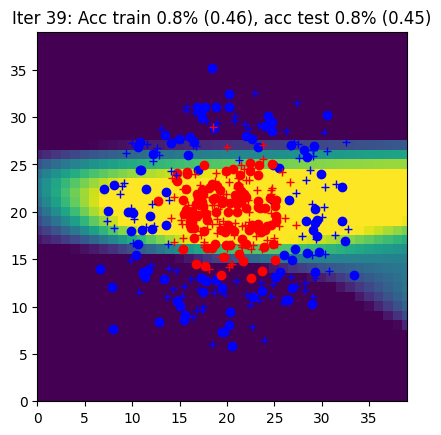

Iter 40: Acc train 0.8% (0.46), acc test 0.8% (0.46)


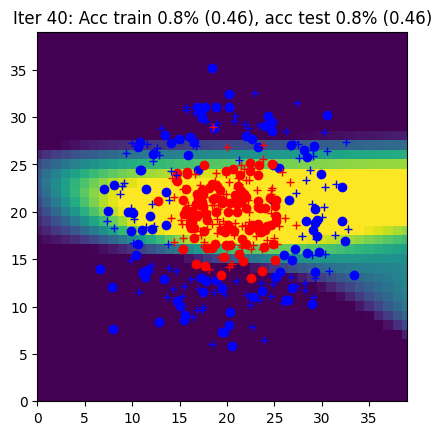

Iter 41: Acc train 0.8% (0.47), acc test 0.8% (0.47)


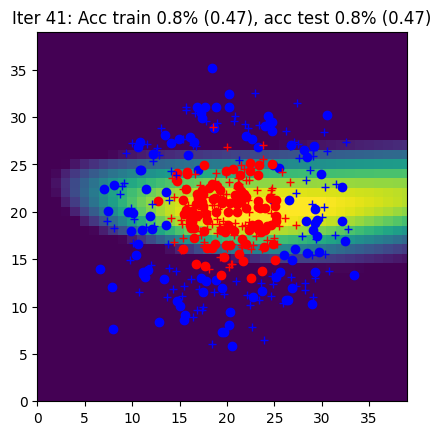

Iter 42: Acc train 0.8% (0.45), acc test 0.8% (0.45)


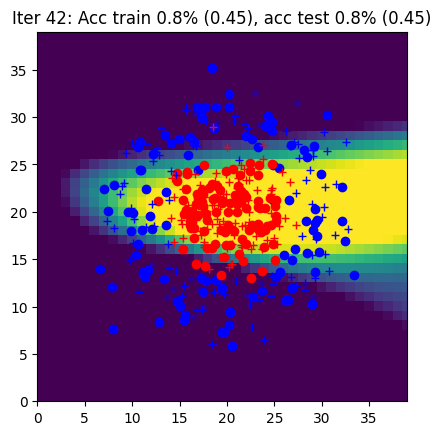

Iter 43: Acc train 0.8% (0.46), acc test 0.8% (0.45)


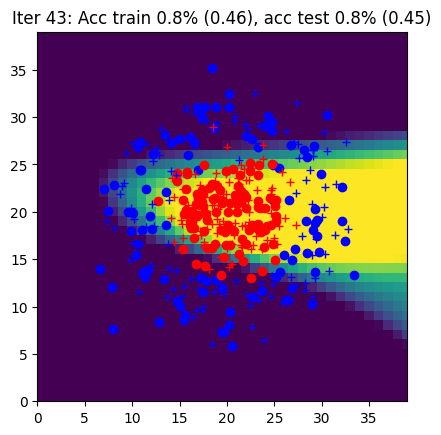

Iter 44: Acc train 0.8% (0.47), acc test 0.8% (0.46)


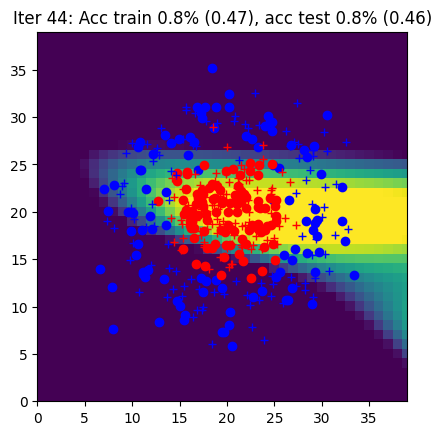

Iter 45: Acc train 0.8% (0.45), acc test 0.8% (0.45)


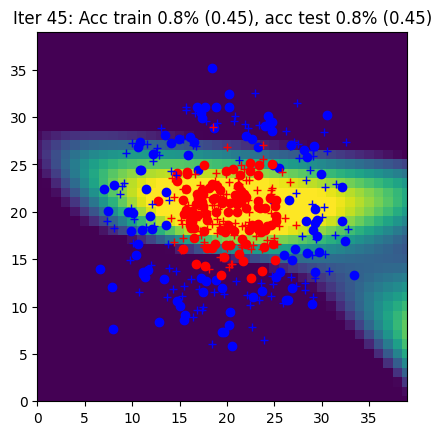

Iter 46: Acc train 0.8% (0.43), acc test 0.8% (0.43)


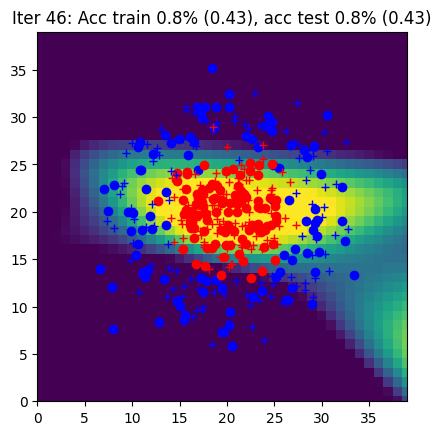

Iter 47: Acc train 0.8% (0.45), acc test 0.8% (0.45)


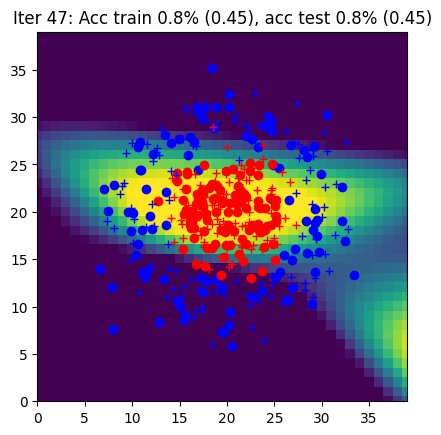

Iter 48: Acc train 0.8% (0.47), acc test 0.8% (0.48)


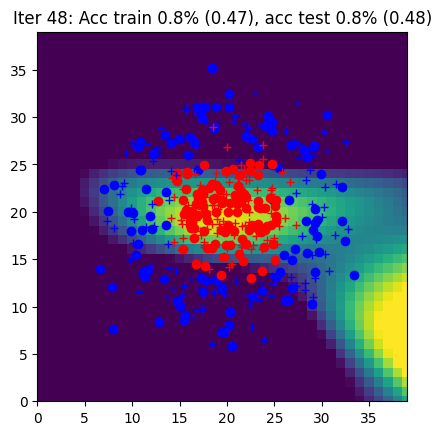

Iter 49: Acc train 0.8% (0.42), acc test 0.8% (0.42)


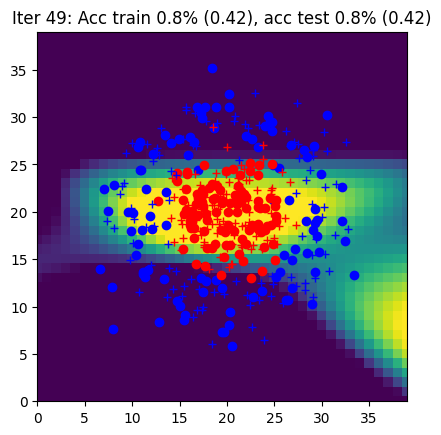

Iter 50: Acc train 0.8% (0.41), acc test 0.8% (0.41)


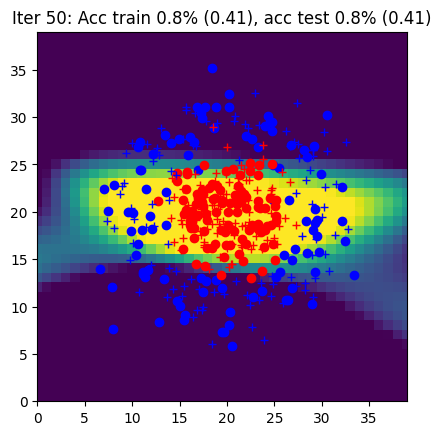

Iter 51: Acc train 0.8% (0.42), acc test 0.8% (0.41)


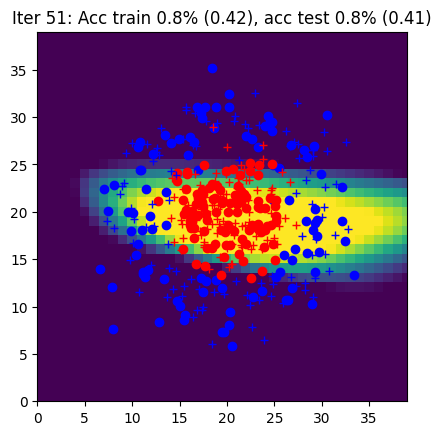

Iter 52: Acc train 0.8% (0.39), acc test 0.8% (0.38)


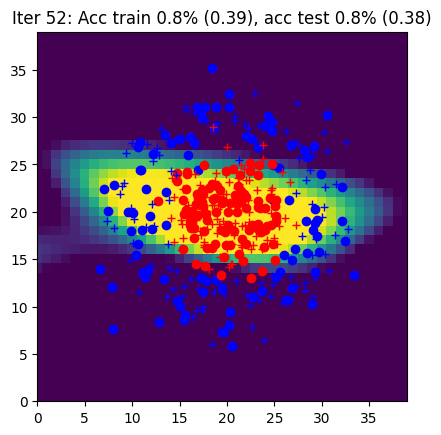

Iter 53: Acc train 0.8% (0.37), acc test 0.8% (0.36)


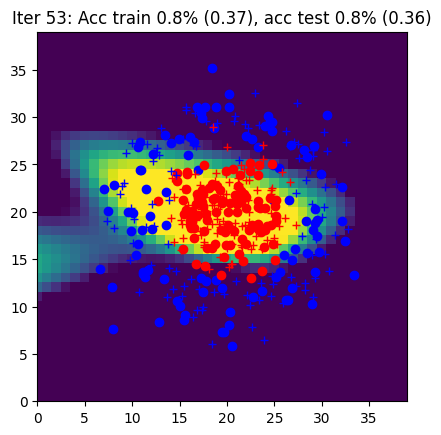

Iter 54: Acc train 0.9% (0.38), acc test 0.9% (0.37)


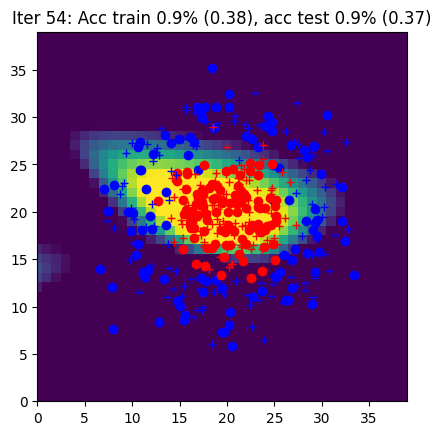

Iter 55: Acc train 0.7% (0.54), acc test 0.7% (0.53)


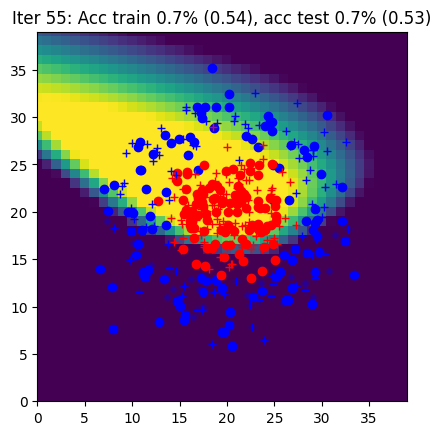

Iter 56: Acc train 0.7% (0.62), acc test 0.7% (0.60)


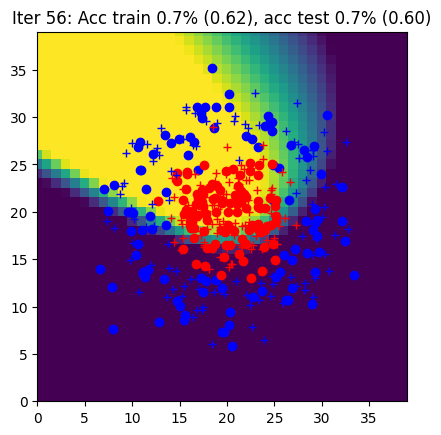

Iter 57: Acc train 0.7% (0.60), acc test 0.7% (0.59)


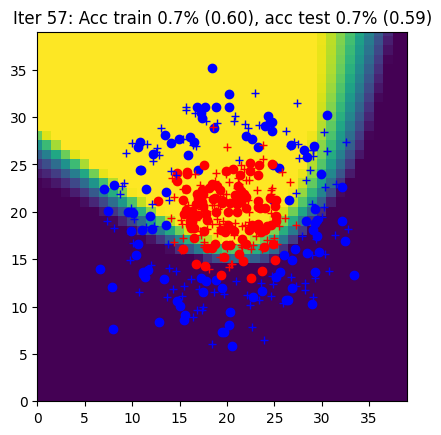

Iter 58: Acc train 0.9% (0.45), acc test 0.9% (0.45)


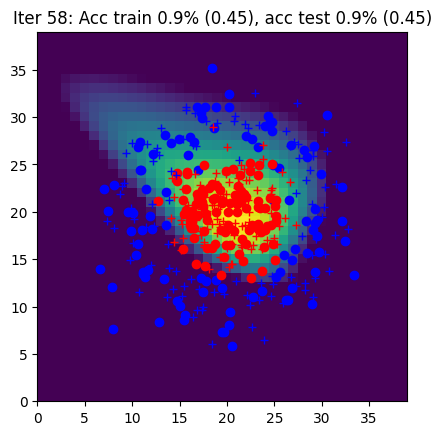

Iter 59: Acc train 0.8% (0.46), acc test 0.8% (0.45)


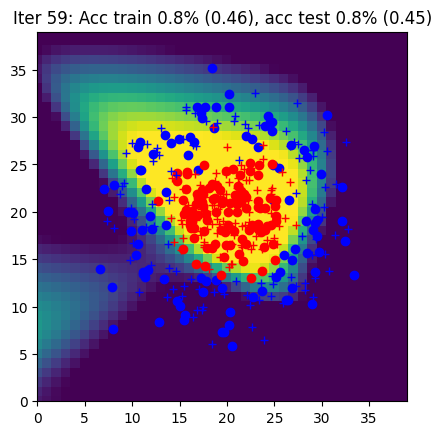

Iter 60: Acc train 0.9% (0.39), acc test 0.9% (0.39)


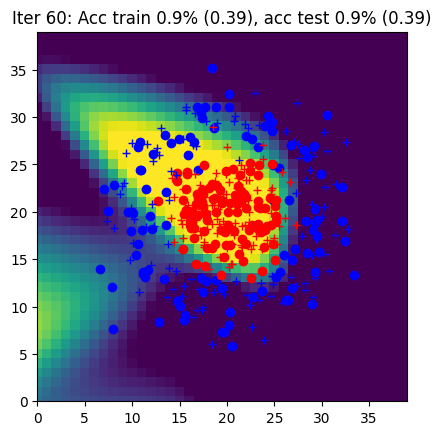

Iter 61: Acc train 0.9% (0.36), acc test 0.9% (0.36)


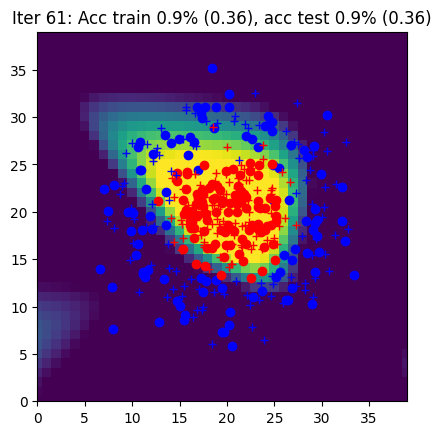

Iter 62: Acc train 0.8% (0.41), acc test 0.8% (0.40)


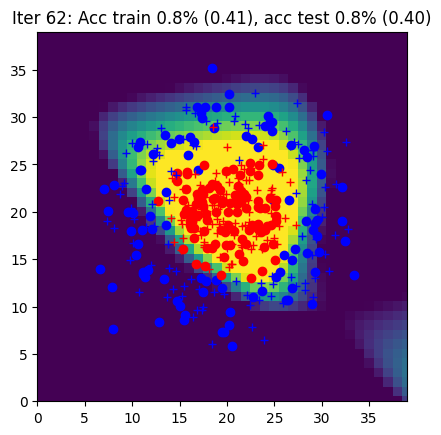

Iter 63: Acc train 0.9% (0.34), acc test 0.9% (0.34)


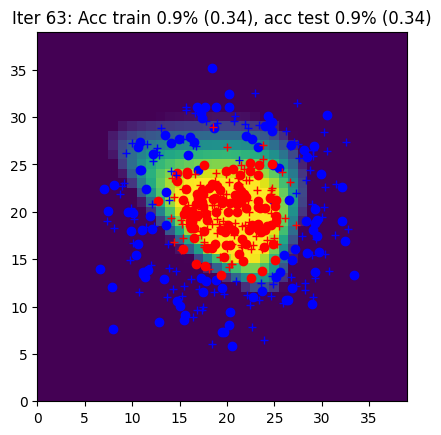

Iter 64: Acc train 0.9% (0.34), acc test 0.9% (0.34)


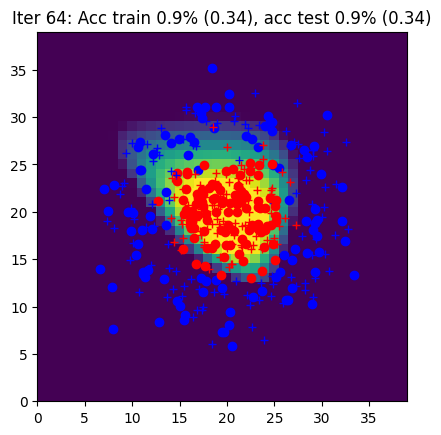

Iter 65: Acc train 0.8% (0.39), acc test 0.8% (0.38)


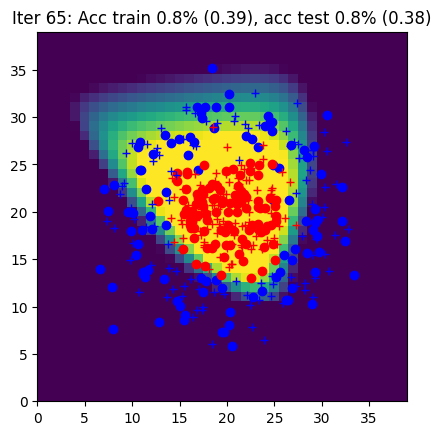

Iter 66: Acc train 0.9% (0.31), acc test 0.9% (0.30)


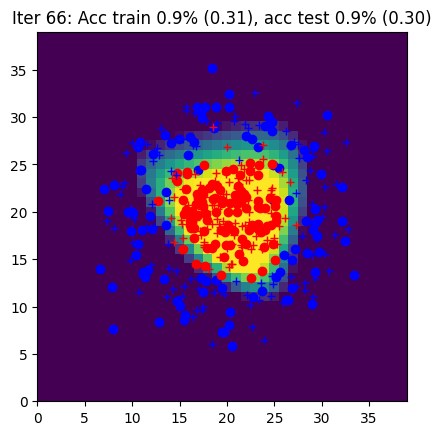

Iter 67: Acc train 0.9% (0.30), acc test 0.9% (0.30)


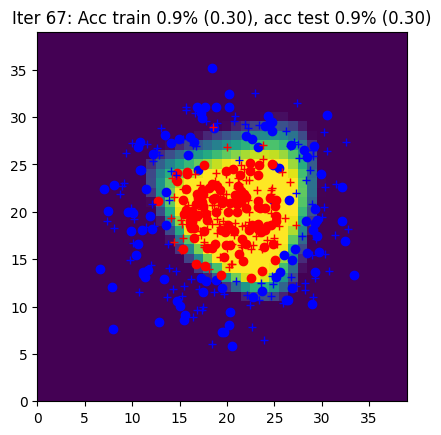

Iter 68: Acc train 0.9% (0.28), acc test 0.9% (0.29)


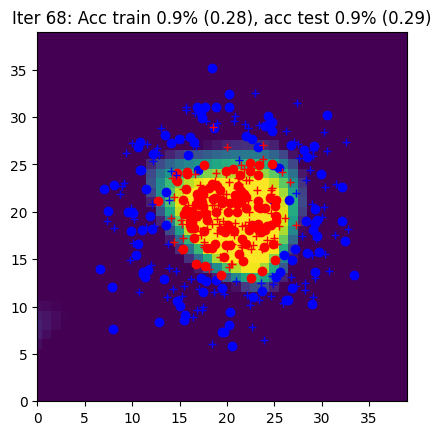

Iter 69: Acc train 0.9% (0.28), acc test 0.9% (0.28)


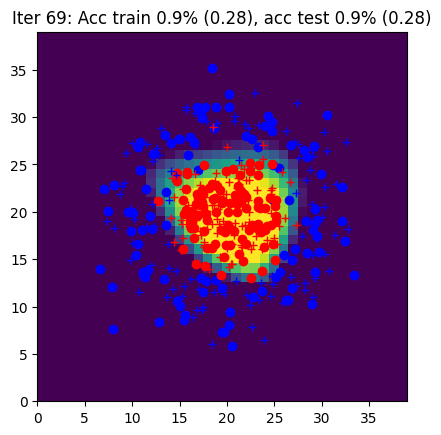

Iter 70: Acc train 0.9% (0.25), acc test 0.9% (0.24)


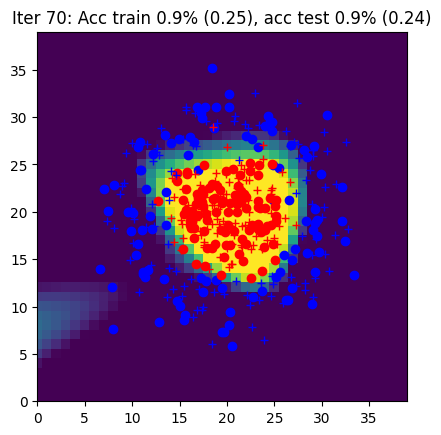

Iter 71: Acc train 0.9% (0.25), acc test 0.9% (0.23)


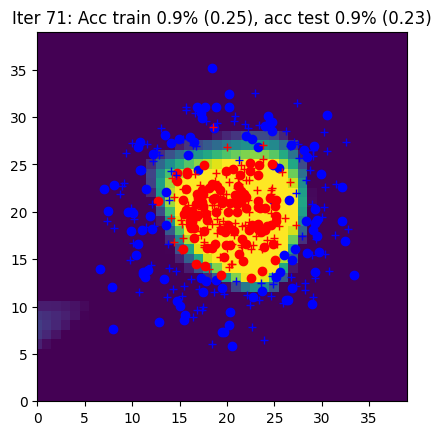

Iter 72: Acc train 0.9% (0.28), acc test 0.9% (0.29)


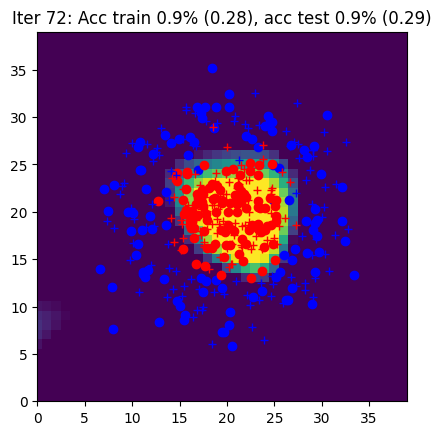

Iter 73: Acc train 0.9% (0.26), acc test 0.9% (0.23)


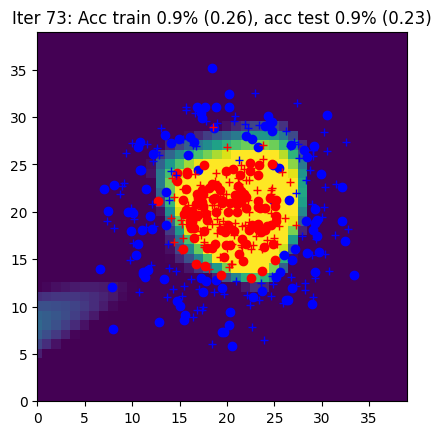

Iter 74: Acc train 0.9% (0.28), acc test 0.9% (0.26)


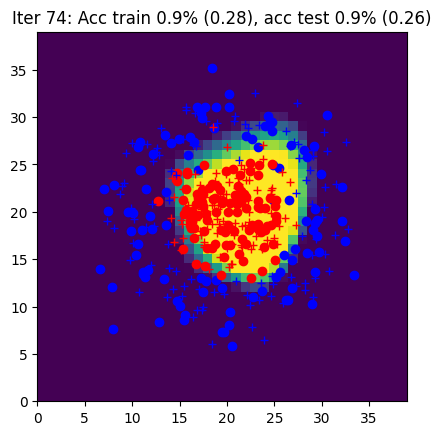

Iter 75: Acc train 0.9% (0.26), acc test 0.9% (0.24)


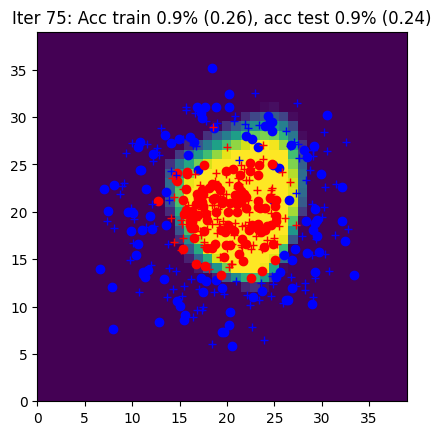

Iter 76: Acc train 0.9% (0.25), acc test 0.9% (0.22)


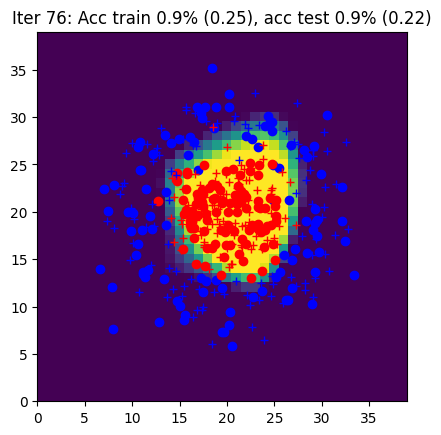

Iter 77: Acc train 0.9% (0.24), acc test 1.0% (0.22)


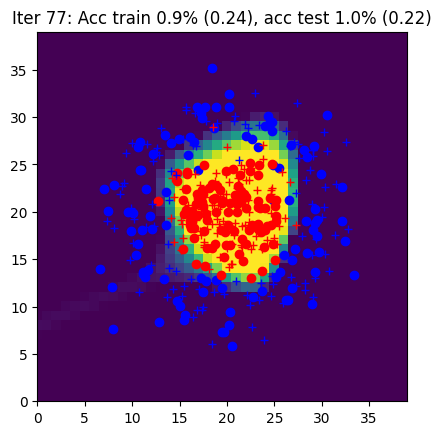

Iter 78: Acc train 0.9% (0.24), acc test 0.9% (0.21)


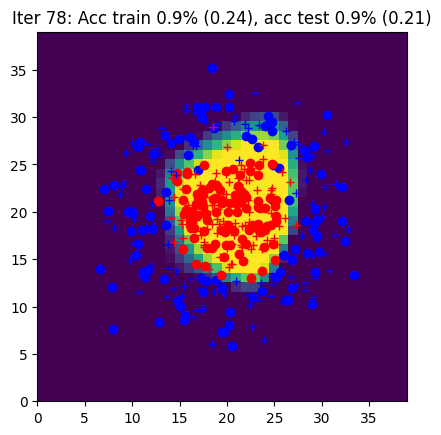

Iter 79: Acc train 0.9% (0.22), acc test 1.0% (0.20)


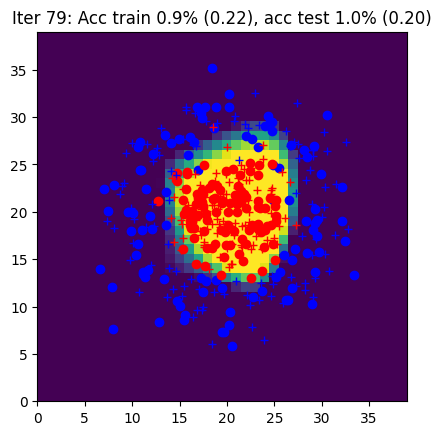

Iter 80: Acc train 0.9% (0.22), acc test 1.0% (0.20)


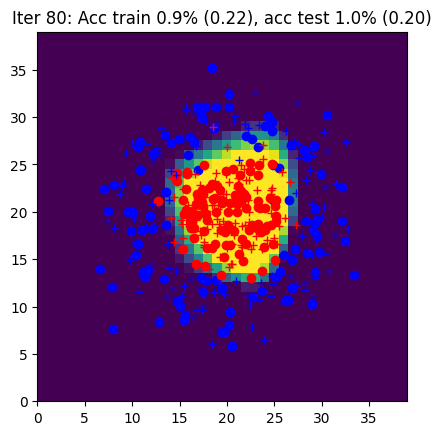

Iter 81: Acc train 0.9% (0.23), acc test 0.9% (0.22)


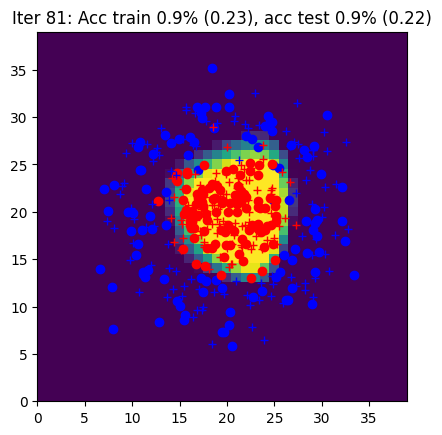

Iter 82: Acc train 0.9% (0.22), acc test 1.0% (0.19)


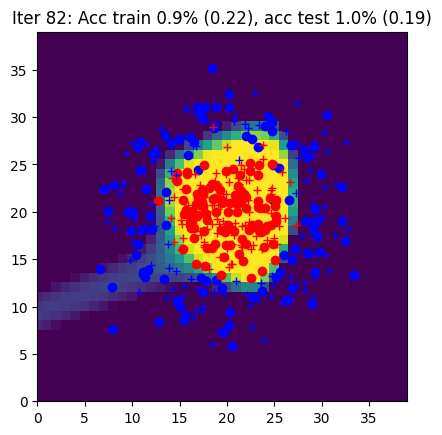

Iter 83: Acc train 1.0% (0.21), acc test 1.0% (0.18)


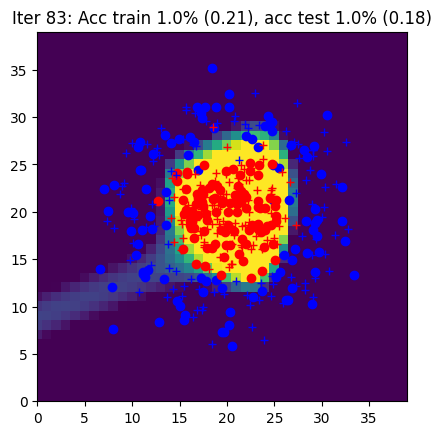

Iter 84: Acc train 1.0% (0.20), acc test 1.0% (0.18)


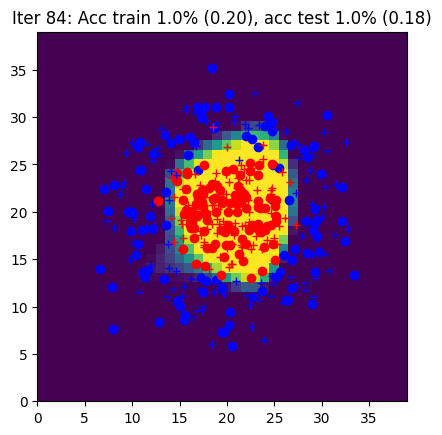

Iter 85: Acc train 0.9% (0.19), acc test 1.0% (0.17)


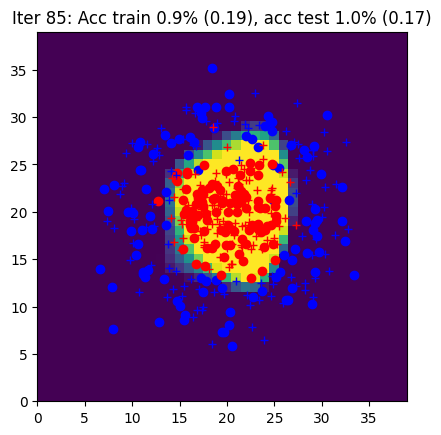

Iter 86: Acc train 0.9% (0.18), acc test 0.9% (0.18)


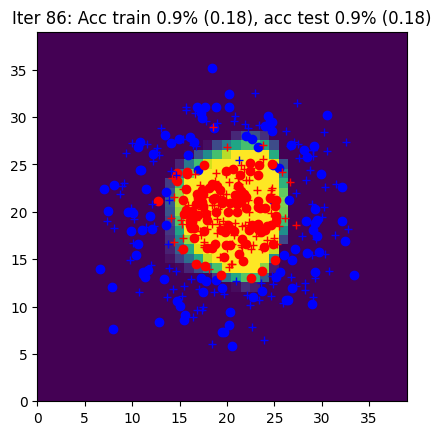

Iter 87: Acc train 0.9% (0.17), acc test 0.9% (0.17)


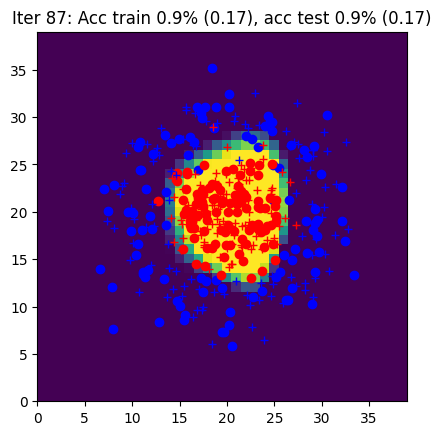

Iter 88: Acc train 0.9% (0.17), acc test 0.9% (0.16)


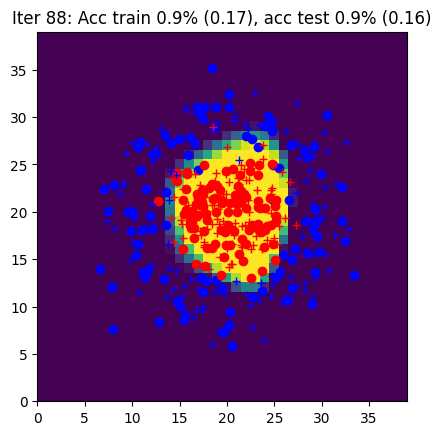

Iter 89: Acc train 0.9% (0.17), acc test 0.9% (0.17)


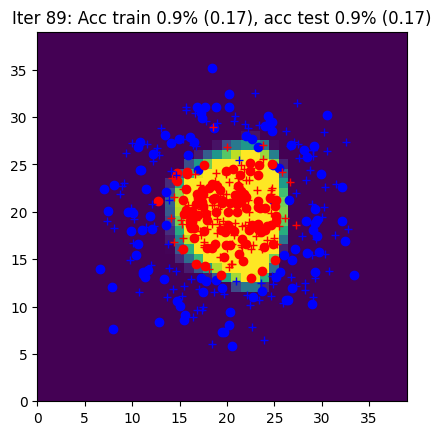

Iter 90: Acc train 1.0% (0.17), acc test 1.0% (0.16)


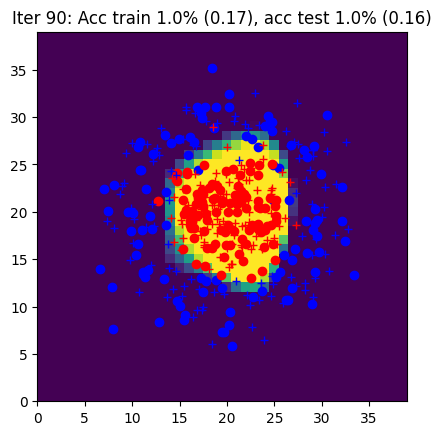

Iter 91: Acc train 1.0% (0.16), acc test 0.9% (0.16)


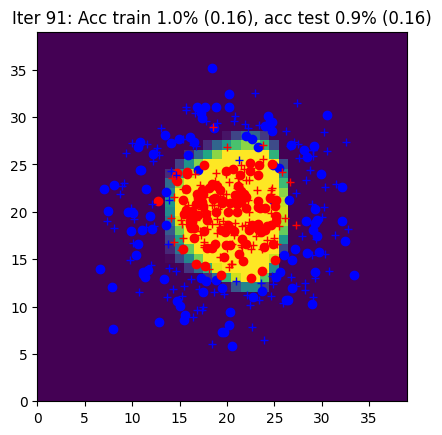

Iter 92: Acc train 1.0% (0.16), acc test 1.0% (0.16)


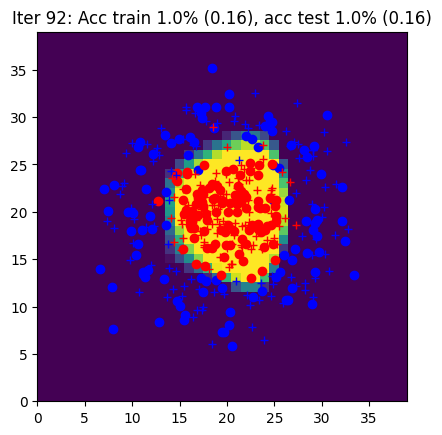

Iter 93: Acc train 0.9% (0.16), acc test 0.9% (0.17)


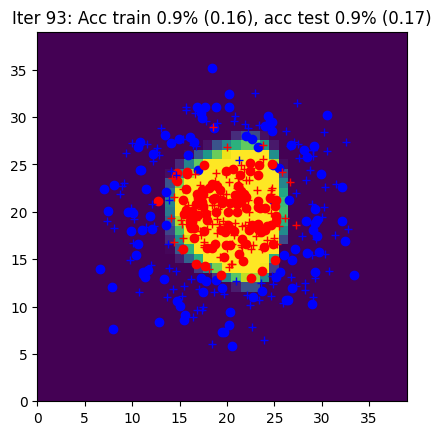

Iter 94: Acc train 0.9% (0.16), acc test 0.9% (0.16)


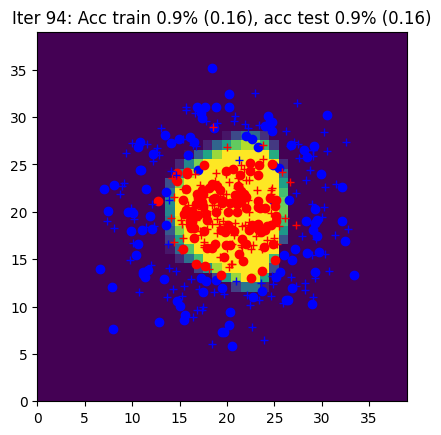

Iter 95: Acc train 1.0% (0.16), acc test 1.0% (0.16)


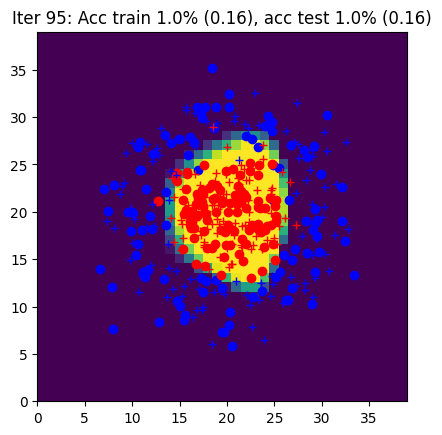

Iter 96: Acc train 0.9% (0.16), acc test 0.9% (0.17)


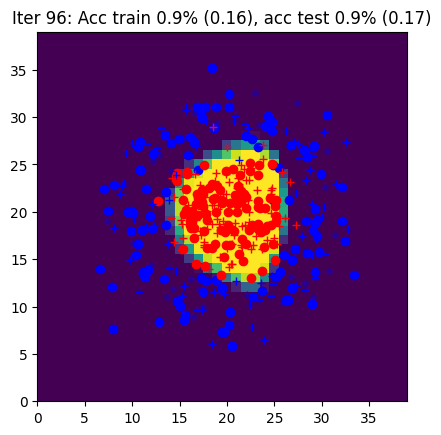

Iter 97: Acc train 0.9% (0.16), acc test 0.9% (0.17)


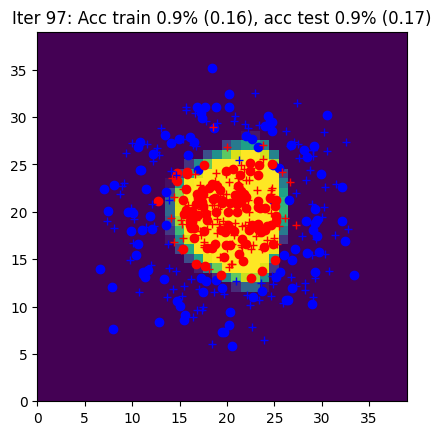

Iter 98: Acc train 1.0% (0.16), acc test 1.0% (0.16)


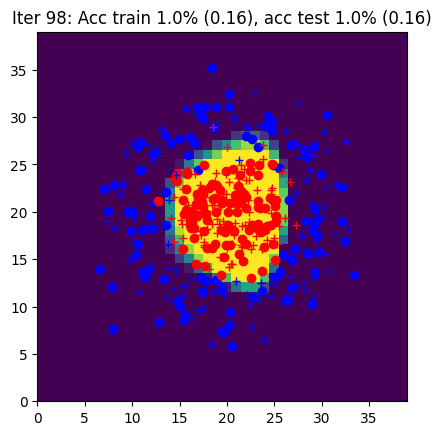

Iter 99: Acc train 0.9% (0.15), acc test 0.9% (0.17)


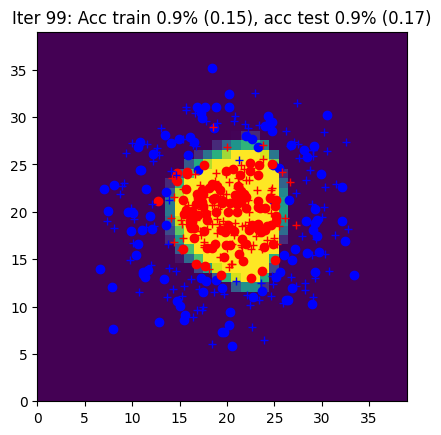

Iter 100: Acc train 1.0% (0.15), acc test 0.9% (0.16)


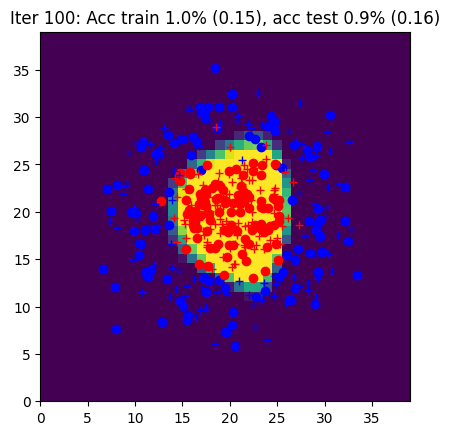

Iter 101: Acc train 1.0% (0.15), acc test 0.9% (0.16)


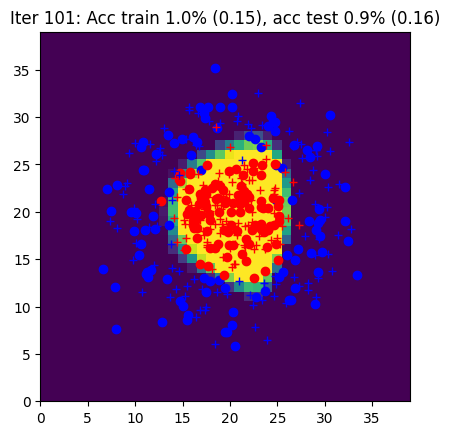

Iter 102: Acc train 1.0% (0.15), acc test 1.0% (0.16)


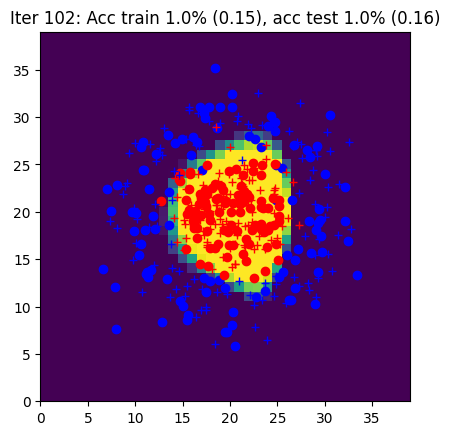

Iter 103: Acc train 1.0% (0.14), acc test 0.9% (0.16)


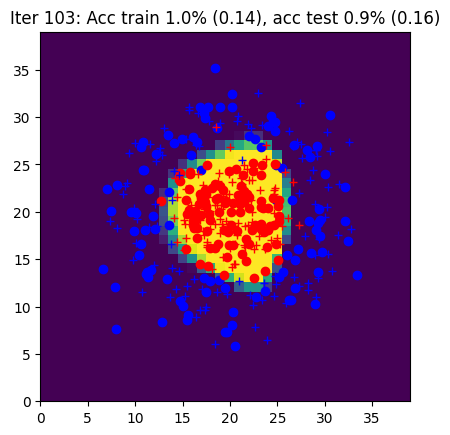

Iter 104: Acc train 1.0% (0.14), acc test 0.9% (0.16)


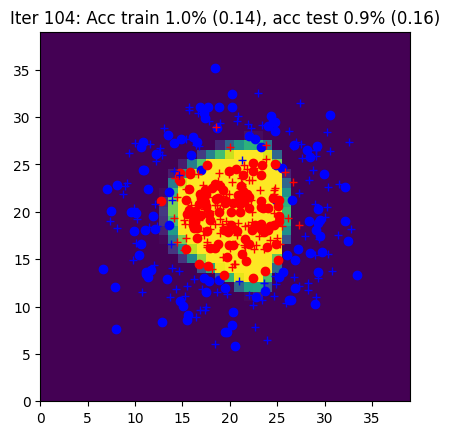

Iter 105: Acc train 1.0% (0.15), acc test 0.9% (0.16)


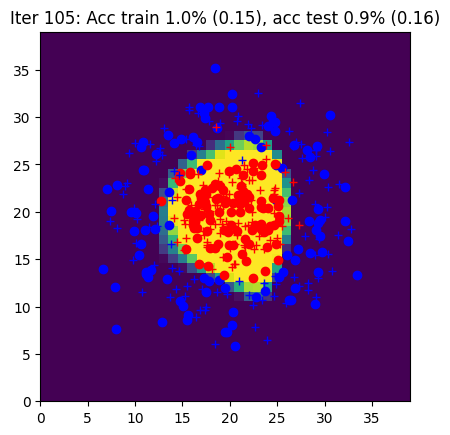

Iter 106: Acc train 0.9% (0.14), acc test 0.9% (0.17)


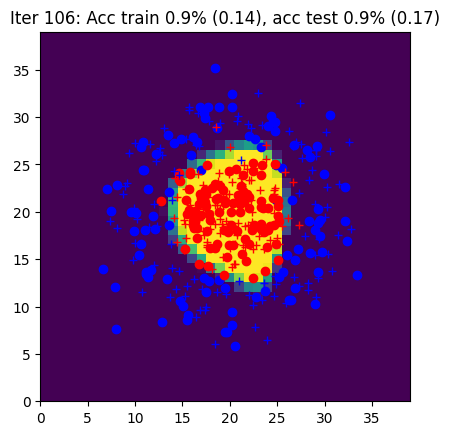

Iter 107: Acc train 1.0% (0.14), acc test 0.9% (0.17)


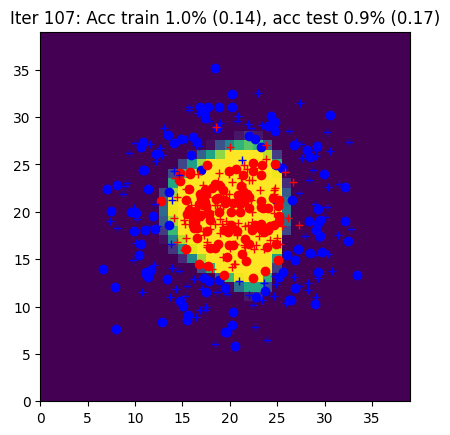

Iter 108: Acc train 0.9% (0.14), acc test 0.9% (0.17)


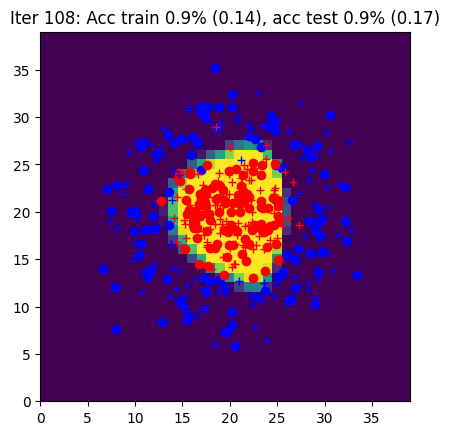

Iter 109: Acc train 1.0% (0.13), acc test 0.9% (0.17)


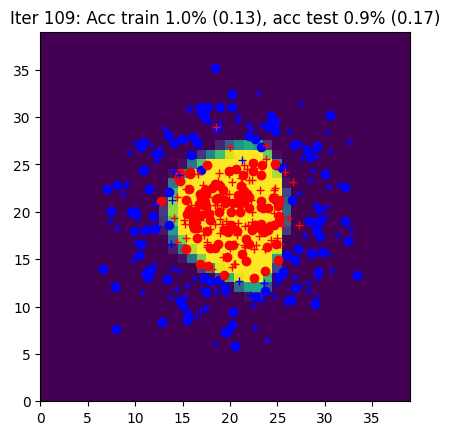

Iter 110: Acc train 1.0% (0.13), acc test 0.9% (0.16)


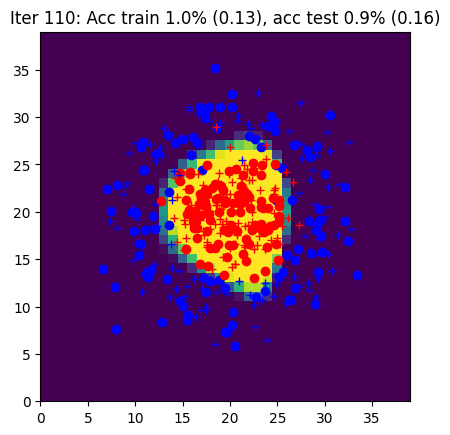

Iter 111: Acc train 0.9% (0.14), acc test 0.9% (0.18)


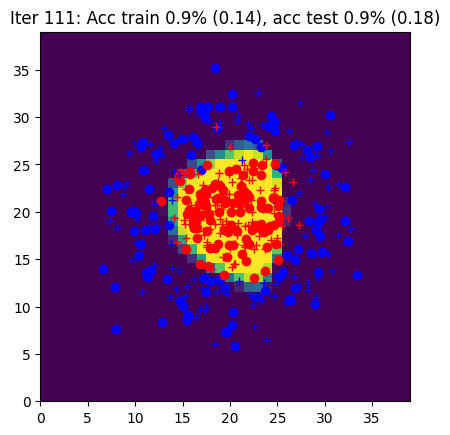

Iter 112: Acc train 1.0% (0.13), acc test 0.9% (0.16)


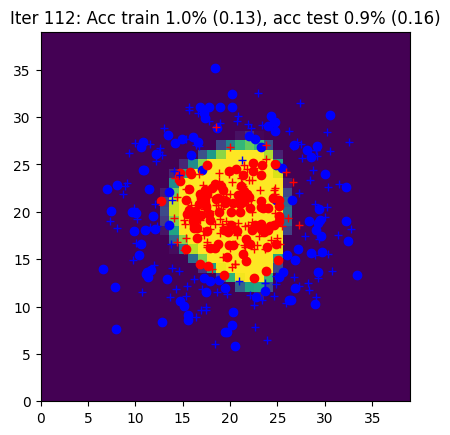

Iter 113: Acc train 1.0% (0.13), acc test 0.9% (0.16)


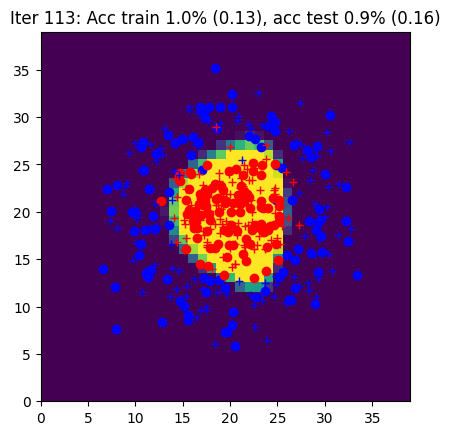

Iter 114: Acc train 1.0% (0.13), acc test 0.9% (0.16)


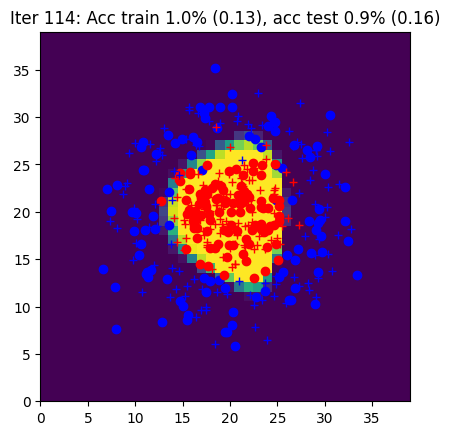

Iter 115: Acc train 1.0% (0.13), acc test 0.9% (0.16)


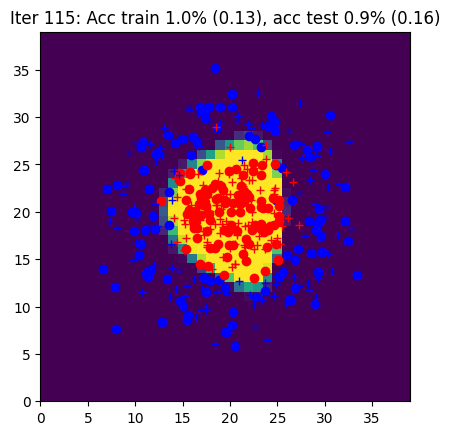

Iter 116: Acc train 1.0% (0.13), acc test 0.9% (0.16)


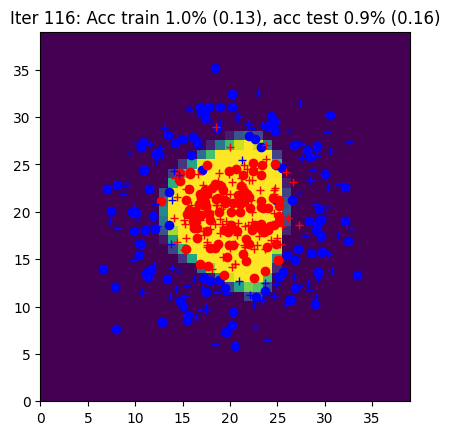

Iter 117: Acc train 1.0% (0.13), acc test 0.9% (0.16)


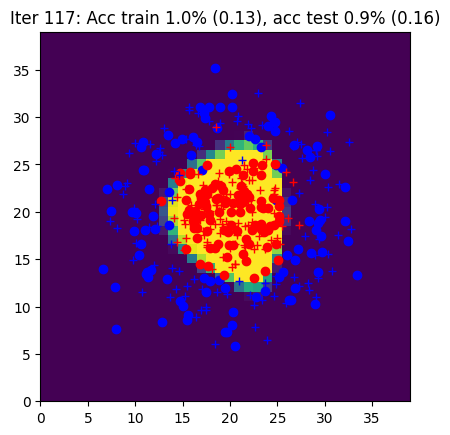

Iter 118: Acc train 1.0% (0.12), acc test 0.9% (0.16)


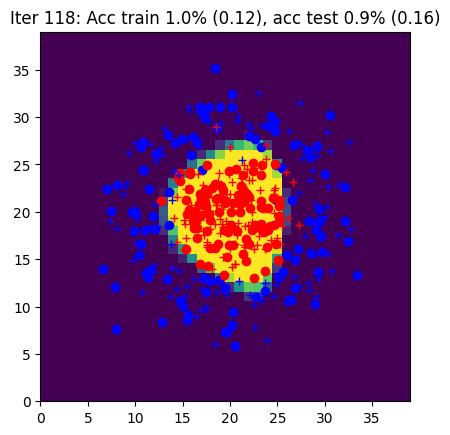

Iter 119: Acc train 1.0% (0.12), acc test 0.9% (0.16)


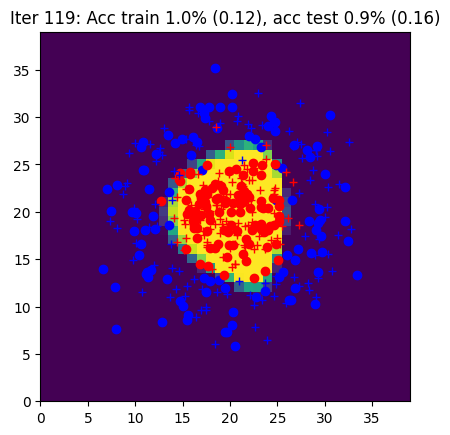

Iter 120: Acc train 1.0% (0.12), acc test 0.9% (0.16)


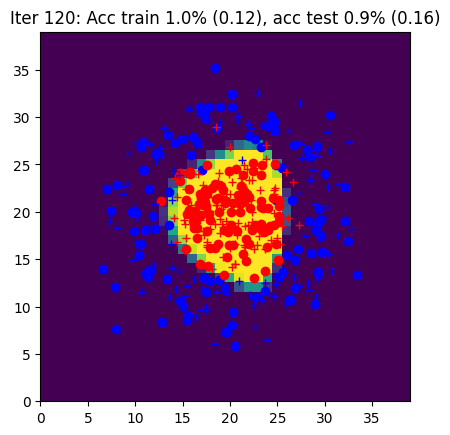

Iter 121: Acc train 1.0% (0.12), acc test 0.9% (0.16)


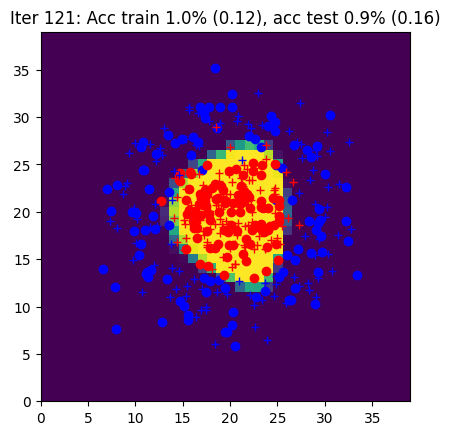

Iter 122: Acc train 1.0% (0.12), acc test 0.9% (0.15)


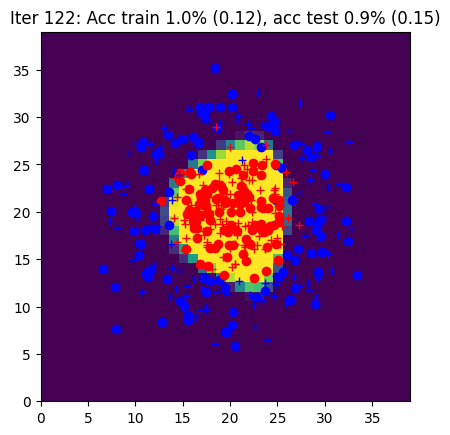

Iter 123: Acc train 1.0% (0.12), acc test 0.9% (0.16)


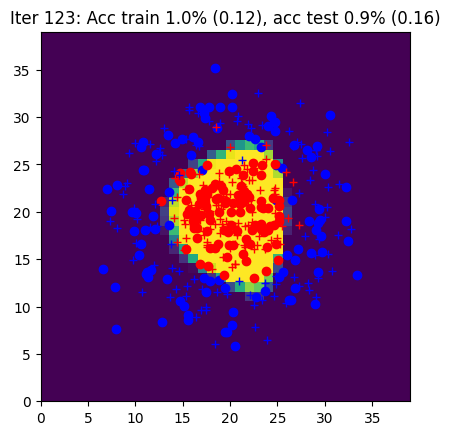

Iter 124: Acc train 1.0% (0.12), acc test 0.9% (0.16)


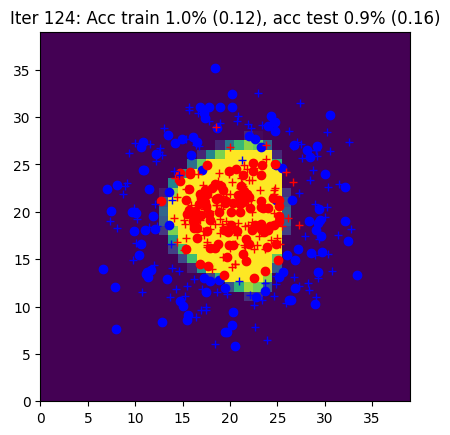

Iter 125: Acc train 1.0% (0.12), acc test 0.9% (0.15)


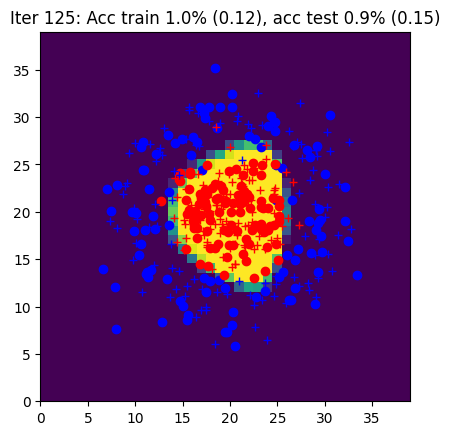

Iter 126: Acc train 1.0% (0.12), acc test 0.9% (0.15)


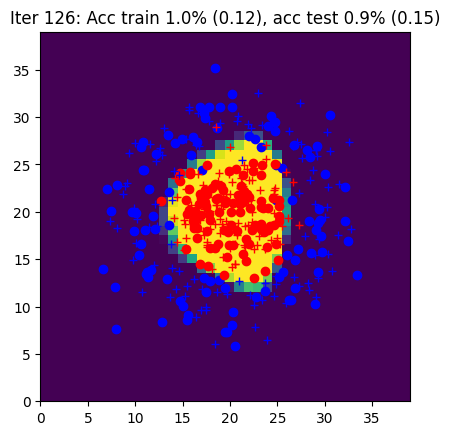

Iter 127: Acc train 1.0% (0.13), acc test 0.9% (0.15)


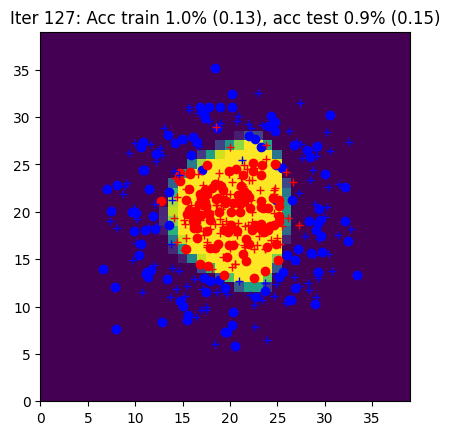

Iter 128: Acc train 1.0% (0.12), acc test 0.9% (0.15)


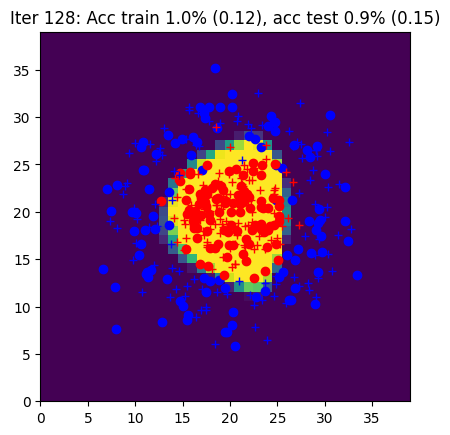

Iter 129: Acc train 1.0% (0.12), acc test 0.9% (0.16)


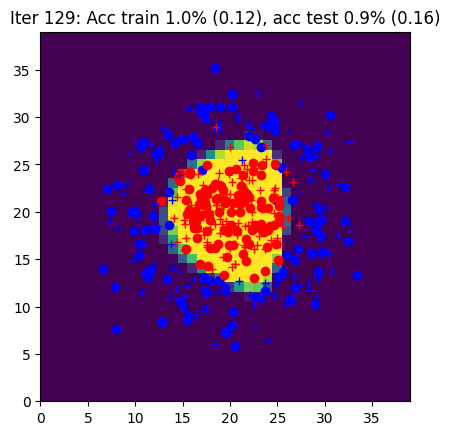

Iter 130: Acc train 0.9% (0.13), acc test 0.9% (0.17)


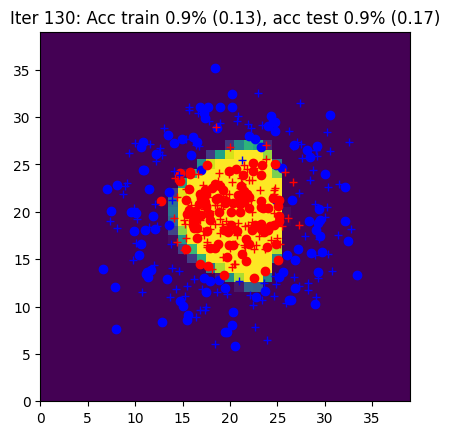

Iter 131: Acc train 1.0% (0.12), acc test 0.9% (0.16)


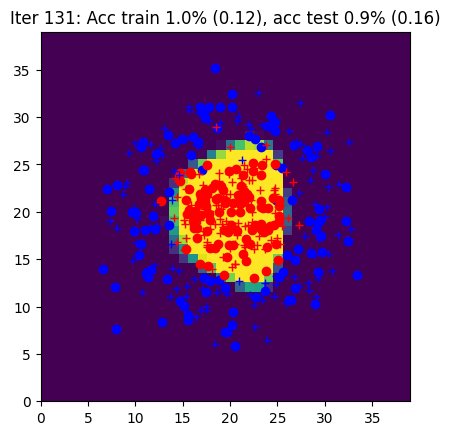

Iter 132: Acc train 1.0% (0.12), acc test 0.9% (0.16)


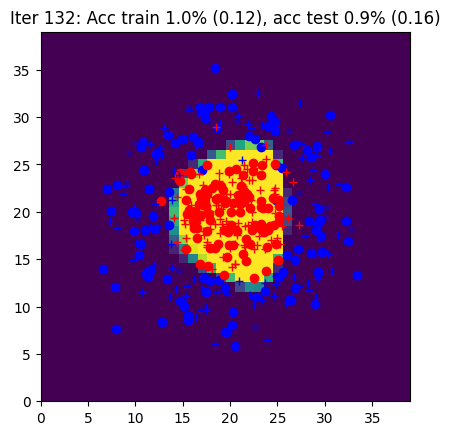

Iter 133: Acc train 1.0% (0.12), acc test 1.0% (0.16)


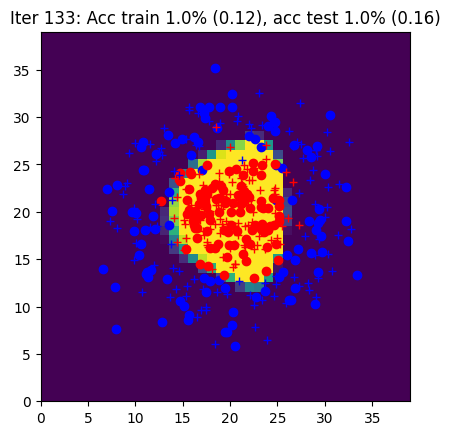

Iter 134: Acc train 1.0% (0.12), acc test 0.9% (0.16)


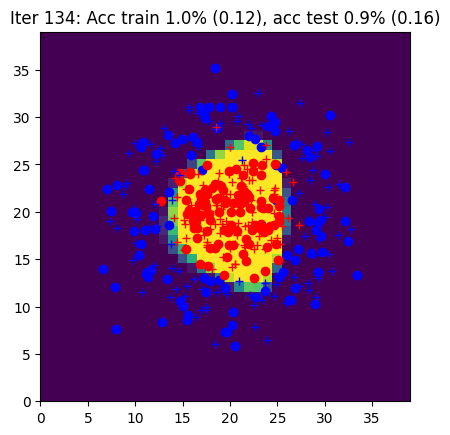

Iter 135: Acc train 0.9% (0.13), acc test 0.9% (0.17)


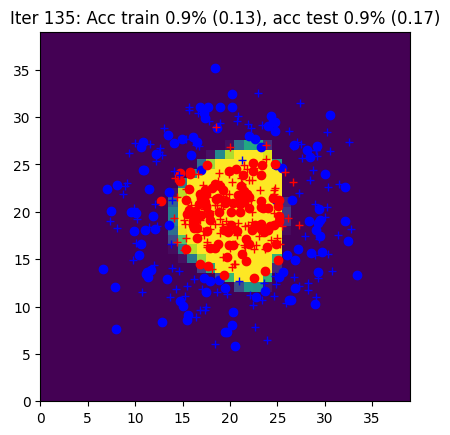

Iter 136: Acc train 1.0% (0.12), acc test 0.9% (0.17)


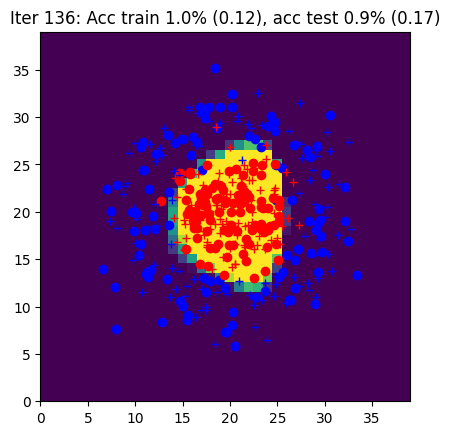

Iter 137: Acc train 1.0% (0.12), acc test 0.9% (0.17)


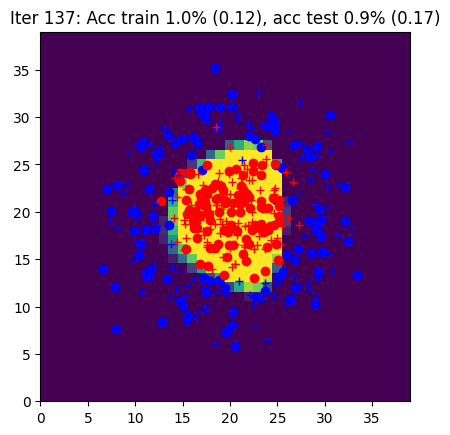

Iter 138: Acc train 1.0% (0.12), acc test 0.9% (0.17)


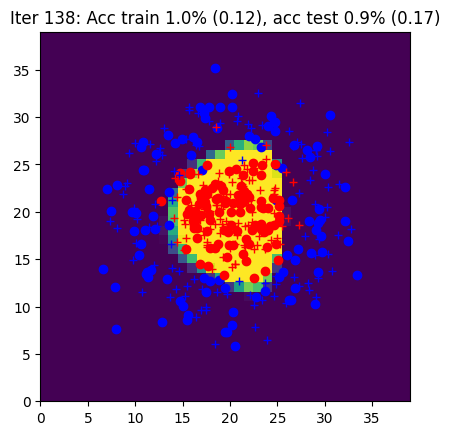

Iter 139: Acc train 1.0% (0.12), acc test 0.9% (0.17)


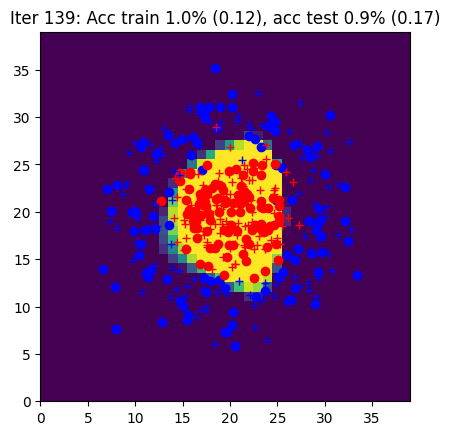

Iter 140: Acc train 1.0% (0.12), acc test 0.9% (0.18)


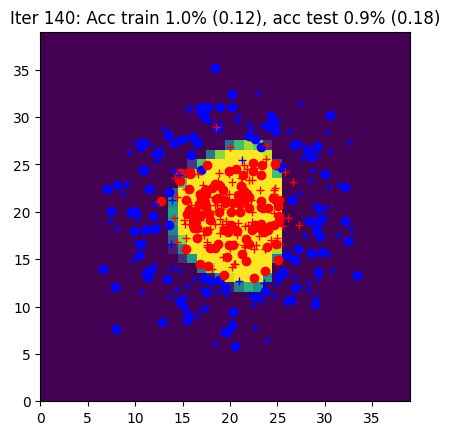

Iter 141: Acc train 1.0% (0.12), acc test 0.9% (0.18)


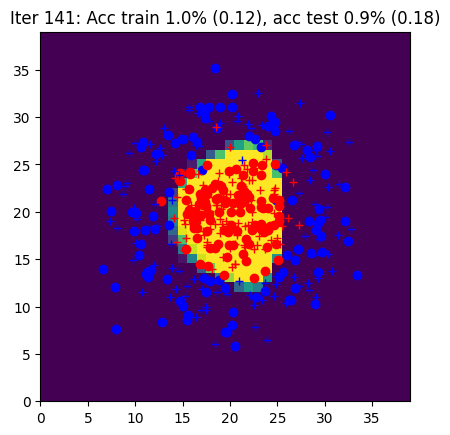

Iter 142: Acc train 1.0% (0.12), acc test 1.0% (0.17)


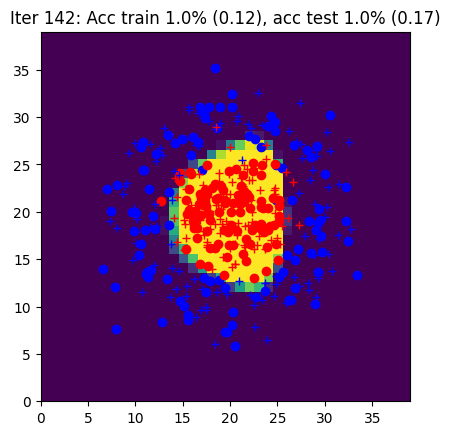

Iter 143: Acc train 1.0% (0.12), acc test 0.9% (0.19)


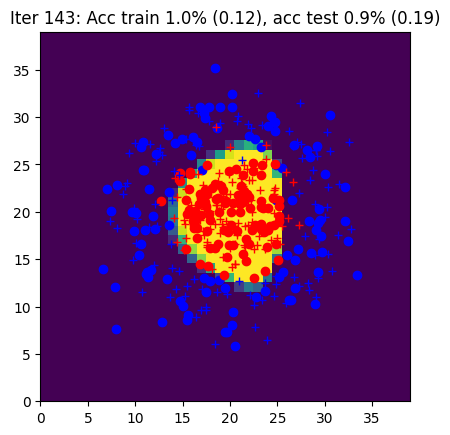

Iter 144: Acc train 1.0% (0.12), acc test 0.9% (0.17)


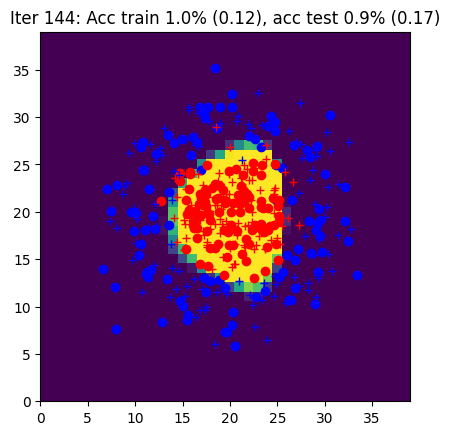

Iter 145: Acc train 0.9% (0.12), acc test 0.9% (0.18)


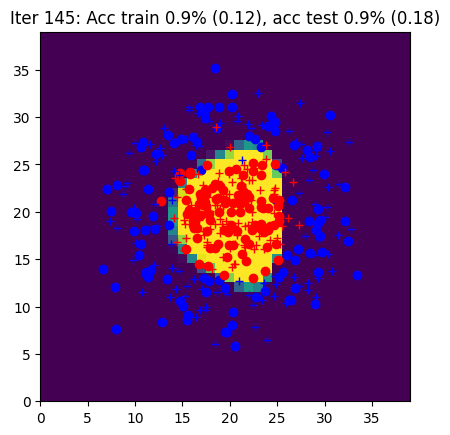

Iter 146: Acc train 1.0% (0.12), acc test 0.9% (0.17)


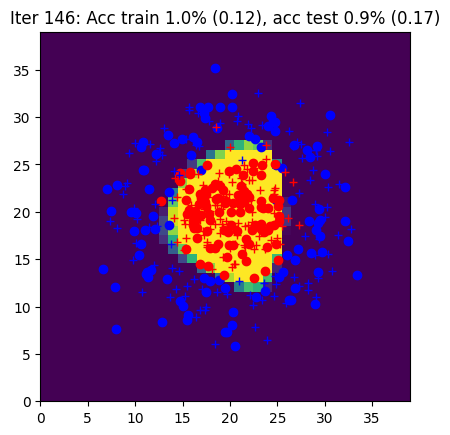

Iter 147: Acc train 1.0% (0.11), acc test 0.9% (0.17)


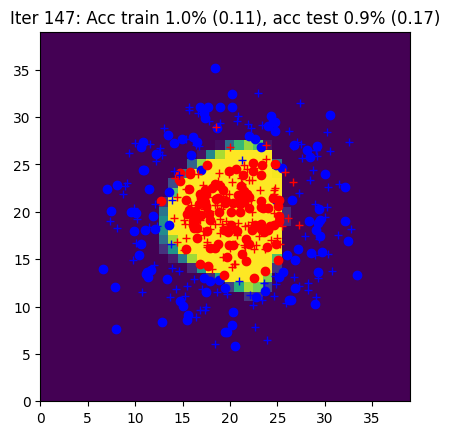

Iter 148: Acc train 1.0% (0.12), acc test 0.9% (0.16)


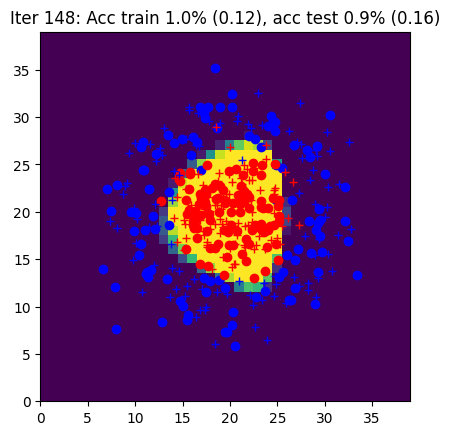

Iter 149: Acc train 1.0% (0.12), acc test 0.9% (0.17)


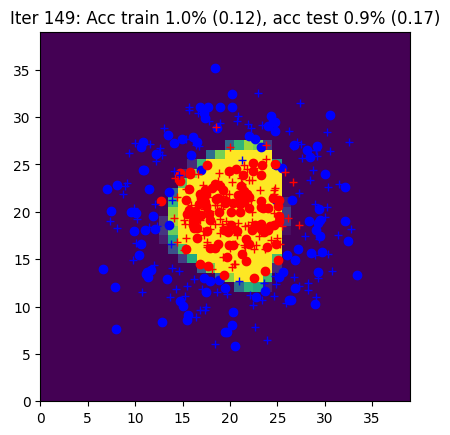

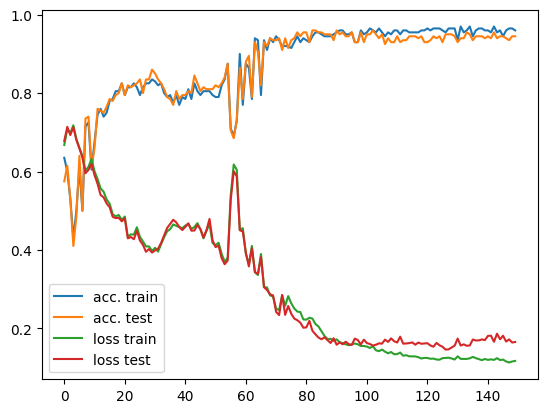

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: forward, loss_accuracy, backward, sgd
        pred, outputs = forward(params, X)
        grads = backward(params, outputs, Y)
        params = sgd(params, grads, eta)


    ####################
    ##      END        #
    ####################


    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(Ygrid, title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 2 : Simplification of the backward pass with `torch.autograd`



In [ ]:
def init_params(nx, nh, ny):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for Wh, Wy, bh, by
    # activaye autograd on the network weights

    params["Wh"] = torch.normal(mean=0, std=0.3, size=(nh,nx), requires_grad=True)
    params["Wy"] = torch.normal(mean=0, std=0.3, size=(ny,nh), requires_grad=True)
    params["bh"] = torch.normal(mean=0, std=0.3, size=(nh,), requires_grad=True)
    params["by"] = torch.normal(mean=0, std=0.3, size=(ny,), requires_grad=True)

    ####################
    ##      END        #
    ####################
    return params

The function `forward` remains unchanged from previous part.

The function `backward` is no longer used because of "autograd".

In [ ]:
def sgd(params, eta):

    #####################
    ## Your code here  ##
    #####################
    # update the network weights
    # warning: use torch.no_grad()
    # and reset to zero the gradient accumulators

    with torch.no_grad():
      params["Wh"] = params["Wh"] - eta * params["Wh"].grad
      params["Wy"] = params["Wy"] - eta * params['Wy'].grad
      params["bh"] = params["bh"] - eta * params['bh'].grad
      params["by"] = params["by"] - eta * params['by'].grad

    params["Wh"] = params["Wh"].requires_grad_(True)
    params["Wy"] = params["Wy"].requires_grad_(True)
    params["bh"] = params["bh"].requires_grad_(True)
    params["by"] = params["by"].requires_grad_(True)



    ####################
    ##      END        #
    ####################
    return params

## Global learning procedure with autograd

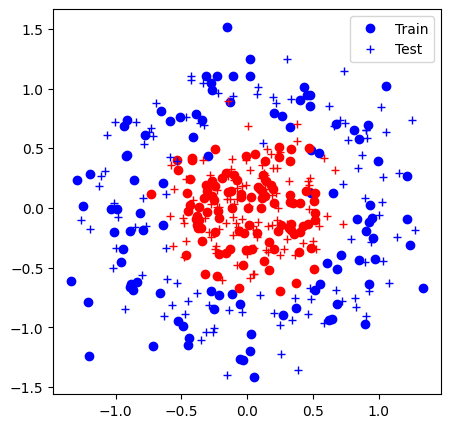

Iter 0: Acc train 0.6% (0.69), acc test 0.6% (0.69)


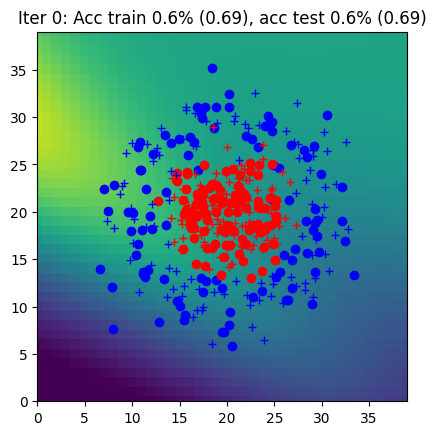

Iter 1: Acc train 0.7% (0.68), acc test 0.7% (0.69)


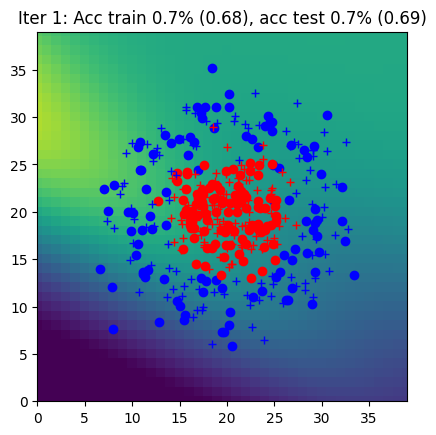

Iter 2: Acc train 0.6% (0.68), acc test 0.6% (0.68)


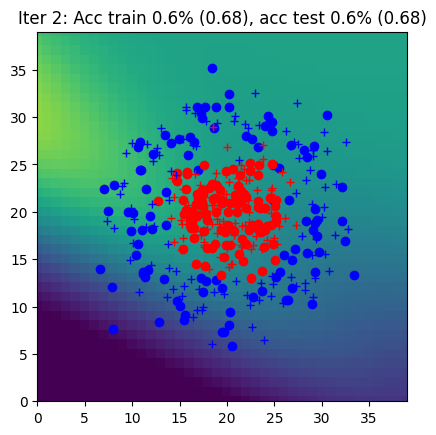

Iter 3: Acc train 0.5% (0.68), acc test 0.5% (0.68)


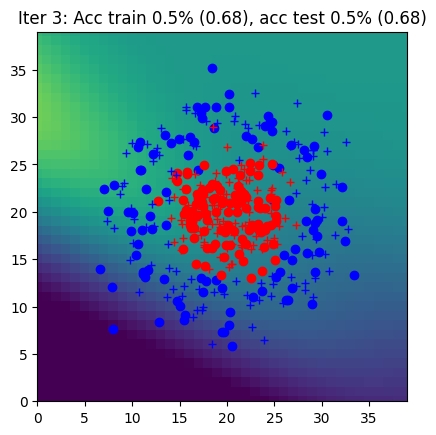

Iter 4: Acc train 0.6% (0.67), acc test 0.6% (0.68)


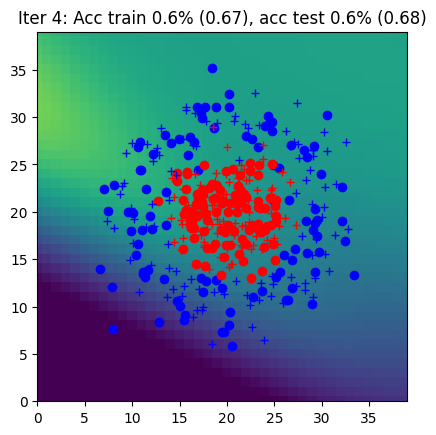

Iter 5: Acc train 0.7% (0.67), acc test 0.7% (0.67)


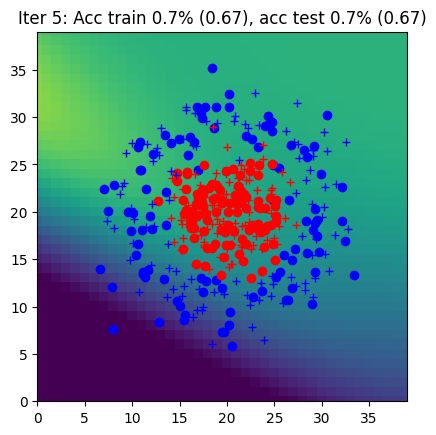

Iter 6: Acc train 0.6% (0.67), acc test 0.7% (0.67)


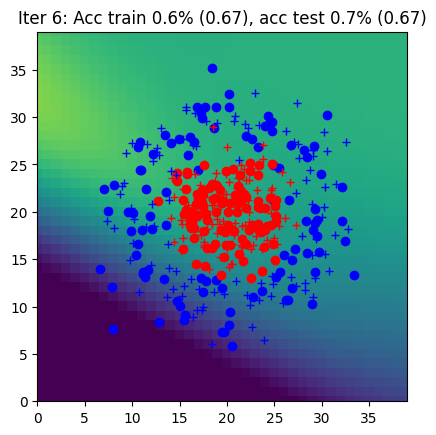

Iter 7: Acc train 0.6% (0.66), acc test 0.7% (0.67)


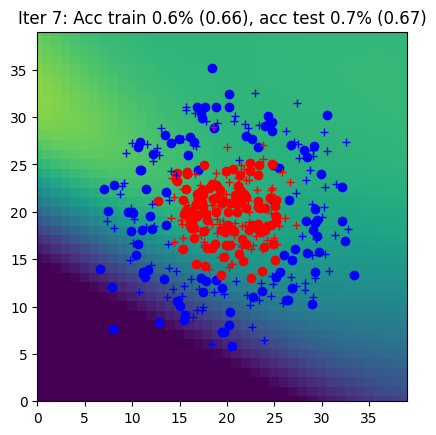

Iter 8: Acc train 0.7% (0.66), acc test 0.7% (0.67)


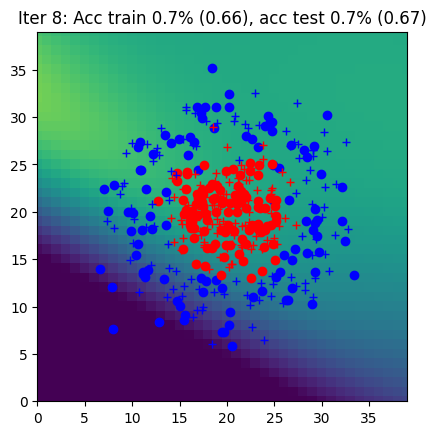

Iter 9: Acc train 0.6% (0.66), acc test 0.7% (0.66)


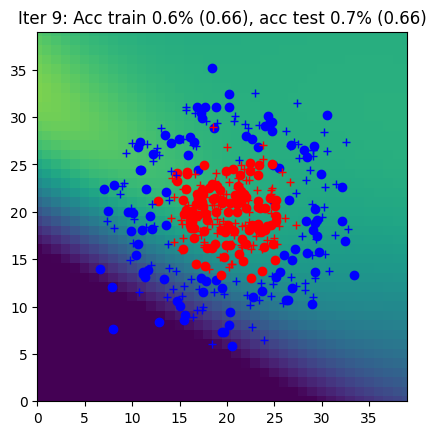

Iter 10: Acc train 0.6% (0.65), acc test 0.7% (0.66)


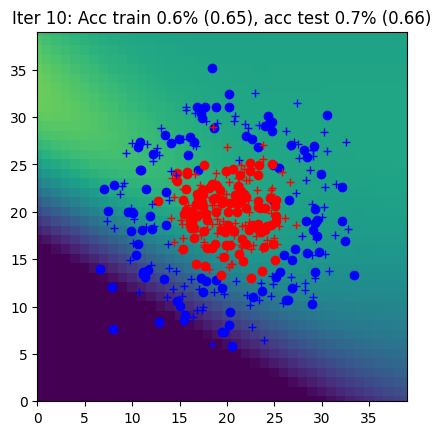

Iter 11: Acc train 0.6% (0.65), acc test 0.7% (0.66)


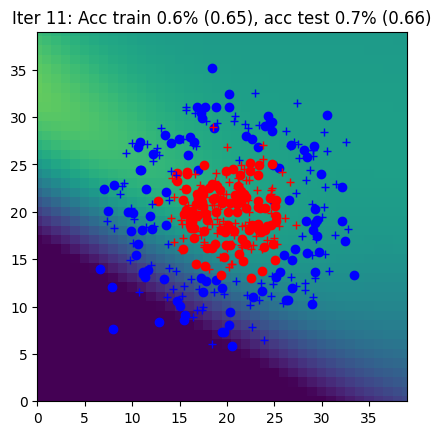

Iter 12: Acc train 0.6% (0.65), acc test 0.7% (0.66)


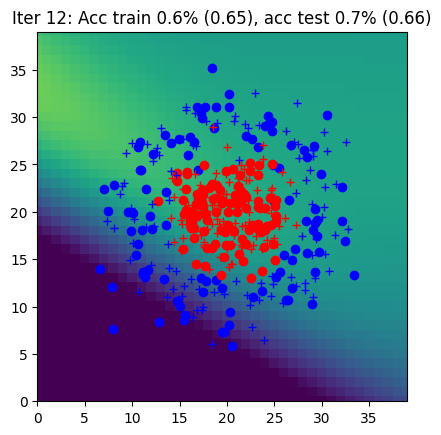

Iter 13: Acc train 0.7% (0.64), acc test 0.7% (0.65)


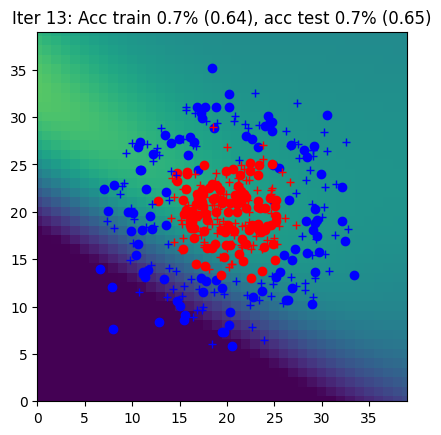

Iter 14: Acc train 0.6% (0.64), acc test 0.7% (0.65)


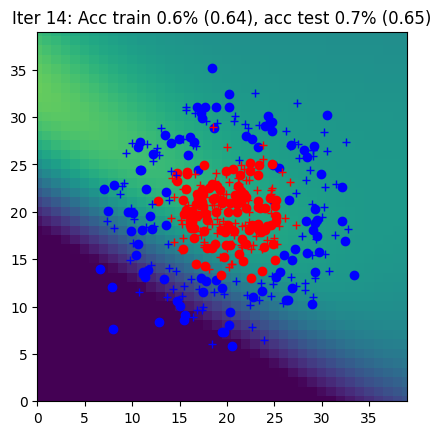

Iter 15: Acc train 0.6% (0.64), acc test 0.6% (0.65)


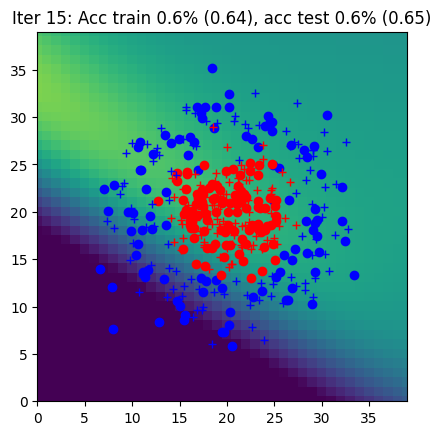

Iter 16: Acc train 0.6% (0.64), acc test 0.6% (0.64)


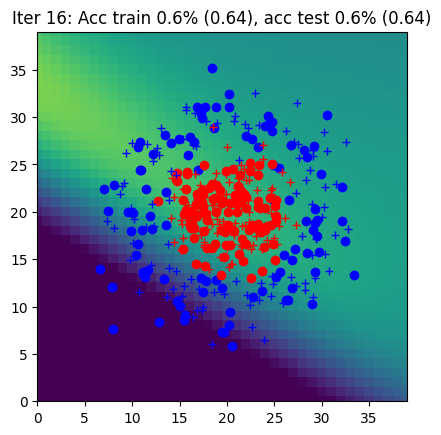

Iter 17: Acc train 0.7% (0.63), acc test 0.7% (0.64)


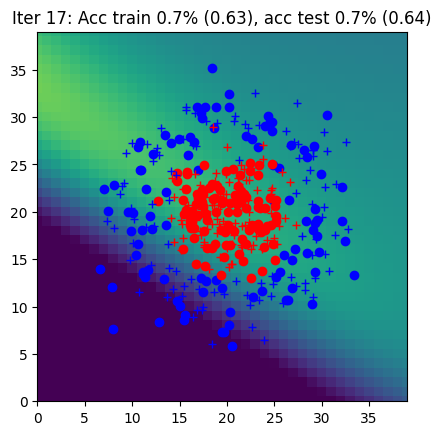

Iter 18: Acc train 0.6% (0.63), acc test 0.7% (0.64)


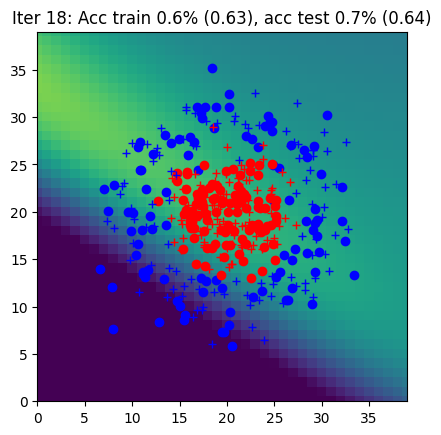

Iter 19: Acc train 0.7% (0.62), acc test 0.7% (0.63)


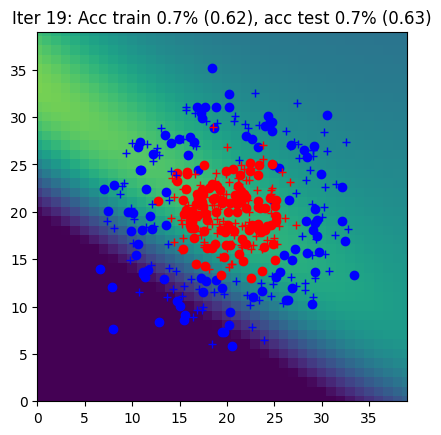

Iter 20: Acc train 0.7% (0.62), acc test 0.7% (0.63)


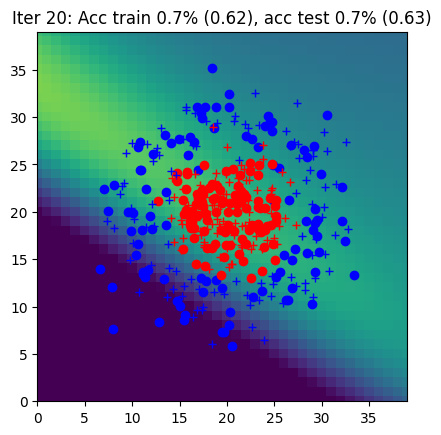

Iter 21: Acc train 0.7% (0.62), acc test 0.8% (0.63)


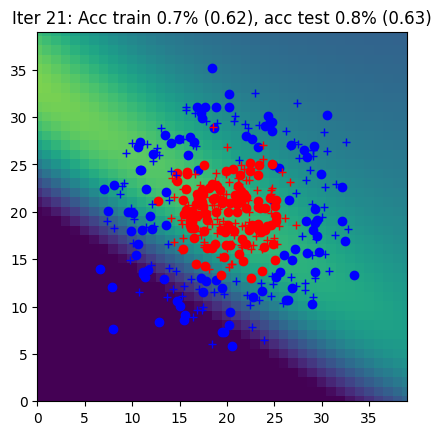

Iter 22: Acc train 0.8% (0.61), acc test 0.8% (0.62)


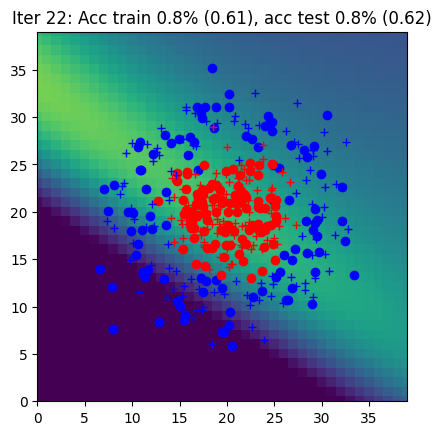

Iter 23: Acc train 0.7% (0.61), acc test 0.7% (0.62)


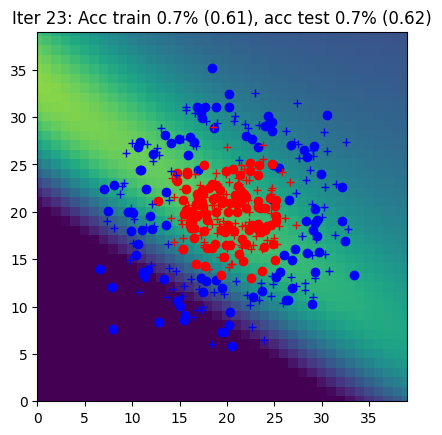

Iter 24: Acc train 0.7% (0.60), acc test 0.7% (0.62)


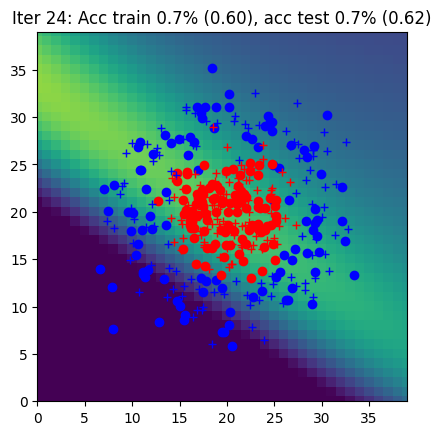

Iter 25: Acc train 0.8% (0.60), acc test 0.8% (0.61)


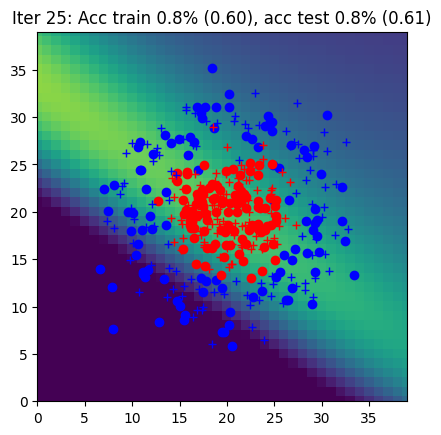

Iter 26: Acc train 0.8% (0.60), acc test 0.8% (0.61)


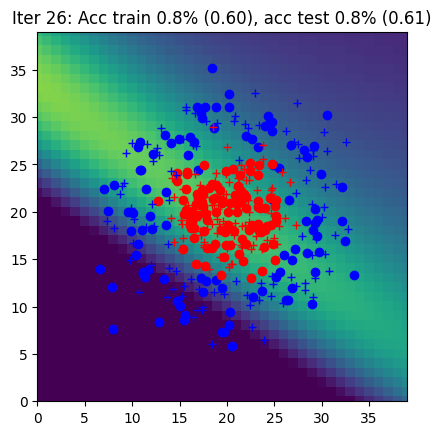

Iter 27: Acc train 0.8% (0.59), acc test 0.8% (0.61)


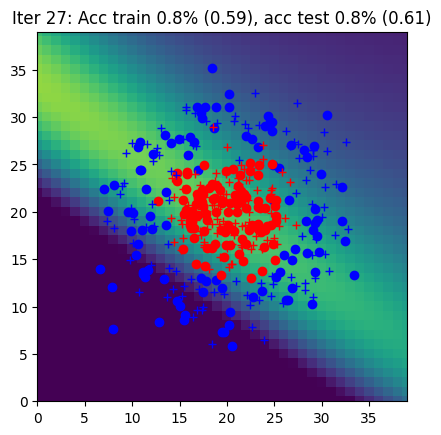

Iter 28: Acc train 0.8% (0.59), acc test 0.8% (0.60)


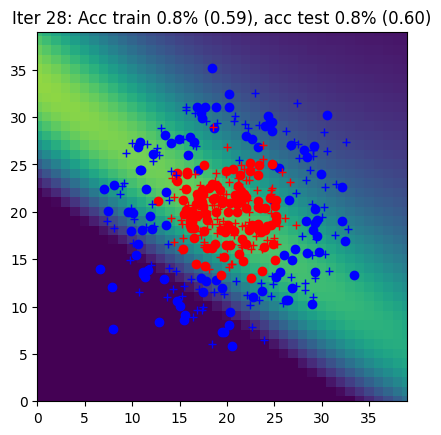

Iter 29: Acc train 0.8% (0.58), acc test 0.8% (0.60)


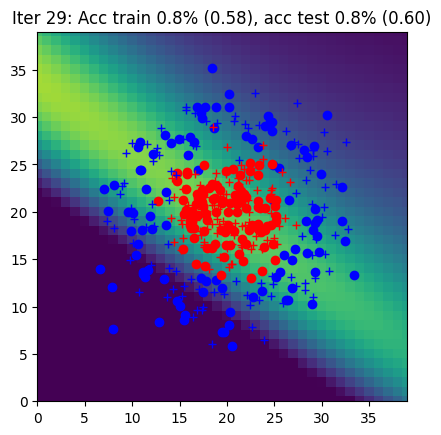

Iter 30: Acc train 0.8% (0.58), acc test 0.8% (0.59)


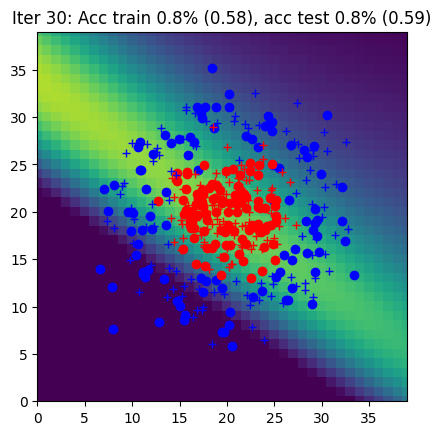

Iter 31: Acc train 0.8% (0.57), acc test 0.8% (0.59)


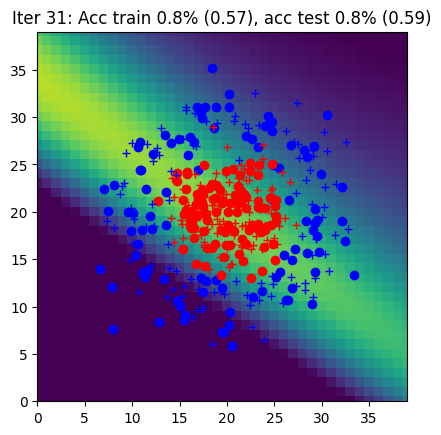

Iter 32: Acc train 0.8% (0.57), acc test 0.7% (0.59)


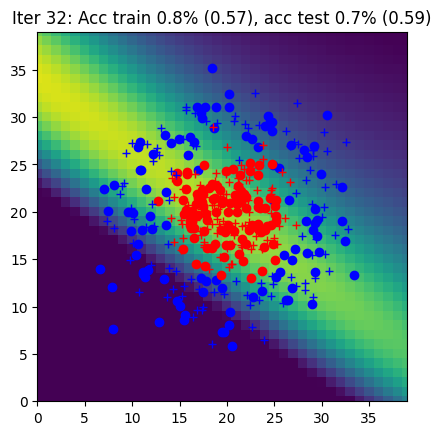

Iter 33: Acc train 0.8% (0.57), acc test 0.8% (0.58)


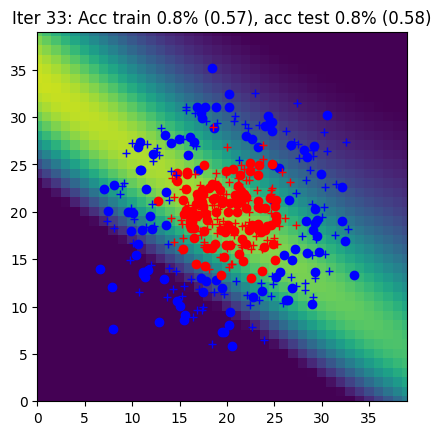

Iter 34: Acc train 0.8% (0.56), acc test 0.8% (0.58)


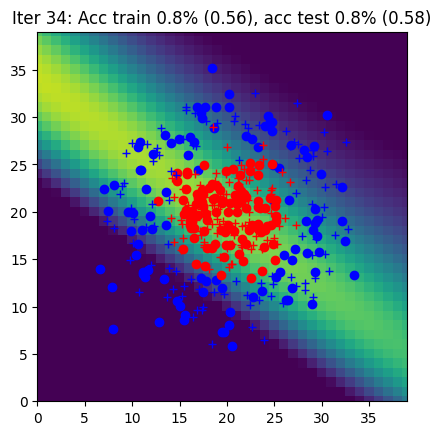

Iter 35: Acc train 0.8% (0.56), acc test 0.8% (0.58)


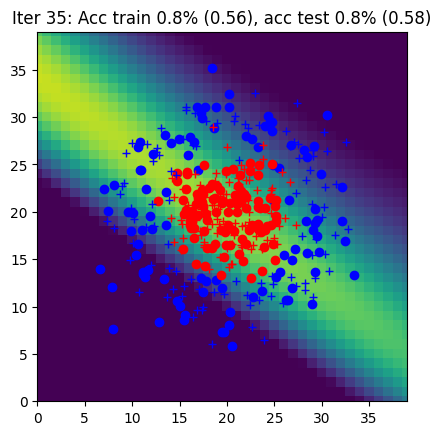

Iter 36: Acc train 0.8% (0.55), acc test 0.8% (0.57)


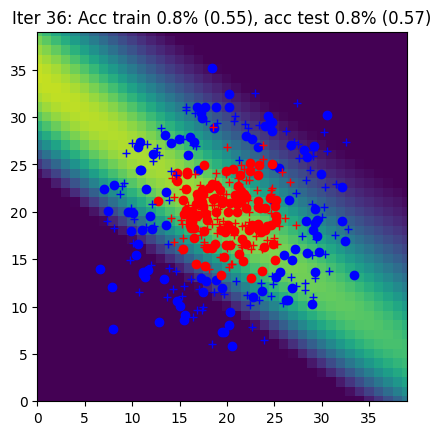

Iter 37: Acc train 0.8% (0.55), acc test 0.8% (0.57)


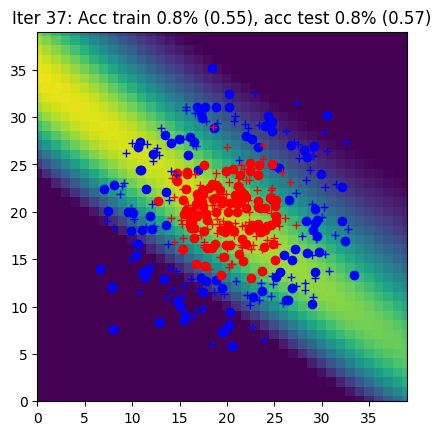

Iter 38: Acc train 0.8% (0.55), acc test 0.8% (0.57)


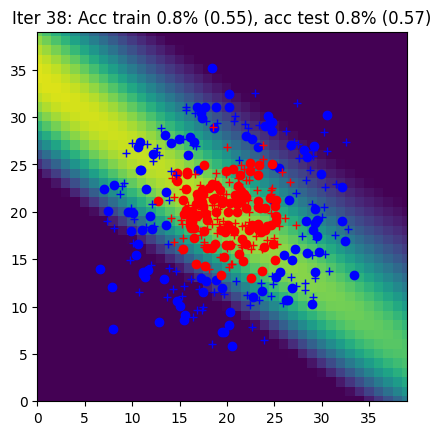

Iter 39: Acc train 0.8% (0.54), acc test 0.8% (0.56)


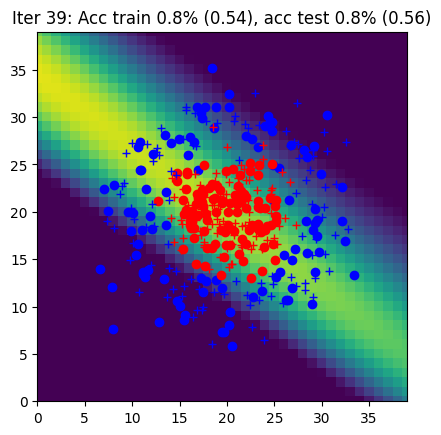

Iter 40: Acc train 0.8% (0.54), acc test 0.8% (0.56)


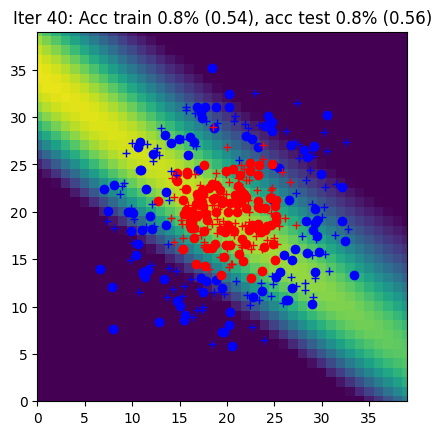

Iter 41: Acc train 0.8% (0.54), acc test 0.8% (0.56)


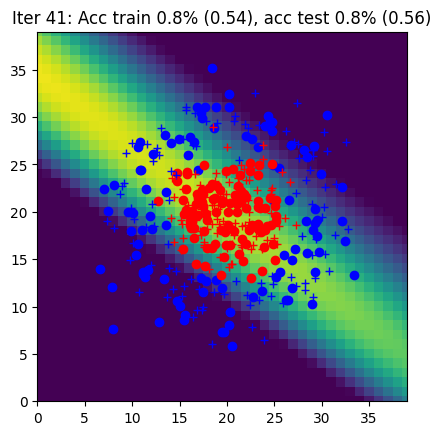

Iter 42: Acc train 0.8% (0.53), acc test 0.8% (0.55)


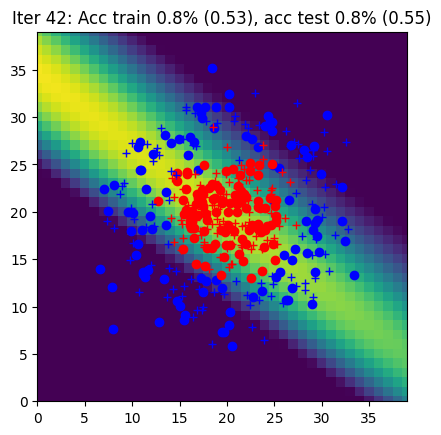

Iter 43: Acc train 0.8% (0.53), acc test 0.8% (0.55)


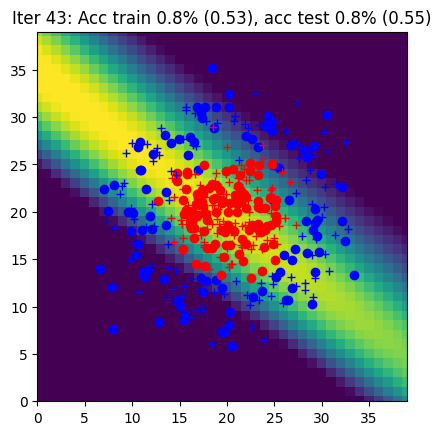

Iter 44: Acc train 0.8% (0.53), acc test 0.8% (0.55)


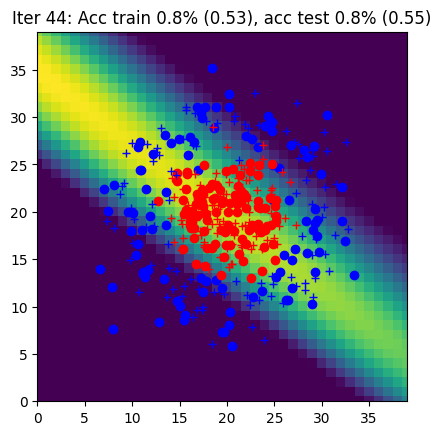

Iter 45: Acc train 0.8% (0.52), acc test 0.8% (0.55)


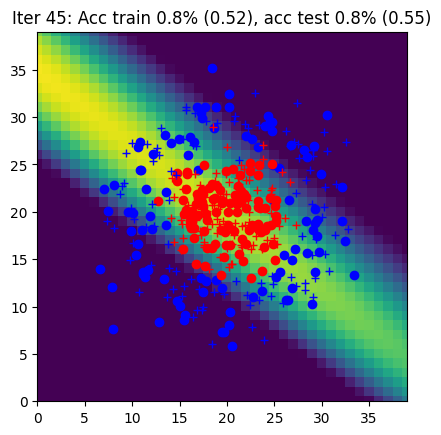

Iter 46: Acc train 0.8% (0.52), acc test 0.8% (0.54)


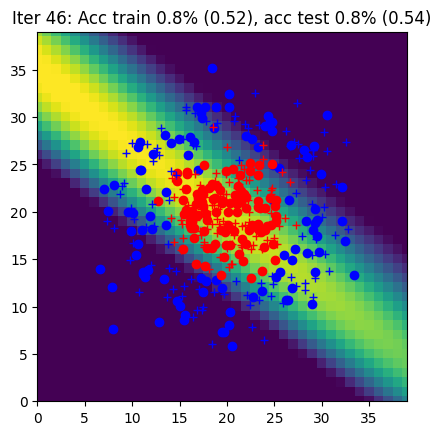

Iter 47: Acc train 0.8% (0.52), acc test 0.8% (0.54)


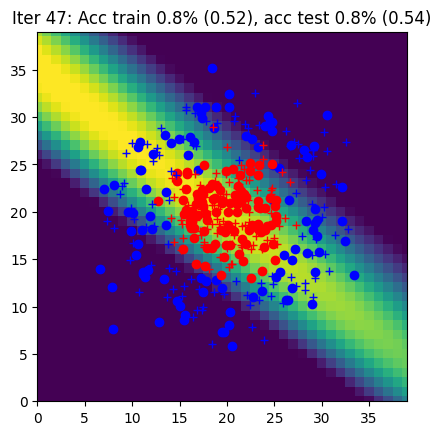

Iter 48: Acc train 0.8% (0.51), acc test 0.8% (0.54)


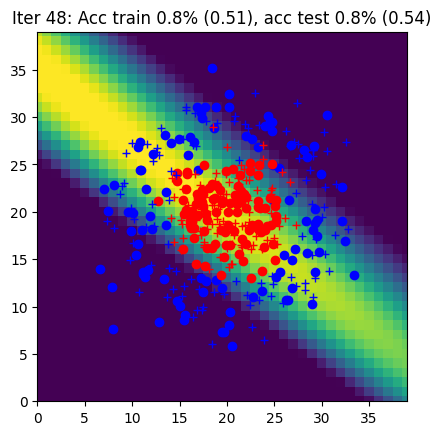

Iter 49: Acc train 0.8% (0.51), acc test 0.8% (0.54)


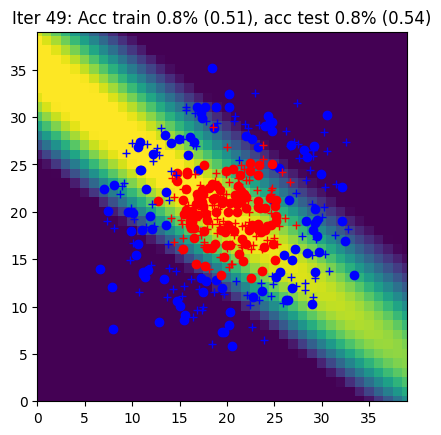

Iter 50: Acc train 0.8% (0.51), acc test 0.8% (0.54)


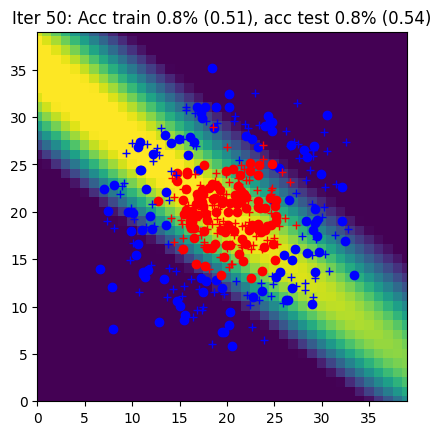

Iter 51: Acc train 0.8% (0.51), acc test 0.8% (0.53)


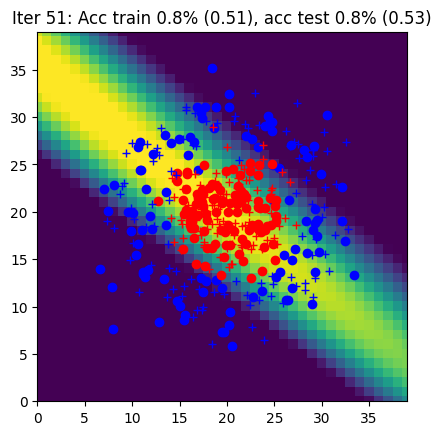

Iter 52: Acc train 0.8% (0.50), acc test 0.8% (0.53)


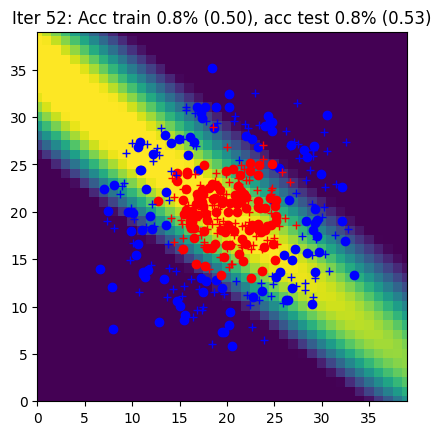

Iter 53: Acc train 0.8% (0.50), acc test 0.8% (0.53)


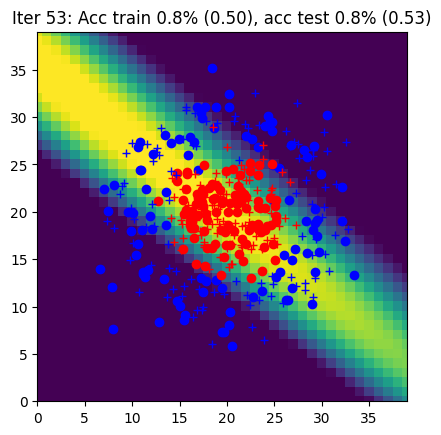

Iter 54: Acc train 0.8% (0.50), acc test 0.8% (0.53)


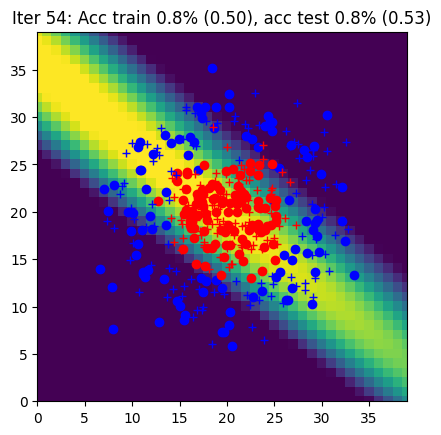

Iter 55: Acc train 0.8% (0.50), acc test 0.8% (0.53)


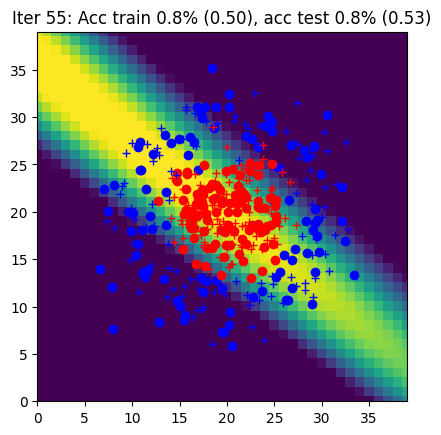

Iter 56: Acc train 0.8% (0.49), acc test 0.8% (0.53)


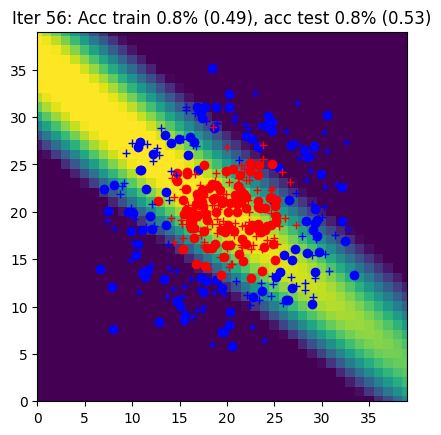

Iter 57: Acc train 0.8% (0.49), acc test 0.8% (0.52)


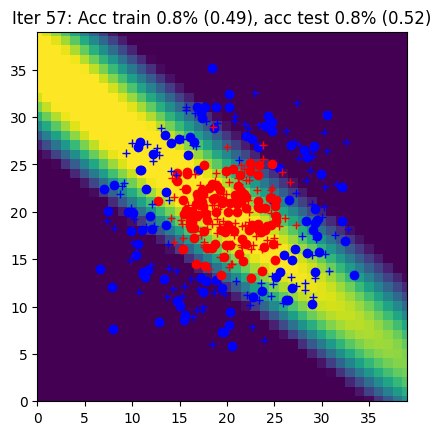

Iter 58: Acc train 0.8% (0.49), acc test 0.8% (0.52)


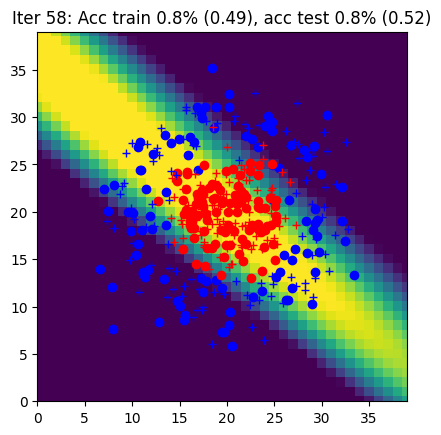

Iter 59: Acc train 0.8% (0.49), acc test 0.8% (0.52)


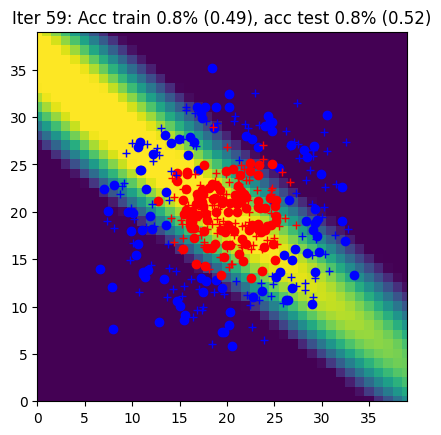

Iter 60: Acc train 0.8% (0.49), acc test 0.8% (0.52)


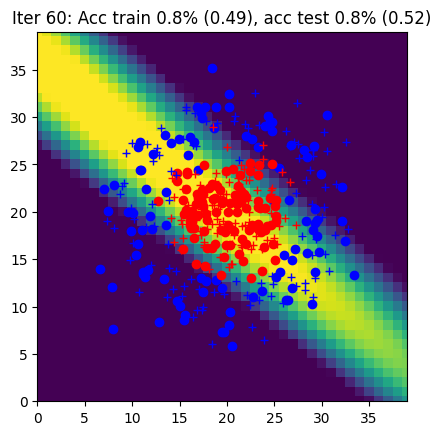

Iter 61: Acc train 0.8% (0.48), acc test 0.8% (0.52)


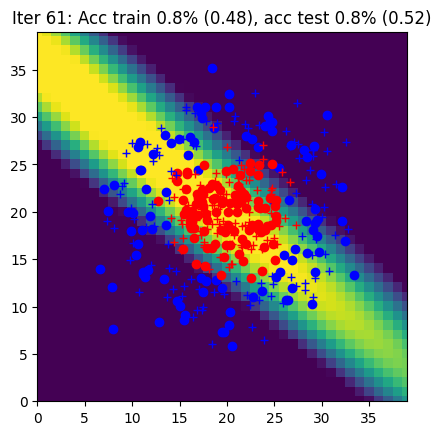

Iter 62: Acc train 0.8% (0.48), acc test 0.8% (0.52)


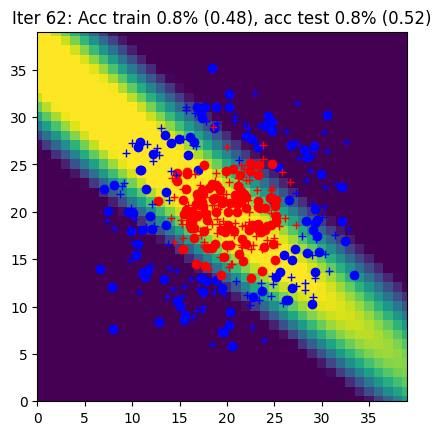

Iter 63: Acc train 0.8% (0.48), acc test 0.8% (0.52)


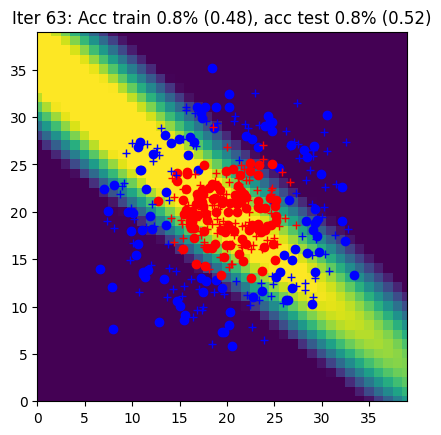

Iter 64: Acc train 0.8% (0.48), acc test 0.8% (0.51)


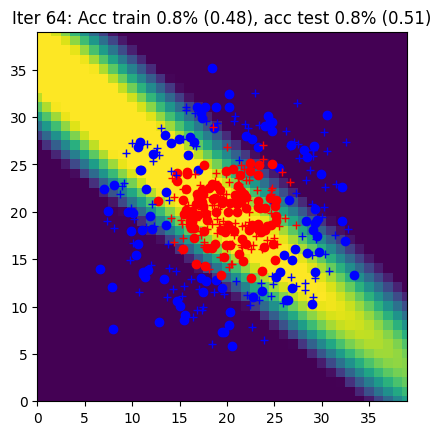

Iter 65: Acc train 0.8% (0.48), acc test 0.8% (0.51)


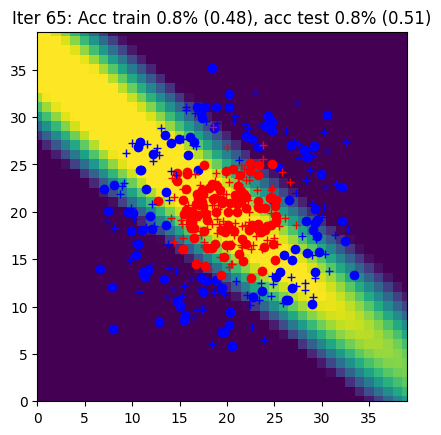

Iter 66: Acc train 0.8% (0.47), acc test 0.8% (0.51)


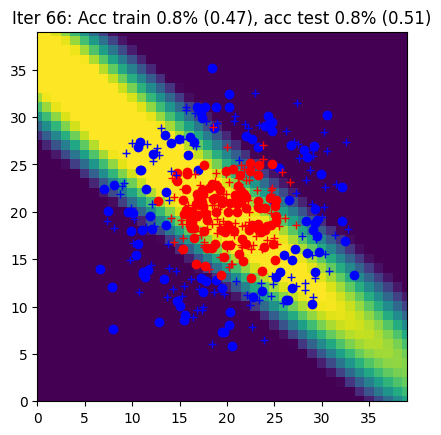

Iter 67: Acc train 0.8% (0.47), acc test 0.8% (0.51)


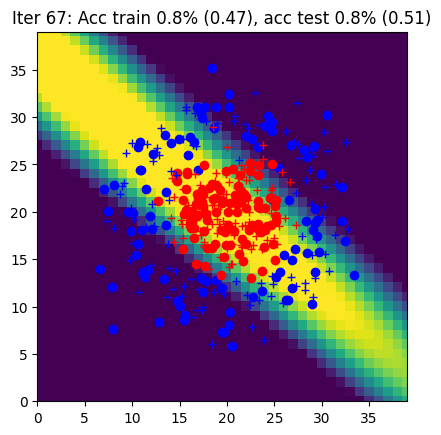

Iter 68: Acc train 0.8% (0.47), acc test 0.8% (0.51)


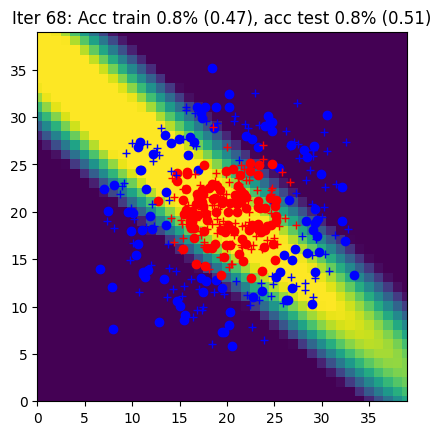

Iter 69: Acc train 0.8% (0.47), acc test 0.8% (0.51)


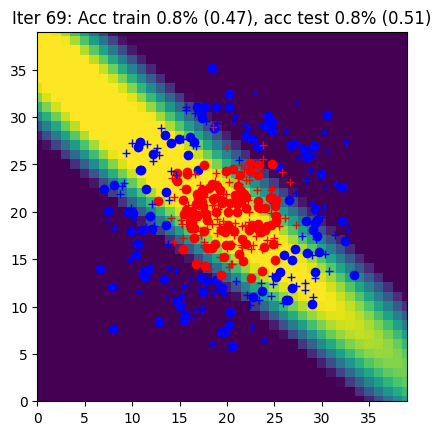

Iter 70: Acc train 0.8% (0.47), acc test 0.8% (0.51)


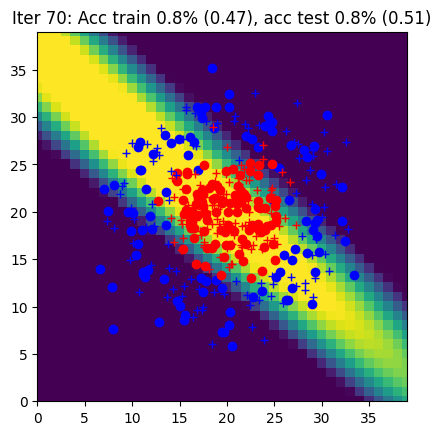

Iter 71: Acc train 0.8% (0.47), acc test 0.8% (0.51)


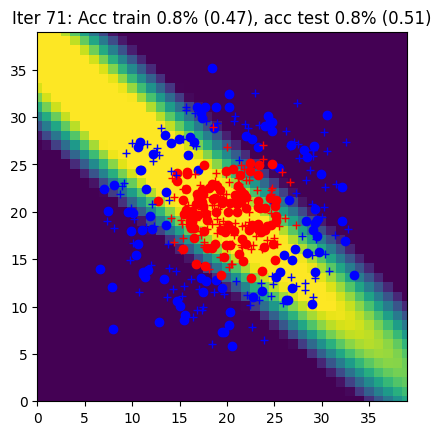

Iter 72: Acc train 0.8% (0.47), acc test 0.8% (0.51)


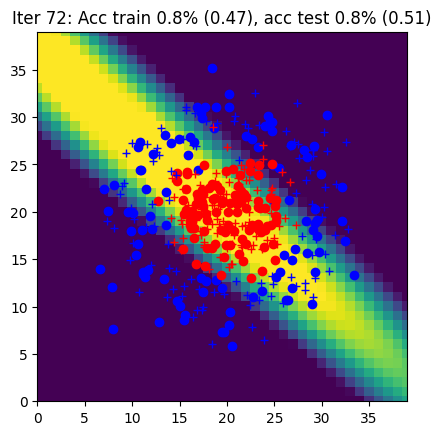

Iter 73: Acc train 0.8% (0.46), acc test 0.8% (0.51)


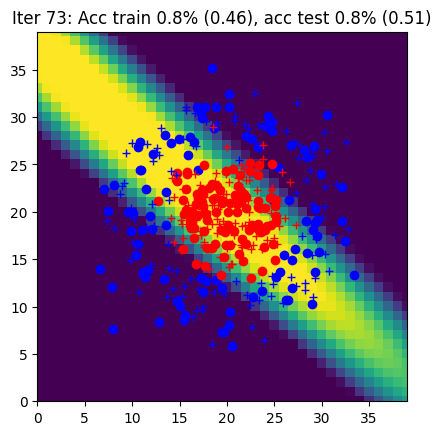

Iter 74: Acc train 0.8% (0.46), acc test 0.8% (0.51)


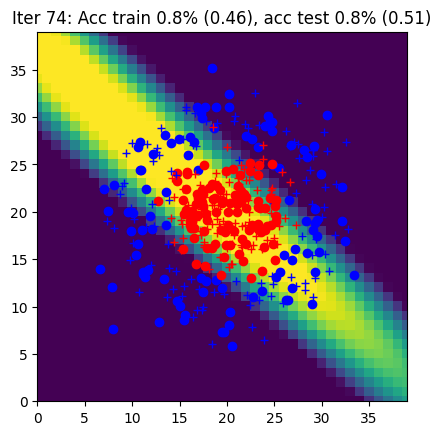

Iter 75: Acc train 0.8% (0.46), acc test 0.8% (0.50)


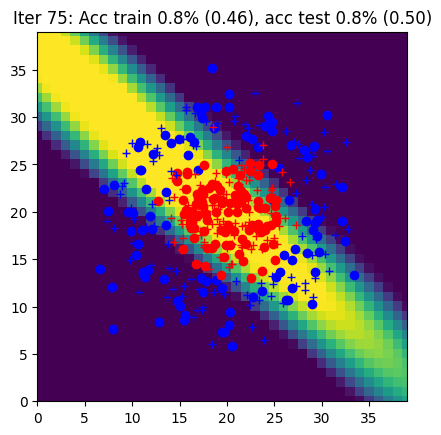

Iter 76: Acc train 0.8% (0.46), acc test 0.8% (0.50)


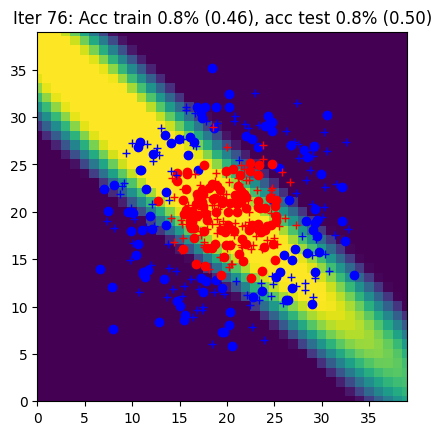

Iter 77: Acc train 0.8% (0.46), acc test 0.8% (0.50)


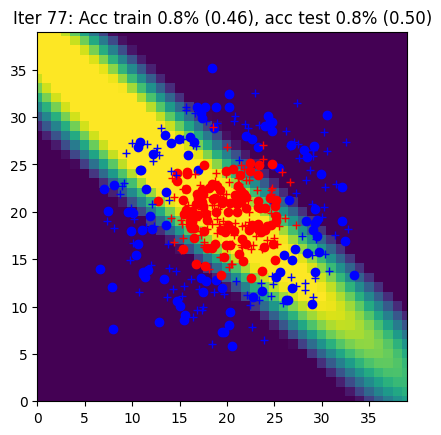

Iter 78: Acc train 0.8% (0.46), acc test 0.8% (0.50)


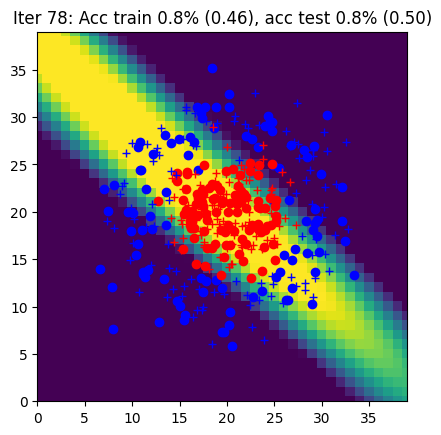

Iter 79: Acc train 0.8% (0.46), acc test 0.8% (0.50)


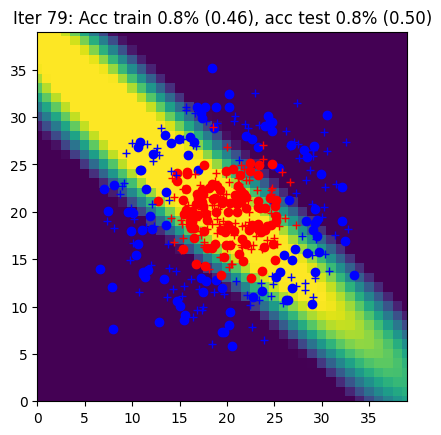

Iter 80: Acc train 0.8% (0.45), acc test 0.8% (0.50)


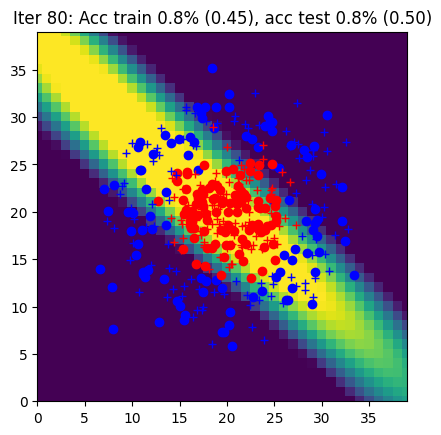

Iter 81: Acc train 0.8% (0.45), acc test 0.8% (0.50)


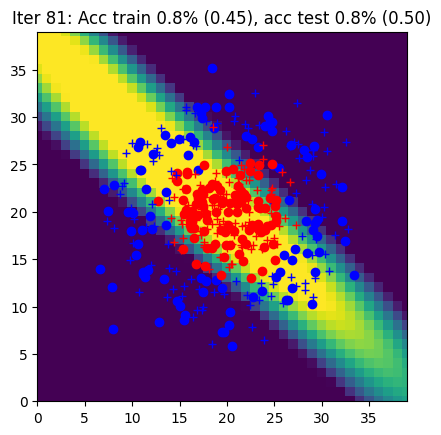

Iter 82: Acc train 0.8% (0.45), acc test 0.8% (0.50)


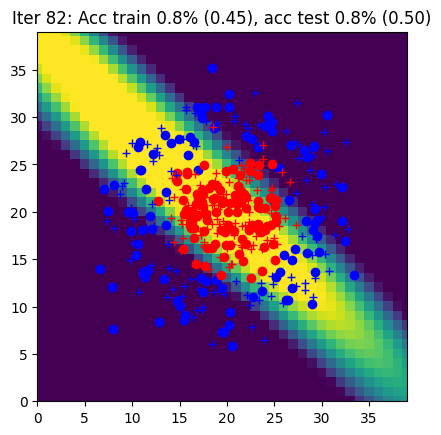

Iter 83: Acc train 0.8% (0.45), acc test 0.8% (0.50)


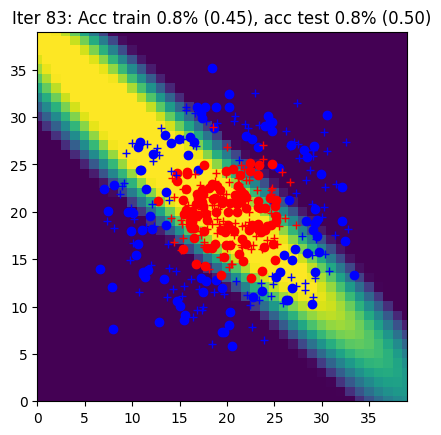

Iter 84: Acc train 0.8% (0.45), acc test 0.8% (0.50)


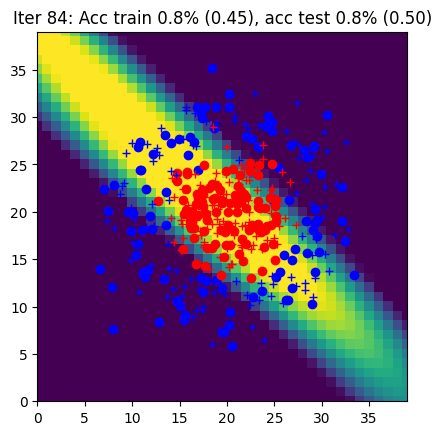

Iter 85: Acc train 0.8% (0.45), acc test 0.8% (0.50)


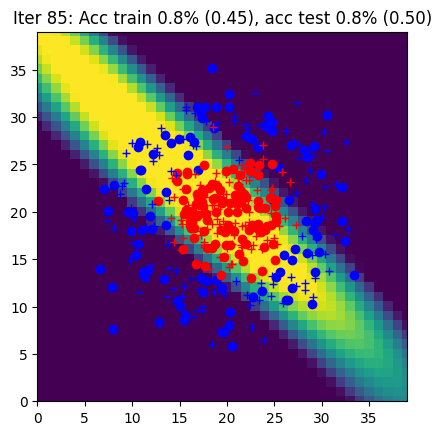

Iter 86: Acc train 0.8% (0.45), acc test 0.8% (0.49)


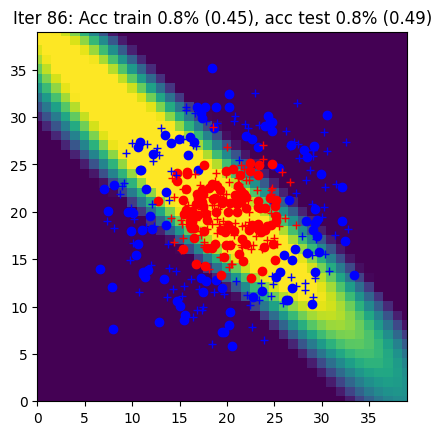

Iter 87: Acc train 0.8% (0.44), acc test 0.8% (0.49)


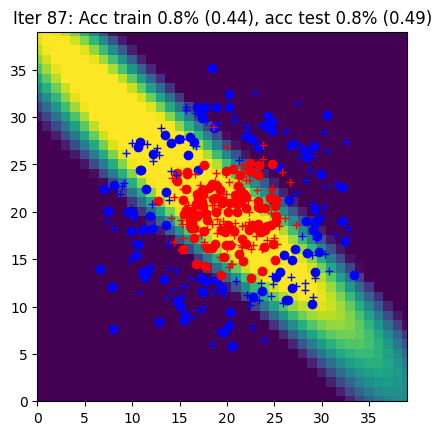

Iter 88: Acc train 0.8% (0.44), acc test 0.8% (0.49)


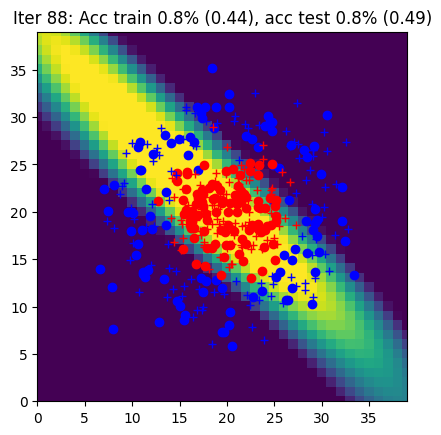

Iter 89: Acc train 0.8% (0.44), acc test 0.8% (0.49)


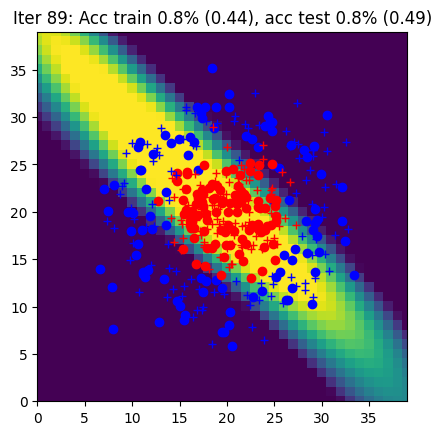

Iter 90: Acc train 0.8% (0.44), acc test 0.8% (0.49)


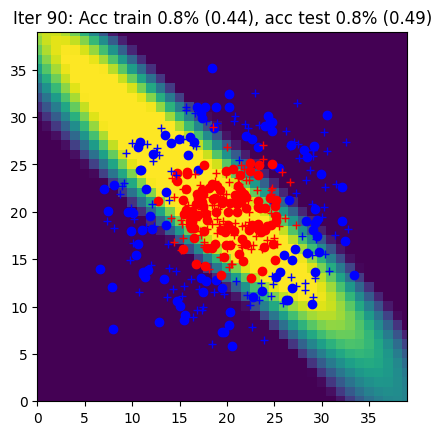

Iter 91: Acc train 0.8% (0.44), acc test 0.8% (0.49)


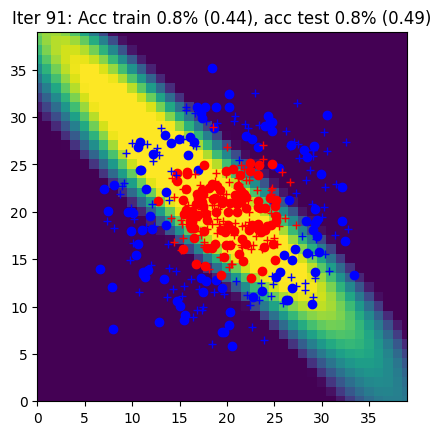

Iter 92: Acc train 0.8% (0.44), acc test 0.8% (0.48)


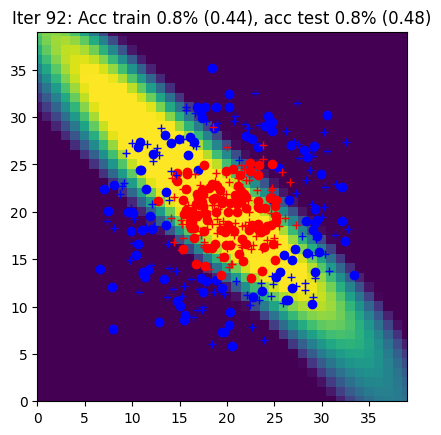

Iter 93: Acc train 0.8% (0.43), acc test 0.8% (0.48)


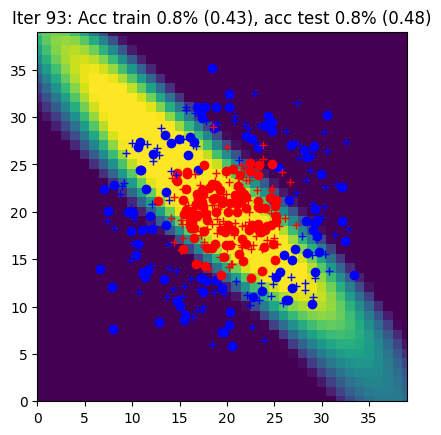

Iter 94: Acc train 0.8% (0.43), acc test 0.8% (0.48)


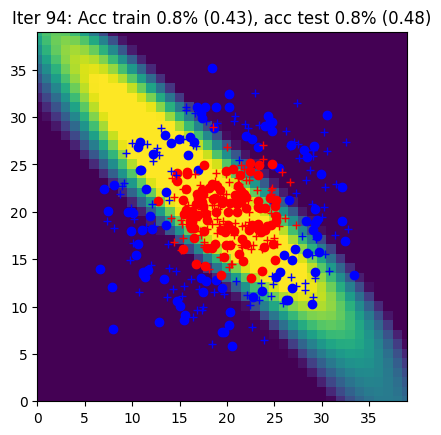

Iter 95: Acc train 0.8% (0.43), acc test 0.8% (0.48)


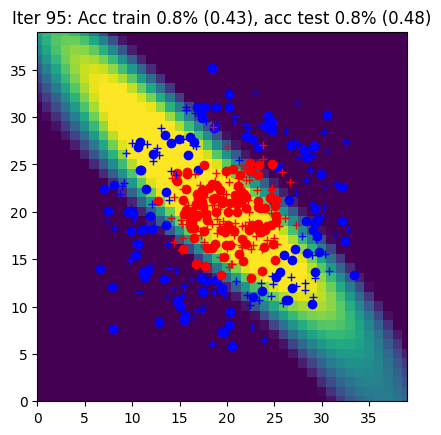

Iter 96: Acc train 0.8% (0.43), acc test 0.8% (0.48)


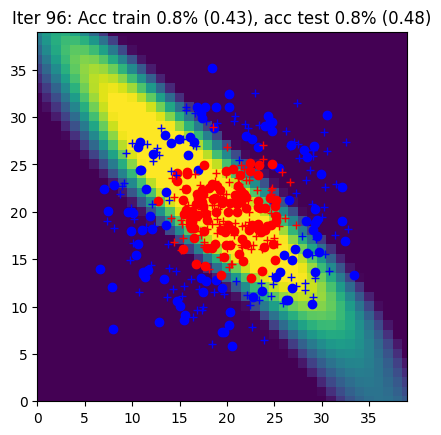

Iter 97: Acc train 0.8% (0.43), acc test 0.8% (0.47)


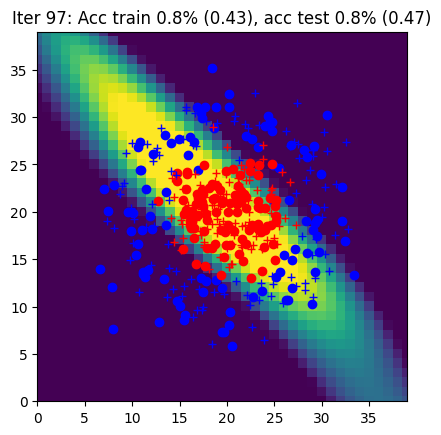

Iter 98: Acc train 0.8% (0.42), acc test 0.8% (0.47)


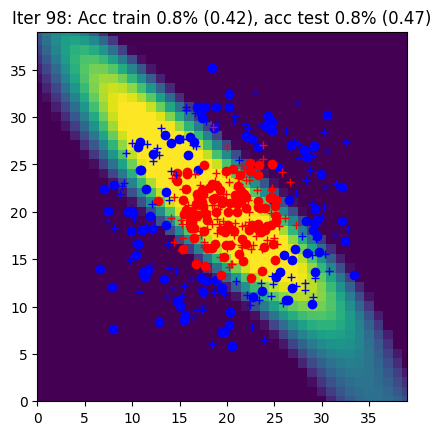

Iter 99: Acc train 0.8% (0.42), acc test 0.8% (0.47)


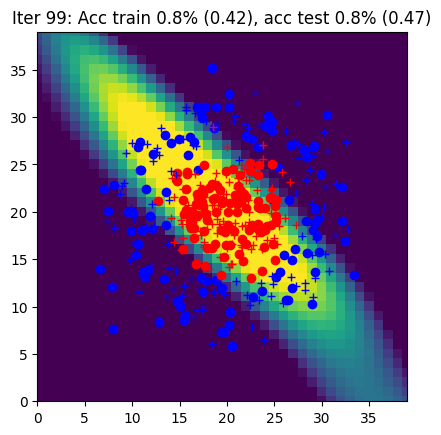

Iter 100: Acc train 0.8% (0.42), acc test 0.8% (0.47)


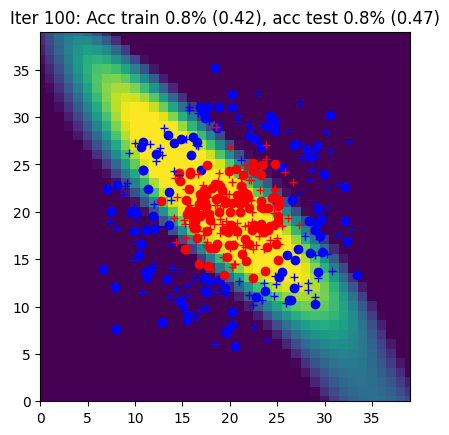

Iter 101: Acc train 0.8% (0.42), acc test 0.8% (0.46)


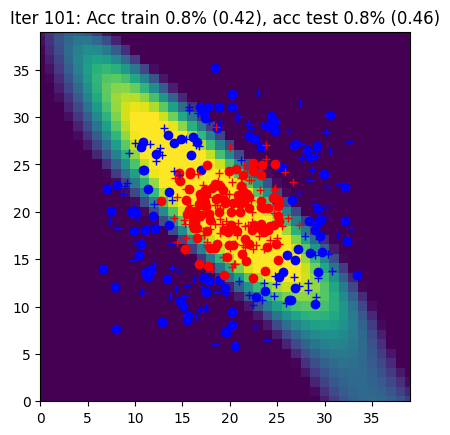

Iter 102: Acc train 0.8% (0.41), acc test 0.8% (0.46)


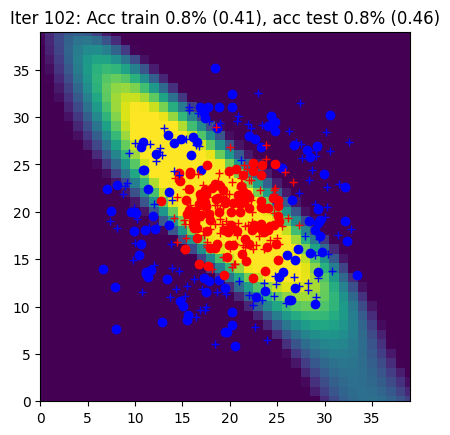

Iter 103: Acc train 0.8% (0.41), acc test 0.8% (0.46)


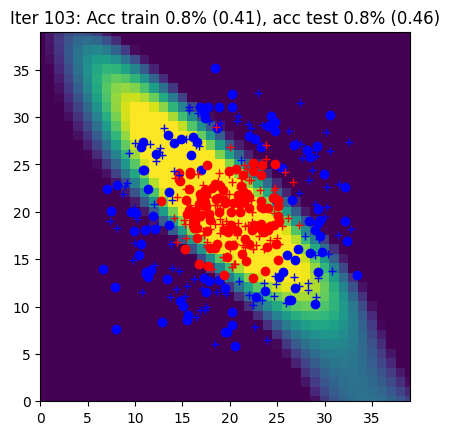

Iter 104: Acc train 0.8% (0.41), acc test 0.8% (0.45)


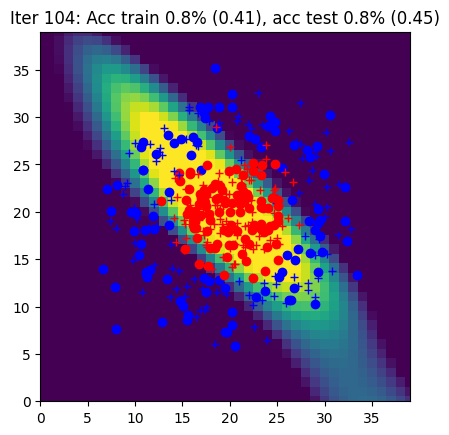

Iter 105: Acc train 0.8% (0.40), acc test 0.8% (0.45)


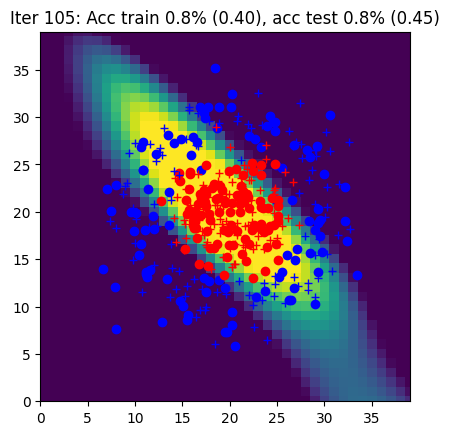

Iter 106: Acc train 0.8% (0.40), acc test 0.8% (0.45)


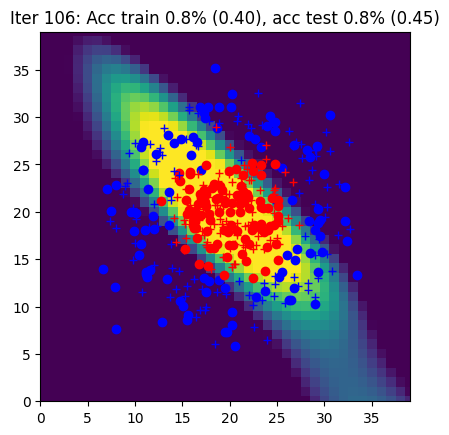

Iter 107: Acc train 0.8% (0.40), acc test 0.8% (0.44)


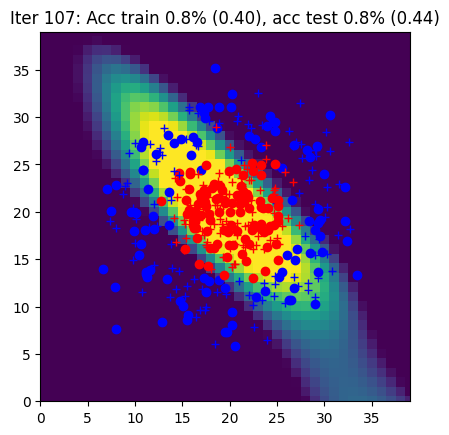

Iter 108: Acc train 0.8% (0.40), acc test 0.8% (0.44)


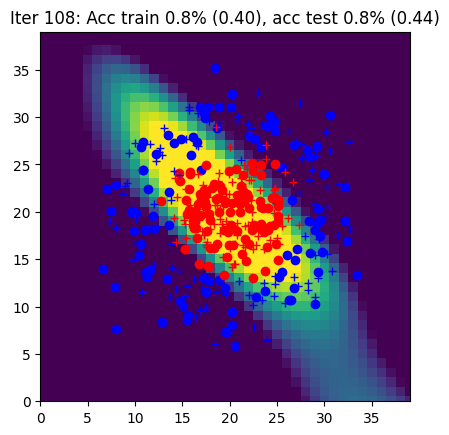

Iter 109: Acc train 0.8% (0.39), acc test 0.8% (0.43)


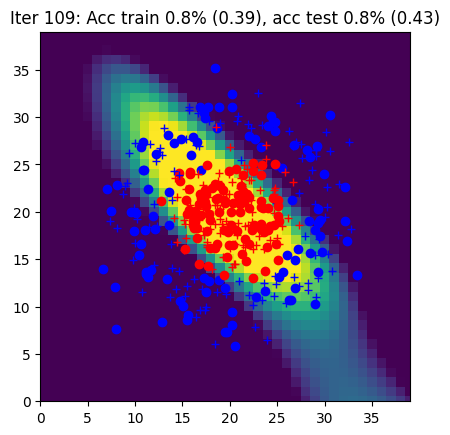

Iter 110: Acc train 0.8% (0.39), acc test 0.8% (0.43)


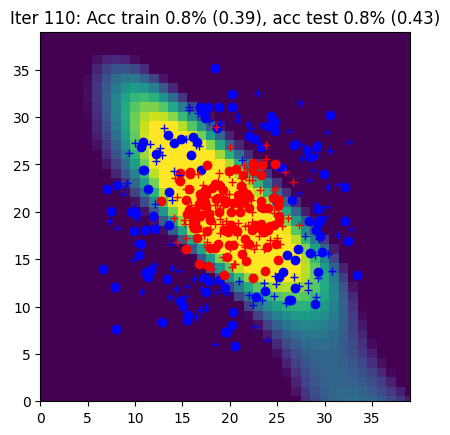

Iter 111: Acc train 0.8% (0.38), acc test 0.8% (0.43)


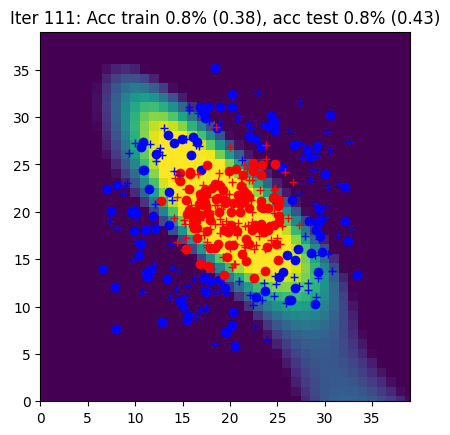

Iter 112: Acc train 0.8% (0.38), acc test 0.8% (0.42)


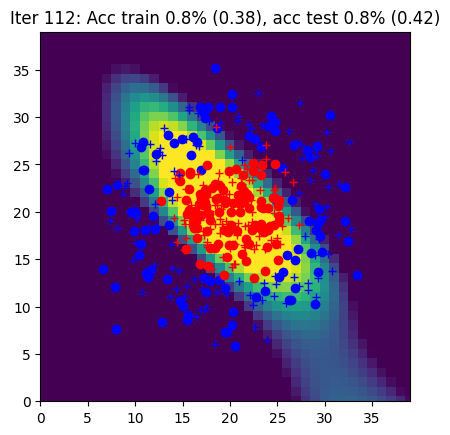

Iter 113: Acc train 0.8% (0.38), acc test 0.8% (0.42)


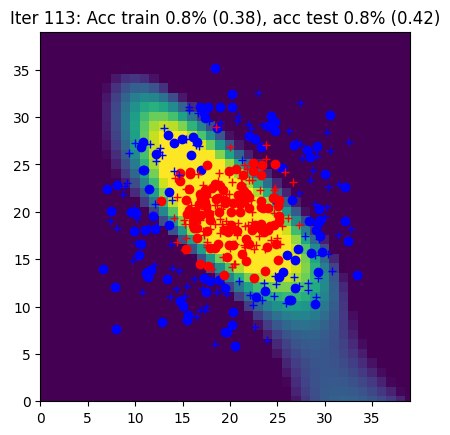

Iter 114: Acc train 0.8% (0.37), acc test 0.8% (0.41)


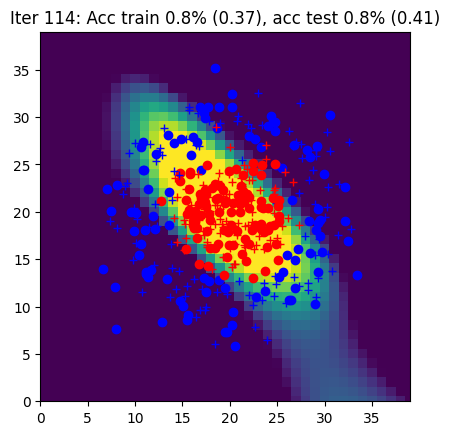

Iter 115: Acc train 0.8% (0.37), acc test 0.8% (0.41)


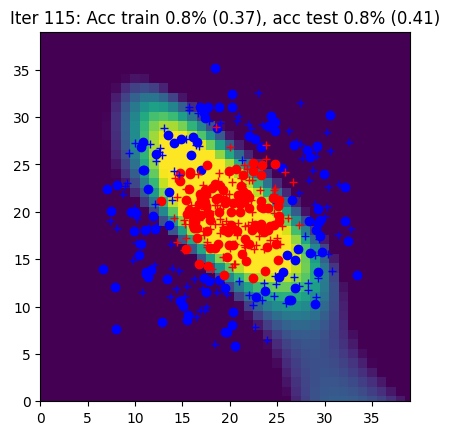

Iter 116: Acc train 0.8% (0.37), acc test 0.8% (0.40)


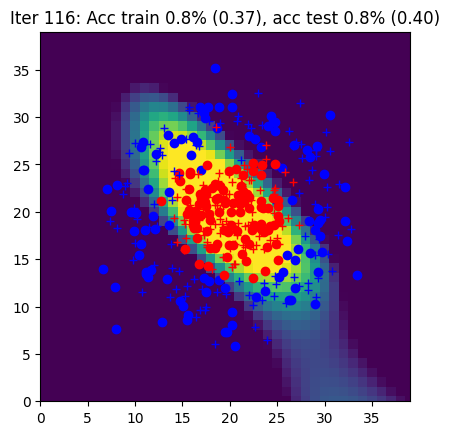

Iter 117: Acc train 0.8% (0.36), acc test 0.8% (0.40)


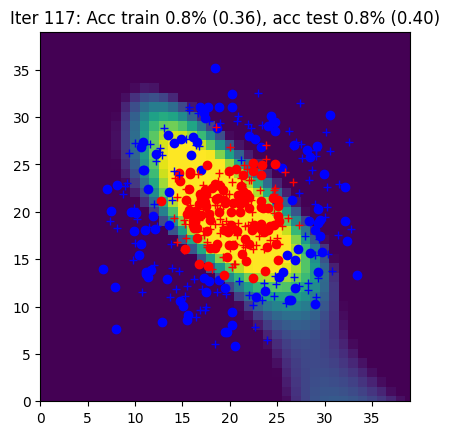

Iter 118: Acc train 0.9% (0.36), acc test 0.8% (0.40)


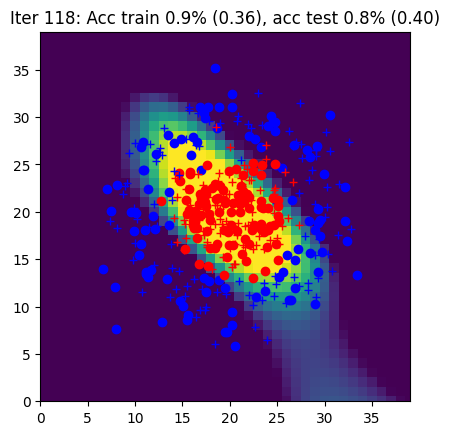

Iter 119: Acc train 0.9% (0.36), acc test 0.8% (0.39)


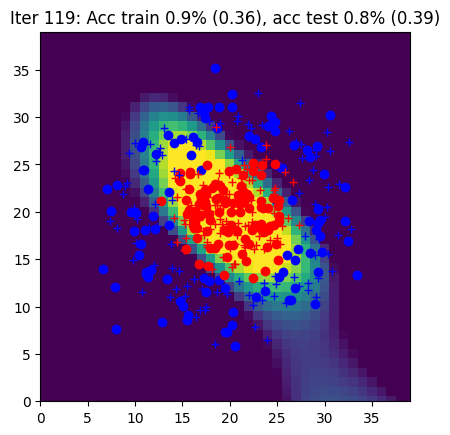

Iter 120: Acc train 0.9% (0.35), acc test 0.8% (0.39)


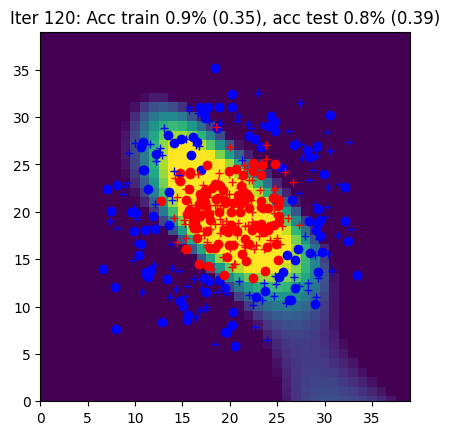

Iter 121: Acc train 0.9% (0.35), acc test 0.8% (0.38)


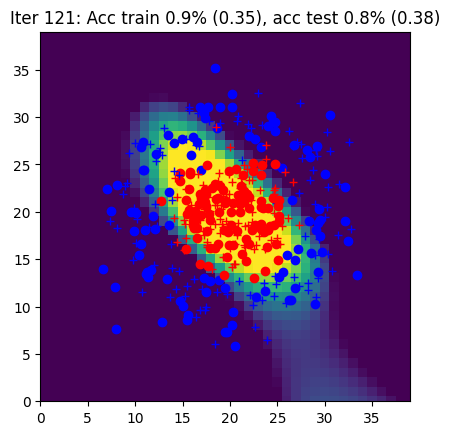

Iter 122: Acc train 0.9% (0.34), acc test 0.8% (0.38)


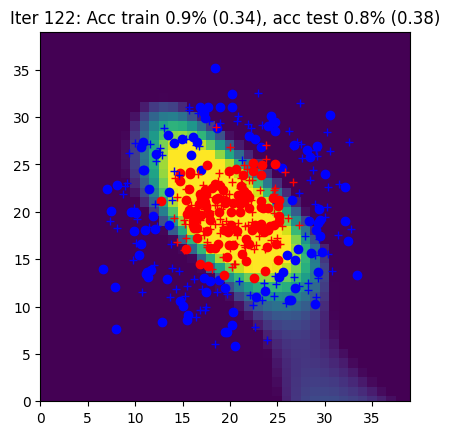

Iter 123: Acc train 0.9% (0.34), acc test 0.8% (0.37)


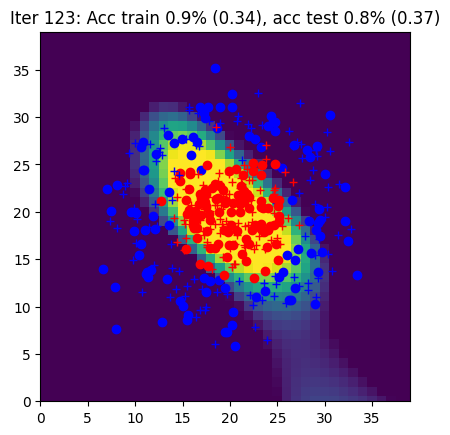

Iter 124: Acc train 0.9% (0.34), acc test 0.9% (0.37)


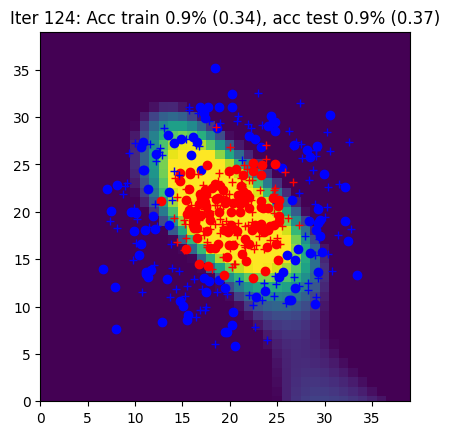

Iter 125: Acc train 0.9% (0.33), acc test 0.9% (0.36)


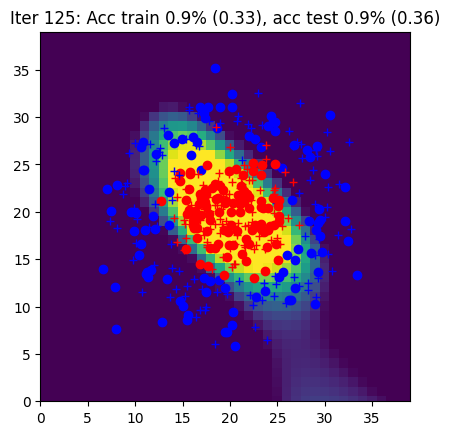

Iter 126: Acc train 0.9% (0.33), acc test 0.9% (0.36)


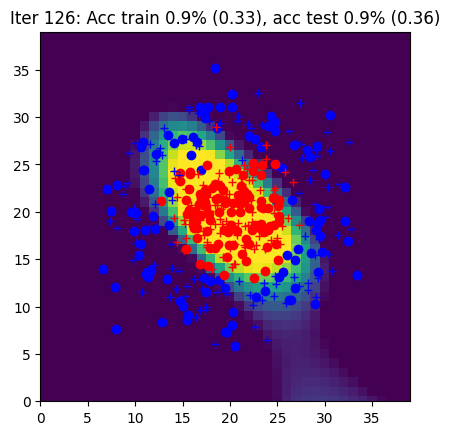

Iter 127: Acc train 0.9% (0.32), acc test 0.9% (0.35)


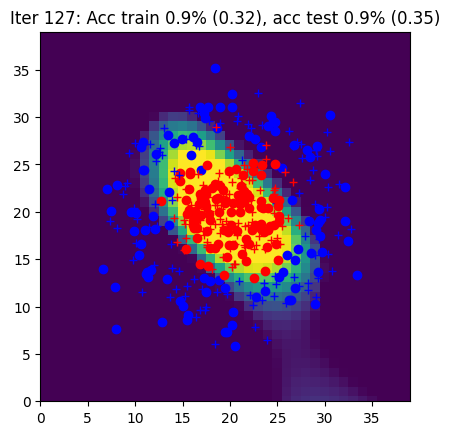

Iter 128: Acc train 0.9% (0.32), acc test 0.9% (0.35)


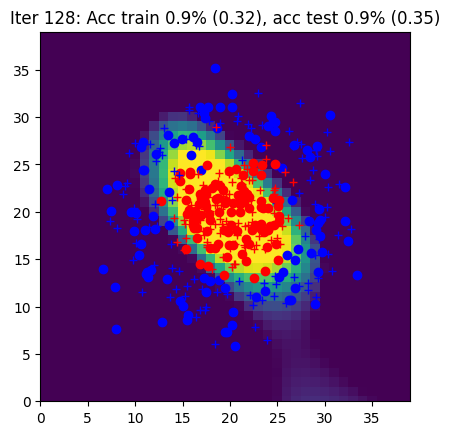

Iter 129: Acc train 0.9% (0.32), acc test 0.9% (0.34)


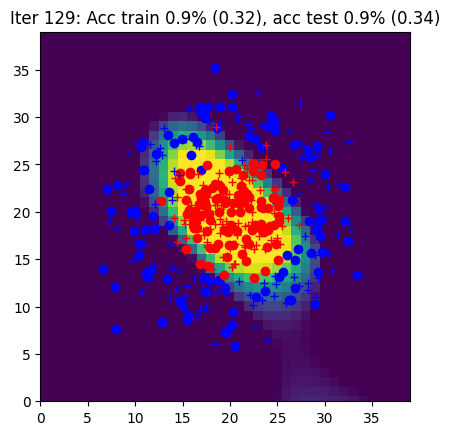

Iter 130: Acc train 0.9% (0.31), acc test 0.9% (0.34)


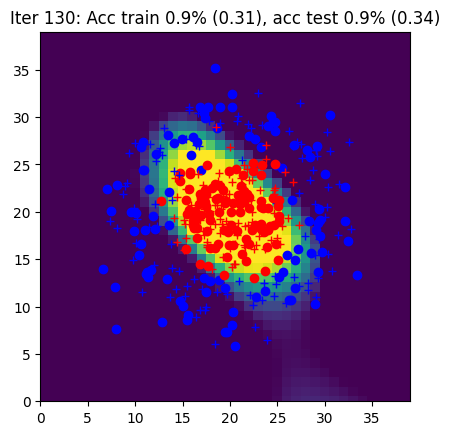

Iter 131: Acc train 0.9% (0.31), acc test 0.9% (0.33)


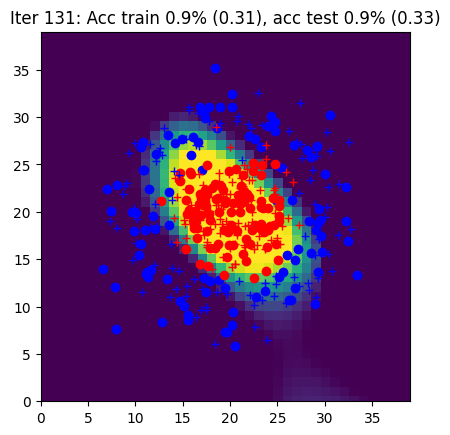

Iter 132: Acc train 0.9% (0.31), acc test 0.9% (0.33)


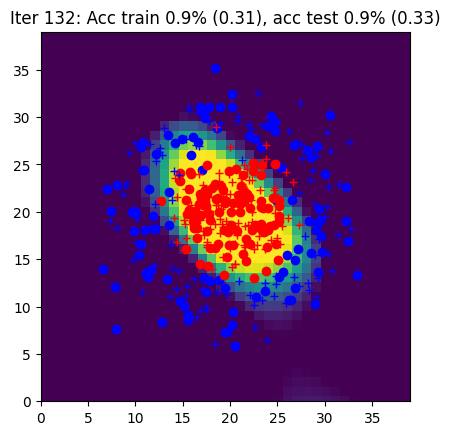

Iter 133: Acc train 0.9% (0.30), acc test 0.9% (0.33)


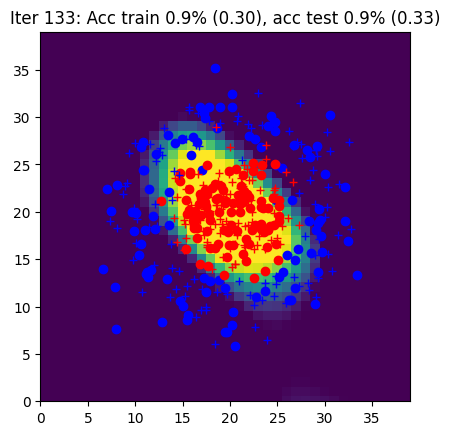

Iter 134: Acc train 0.9% (0.30), acc test 0.9% (0.32)


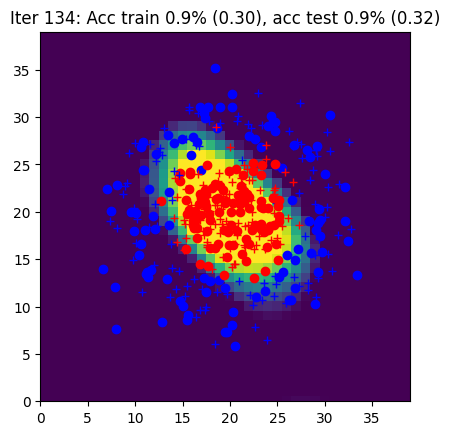

Iter 135: Acc train 0.9% (0.30), acc test 0.9% (0.32)


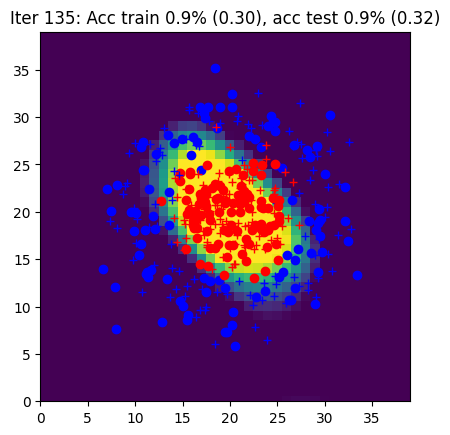

Iter 136: Acc train 0.9% (0.29), acc test 0.9% (0.31)


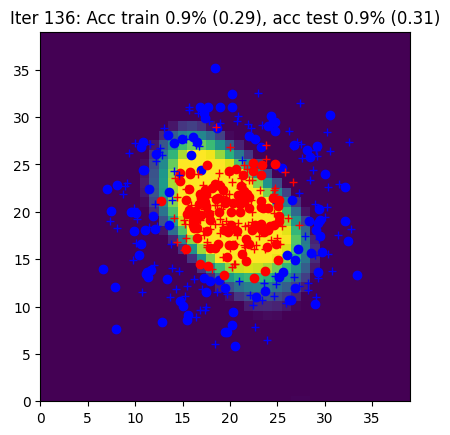

Iter 137: Acc train 0.9% (0.29), acc test 0.9% (0.31)


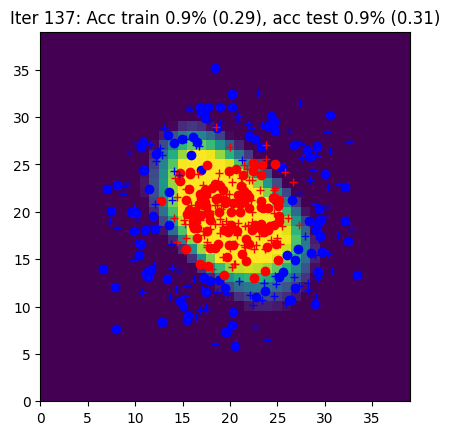

Iter 138: Acc train 0.9% (0.29), acc test 0.9% (0.31)


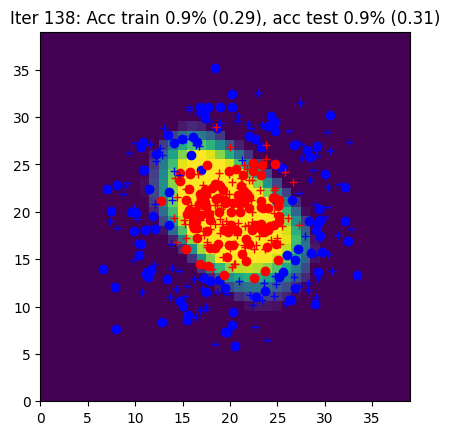

Iter 139: Acc train 0.9% (0.28), acc test 0.9% (0.30)


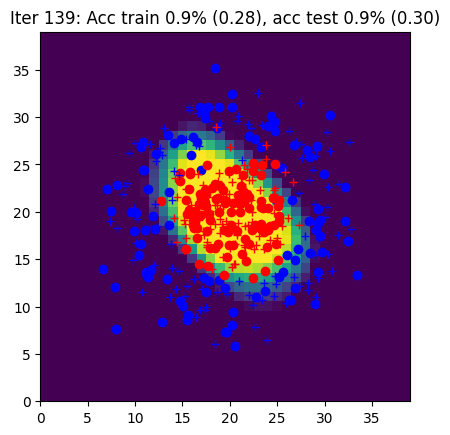

Iter 140: Acc train 0.9% (0.28), acc test 0.9% (0.30)


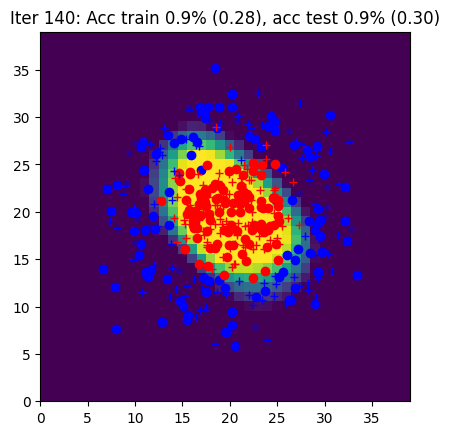

Iter 141: Acc train 0.9% (0.28), acc test 0.9% (0.30)


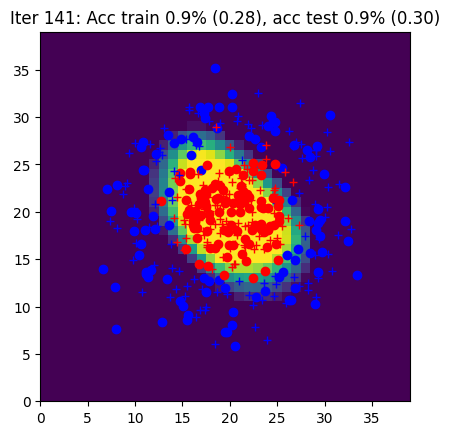

Iter 142: Acc train 0.9% (0.27), acc test 0.9% (0.29)


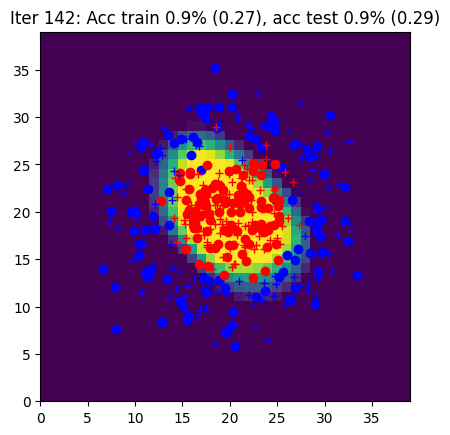

Iter 143: Acc train 0.9% (0.27), acc test 0.9% (0.29)


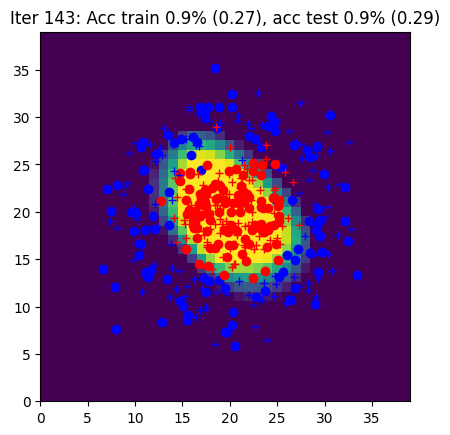

Iter 144: Acc train 0.9% (0.27), acc test 0.9% (0.28)


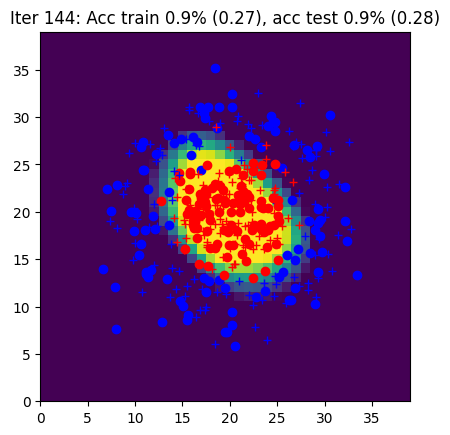

Iter 145: Acc train 0.9% (0.26), acc test 0.9% (0.28)


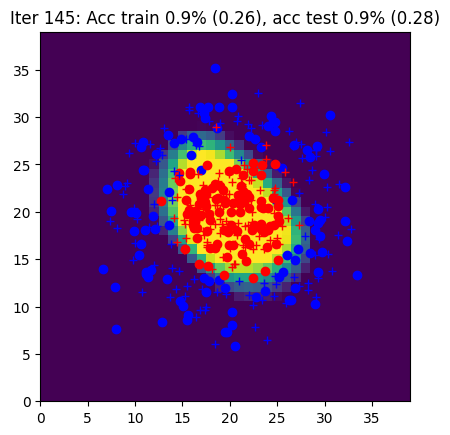

Iter 146: Acc train 0.9% (0.26), acc test 0.9% (0.28)


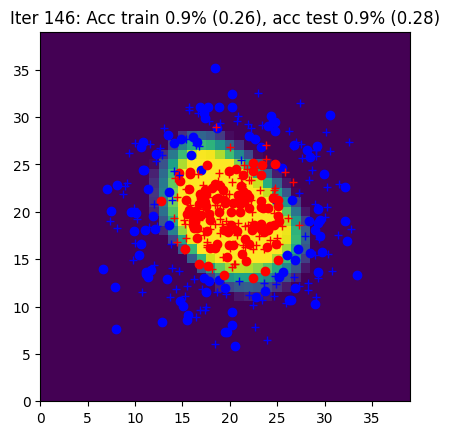

Iter 147: Acc train 0.9% (0.26), acc test 0.9% (0.27)


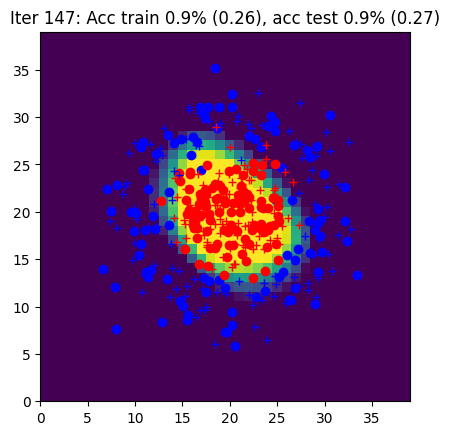

Iter 148: Acc train 0.9% (0.26), acc test 0.9% (0.27)


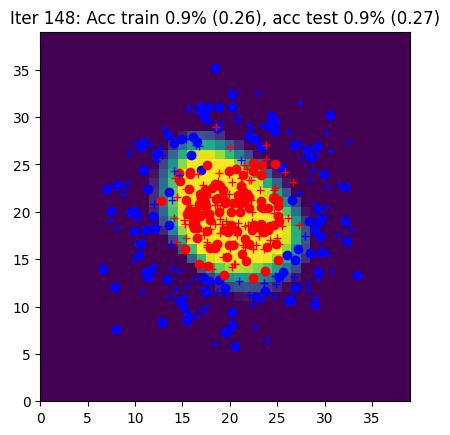

Iter 149: Acc train 0.9% (0.25), acc test 0.9% (0.27)


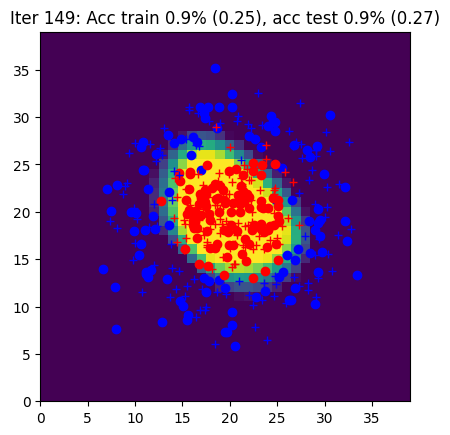

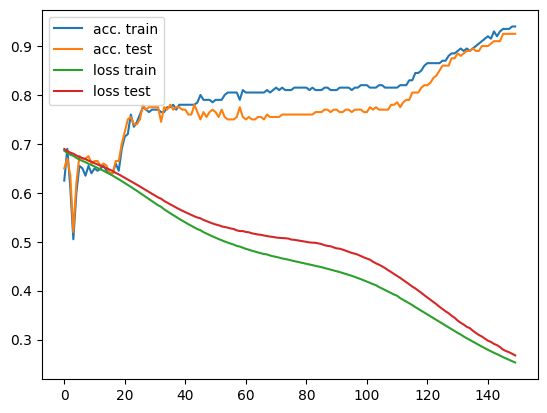

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]



        # write the optimization algorithm on the batch (X,Y)
        # using the functions: forward, loss_accuracy, sgd
        # and the backward function with autograd
        pred, outputs = forward(params, X)
        L, acc = loss_accuracy(pred, Y)
        L.backward(retain_graph=True)
        params = sgd(params, eta)

    ####################
    ##      END        #
    ####################


    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    # detach() is used to remove the predictions from the computational graph in autograd
    data.plot_data_with_grid(Ygrid.detach(), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain.detach())
    curves[3].append(Ltest.detach())

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 3 : Simplification of the forward pass with `torch.nn`

`init_params` and `forward` are replaced by the `init_model` function which defines the network architecture and the loss.

In [ ]:
def init_model(nx, nh, ny):

    #####################
    ## Your code here  ##
    #####################

    model = torch.nn.Sequential(
        torch.nn.Linear(nx,nh),
        torch.nn.Tanh(),
        torch.nn.Linear(nh,ny),
    )

    loss = torch.nn.CrossEntropyLoss()

    ####################
    ##      END        #
    ####################

    return model, loss

In [ ]:
def loss_accuracy(loss, Yhat, Y):

    #####################
    ## Your code here  ##
    #####################
    # call the loss function

    L = 0
    acc = 0

    # L = loss(Yhat, torch.argmax(Y, dim=1))
    L = loss(Yhat, Y).detach().item()
    acc = (torch.argmax(Yhat, dim=1) == torch.argmax(Y, dim=1)).type(torch.float).mean()



    ####################
    ##      END        #
    ####################

    return L, acc

In [ ]:
def sgd(model, eta):

    #####################
    ## Your code here  ##
    #####################
    # update the network weights
    # warning: use torch.no_grad()
    # and reset to zero the gradient accumulators

    with torch.no_grad():
      for p in model.parameters():
        if p.grad is not None:
          p -= eta*p.grad
          p.grad.zero_()


    ####################
    ##      END        #
    ####################
    return model

## Global learning procedure with autograd and `torch.nn`

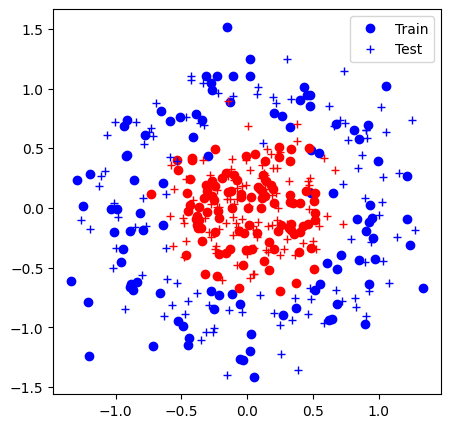

Iter 0: Acc train 0.5% (0.70), acc test 0.5% (0.70)


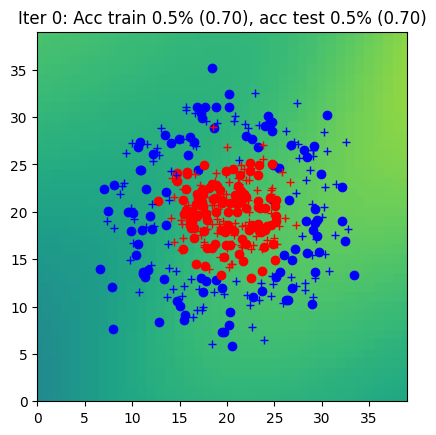

Iter 1: Acc train 0.5% (0.69), acc test 0.5% (0.70)


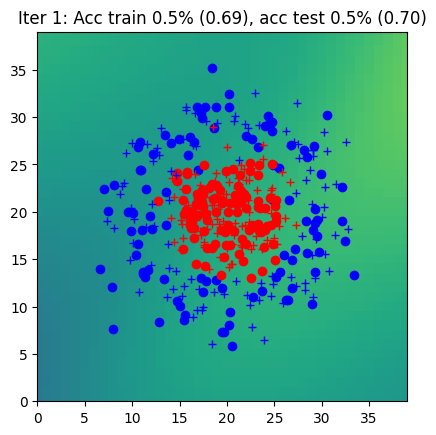

Iter 2: Acc train 0.6% (0.69), acc test 0.6% (0.69)


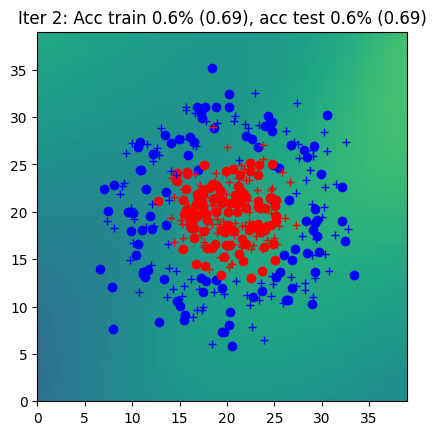

Iter 3: Acc train 0.6% (0.69), acc test 0.6% (0.69)


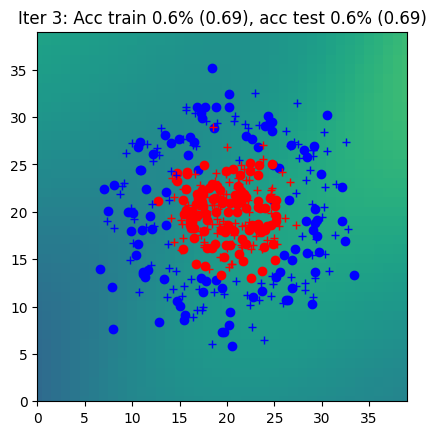

Iter 4: Acc train 0.6% (0.69), acc test 0.6% (0.69)


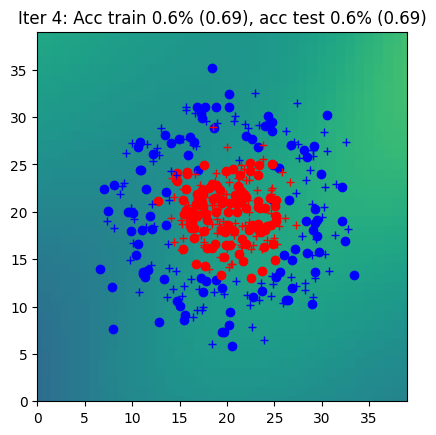

Iter 5: Acc train 0.6% (0.69), acc test 0.6% (0.69)


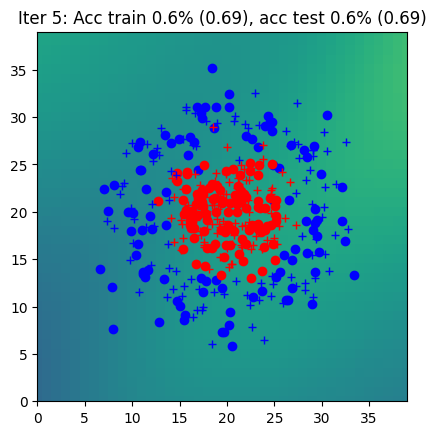

Iter 6: Acc train 0.7% (0.69), acc test 0.6% (0.69)


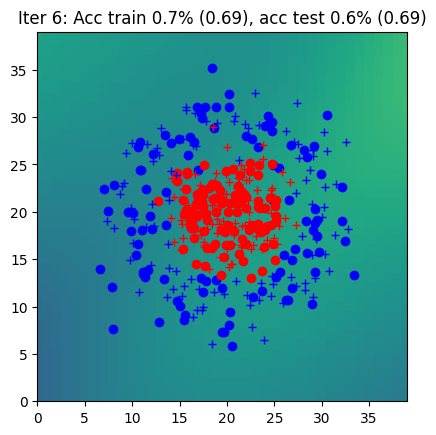

Iter 7: Acc train 0.6% (0.69), acc test 0.6% (0.69)


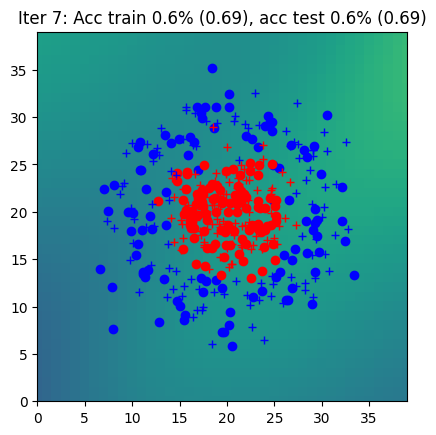

Iter 8: Acc train 0.6% (0.69), acc test 0.6% (0.69)


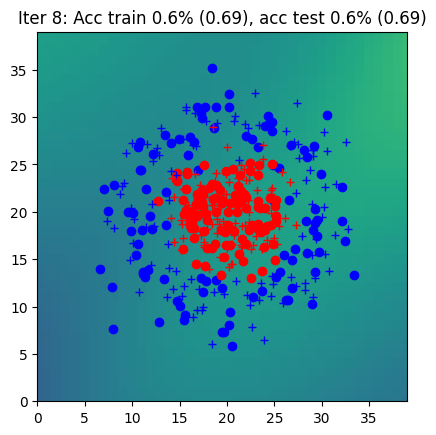

Iter 9: Acc train 0.6% (0.69), acc test 0.6% (0.69)


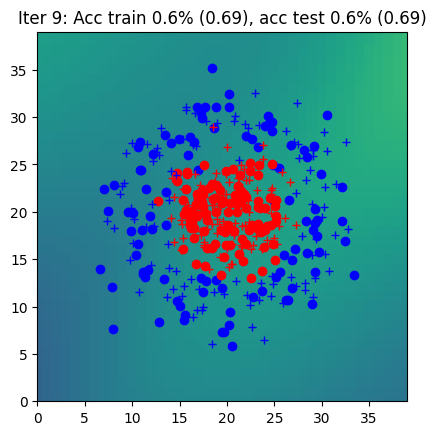

Iter 10: Acc train 0.7% (0.69), acc test 0.6% (0.69)


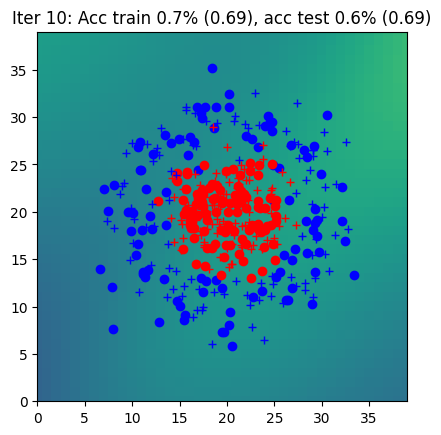

Iter 11: Acc train 0.7% (0.69), acc test 0.6% (0.69)


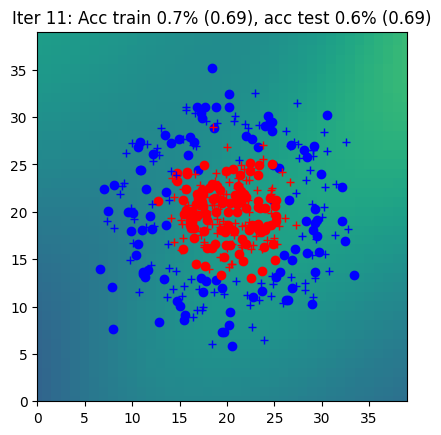

Iter 12: Acc train 0.6% (0.69), acc test 0.6% (0.69)


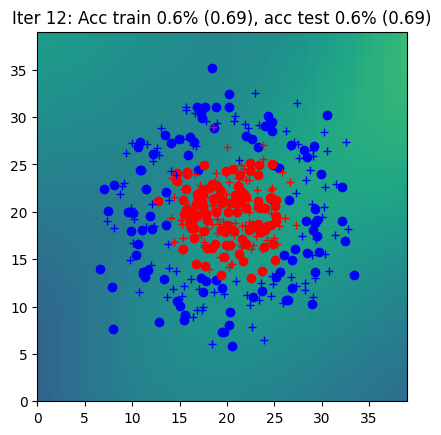

Iter 13: Acc train 0.6% (0.68), acc test 0.6% (0.69)


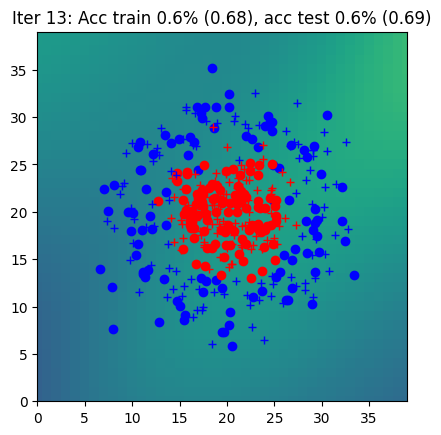

Iter 14: Acc train 0.7% (0.68), acc test 0.6% (0.69)


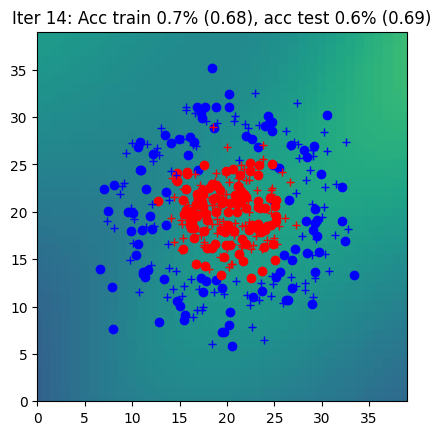

Iter 15: Acc train 0.6% (0.68), acc test 0.6% (0.69)


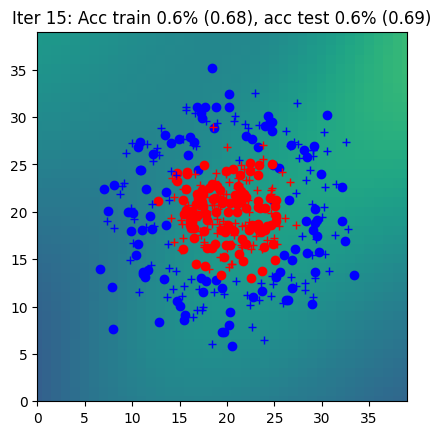

Iter 16: Acc train 0.6% (0.68), acc test 0.6% (0.68)


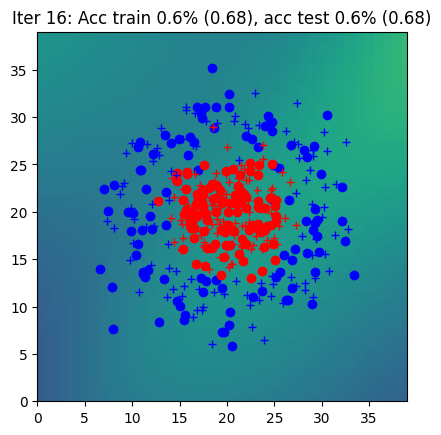

Iter 17: Acc train 0.6% (0.68), acc test 0.6% (0.68)


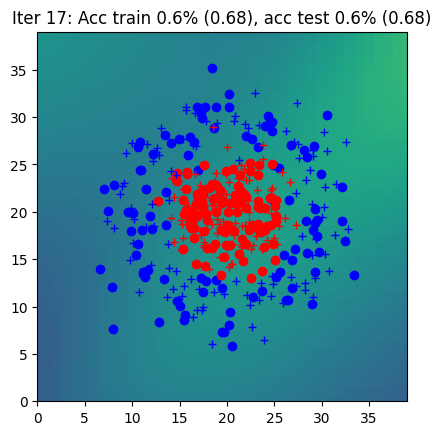

Iter 18: Acc train 0.6% (0.68), acc test 0.6% (0.68)


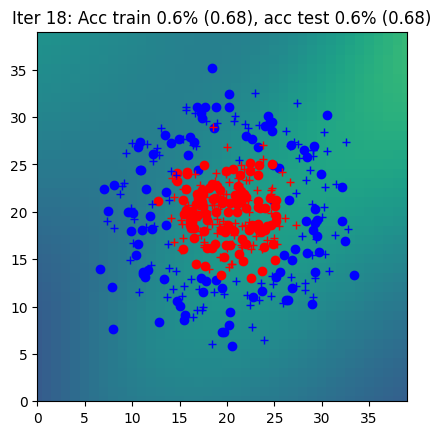

Iter 19: Acc train 0.6% (0.68), acc test 0.6% (0.68)


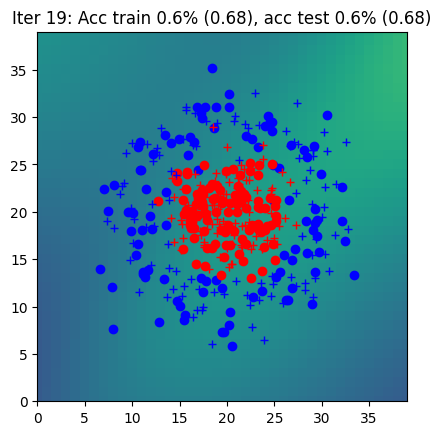

Iter 20: Acc train 0.7% (0.68), acc test 0.6% (0.68)


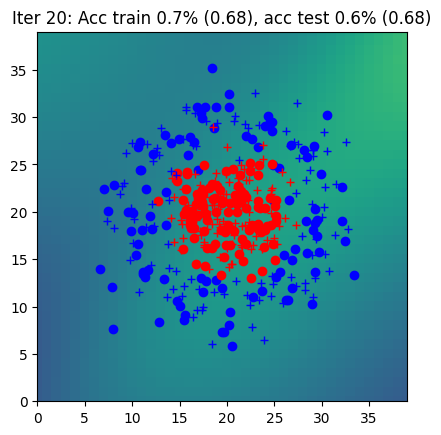

Iter 21: Acc train 0.6% (0.68), acc test 0.7% (0.68)


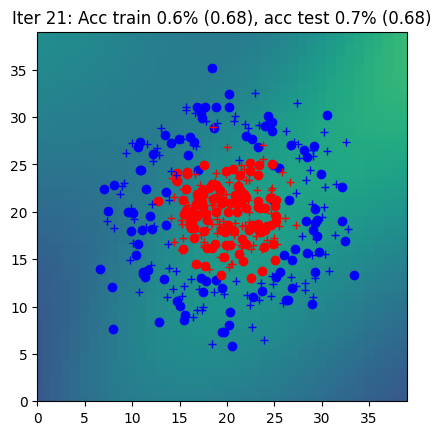

Iter 22: Acc train 0.6% (0.68), acc test 0.7% (0.68)


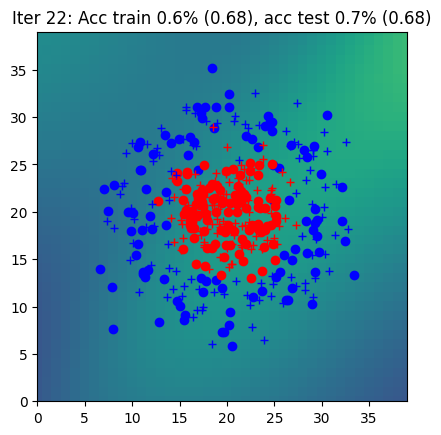

Iter 23: Acc train 0.7% (0.68), acc test 0.7% (0.68)


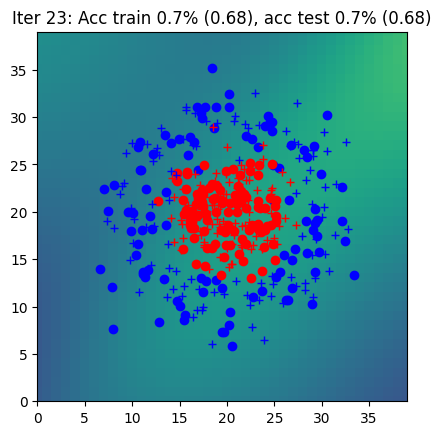

Iter 24: Acc train 0.7% (0.68), acc test 0.7% (0.68)


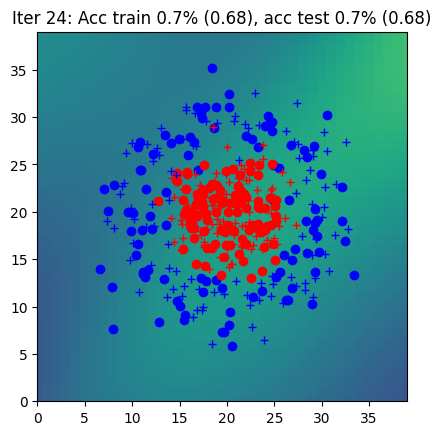

Iter 25: Acc train 0.7% (0.67), acc test 0.7% (0.68)


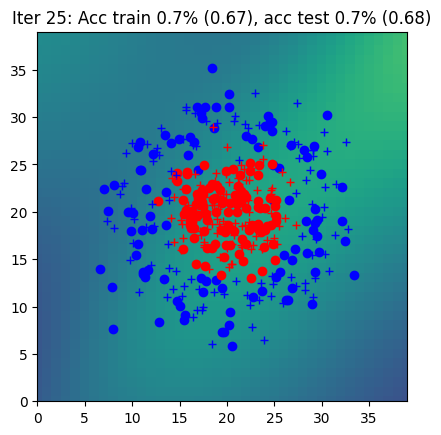

Iter 26: Acc train 0.7% (0.67), acc test 0.7% (0.68)


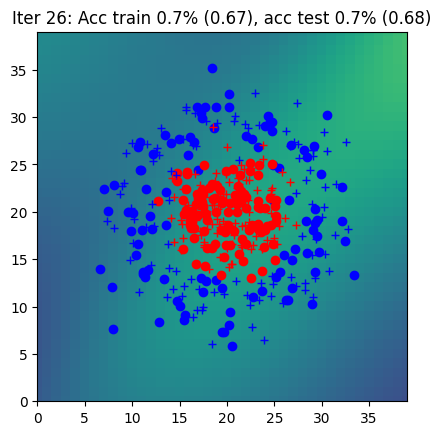

Iter 27: Acc train 0.7% (0.67), acc test 0.7% (0.67)


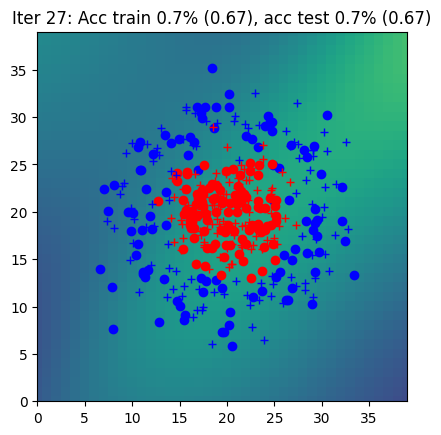

Iter 28: Acc train 0.7% (0.67), acc test 0.7% (0.67)


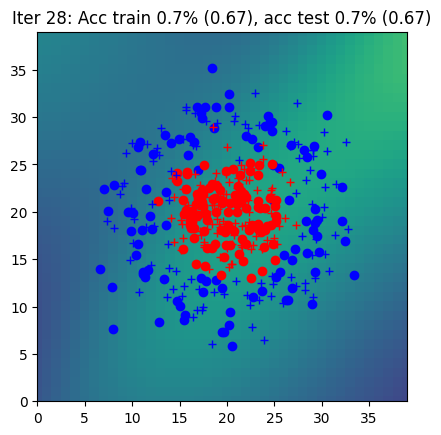

Iter 29: Acc train 0.7% (0.67), acc test 0.7% (0.67)


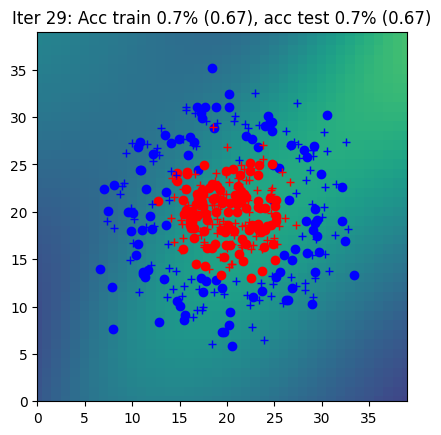

Iter 30: Acc train 0.7% (0.67), acc test 0.7% (0.67)


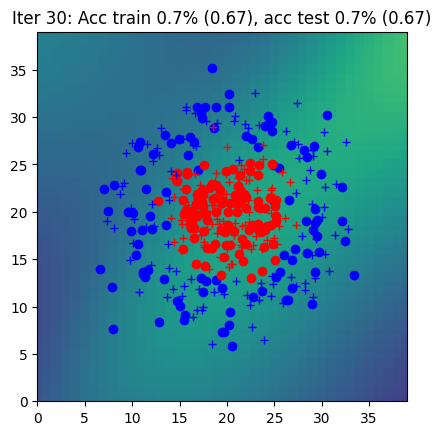

Iter 31: Acc train 0.7% (0.67), acc test 0.7% (0.67)


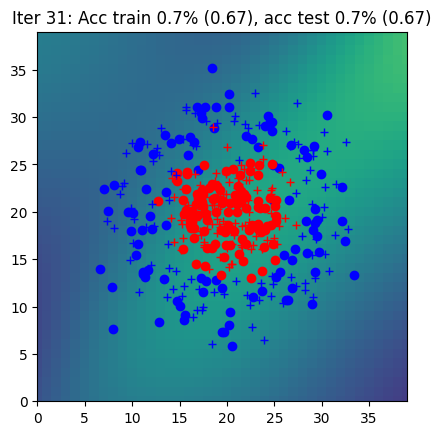

Iter 32: Acc train 0.7% (0.67), acc test 0.7% (0.67)


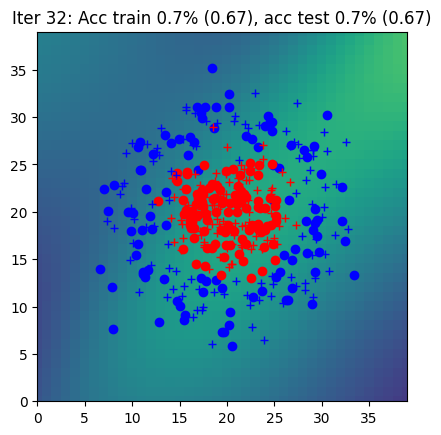

Iter 33: Acc train 0.7% (0.66), acc test 0.7% (0.67)


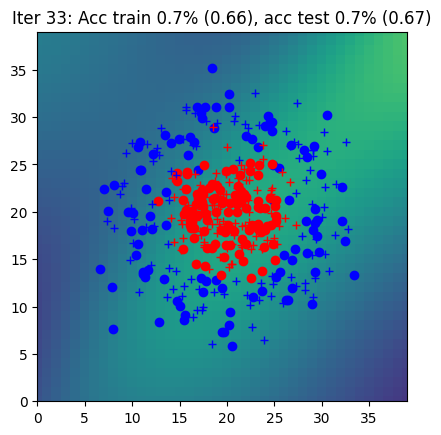

Iter 34: Acc train 0.7% (0.66), acc test 0.7% (0.66)


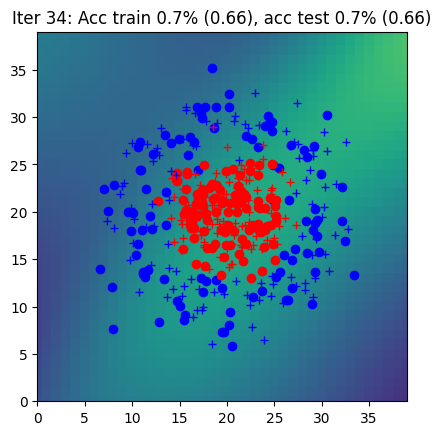

Iter 35: Acc train 0.7% (0.66), acc test 0.7% (0.66)


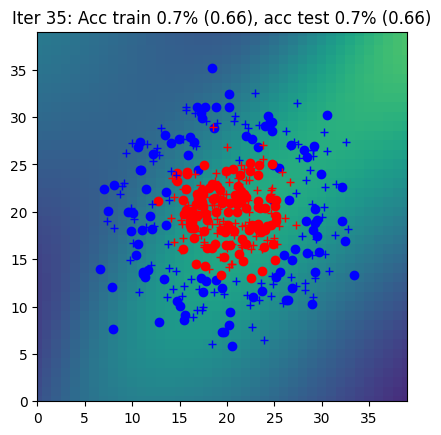

Iter 36: Acc train 0.7% (0.66), acc test 0.7% (0.66)


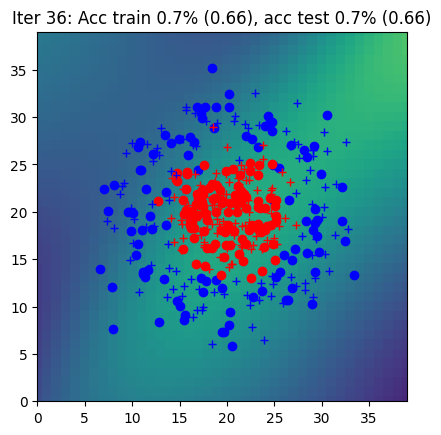

Iter 37: Acc train 0.7% (0.66), acc test 0.7% (0.66)


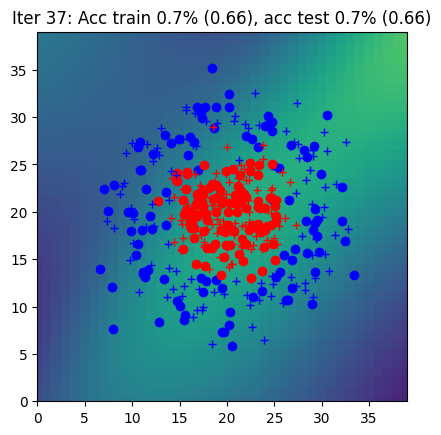

Iter 38: Acc train 0.7% (0.66), acc test 0.7% (0.66)


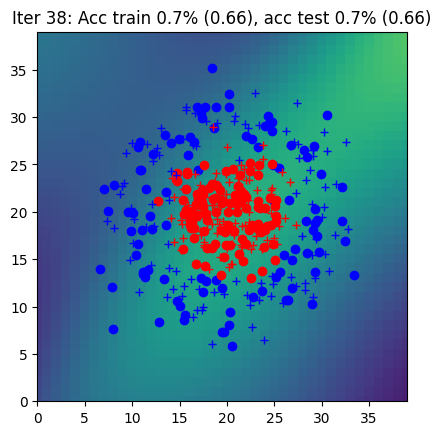

Iter 39: Acc train 0.7% (0.65), acc test 0.7% (0.66)


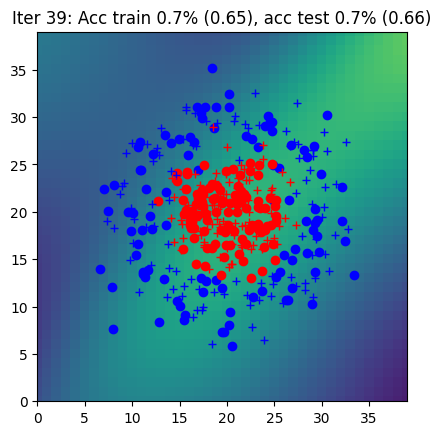

Iter 40: Acc train 0.7% (0.65), acc test 0.7% (0.65)


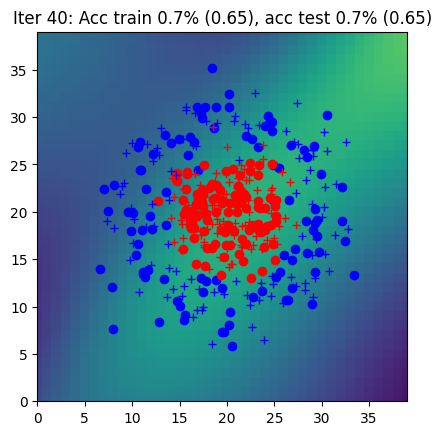

Iter 41: Acc train 0.7% (0.65), acc test 0.7% (0.65)


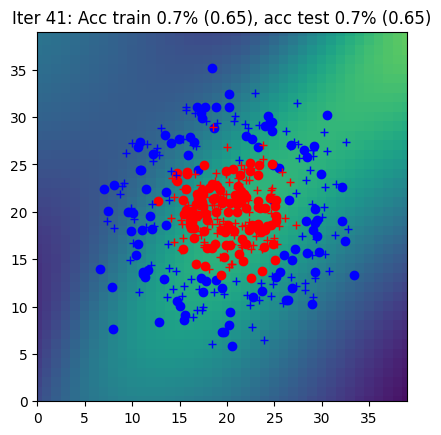

Iter 42: Acc train 0.7% (0.65), acc test 0.7% (0.65)


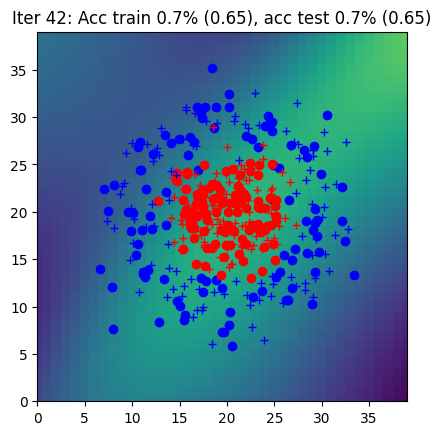

Iter 43: Acc train 0.7% (0.65), acc test 0.7% (0.65)


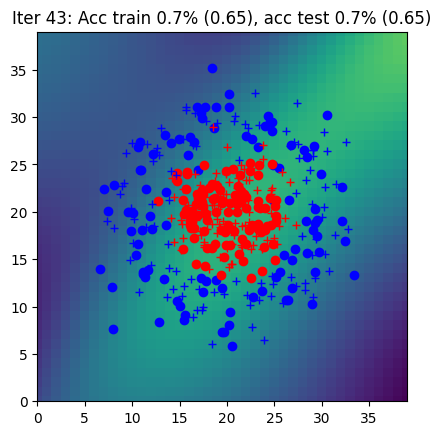

Iter 44: Acc train 0.7% (0.64), acc test 0.7% (0.65)


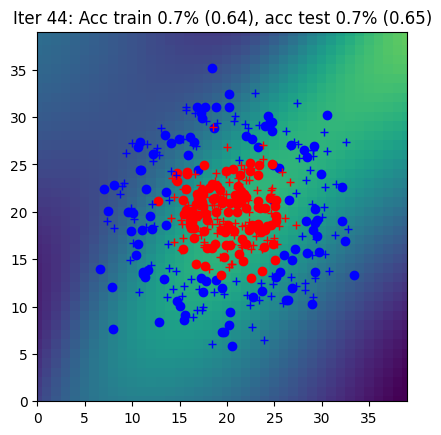

Iter 45: Acc train 0.7% (0.64), acc test 0.7% (0.64)


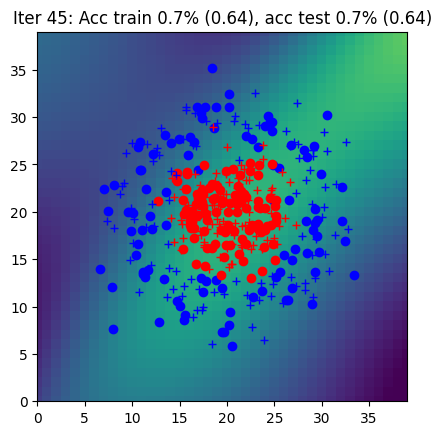

Iter 46: Acc train 0.7% (0.64), acc test 0.7% (0.64)


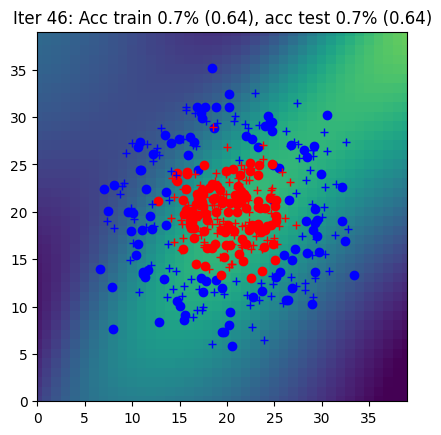

Iter 47: Acc train 0.7% (0.64), acc test 0.7% (0.64)


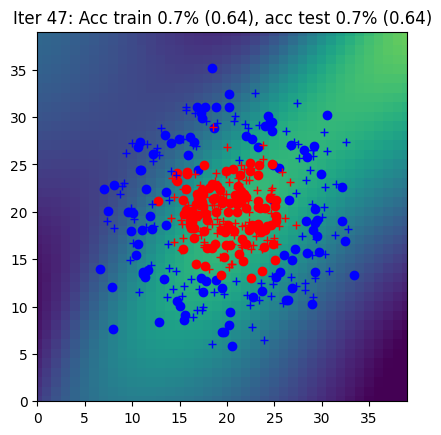

Iter 48: Acc train 0.7% (0.63), acc test 0.7% (0.64)


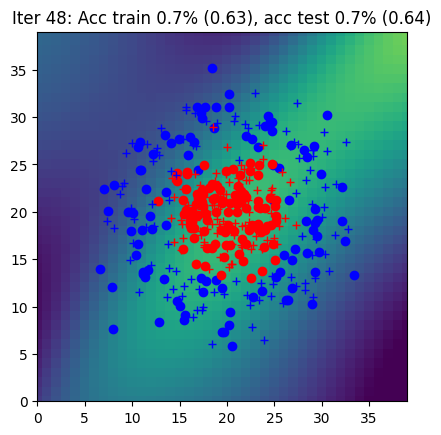

Iter 49: Acc train 0.7% (0.63), acc test 0.7% (0.63)


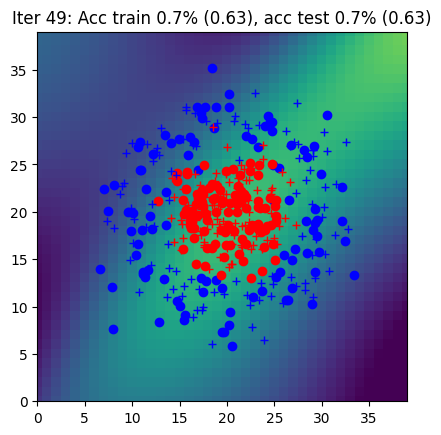

Iter 50: Acc train 0.7% (0.63), acc test 0.7% (0.63)


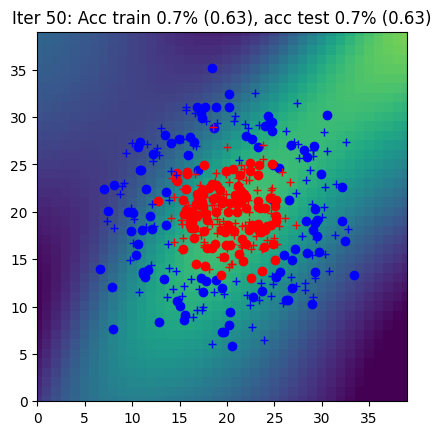

Iter 51: Acc train 0.7% (0.63), acc test 0.7% (0.63)


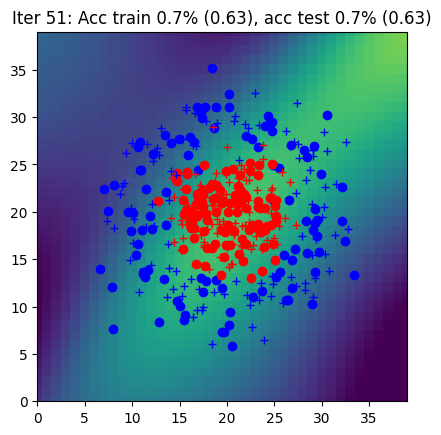

Iter 52: Acc train 0.7% (0.62), acc test 0.7% (0.63)


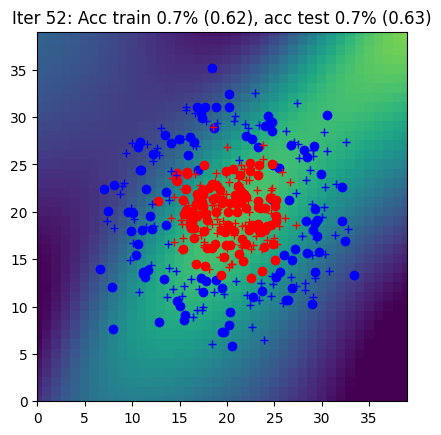

Iter 53: Acc train 0.7% (0.62), acc test 0.7% (0.62)


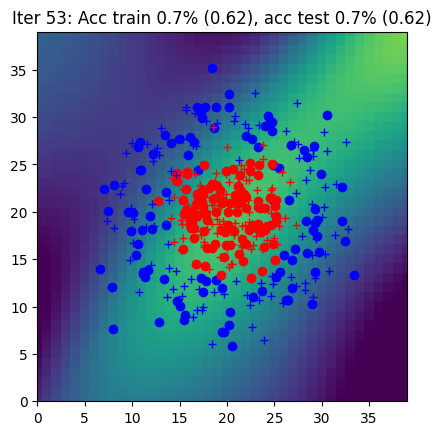

Iter 54: Acc train 0.7% (0.62), acc test 0.7% (0.62)


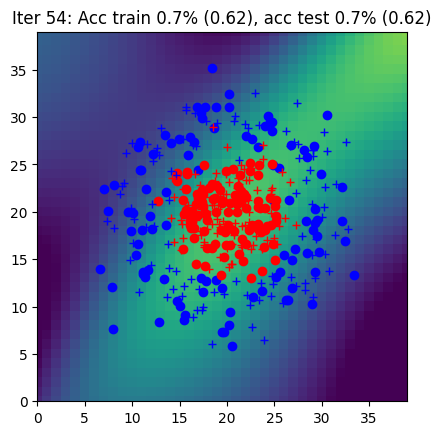

Iter 55: Acc train 0.8% (0.61), acc test 0.8% (0.62)


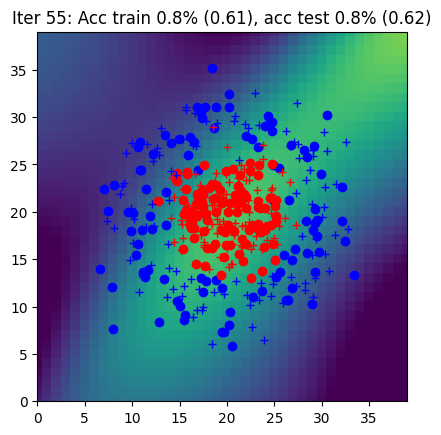

Iter 56: Acc train 0.8% (0.61), acc test 0.8% (0.61)


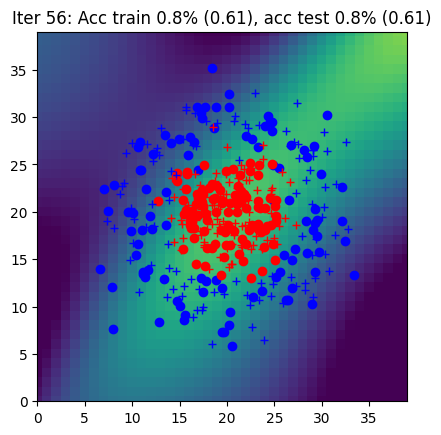

Iter 57: Acc train 0.8% (0.61), acc test 0.8% (0.61)


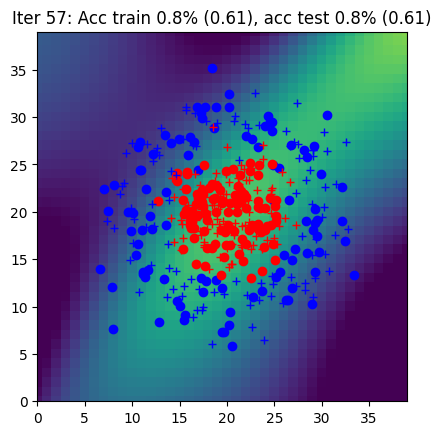

Iter 58: Acc train 0.8% (0.61), acc test 0.8% (0.61)


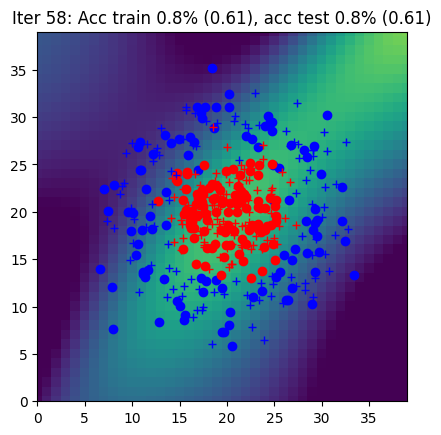

Iter 59: Acc train 0.8% (0.60), acc test 0.8% (0.60)


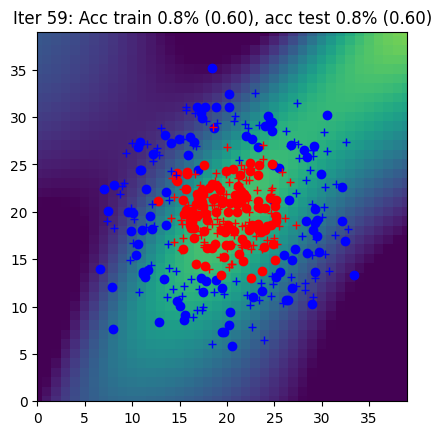

Iter 60: Acc train 0.8% (0.60), acc test 0.8% (0.60)


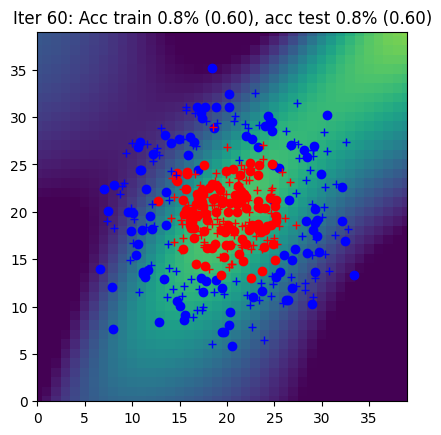

Iter 61: Acc train 0.8% (0.60), acc test 0.8% (0.60)


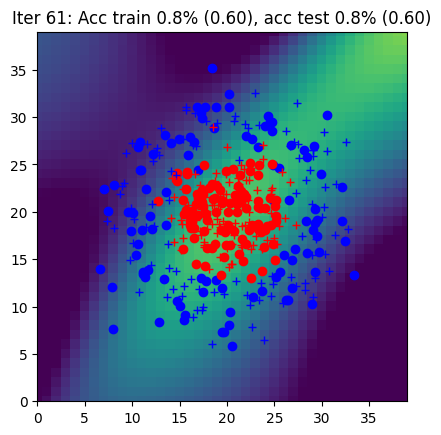

Iter 62: Acc train 0.8% (0.59), acc test 0.8% (0.59)


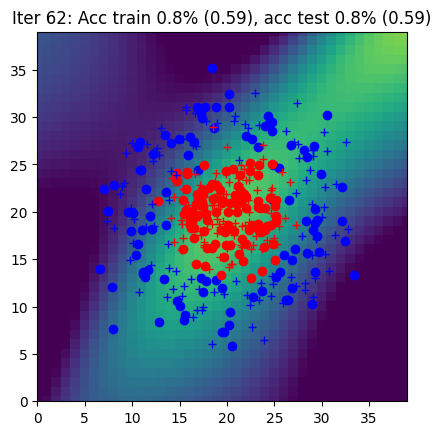

Iter 63: Acc train 0.8% (0.59), acc test 0.8% (0.59)


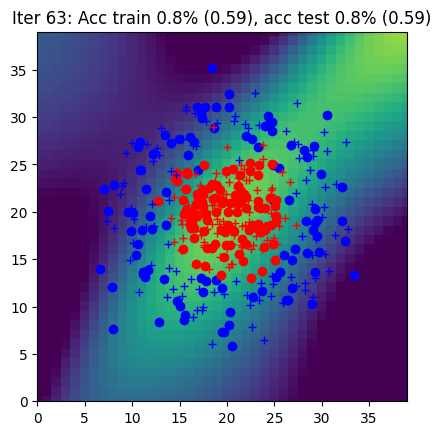

Iter 64: Acc train 0.8% (0.58), acc test 0.8% (0.59)


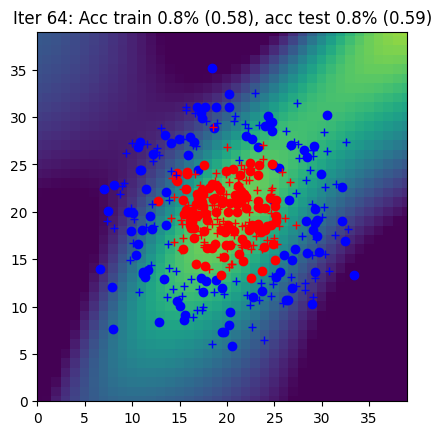

Iter 65: Acc train 0.8% (0.58), acc test 0.8% (0.58)


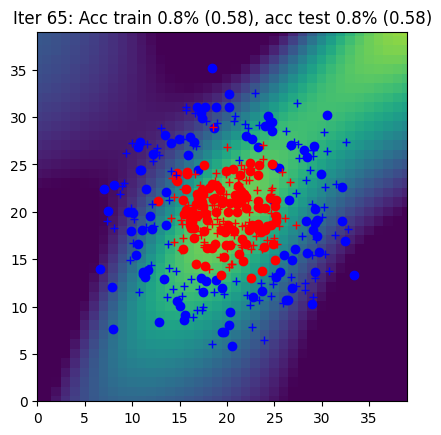

Iter 66: Acc train 0.8% (0.58), acc test 0.8% (0.58)


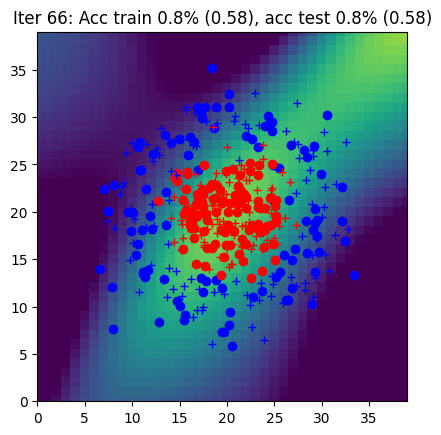

Iter 67: Acc train 0.8% (0.57), acc test 0.8% (0.57)


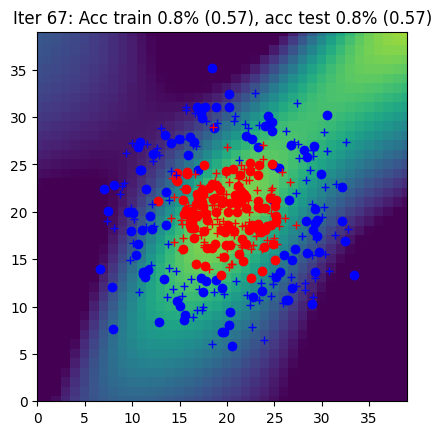

Iter 68: Acc train 0.8% (0.57), acc test 0.8% (0.57)


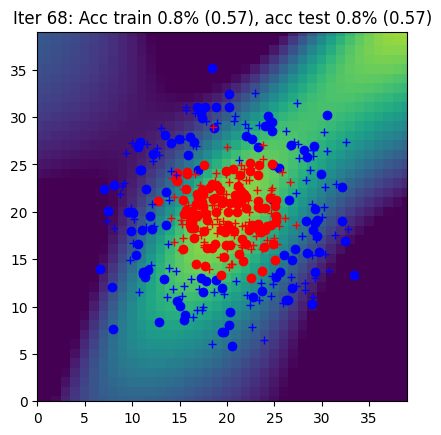

Iter 69: Acc train 0.8% (0.56), acc test 0.8% (0.57)


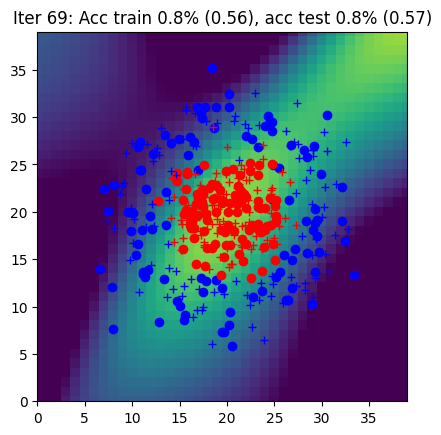

Iter 70: Acc train 0.8% (0.56), acc test 0.8% (0.56)


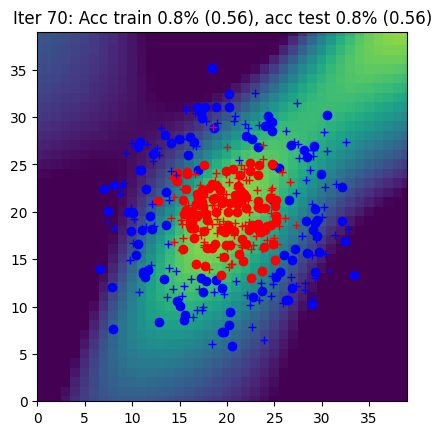

Iter 71: Acc train 0.8% (0.56), acc test 0.8% (0.56)


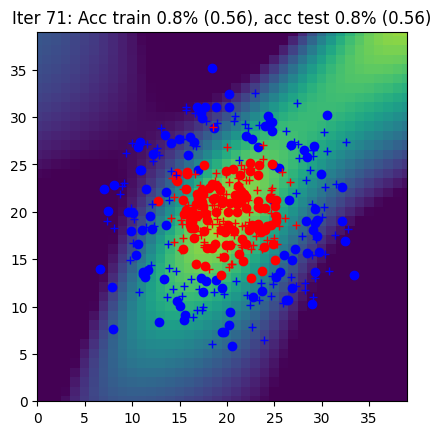

Iter 72: Acc train 0.8% (0.55), acc test 0.8% (0.55)


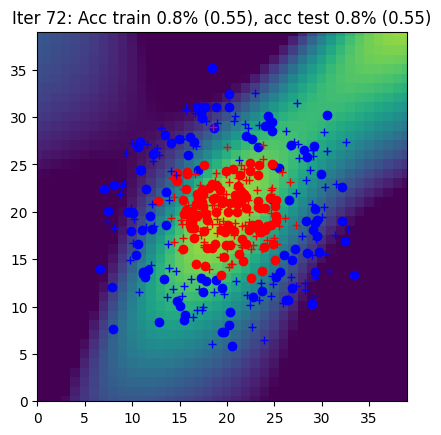

Iter 73: Acc train 0.8% (0.55), acc test 0.8% (0.55)


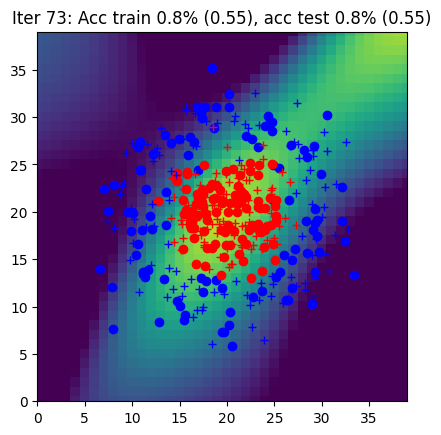

Iter 74: Acc train 0.8% (0.54), acc test 0.8% (0.55)


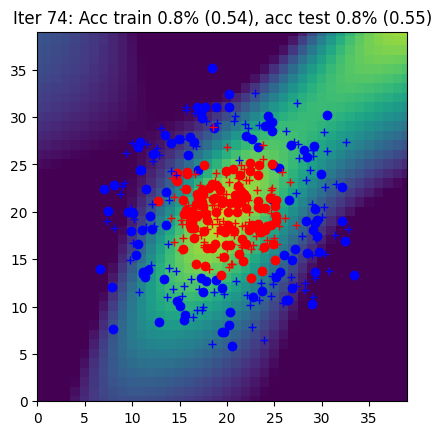

Iter 75: Acc train 0.8% (0.54), acc test 0.8% (0.54)


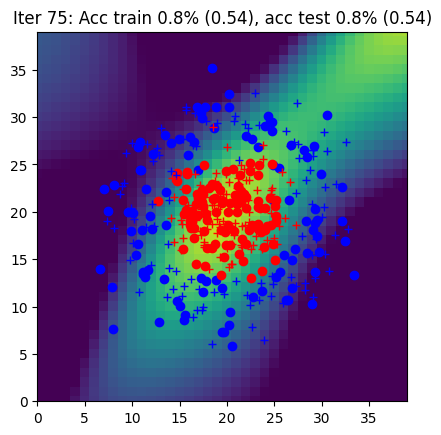

Iter 76: Acc train 0.8% (0.54), acc test 0.8% (0.54)


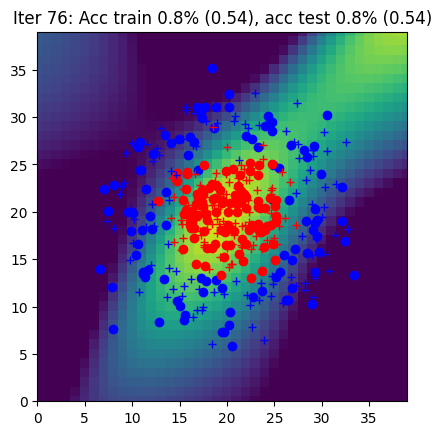

Iter 77: Acc train 0.8% (0.53), acc test 0.8% (0.53)


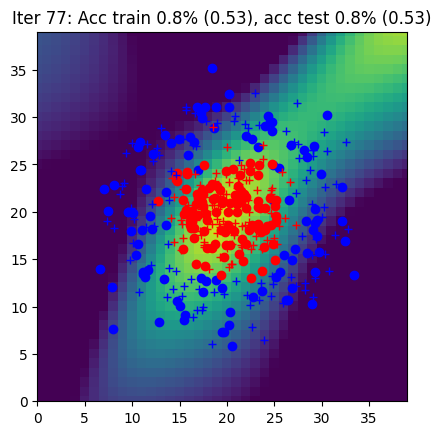

Iter 78: Acc train 0.8% (0.53), acc test 0.8% (0.53)


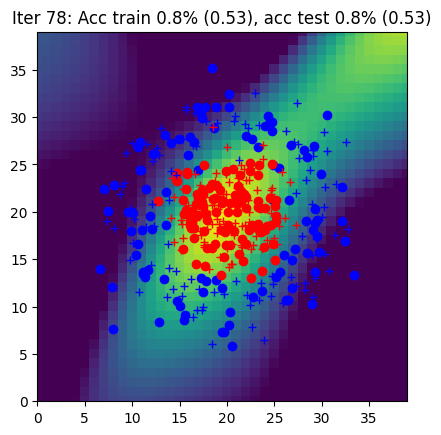

Iter 79: Acc train 0.8% (0.52), acc test 0.8% (0.52)


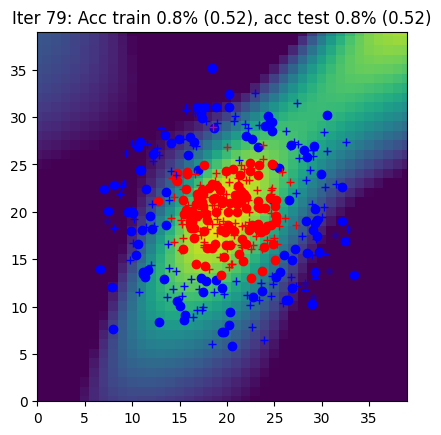

Iter 80: Acc train 0.8% (0.52), acc test 0.8% (0.52)


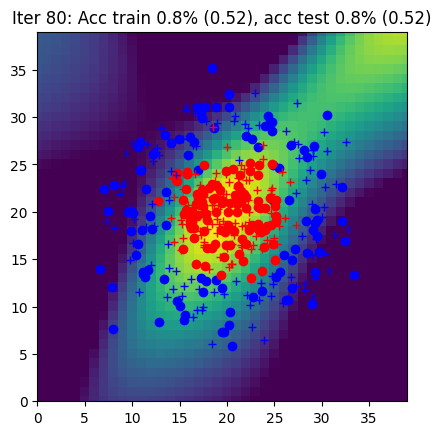

Iter 81: Acc train 0.8% (0.51), acc test 0.8% (0.52)


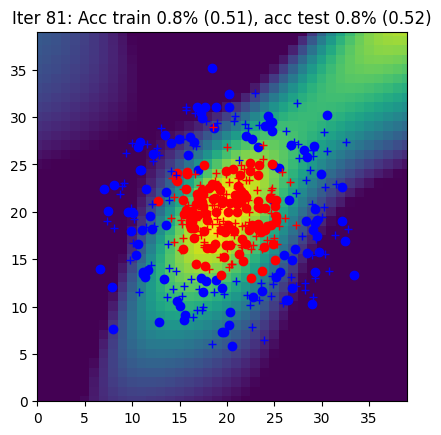

Iter 82: Acc train 0.8% (0.51), acc test 0.8% (0.51)


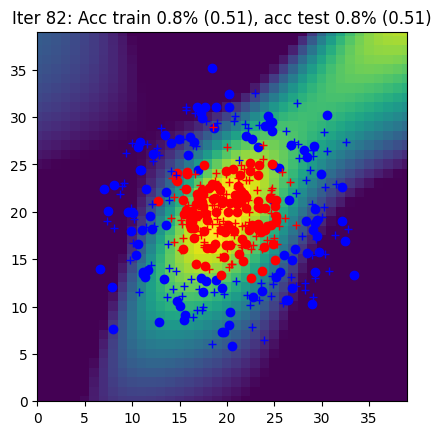

Iter 83: Acc train 0.8% (0.50), acc test 0.8% (0.51)


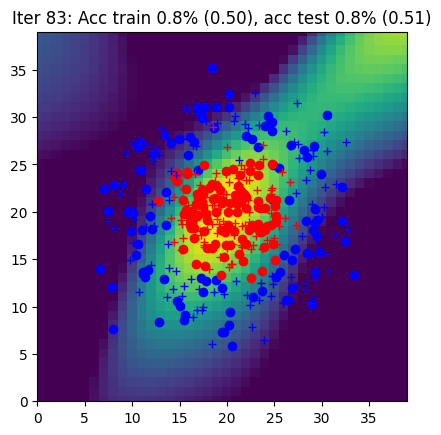

Iter 84: Acc train 0.8% (0.50), acc test 0.8% (0.50)


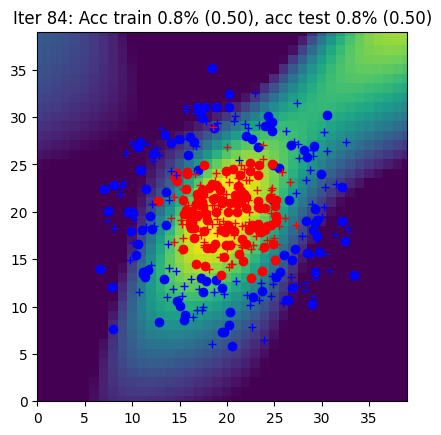

Iter 85: Acc train 0.8% (0.49), acc test 0.8% (0.50)


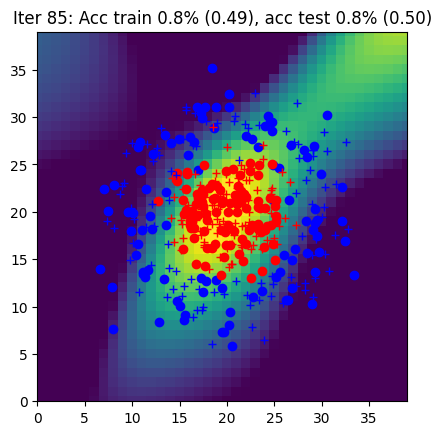

Iter 86: Acc train 0.8% (0.49), acc test 0.8% (0.49)


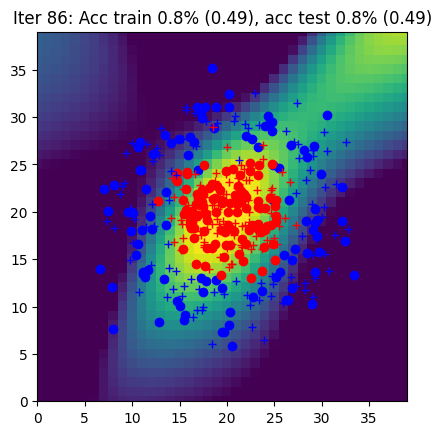

Iter 87: Acc train 0.8% (0.48), acc test 0.8% (0.49)


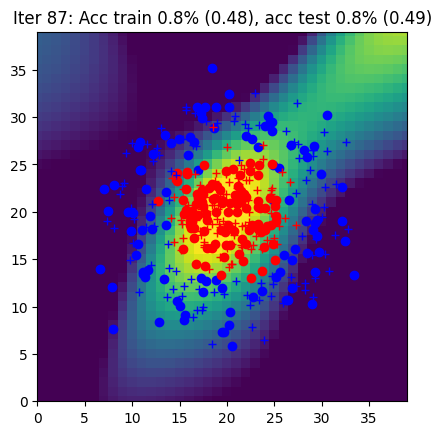

Iter 88: Acc train 0.8% (0.48), acc test 0.8% (0.48)


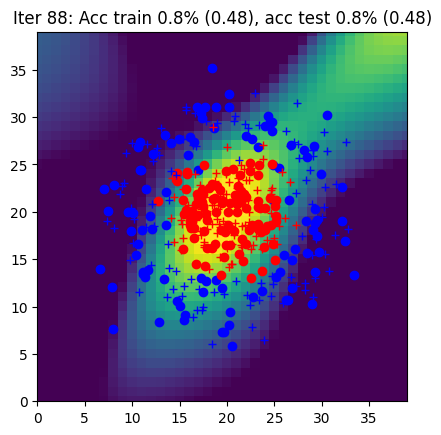

Iter 89: Acc train 0.8% (0.47), acc test 0.8% (0.48)


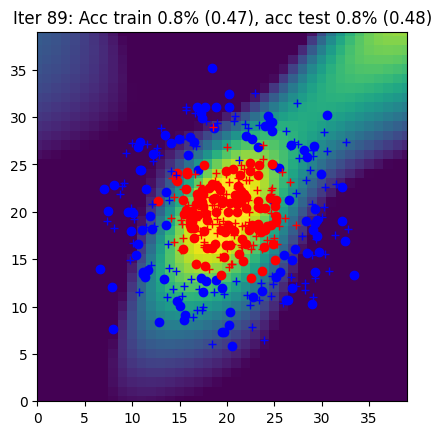

Iter 90: Acc train 0.9% (0.47), acc test 0.9% (0.47)


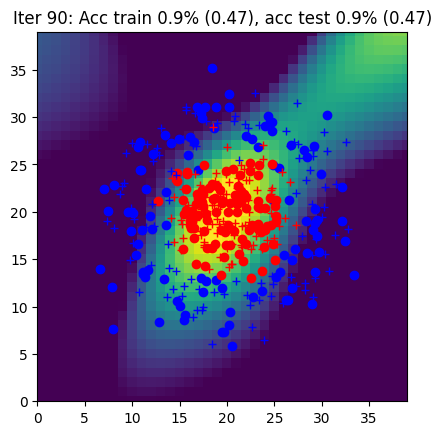

Iter 91: Acc train 0.8% (0.46), acc test 0.9% (0.47)


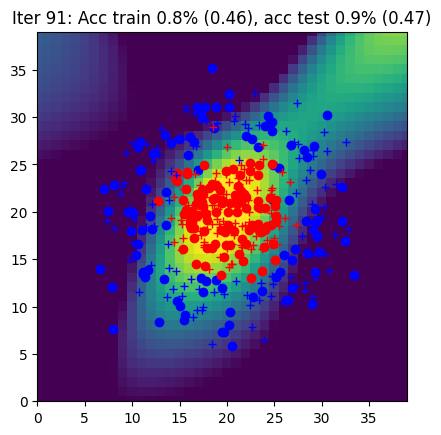

Iter 92: Acc train 0.8% (0.46), acc test 0.9% (0.46)


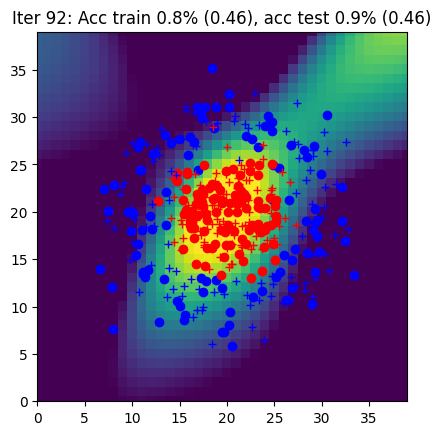

Iter 93: Acc train 0.9% (0.45), acc test 0.9% (0.46)


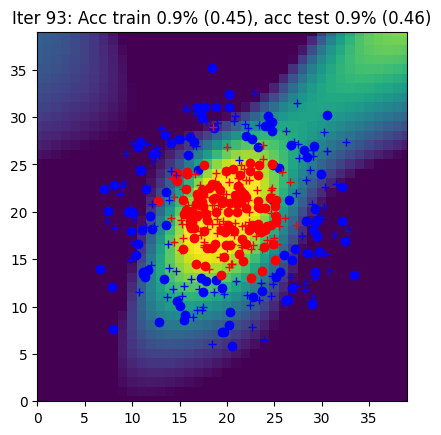

Iter 94: Acc train 0.9% (0.45), acc test 0.9% (0.45)


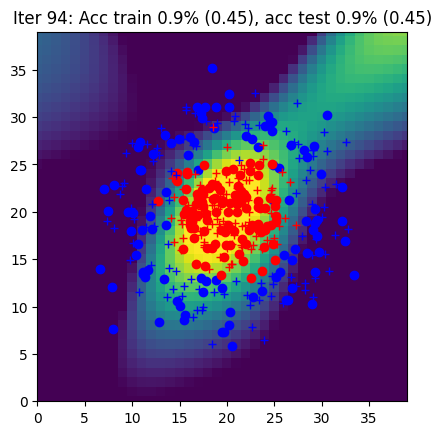

Iter 95: Acc train 0.9% (0.44), acc test 0.9% (0.45)


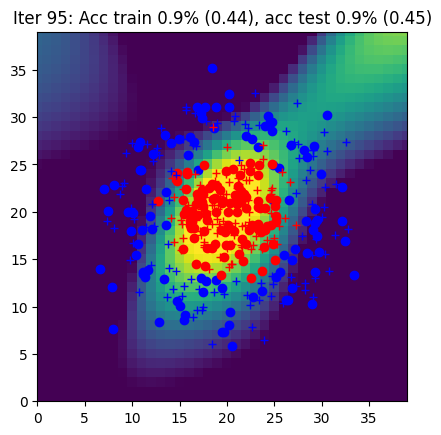

Iter 96: Acc train 0.9% (0.44), acc test 0.9% (0.45)


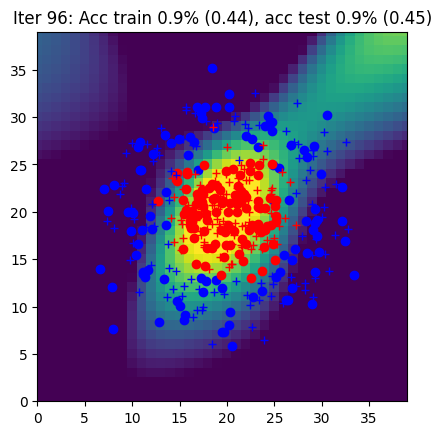

Iter 97: Acc train 0.9% (0.43), acc test 0.9% (0.44)


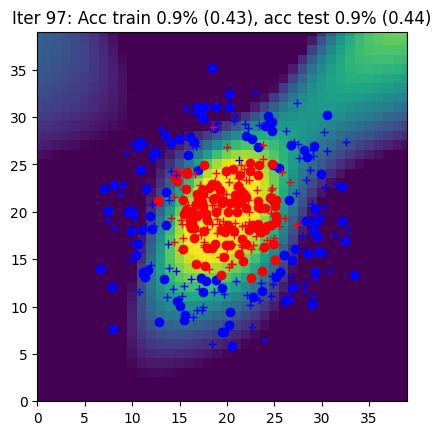

Iter 98: Acc train 0.9% (0.43), acc test 0.9% (0.44)


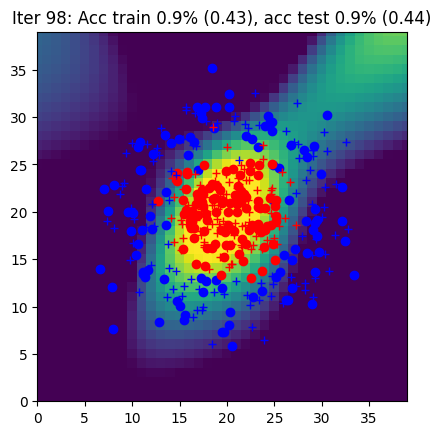

Iter 99: Acc train 0.9% (0.42), acc test 0.9% (0.43)


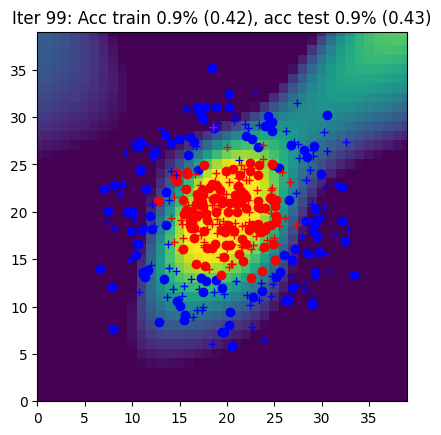

Iter 100: Acc train 0.9% (0.42), acc test 0.9% (0.43)


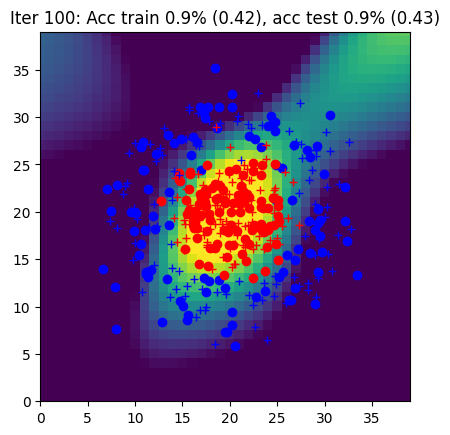

Iter 101: Acc train 0.9% (0.41), acc test 0.9% (0.42)


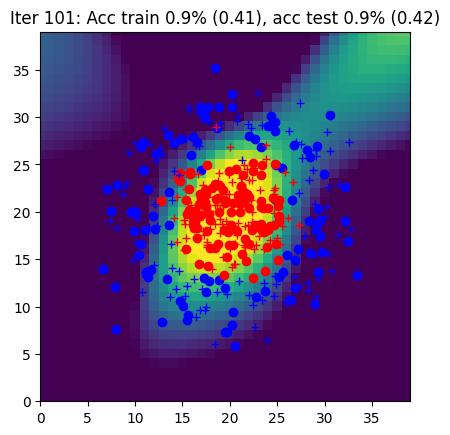

Iter 102: Acc train 0.9% (0.41), acc test 0.9% (0.42)


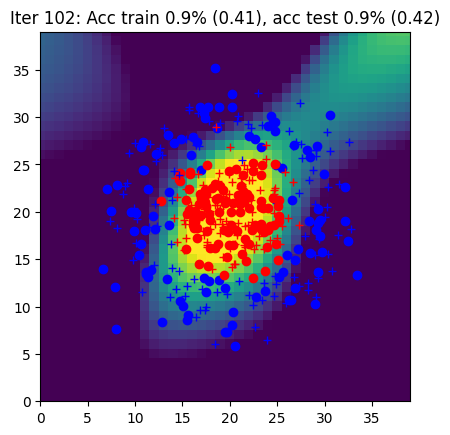

Iter 103: Acc train 0.9% (0.40), acc test 0.9% (0.41)


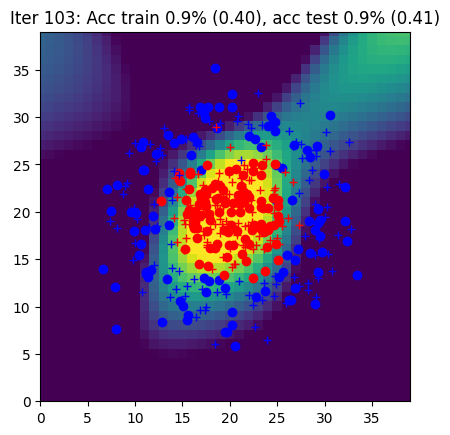

Iter 104: Acc train 0.9% (0.40), acc test 0.9% (0.41)


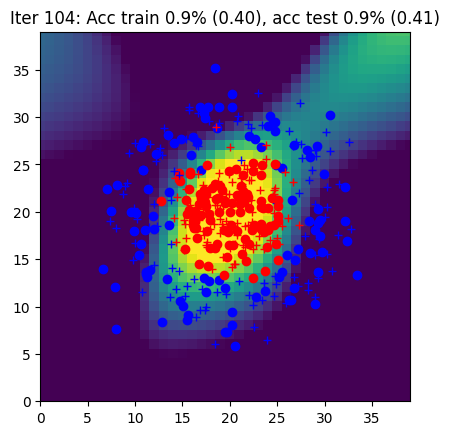

Iter 105: Acc train 0.9% (0.39), acc test 0.9% (0.40)


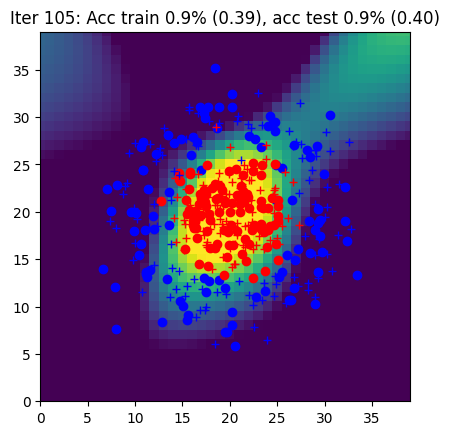

Iter 106: Acc train 0.9% (0.39), acc test 0.9% (0.40)


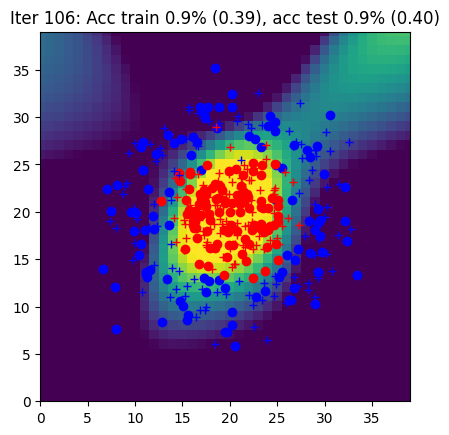

Iter 107: Acc train 0.9% (0.38), acc test 0.9% (0.39)


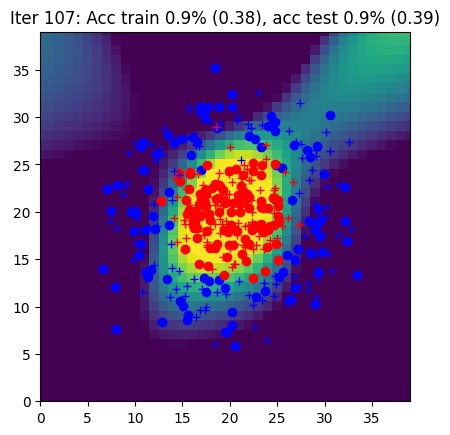

Iter 108: Acc train 0.9% (0.38), acc test 0.9% (0.39)


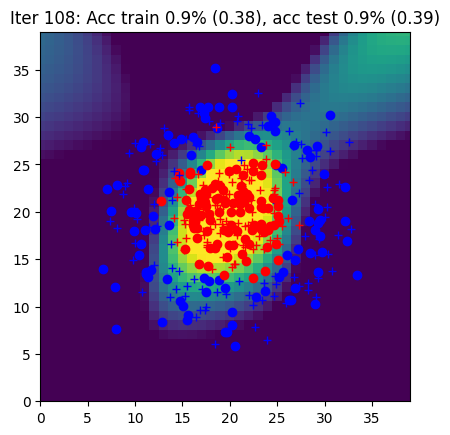

Iter 109: Acc train 0.9% (0.37), acc test 0.9% (0.39)


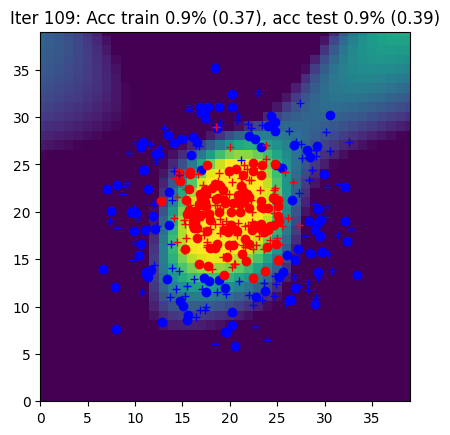

Iter 110: Acc train 0.9% (0.37), acc test 0.9% (0.38)


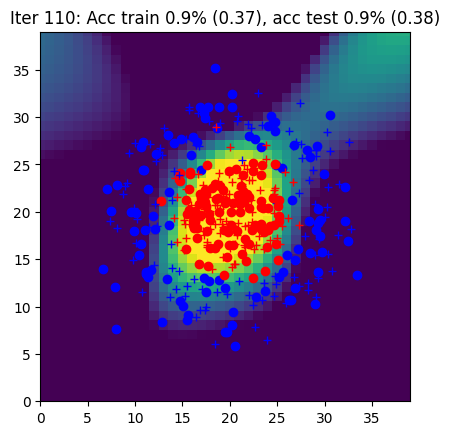

Iter 111: Acc train 0.9% (0.36), acc test 0.9% (0.38)


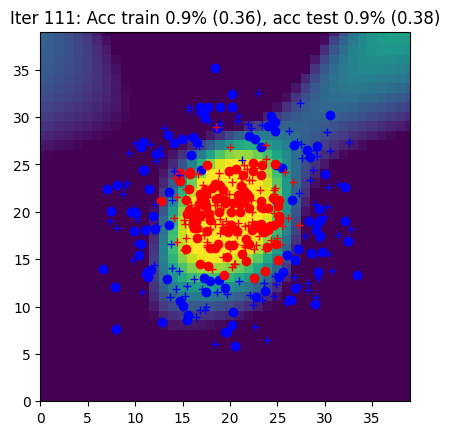

Iter 112: Acc train 0.9% (0.36), acc test 0.9% (0.37)


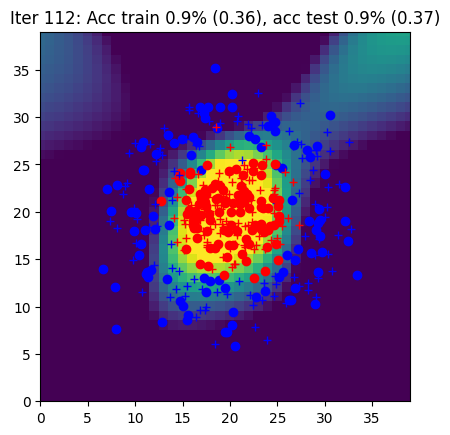

Iter 113: Acc train 0.9% (0.36), acc test 0.9% (0.37)


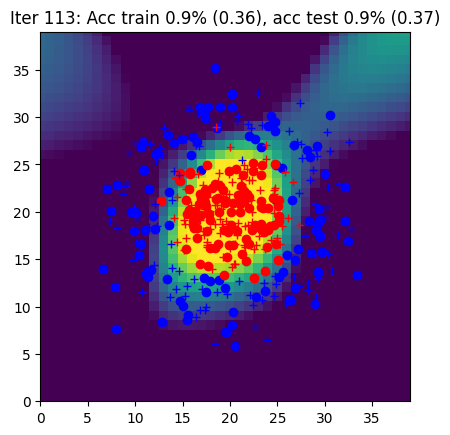

Iter 114: Acc train 0.9% (0.35), acc test 0.9% (0.36)


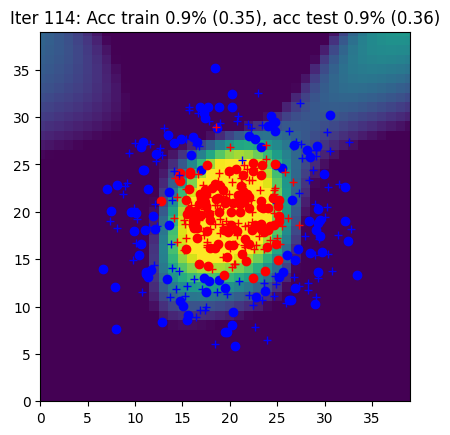

Iter 115: Acc train 0.9% (0.35), acc test 0.9% (0.36)


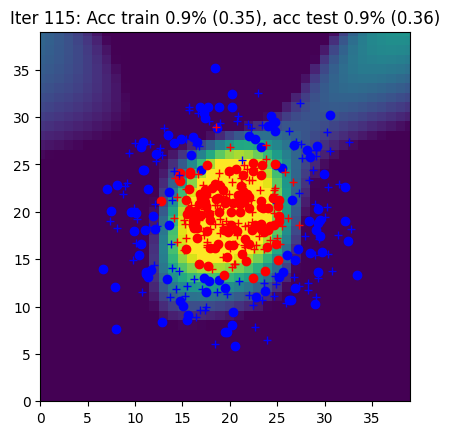

Iter 116: Acc train 0.9% (0.34), acc test 0.9% (0.36)


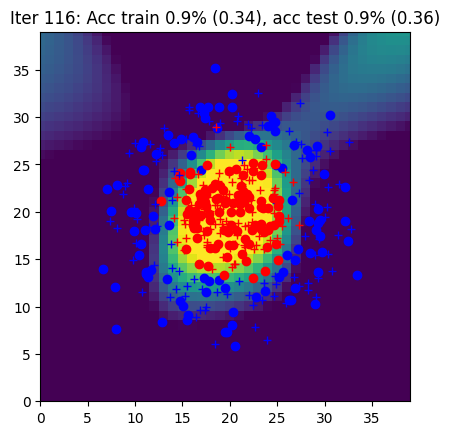

Iter 117: Acc train 0.9% (0.34), acc test 0.9% (0.35)


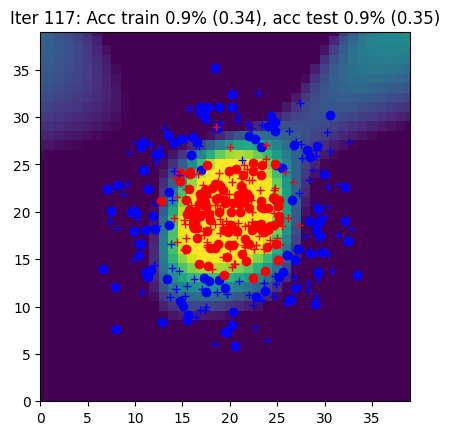

Iter 118: Acc train 0.9% (0.33), acc test 0.9% (0.35)


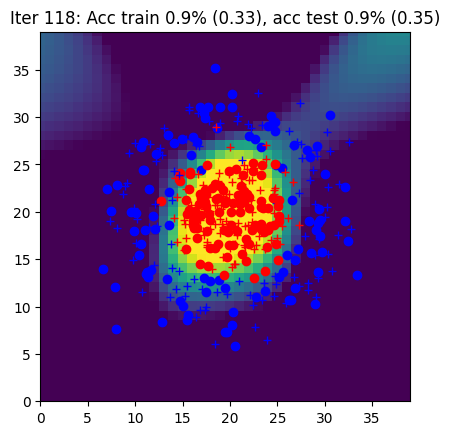

Iter 119: Acc train 0.9% (0.33), acc test 0.9% (0.34)


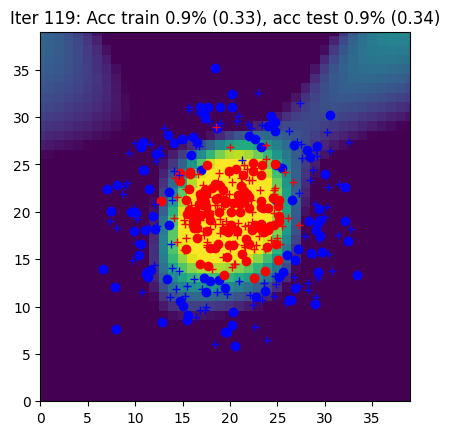

Iter 120: Acc train 0.9% (0.33), acc test 0.9% (0.34)


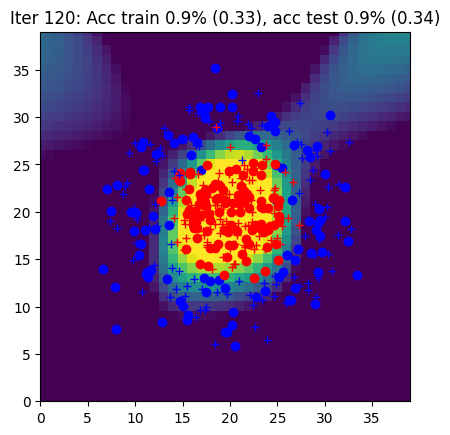

Iter 121: Acc train 0.9% (0.32), acc test 0.9% (0.34)


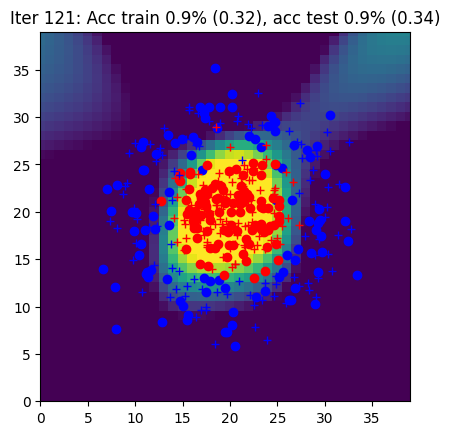

Iter 122: Acc train 0.9% (0.32), acc test 0.9% (0.33)


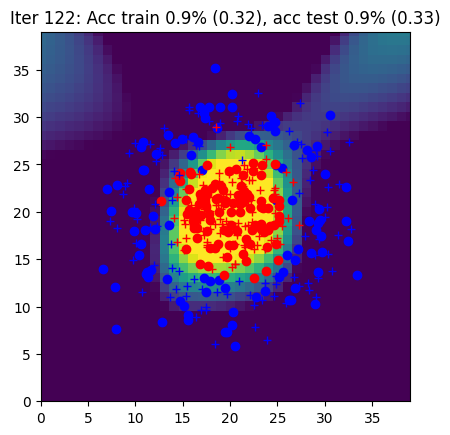

Iter 123: Acc train 0.9% (0.31), acc test 0.9% (0.33)


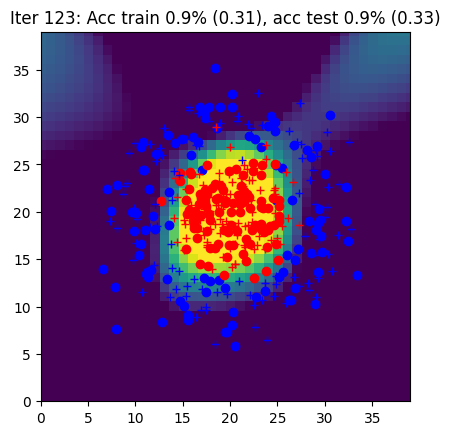

Iter 124: Acc train 0.9% (0.31), acc test 0.9% (0.33)


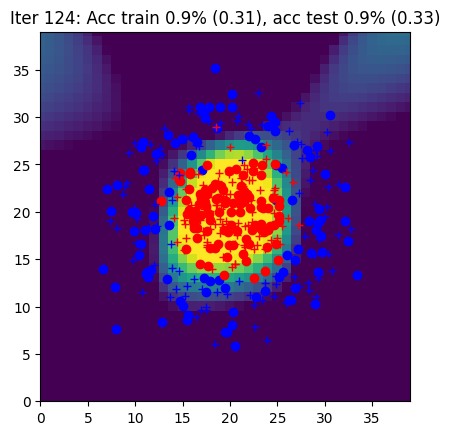

Iter 125: Acc train 0.9% (0.31), acc test 0.9% (0.32)


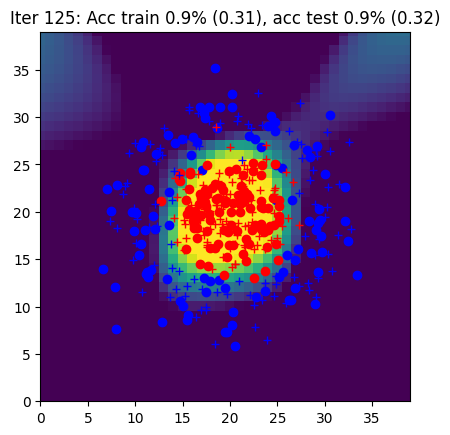

Iter 126: Acc train 0.9% (0.30), acc test 0.9% (0.32)


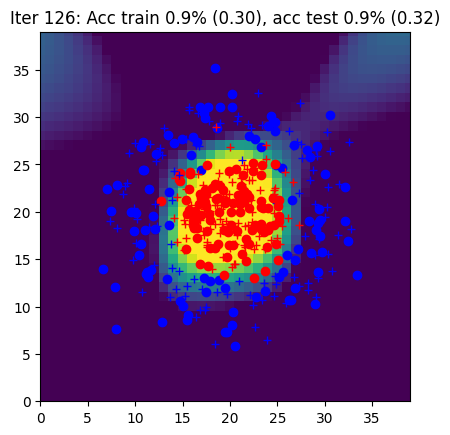

Iter 127: Acc train 0.9% (0.30), acc test 0.9% (0.32)


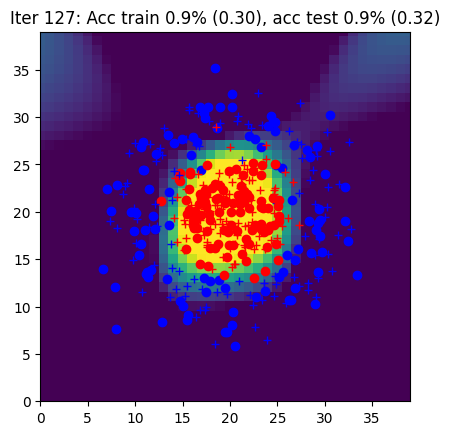

Iter 128: Acc train 0.9% (0.30), acc test 0.9% (0.31)


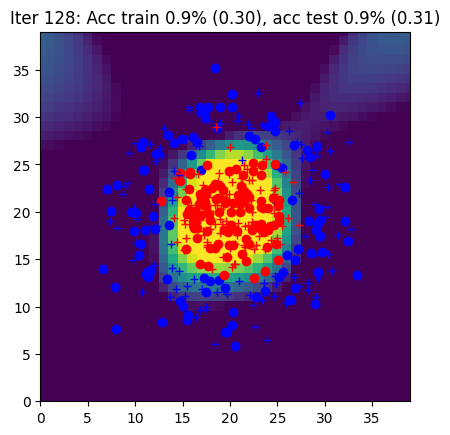

Iter 129: Acc train 0.9% (0.29), acc test 0.9% (0.31)


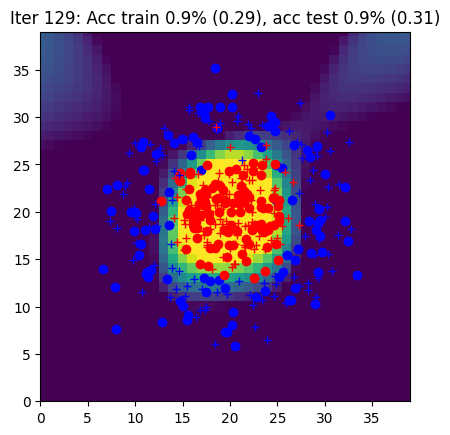

Iter 130: Acc train 0.9% (0.29), acc test 0.9% (0.31)


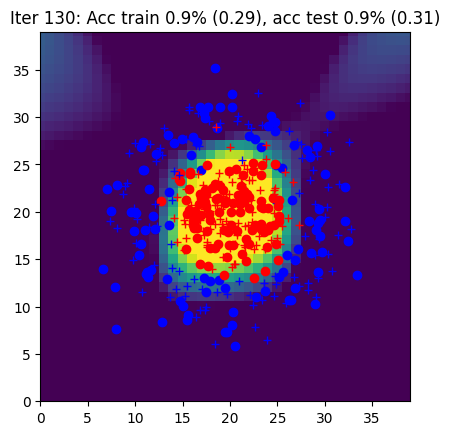

Iter 131: Acc train 0.9% (0.29), acc test 0.9% (0.30)


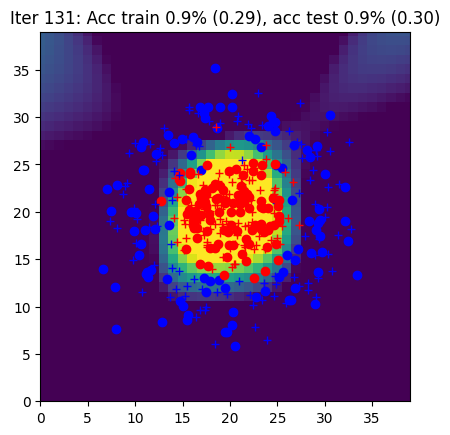

Iter 132: Acc train 0.9% (0.28), acc test 1.0% (0.30)


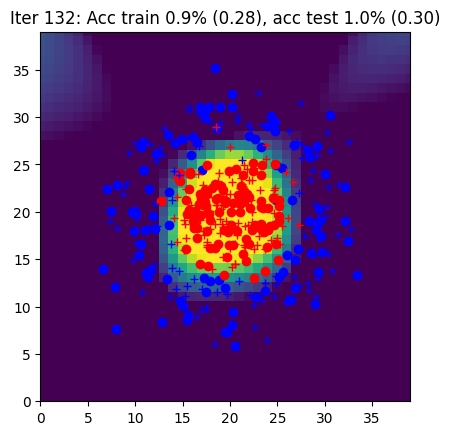

Iter 133: Acc train 0.9% (0.28), acc test 1.0% (0.30)


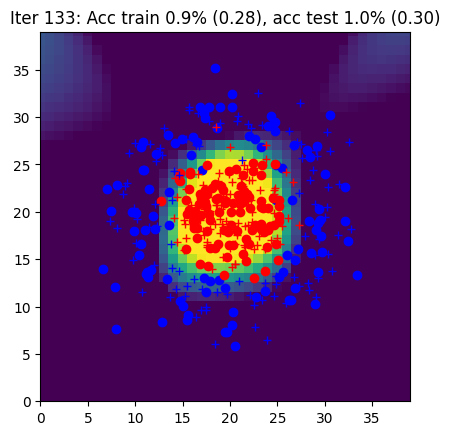

Iter 134: Acc train 1.0% (0.28), acc test 1.0% (0.29)


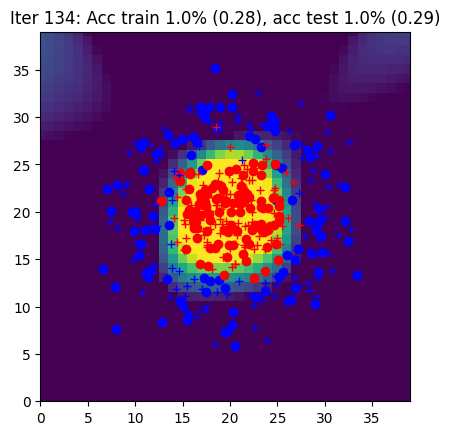

Iter 135: Acc train 1.0% (0.28), acc test 0.9% (0.29)


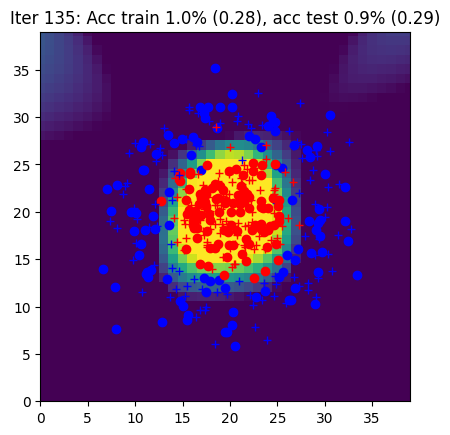

Iter 136: Acc train 1.0% (0.27), acc test 1.0% (0.29)


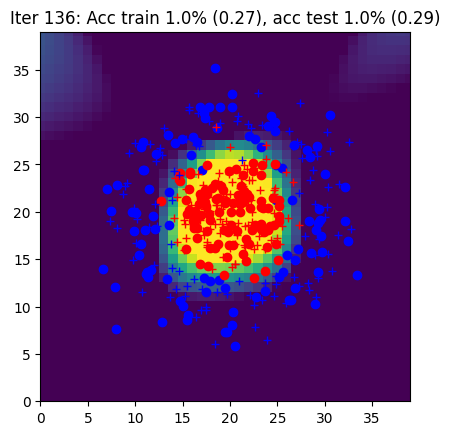

Iter 137: Acc train 1.0% (0.27), acc test 1.0% (0.29)


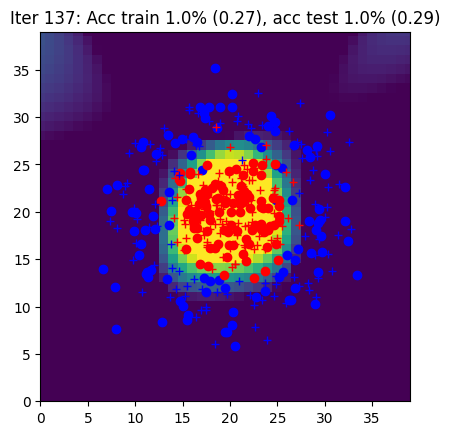

Iter 138: Acc train 1.0% (0.27), acc test 1.0% (0.28)


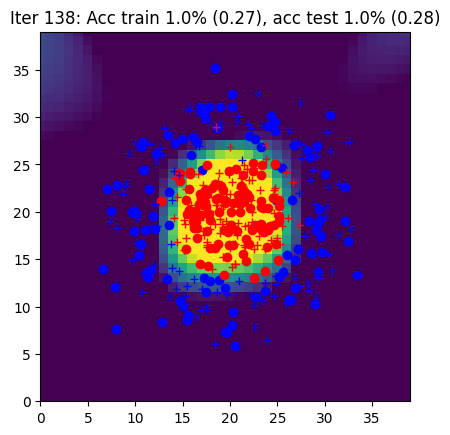

Iter 139: Acc train 1.0% (0.26), acc test 1.0% (0.28)


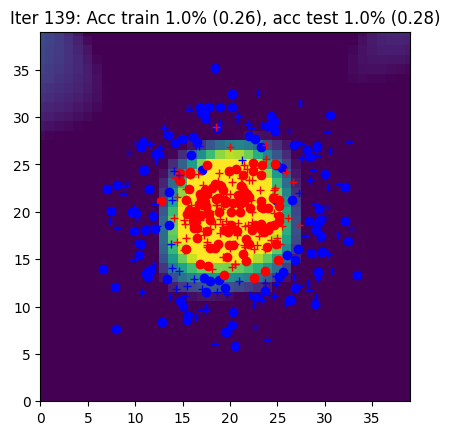

Iter 140: Acc train 1.0% (0.26), acc test 1.0% (0.28)


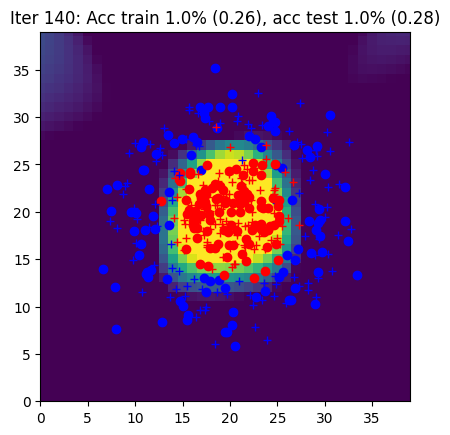

Iter 141: Acc train 1.0% (0.26), acc test 1.0% (0.28)


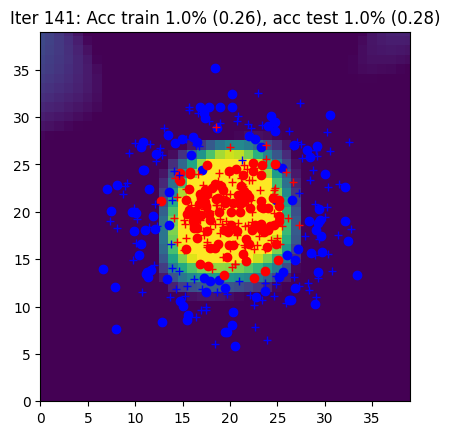

Iter 142: Acc train 1.0% (0.26), acc test 1.0% (0.27)


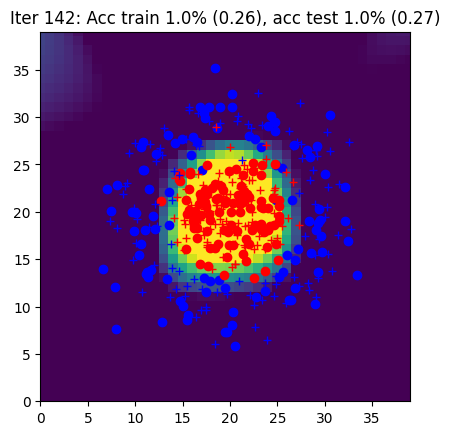

Iter 143: Acc train 1.0% (0.26), acc test 1.0% (0.27)


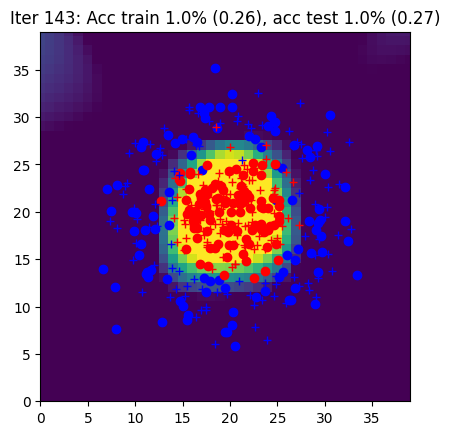

Iter 144: Acc train 1.0% (0.25), acc test 1.0% (0.27)


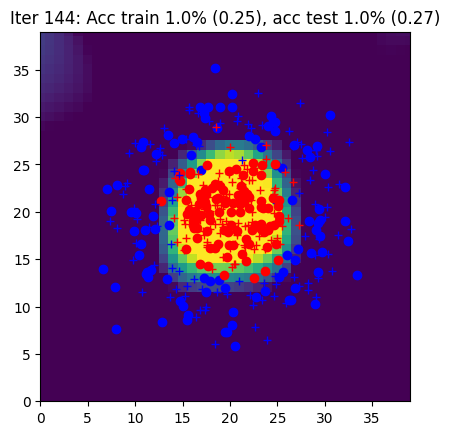

Iter 145: Acc train 1.0% (0.25), acc test 1.0% (0.27)


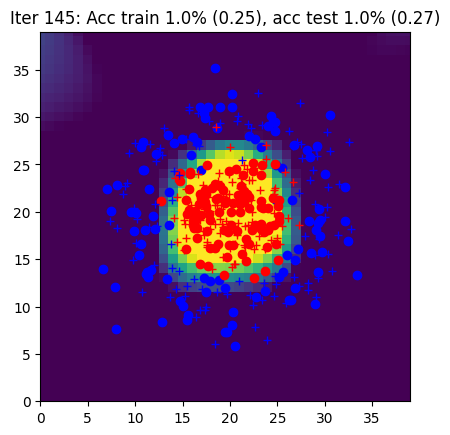

Iter 146: Acc train 1.0% (0.25), acc test 1.0% (0.27)


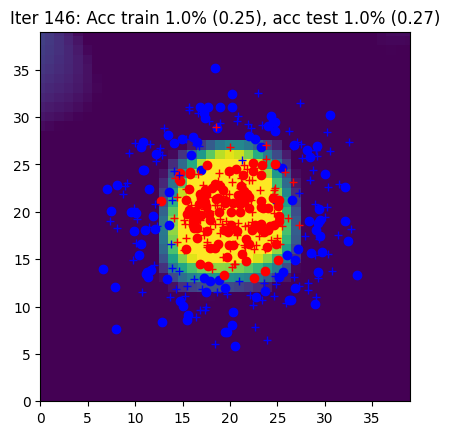

Iter 147: Acc train 1.0% (0.25), acc test 1.0% (0.26)


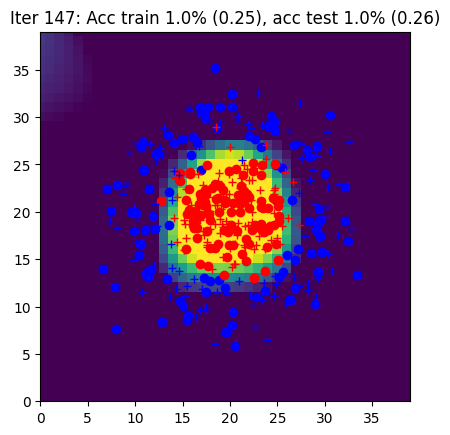

Iter 148: Acc train 1.0% (0.24), acc test 0.9% (0.26)


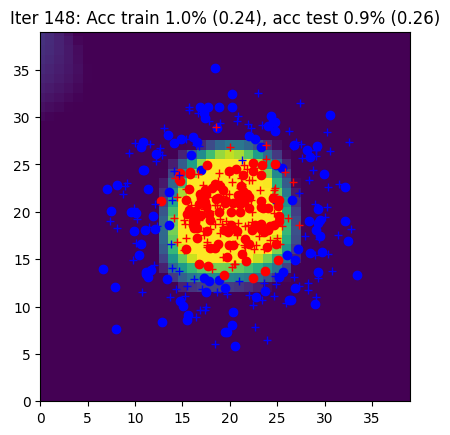

Iter 149: Acc train 1.0% (0.24), acc test 0.9% (0.26)


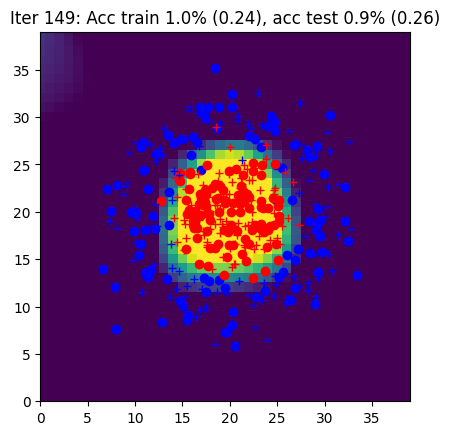

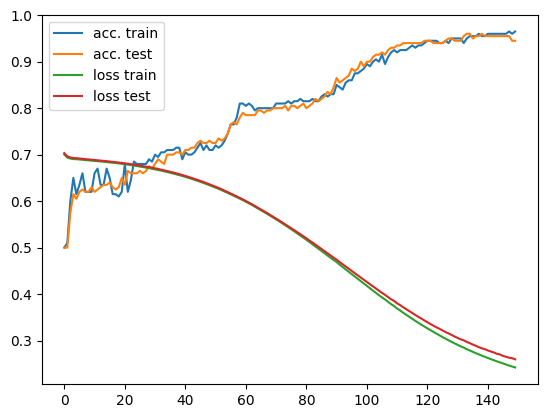

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss = init_model(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):


        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: loss_accuracy, sgd
        # the forward with the predict method from the model
        # and the backward function with autograd
        pred = model(X)
        L , acc = loss_accuracy(loss, pred, Y)
        l_value = loss(pred, Y)
        l_value.backward()
        sgd(model, eta)

    ####################
    ##      END        #
    ####################


    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ygrid = model(data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 4 : Simplification of the SGD with `torch.optim`

In [ ]:
def init_model(nx, nh, ny, eta):

    #####################
    ## Your code here  ##
    #####################

    model = torch.nn.Sequential(
        torch.nn.Linear(nx,nh),
        torch.nn.Tanh(),
        torch.nn.Linear(nh,ny),
    )
    loss = torch.nn.CrossEntropyLoss()
    optim = torch.optim.SGD(model.parameters(),lr=eta)

    ####################
    ##      END        #
    ####################

    return model, loss, optim

The `sgd` function is replaced by calling the `optim.zero_grad()` before the backward and `optim.step()` after.

## Algorithme global d'apprentissage (avec autograd, les couches `torch.nn` et `torch.optim`)

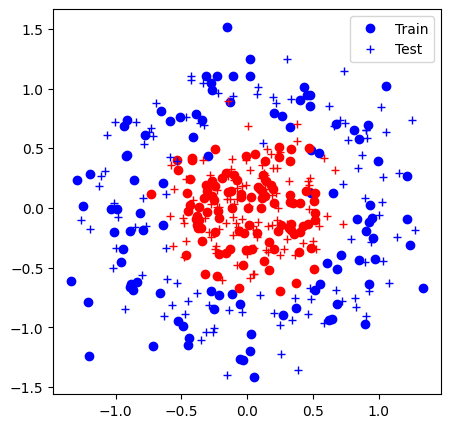

Iter 0: Acc train 0.6% (0.71), acc test 0.6% (0.70)


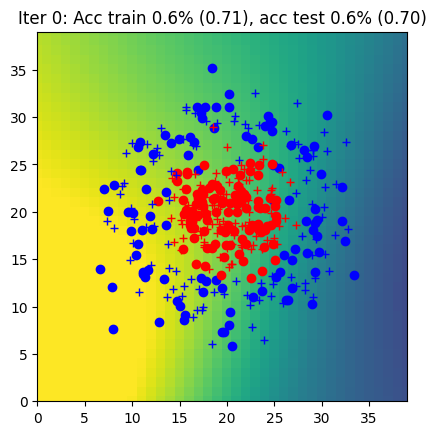

Iter 1: Acc train 0.6% (0.70), acc test 0.6% (0.69)


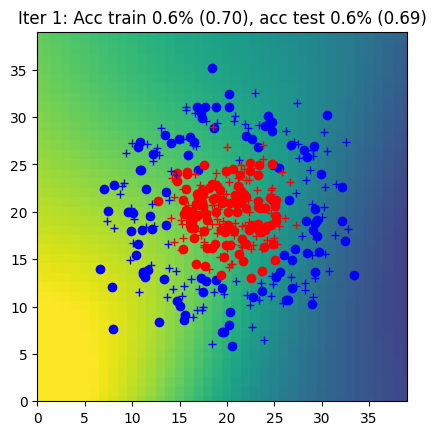

Iter 2: Acc train 0.6% (0.69), acc test 0.7% (0.68)


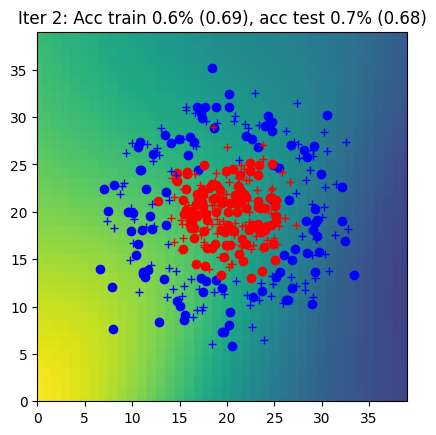

Iter 3: Acc train 0.7% (0.69), acc test 0.7% (0.68)


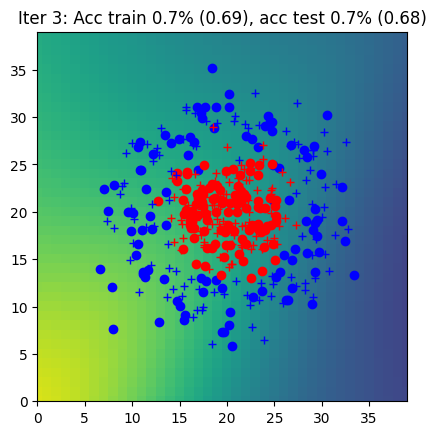

Iter 4: Acc train 0.7% (0.68), acc test 0.7% (0.68)


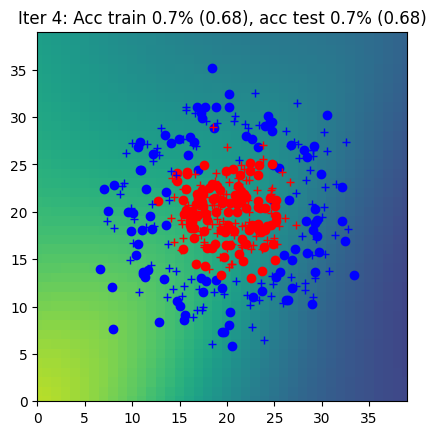

Iter 5: Acc train 0.7% (0.68), acc test 0.7% (0.68)


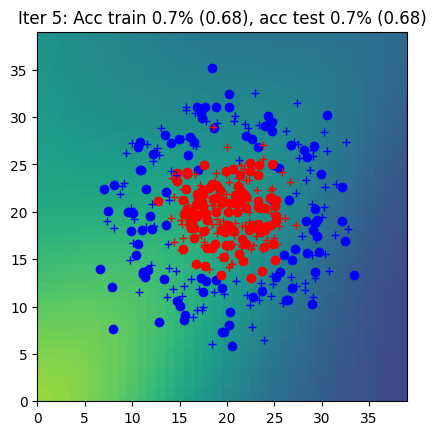

Iter 6: Acc train 0.7% (0.68), acc test 0.7% (0.68)


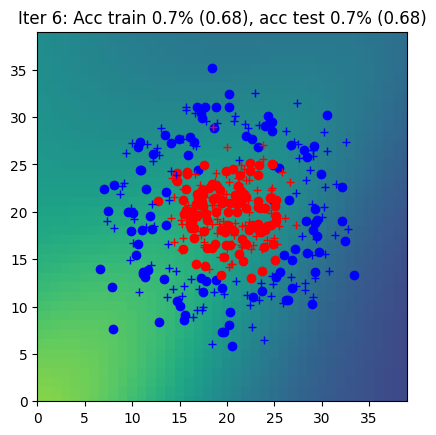

Iter 7: Acc train 0.8% (0.68), acc test 0.8% (0.67)


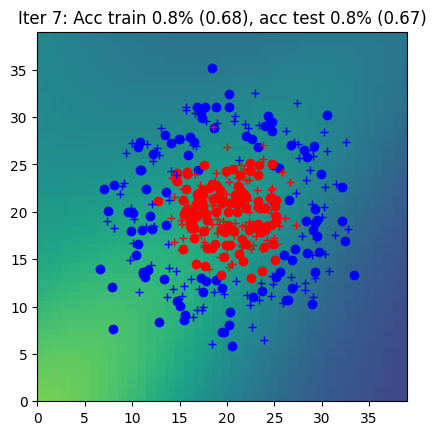

Iter 8: Acc train 0.7% (0.68), acc test 0.8% (0.67)


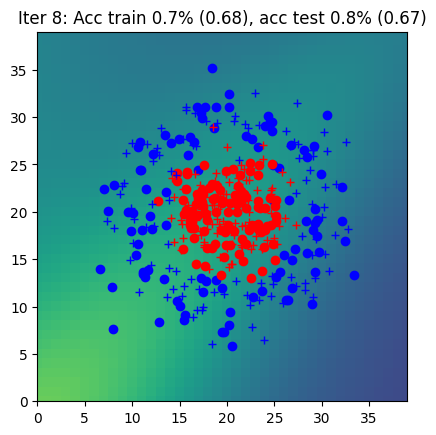

Iter 9: Acc train 0.7% (0.67), acc test 0.7% (0.67)


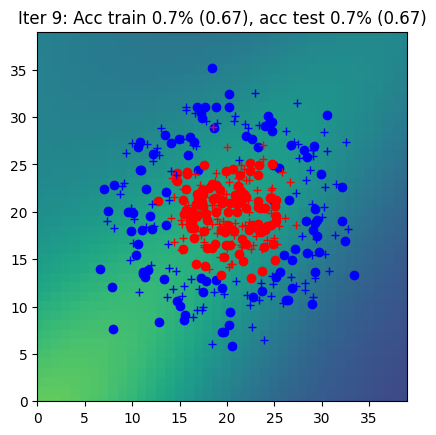

Iter 10: Acc train 0.7% (0.67), acc test 0.7% (0.67)


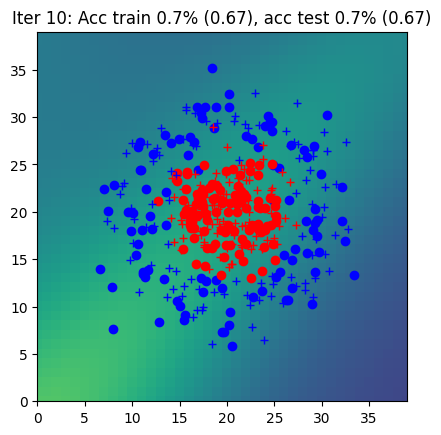

Iter 11: Acc train 0.7% (0.67), acc test 0.7% (0.67)


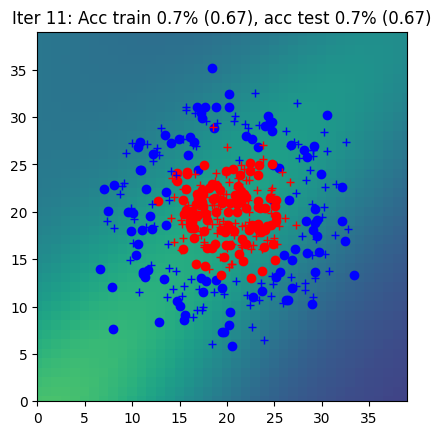

Iter 12: Acc train 0.8% (0.67), acc test 0.8% (0.67)


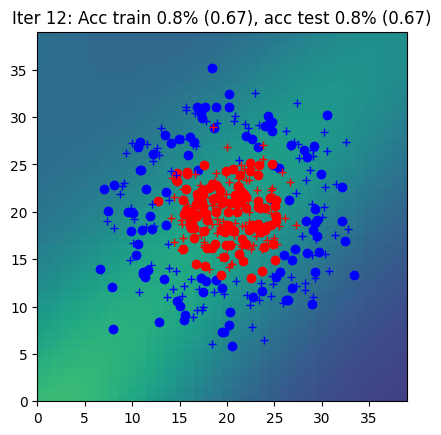

Iter 13: Acc train 0.8% (0.67), acc test 0.8% (0.66)


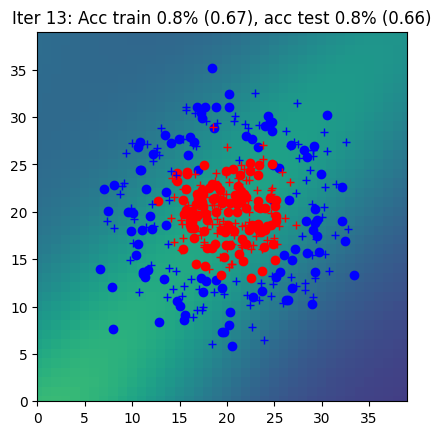

Iter 14: Acc train 0.8% (0.67), acc test 0.8% (0.66)


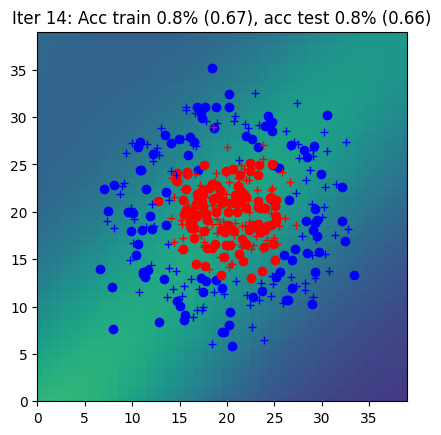

Iter 15: Acc train 0.8% (0.66), acc test 0.8% (0.66)


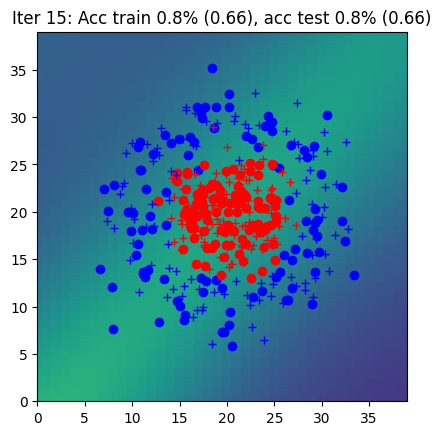

Iter 16: Acc train 0.8% (0.66), acc test 0.8% (0.66)


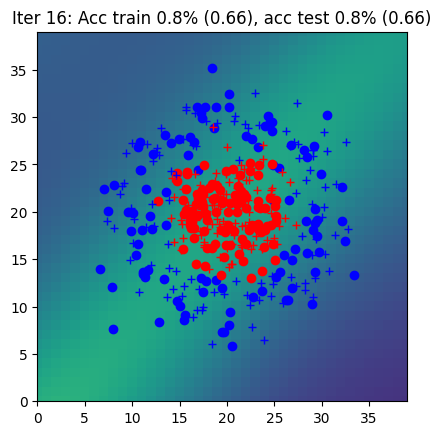

Iter 17: Acc train 0.8% (0.66), acc test 0.8% (0.66)


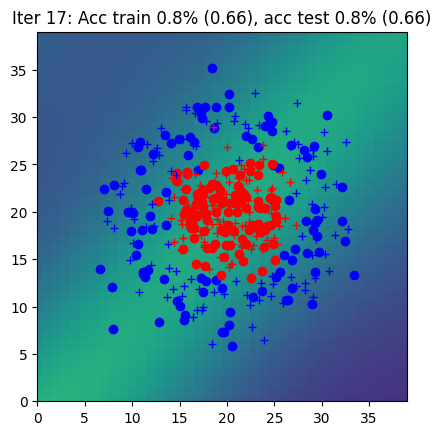

Iter 18: Acc train 0.8% (0.66), acc test 0.8% (0.66)


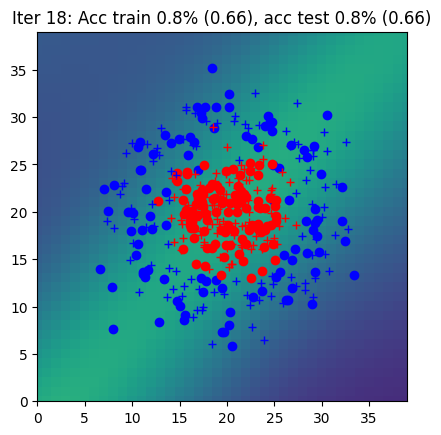

Iter 19: Acc train 0.8% (0.66), acc test 0.8% (0.65)


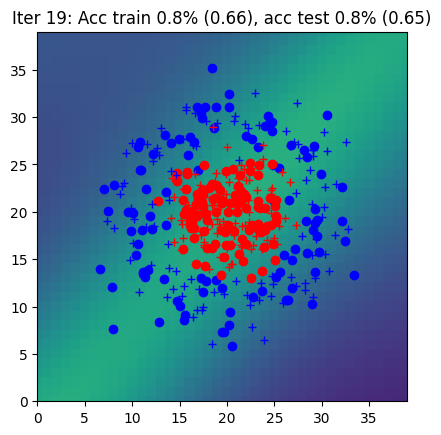

Iter 20: Acc train 0.8% (0.65), acc test 0.8% (0.65)


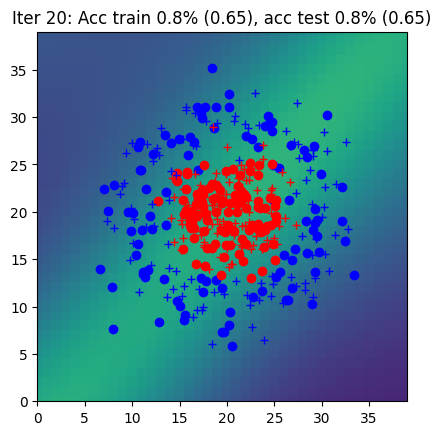

Iter 21: Acc train 0.8% (0.65), acc test 0.8% (0.65)


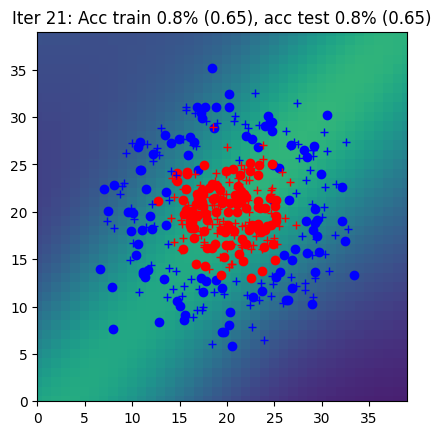

Iter 22: Acc train 0.8% (0.65), acc test 0.8% (0.65)


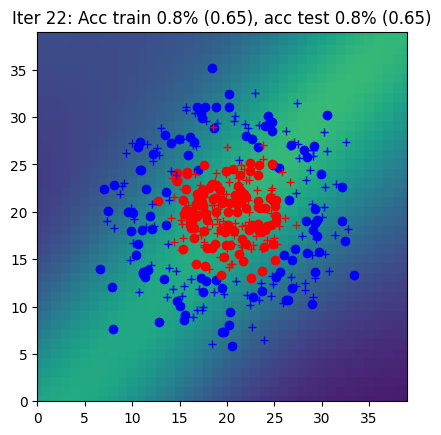

Iter 23: Acc train 0.8% (0.65), acc test 0.8% (0.64)


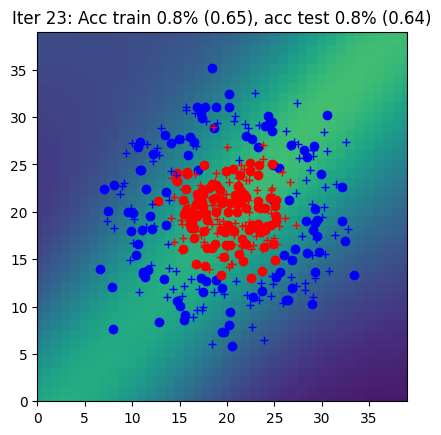

Iter 24: Acc train 0.8% (0.64), acc test 0.8% (0.64)


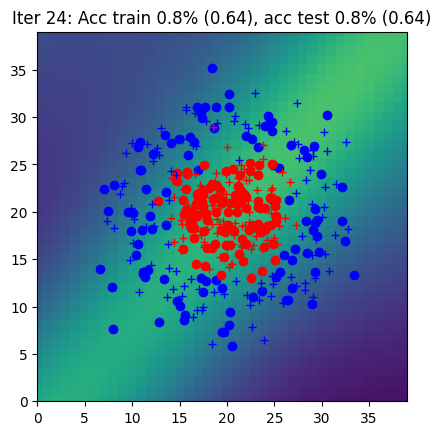

Iter 25: Acc train 0.8% (0.64), acc test 0.8% (0.64)


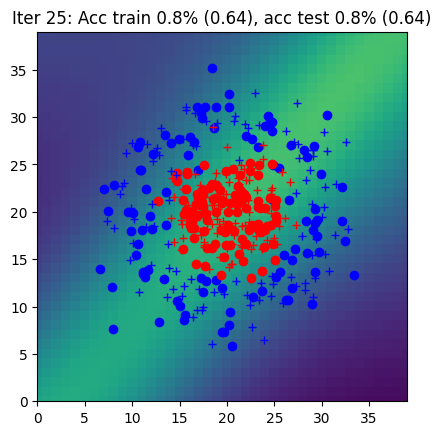

Iter 26: Acc train 0.8% (0.64), acc test 0.8% (0.64)


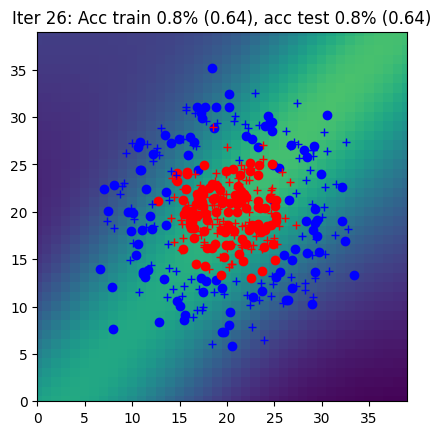

Iter 27: Acc train 0.8% (0.64), acc test 0.8% (0.63)


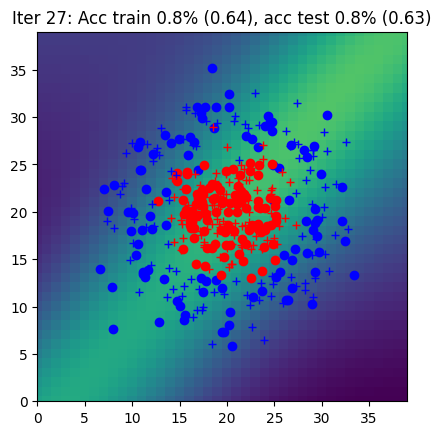

Iter 28: Acc train 0.8% (0.63), acc test 0.8% (0.63)


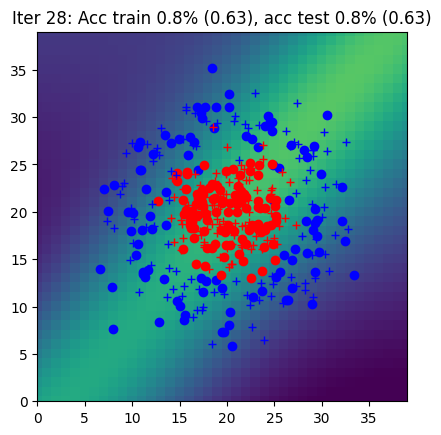

Iter 29: Acc train 0.8% (0.63), acc test 0.8% (0.63)


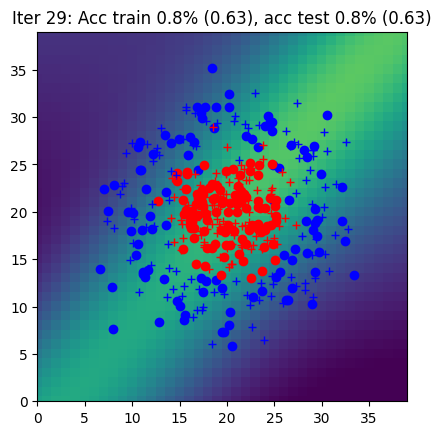

Iter 30: Acc train 0.8% (0.63), acc test 0.8% (0.62)


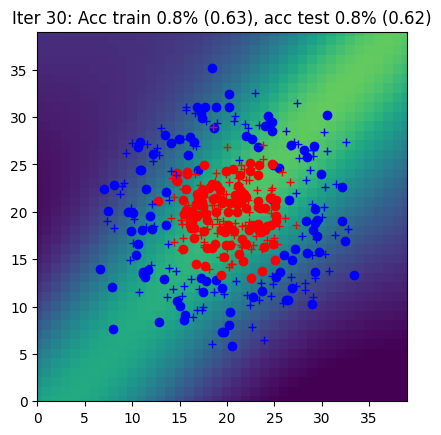

Iter 31: Acc train 0.8% (0.63), acc test 0.8% (0.62)


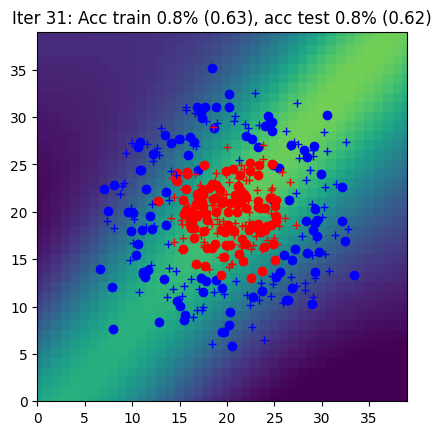

Iter 32: Acc train 0.8% (0.62), acc test 0.8% (0.62)


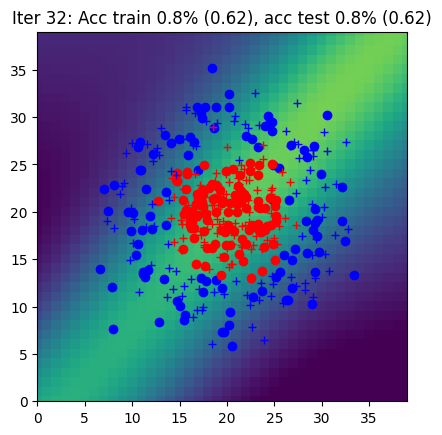

Iter 33: Acc train 0.8% (0.62), acc test 0.8% (0.62)


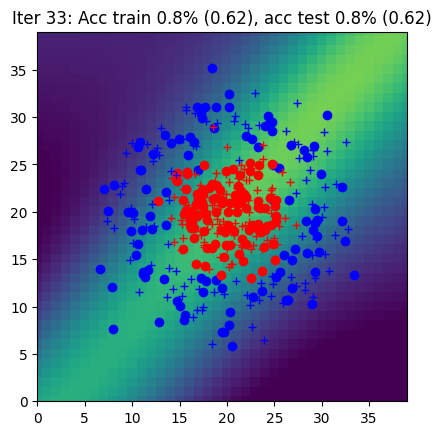

Iter 34: Acc train 0.8% (0.62), acc test 0.8% (0.61)


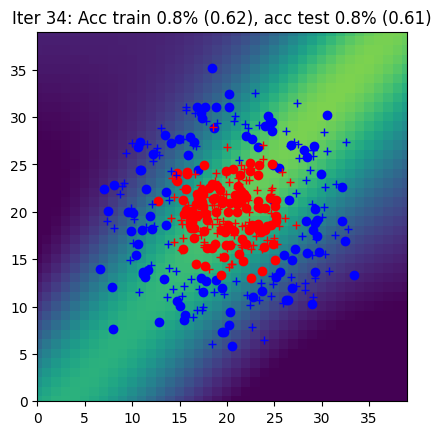

Iter 35: Acc train 0.8% (0.61), acc test 0.8% (0.61)


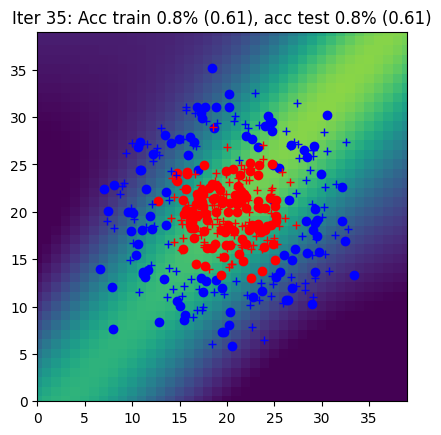

Iter 36: Acc train 0.8% (0.61), acc test 0.8% (0.61)


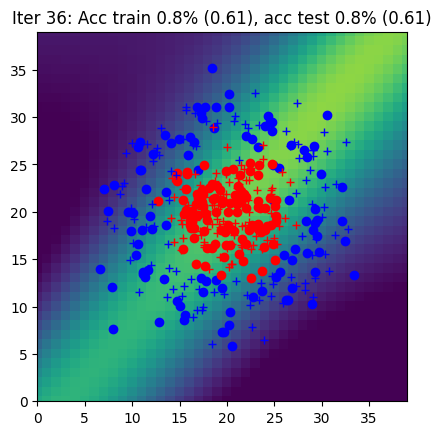

Iter 37: Acc train 0.8% (0.61), acc test 0.8% (0.60)


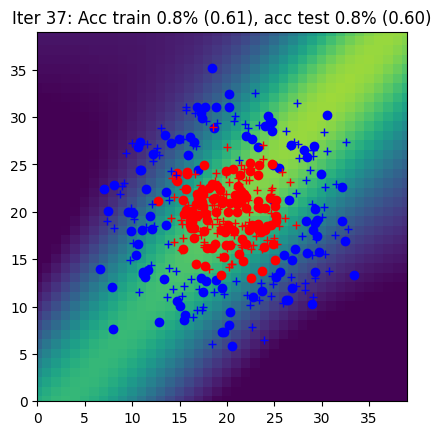

Iter 38: Acc train 0.8% (0.60), acc test 0.8% (0.60)


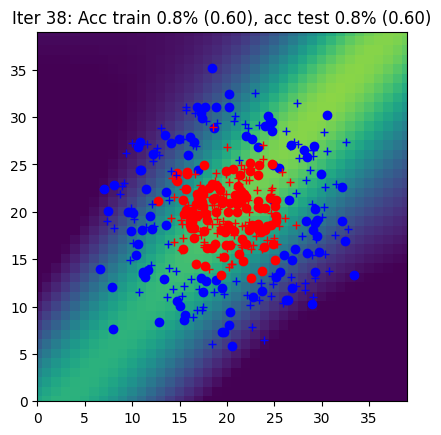

Iter 39: Acc train 0.8% (0.60), acc test 0.8% (0.60)


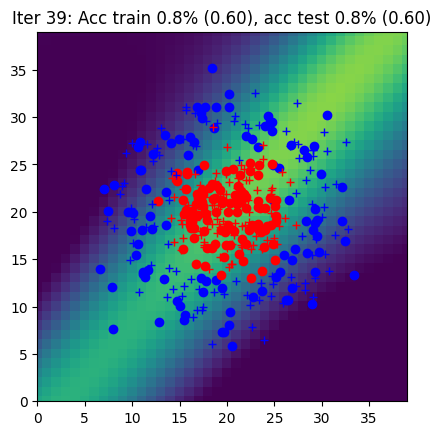

Iter 40: Acc train 0.8% (0.60), acc test 0.8% (0.59)


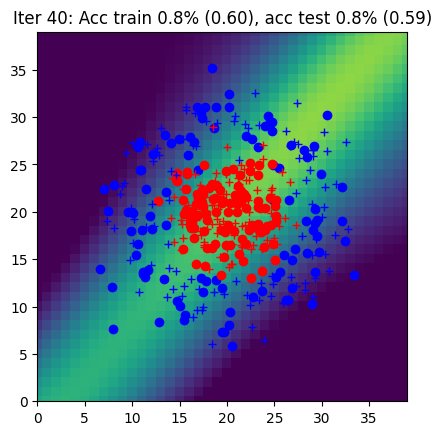

Iter 41: Acc train 0.8% (0.59), acc test 0.8% (0.59)


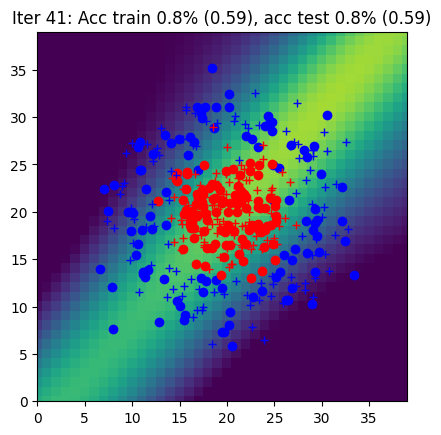

Iter 42: Acc train 0.8% (0.59), acc test 0.8% (0.59)


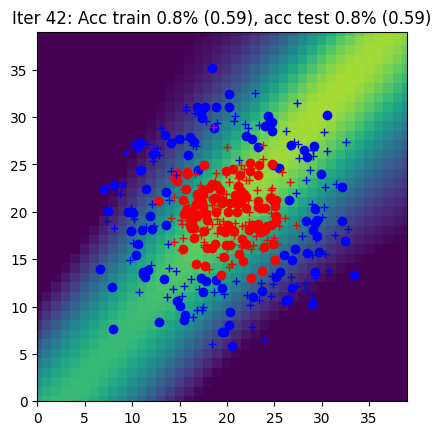

Iter 43: Acc train 0.8% (0.59), acc test 0.8% (0.58)


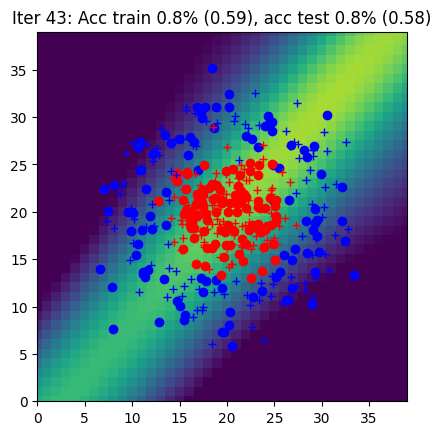

Iter 44: Acc train 0.8% (0.58), acc test 0.8% (0.58)


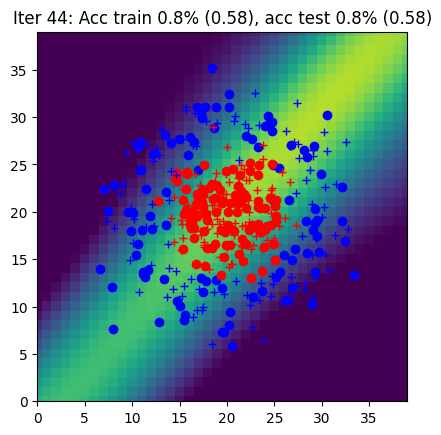

Iter 45: Acc train 0.8% (0.58), acc test 0.8% (0.58)


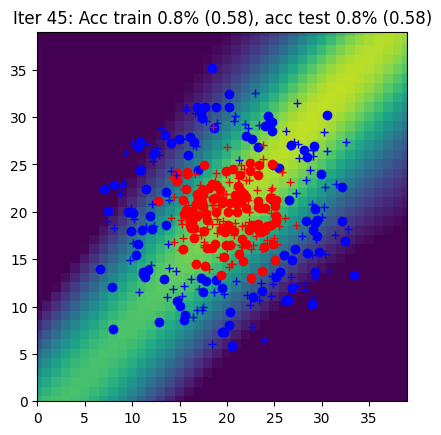

Iter 46: Acc train 0.8% (0.58), acc test 0.8% (0.57)


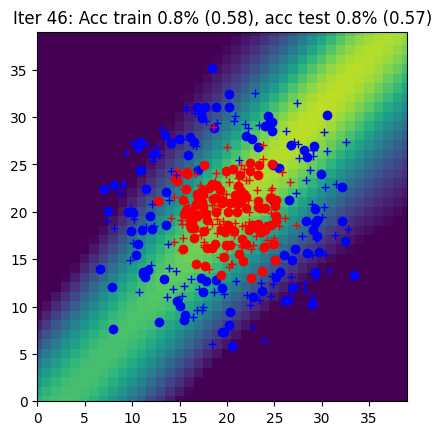

Iter 47: Acc train 0.8% (0.58), acc test 0.8% (0.57)


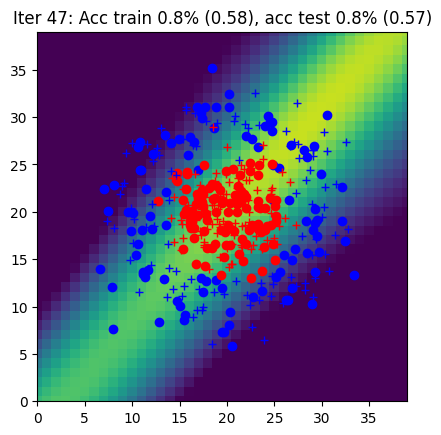

Iter 48: Acc train 0.8% (0.57), acc test 0.8% (0.57)


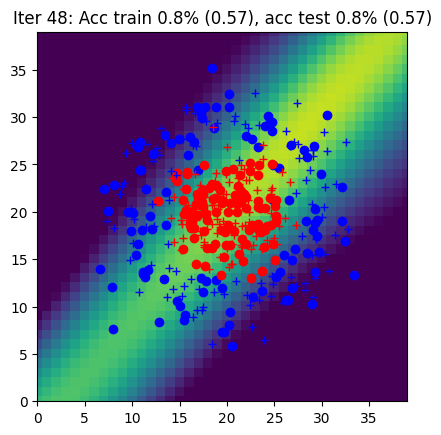

Iter 49: Acc train 0.8% (0.57), acc test 0.8% (0.56)


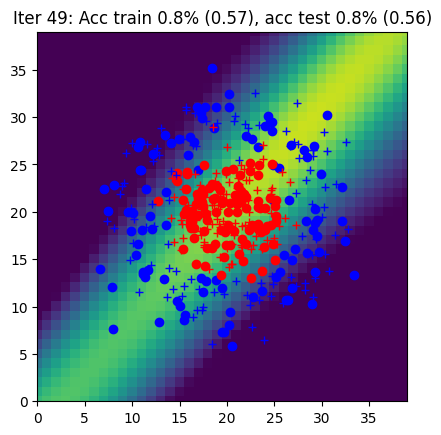

Iter 50: Acc train 0.8% (0.57), acc test 0.8% (0.56)


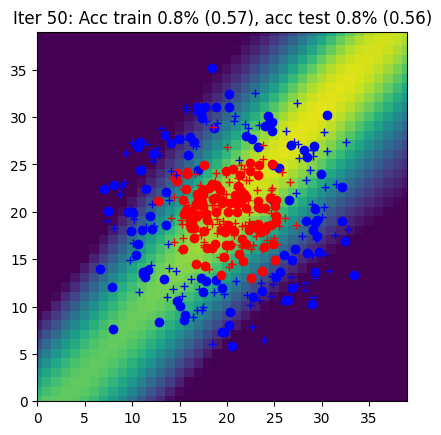

Iter 51: Acc train 0.8% (0.56), acc test 0.8% (0.56)


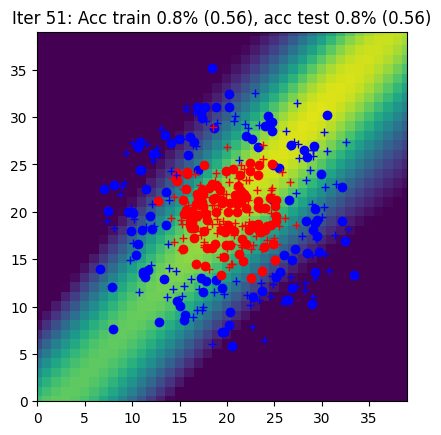

Iter 52: Acc train 0.8% (0.56), acc test 0.8% (0.55)


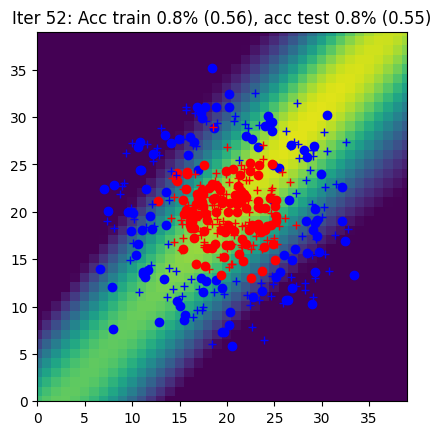

Iter 53: Acc train 0.8% (0.56), acc test 0.8% (0.55)


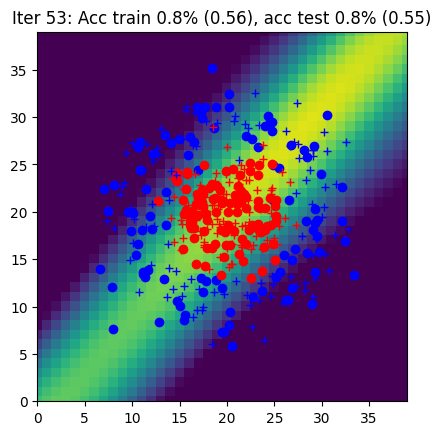

Iter 54: Acc train 0.8% (0.56), acc test 0.8% (0.55)


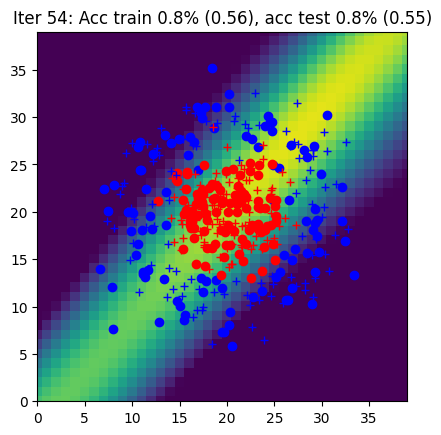

Iter 55: Acc train 0.8% (0.55), acc test 0.8% (0.54)


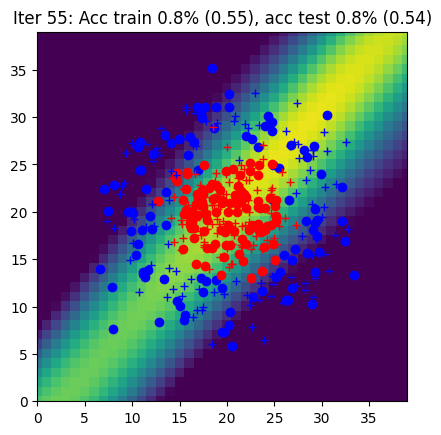

Iter 56: Acc train 0.8% (0.55), acc test 0.8% (0.54)


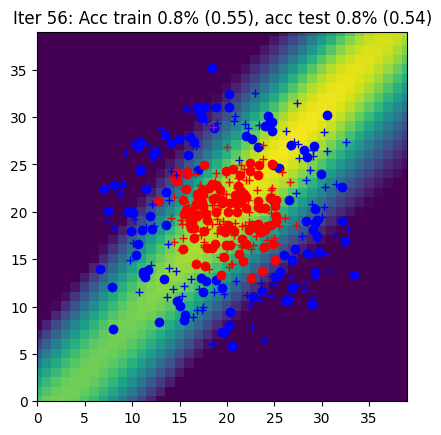

Iter 57: Acc train 0.8% (0.55), acc test 0.8% (0.54)


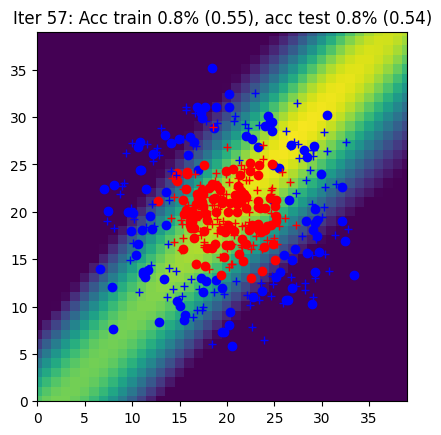

Iter 58: Acc train 0.8% (0.55), acc test 0.8% (0.54)


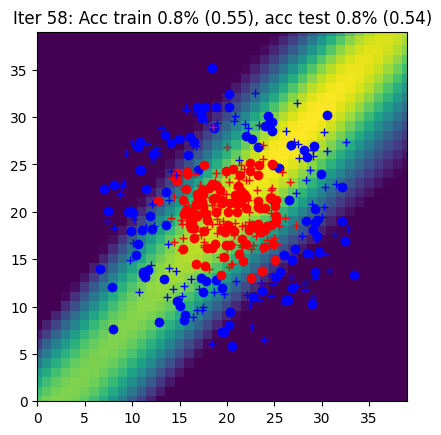

Iter 59: Acc train 0.8% (0.54), acc test 0.8% (0.53)


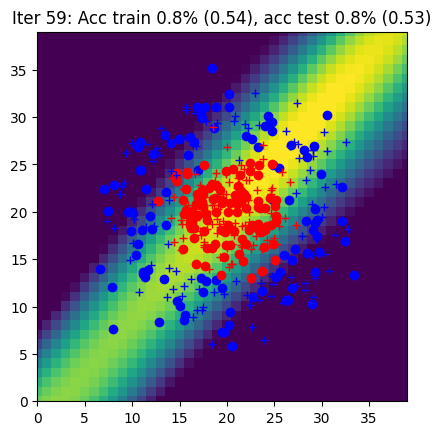

Iter 60: Acc train 0.8% (0.54), acc test 0.8% (0.53)


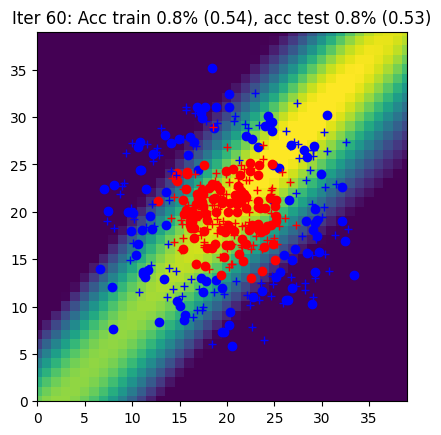

Iter 61: Acc train 0.8% (0.54), acc test 0.8% (0.53)


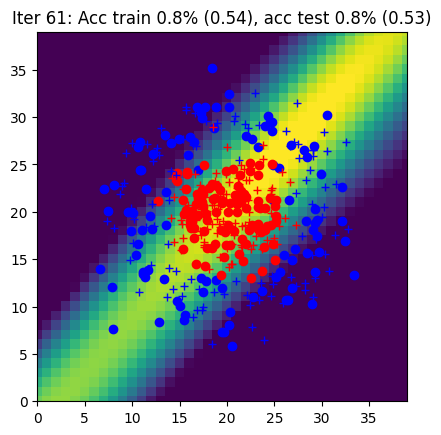

Iter 62: Acc train 0.8% (0.54), acc test 0.8% (0.53)


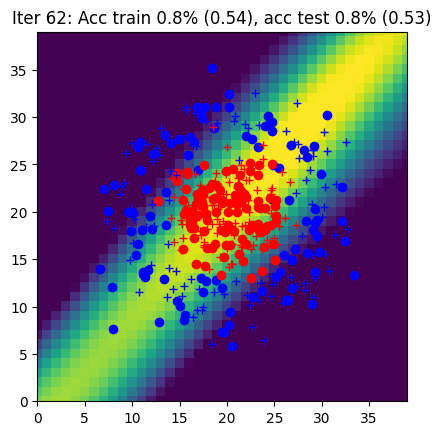

Iter 63: Acc train 0.8% (0.53), acc test 0.8% (0.52)


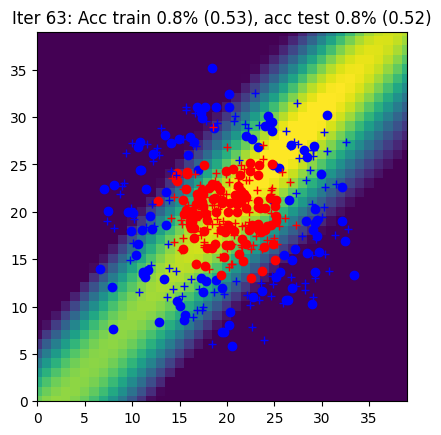

Iter 64: Acc train 0.8% (0.53), acc test 0.8% (0.52)


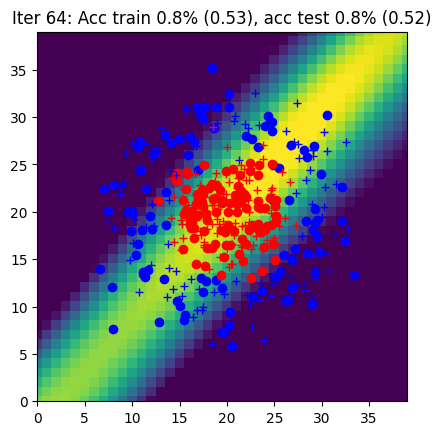

Iter 65: Acc train 0.8% (0.53), acc test 0.8% (0.52)


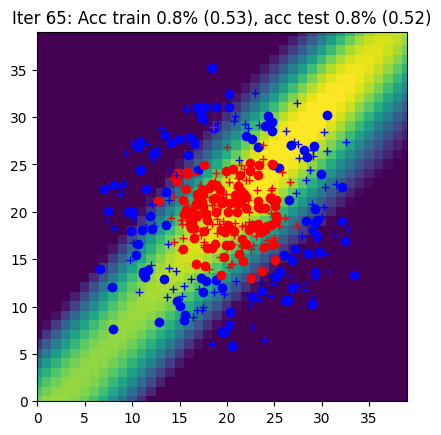

Iter 66: Acc train 0.8% (0.53), acc test 0.8% (0.52)


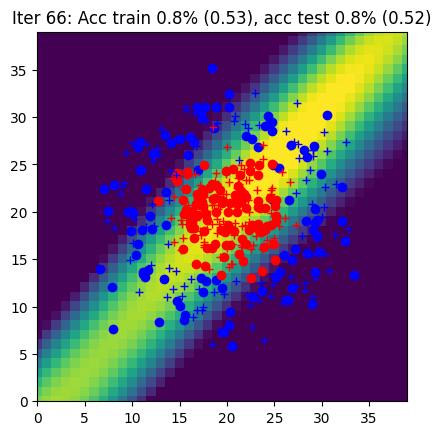

Iter 67: Acc train 0.8% (0.52), acc test 0.8% (0.51)


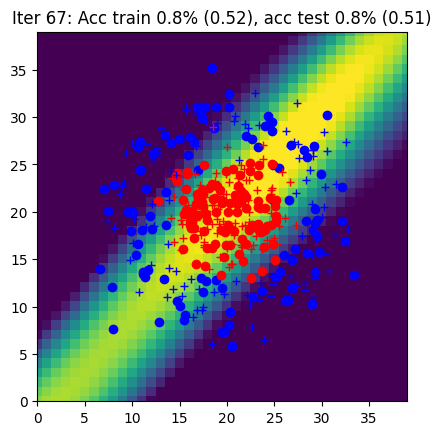

Iter 68: Acc train 0.8% (0.52), acc test 0.8% (0.51)


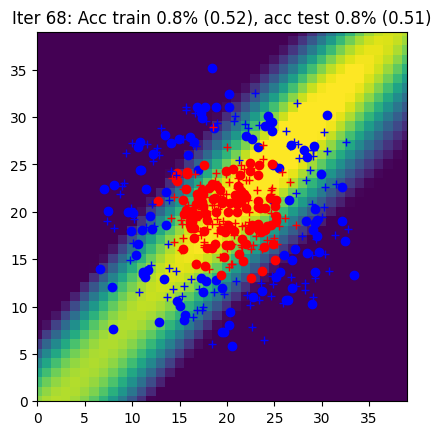

Iter 69: Acc train 0.8% (0.52), acc test 0.8% (0.51)


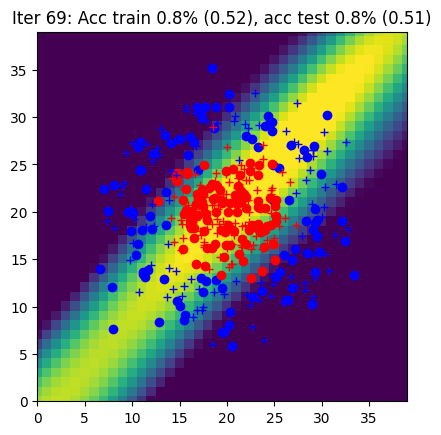

Iter 70: Acc train 0.8% (0.52), acc test 0.8% (0.51)


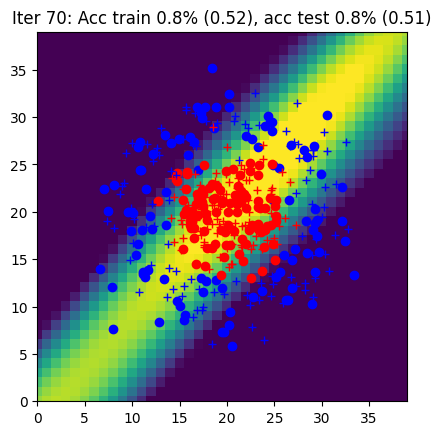

Iter 71: Acc train 0.8% (0.52), acc test 0.8% (0.51)


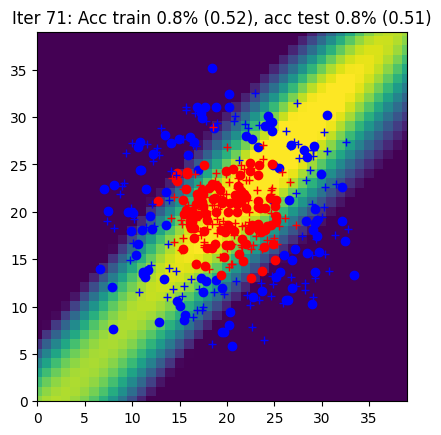

Iter 72: Acc train 0.8% (0.51), acc test 0.8% (0.50)


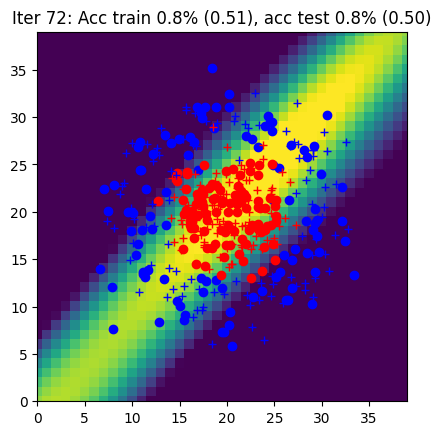

Iter 73: Acc train 0.8% (0.51), acc test 0.8% (0.50)


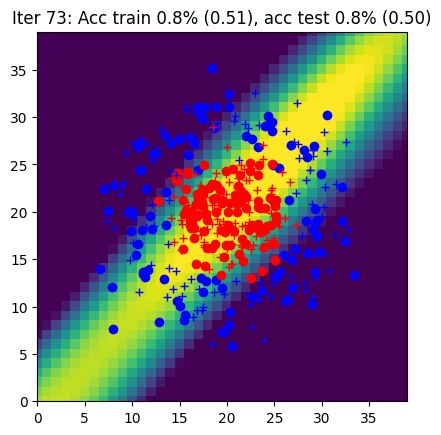

Iter 74: Acc train 0.8% (0.51), acc test 0.8% (0.50)


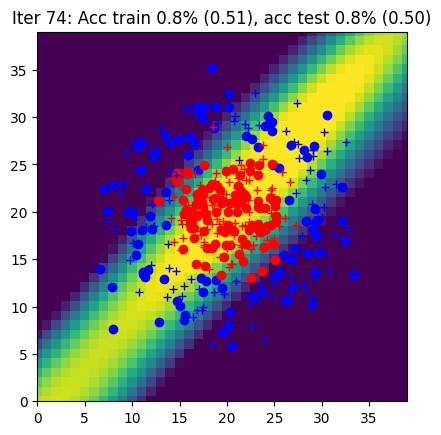

Iter 75: Acc train 0.8% (0.51), acc test 0.8% (0.50)


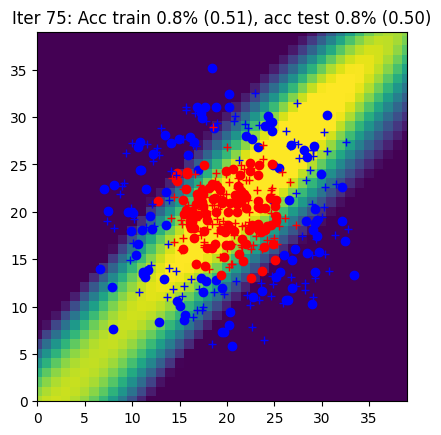

Iter 76: Acc train 0.8% (0.51), acc test 0.8% (0.49)


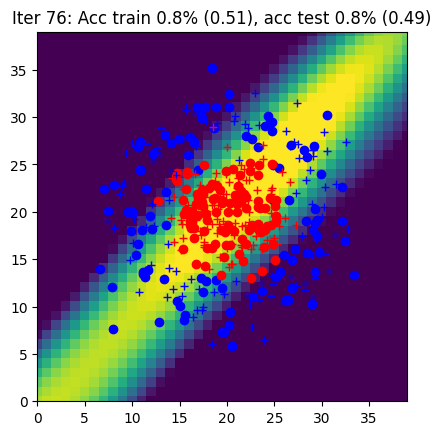

Iter 77: Acc train 0.8% (0.51), acc test 0.8% (0.49)


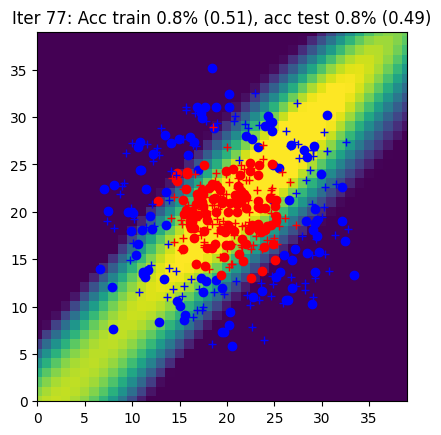

Iter 78: Acc train 0.8% (0.50), acc test 0.8% (0.49)


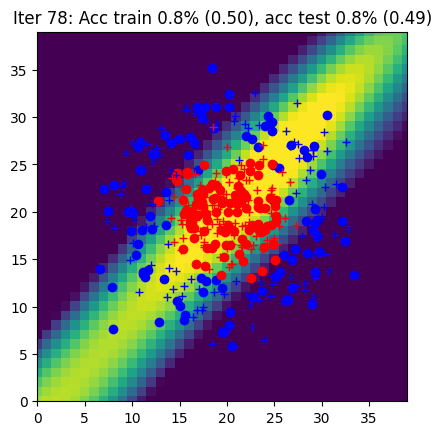

Iter 79: Acc train 0.8% (0.50), acc test 0.8% (0.49)


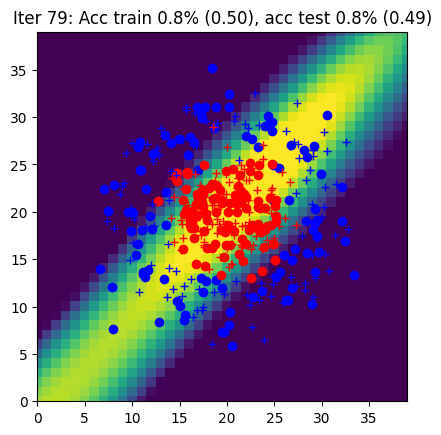

Iter 80: Acc train 0.8% (0.50), acc test 0.8% (0.49)


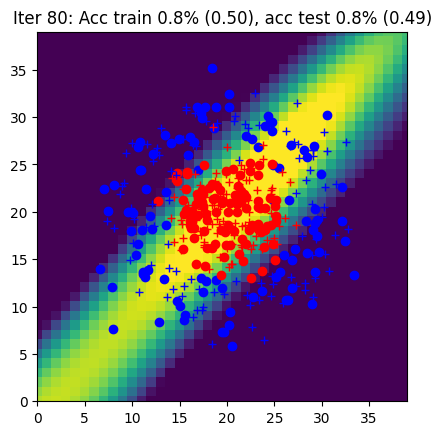

Iter 81: Acc train 0.8% (0.50), acc test 0.8% (0.48)


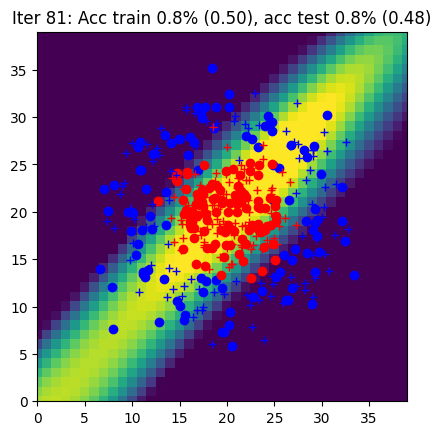

Iter 82: Acc train 0.8% (0.50), acc test 0.8% (0.48)


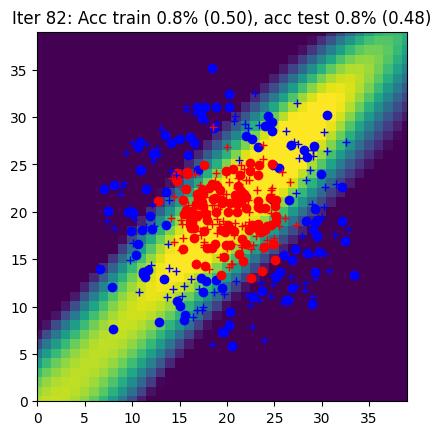

Iter 83: Acc train 0.8% (0.49), acc test 0.8% (0.48)


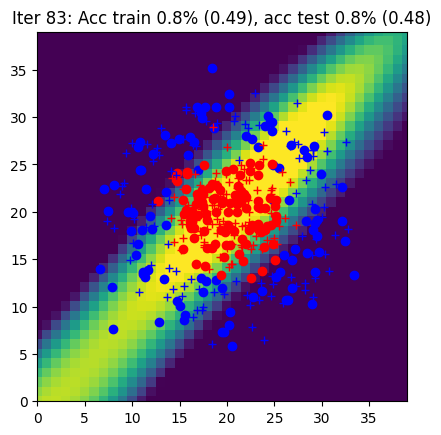

Iter 84: Acc train 0.8% (0.49), acc test 0.8% (0.48)


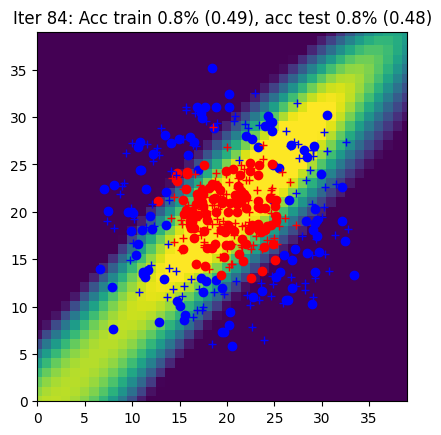

Iter 85: Acc train 0.8% (0.49), acc test 0.8% (0.47)


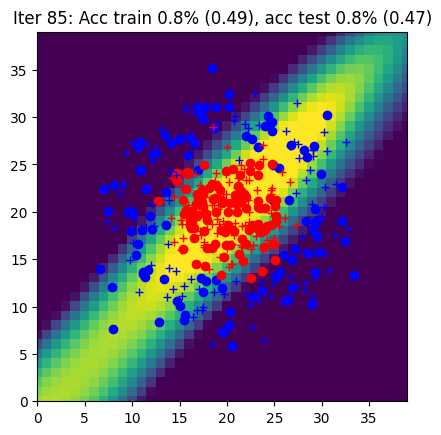

Iter 86: Acc train 0.8% (0.49), acc test 0.8% (0.47)


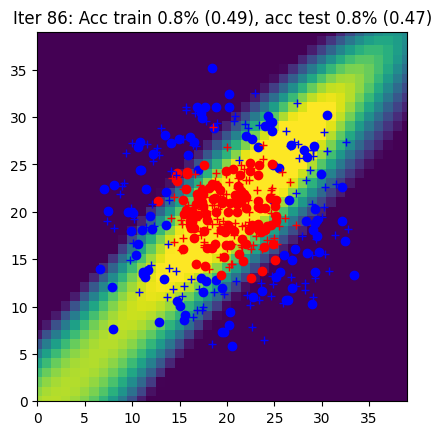

Iter 87: Acc train 0.8% (0.48), acc test 0.8% (0.47)


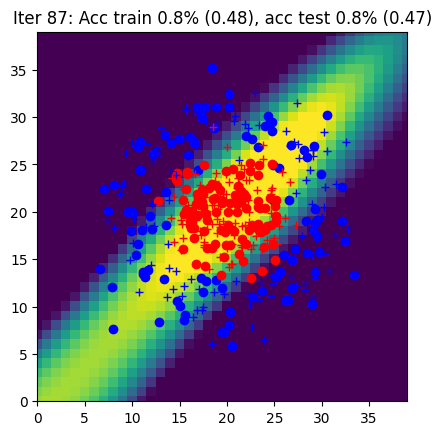

Iter 88: Acc train 0.8% (0.48), acc test 0.8% (0.47)


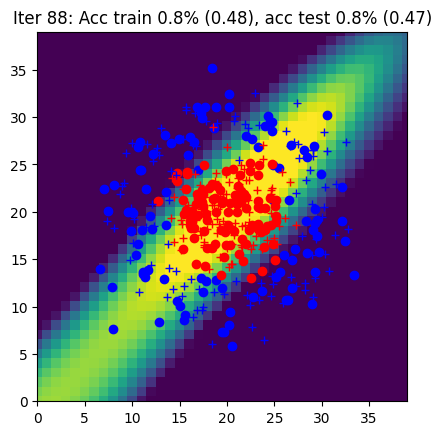

Iter 89: Acc train 0.8% (0.48), acc test 0.8% (0.46)


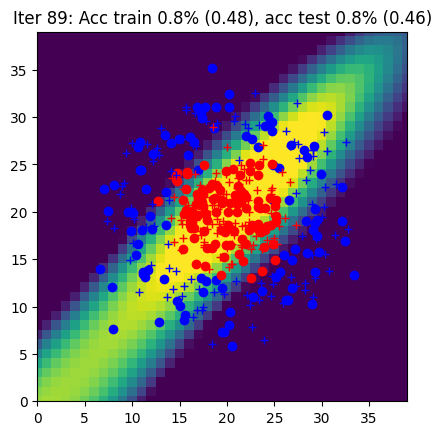

Iter 90: Acc train 0.8% (0.48), acc test 0.8% (0.46)


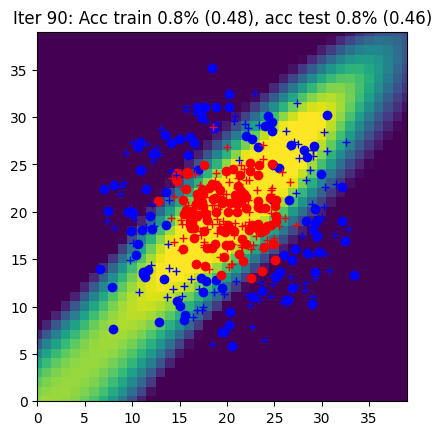

Iter 91: Acc train 0.8% (0.47), acc test 0.8% (0.46)


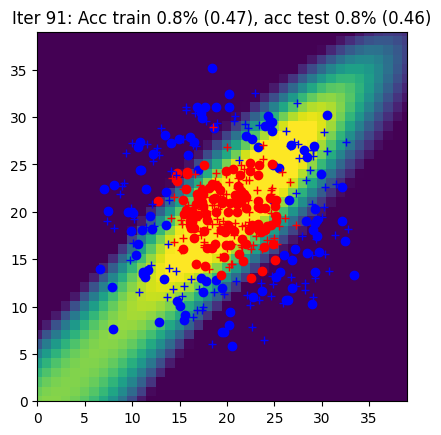

Iter 92: Acc train 0.8% (0.47), acc test 0.8% (0.46)


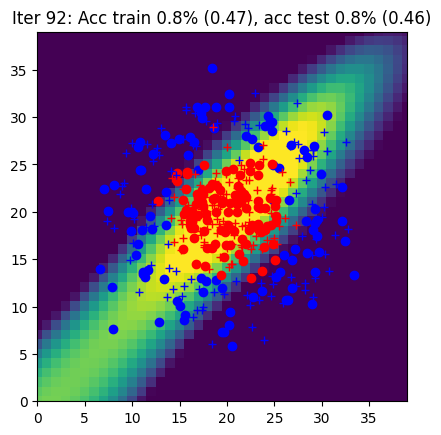

Iter 93: Acc train 0.8% (0.47), acc test 0.8% (0.45)


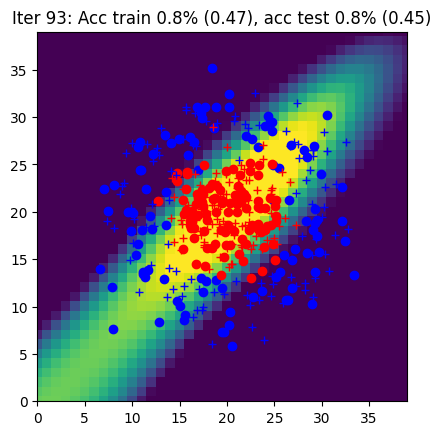

Iter 94: Acc train 0.8% (0.47), acc test 0.8% (0.45)


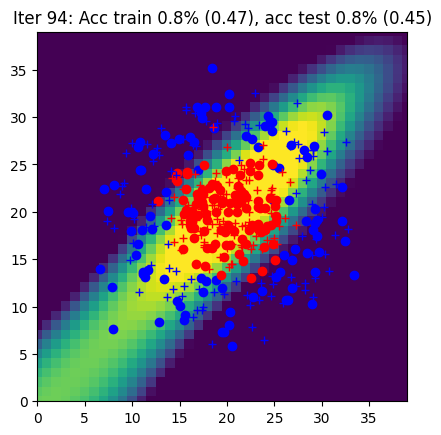

Iter 95: Acc train 0.8% (0.46), acc test 0.8% (0.45)


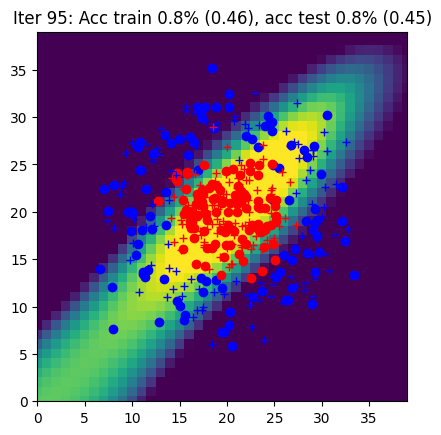

Iter 96: Acc train 0.8% (0.46), acc test 0.8% (0.44)


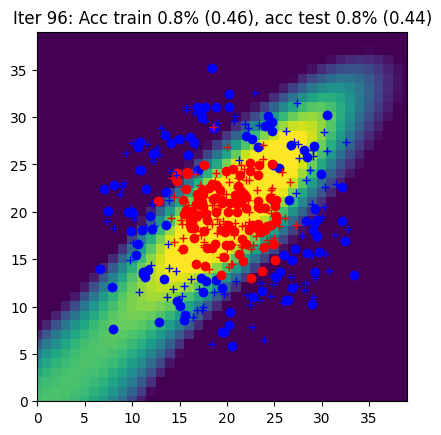

Iter 97: Acc train 0.8% (0.45), acc test 0.8% (0.44)


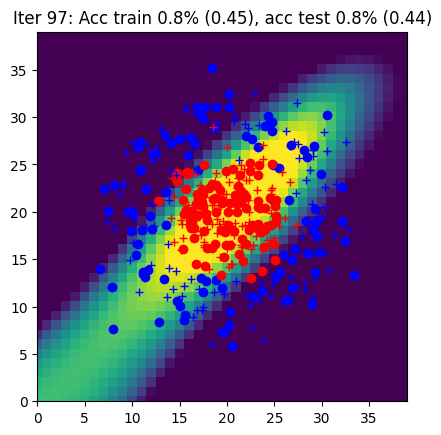

Iter 98: Acc train 0.8% (0.45), acc test 0.8% (0.44)


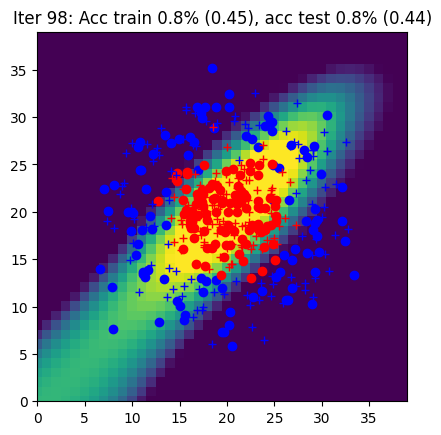

Iter 99: Acc train 0.8% (0.45), acc test 0.8% (0.43)


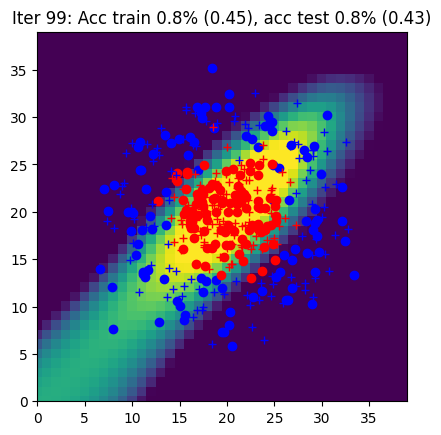

Iter 100: Acc train 0.8% (0.44), acc test 0.8% (0.43)


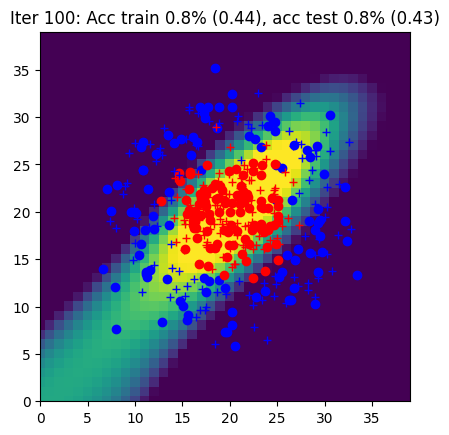

Iter 101: Acc train 0.8% (0.44), acc test 0.8% (0.42)


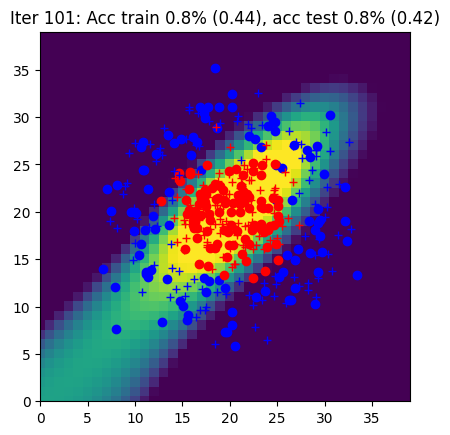

Iter 102: Acc train 0.8% (0.43), acc test 0.8% (0.42)


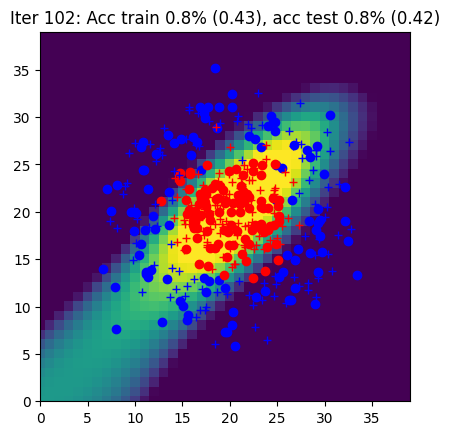

Iter 103: Acc train 0.8% (0.43), acc test 0.8% (0.41)


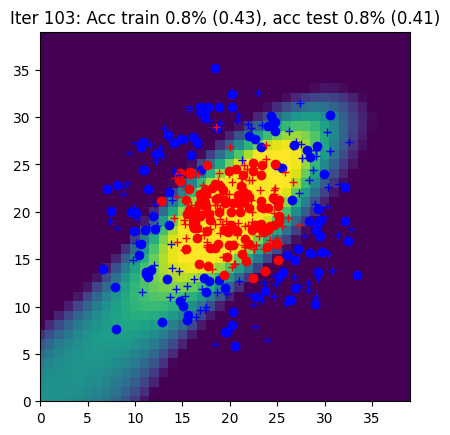

Iter 104: Acc train 0.8% (0.43), acc test 0.8% (0.41)


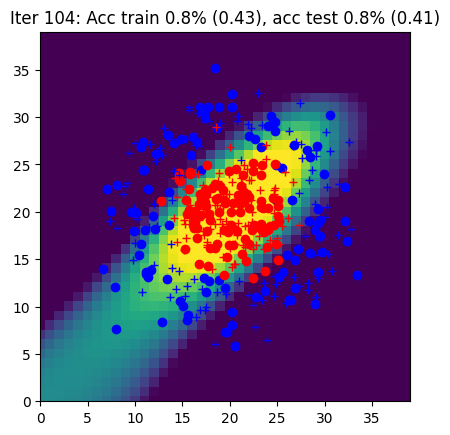

Iter 105: Acc train 0.8% (0.42), acc test 0.8% (0.40)


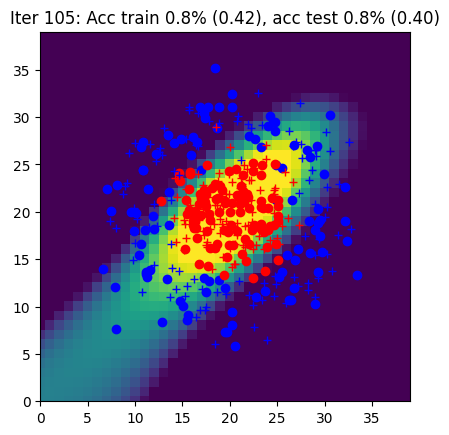

Iter 106: Acc train 0.8% (0.42), acc test 0.8% (0.40)


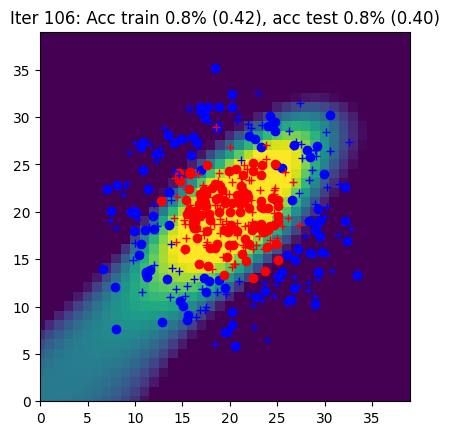

Iter 107: Acc train 0.8% (0.41), acc test 0.8% (0.40)


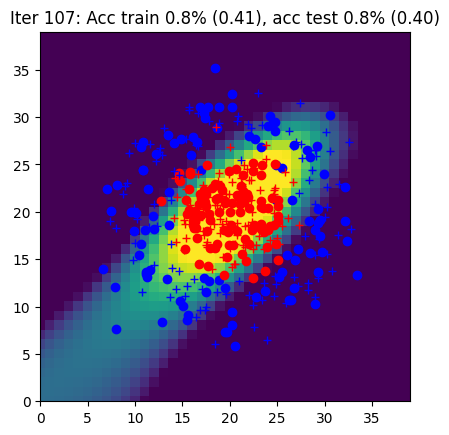

Iter 108: Acc train 0.8% (0.41), acc test 0.8% (0.39)


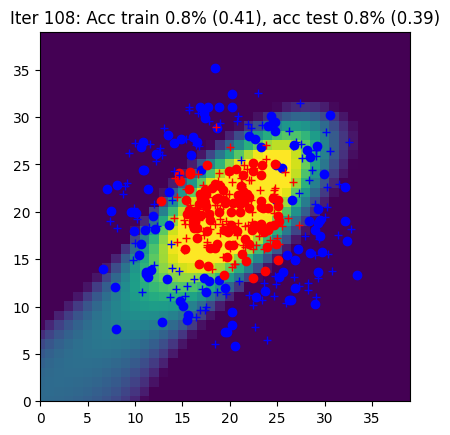

Iter 109: Acc train 0.8% (0.40), acc test 0.9% (0.39)


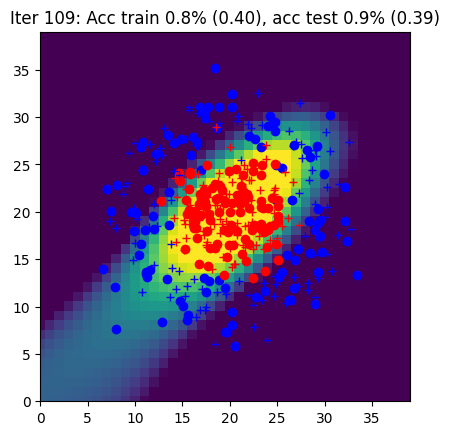

Iter 110: Acc train 0.9% (0.40), acc test 0.9% (0.38)


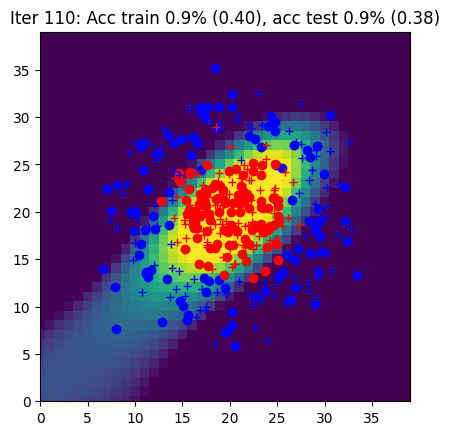

Iter 111: Acc train 0.9% (0.39), acc test 0.9% (0.38)


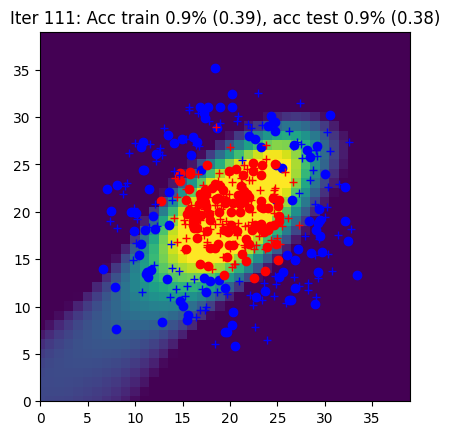

Iter 112: Acc train 0.9% (0.39), acc test 0.9% (0.37)


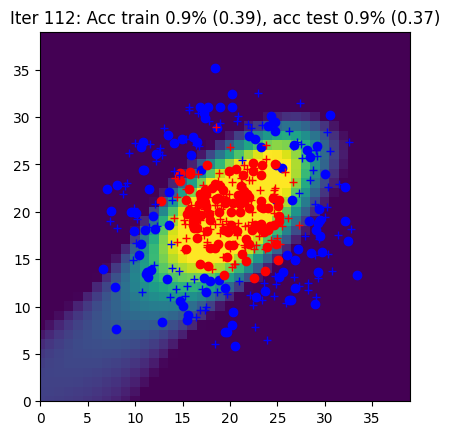

Iter 113: Acc train 0.9% (0.38), acc test 0.9% (0.37)


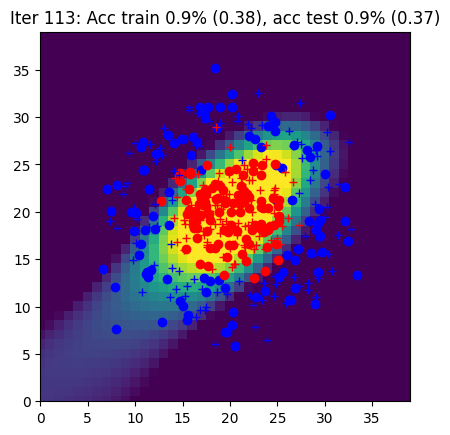

Iter 114: Acc train 0.9% (0.38), acc test 0.9% (0.36)


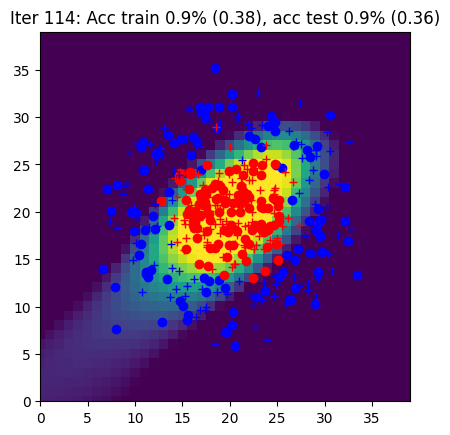

Iter 115: Acc train 0.9% (0.37), acc test 0.9% (0.36)


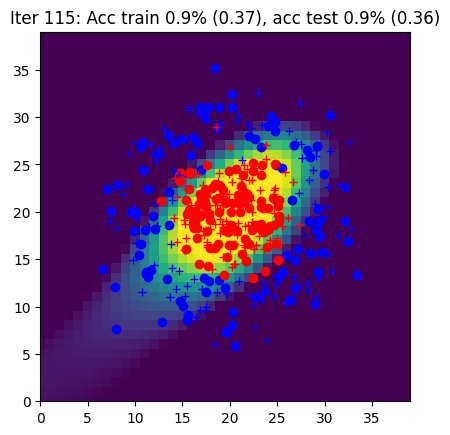

Iter 116: Acc train 0.9% (0.37), acc test 0.9% (0.35)


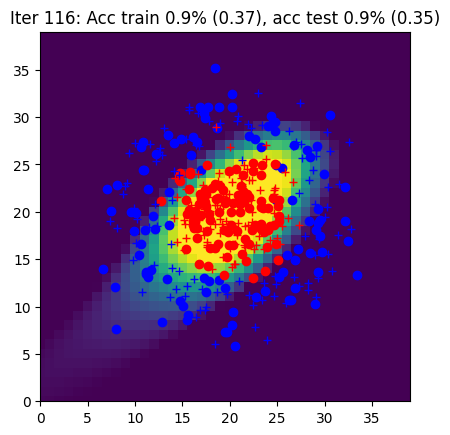

Iter 117: Acc train 0.9% (0.36), acc test 0.9% (0.35)


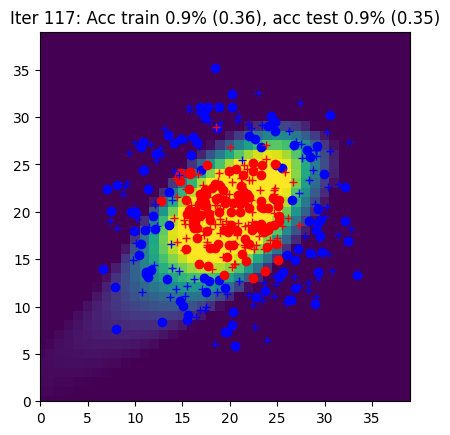

Iter 118: Acc train 0.9% (0.36), acc test 0.9% (0.34)


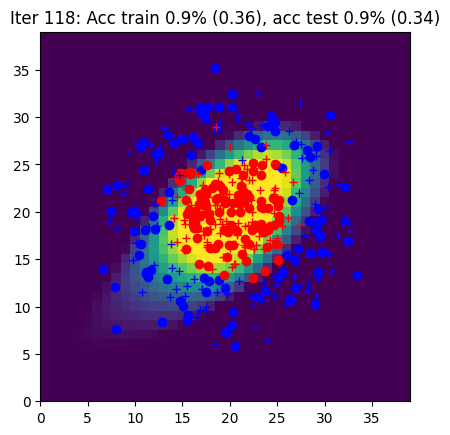

Iter 119: Acc train 0.9% (0.35), acc test 0.9% (0.34)


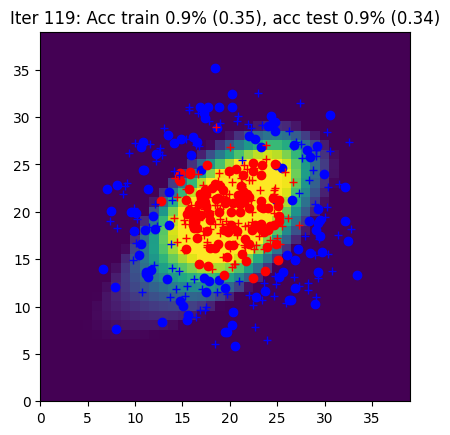

Iter 120: Acc train 0.9% (0.35), acc test 0.9% (0.33)


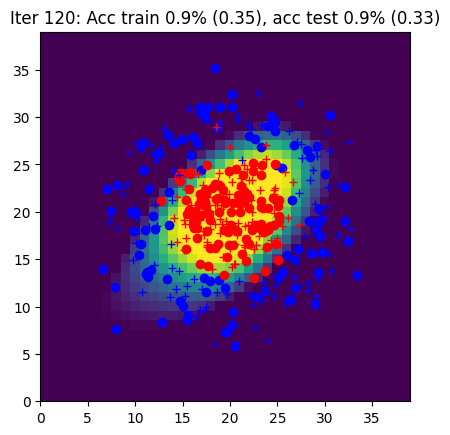

Iter 121: Acc train 0.9% (0.34), acc test 0.9% (0.33)


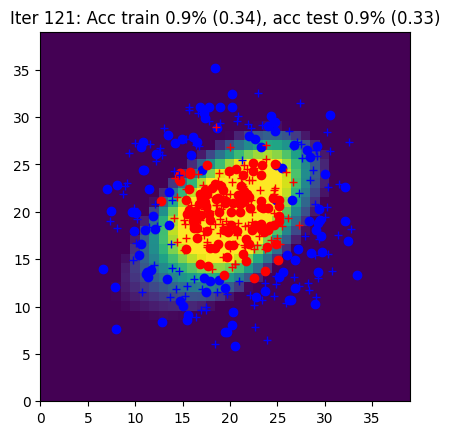

Iter 122: Acc train 0.9% (0.34), acc test 0.9% (0.32)


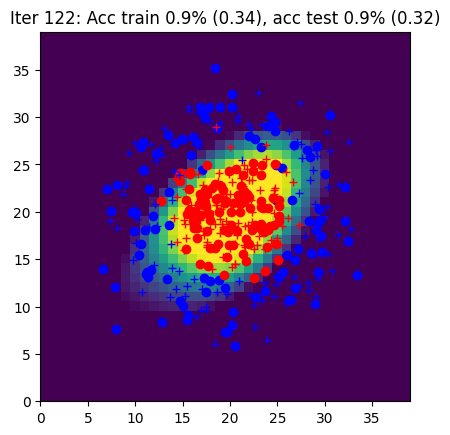

Iter 123: Acc train 0.9% (0.33), acc test 0.9% (0.32)


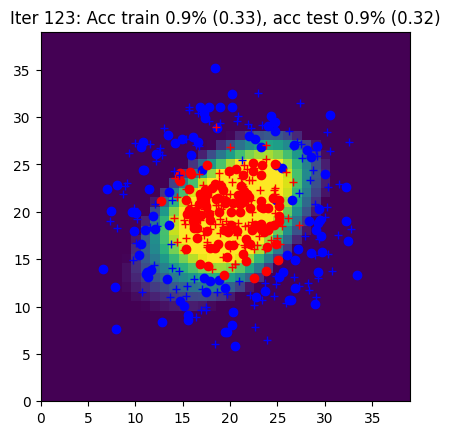

Iter 124: Acc train 0.9% (0.33), acc test 0.9% (0.31)


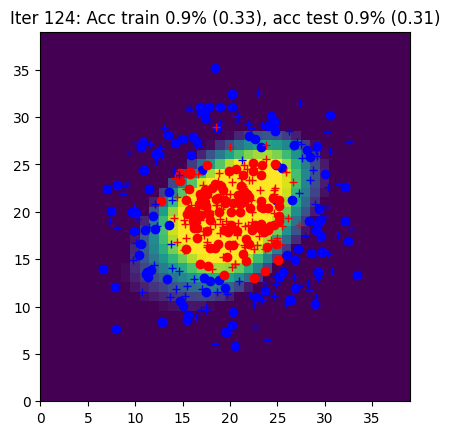

Iter 125: Acc train 0.9% (0.32), acc test 0.9% (0.31)


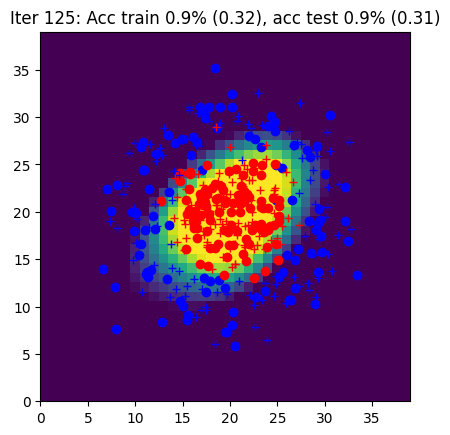

Iter 126: Acc train 0.9% (0.32), acc test 0.9% (0.30)


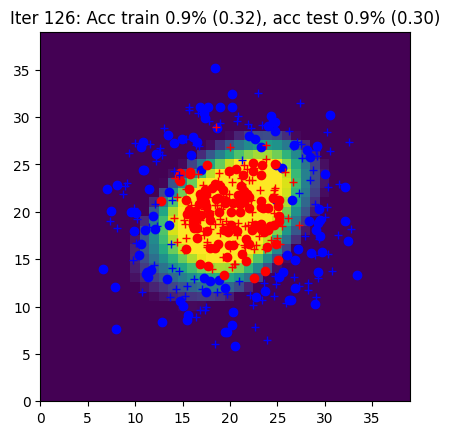

Iter 127: Acc train 0.9% (0.31), acc test 0.9% (0.30)


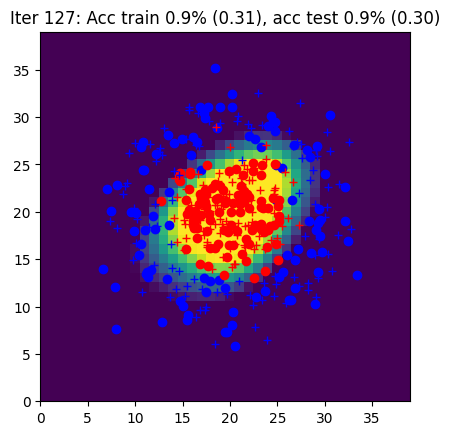

Iter 128: Acc train 0.9% (0.31), acc test 0.9% (0.30)


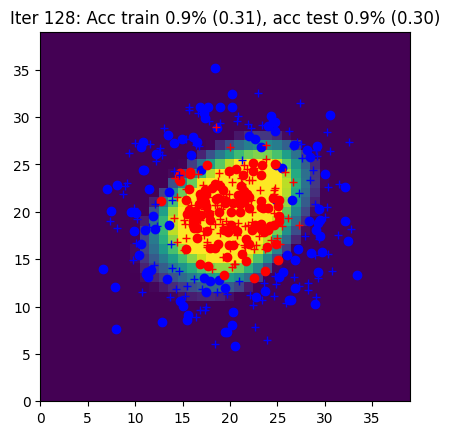

Iter 129: Acc train 0.9% (0.30), acc test 0.9% (0.29)


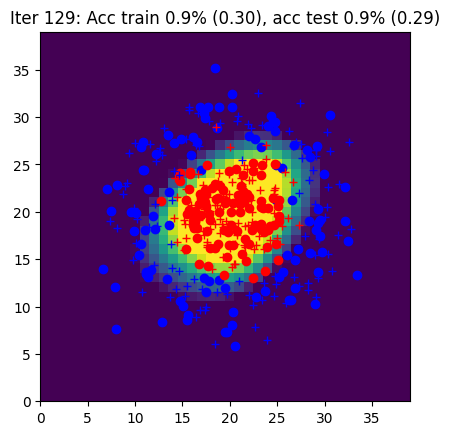

Iter 130: Acc train 0.9% (0.30), acc test 0.9% (0.29)


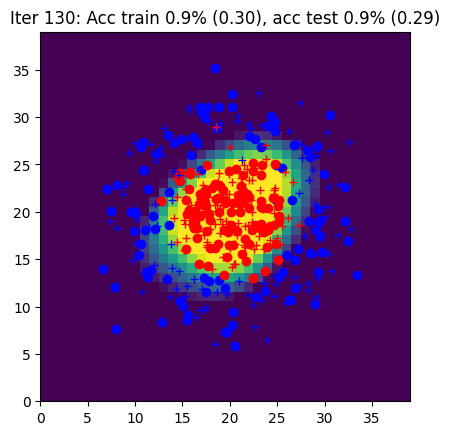

Iter 131: Acc train 0.9% (0.30), acc test 0.9% (0.29)


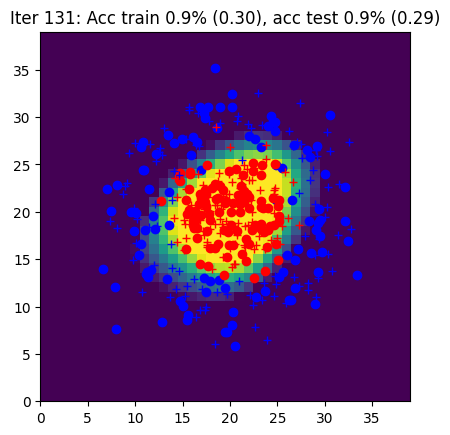

Iter 132: Acc train 0.9% (0.29), acc test 0.9% (0.28)


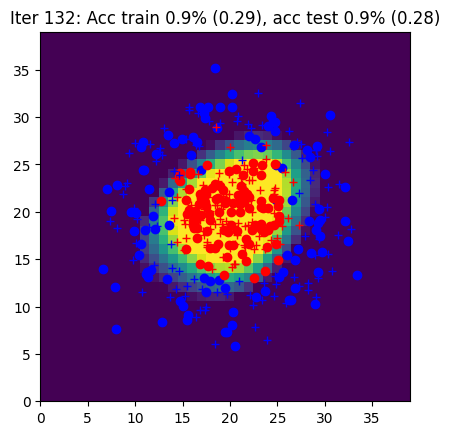

Iter 133: Acc train 0.9% (0.29), acc test 1.0% (0.28)


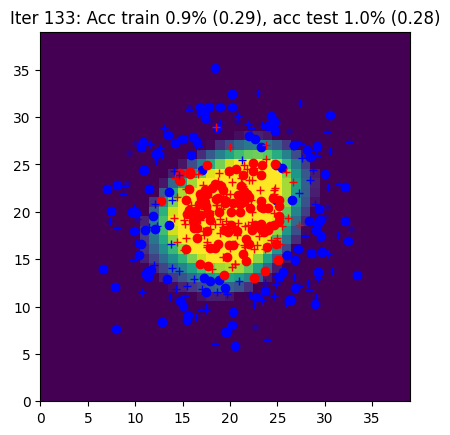

Iter 134: Acc train 0.9% (0.29), acc test 0.9% (0.28)


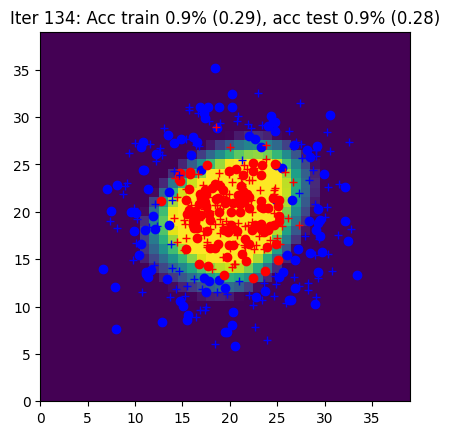

Iter 135: Acc train 0.9% (0.28), acc test 1.0% (0.27)


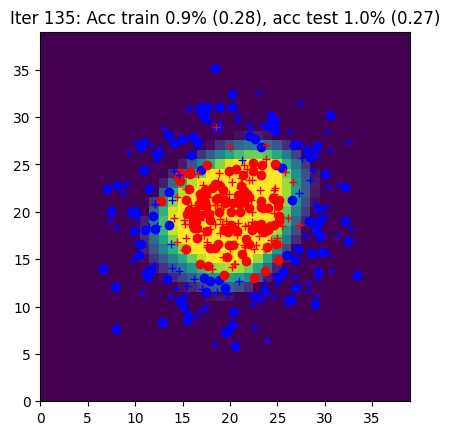

Iter 136: Acc train 0.9% (0.28), acc test 1.0% (0.27)


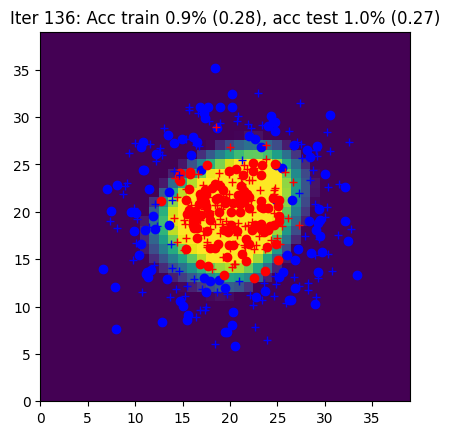

Iter 137: Acc train 0.9% (0.27), acc test 1.0% (0.27)


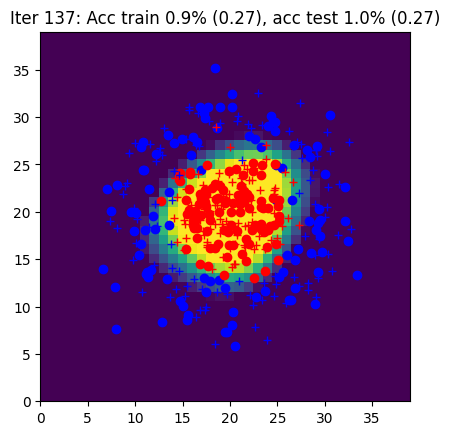

Iter 138: Acc train 0.9% (0.27), acc test 1.0% (0.26)


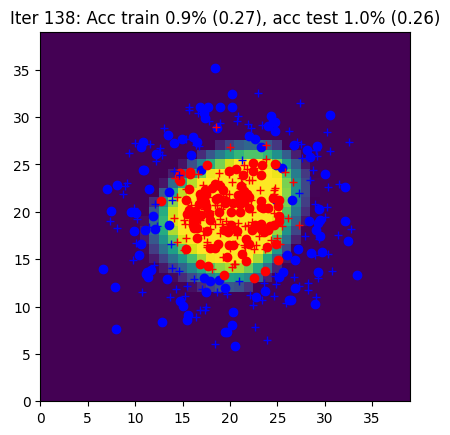

Iter 139: Acc train 0.9% (0.27), acc test 1.0% (0.26)


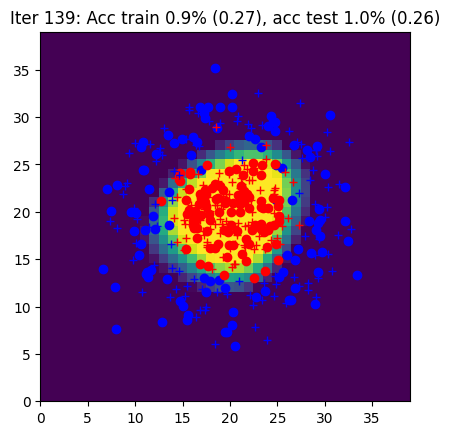

Iter 140: Acc train 0.9% (0.27), acc test 1.0% (0.26)


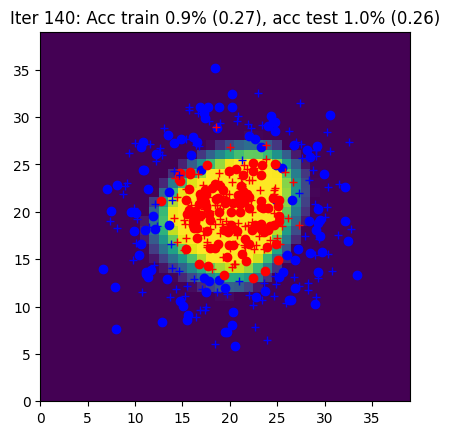

Iter 141: Acc train 0.9% (0.26), acc test 1.0% (0.26)


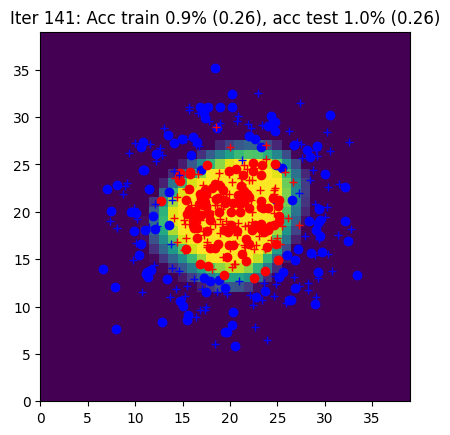

Iter 142: Acc train 0.9% (0.26), acc test 1.0% (0.25)


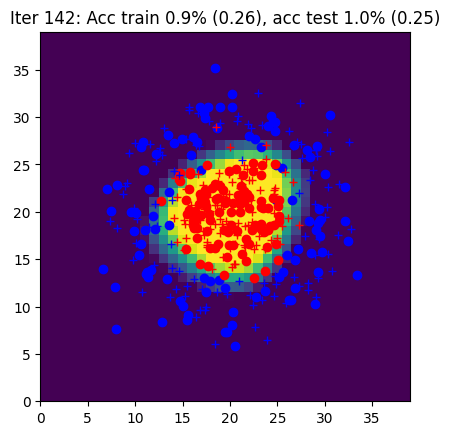

Iter 143: Acc train 0.9% (0.26), acc test 1.0% (0.25)


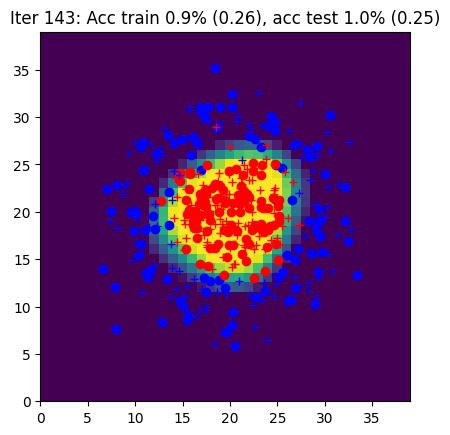

Iter 144: Acc train 0.9% (0.25), acc test 1.0% (0.25)


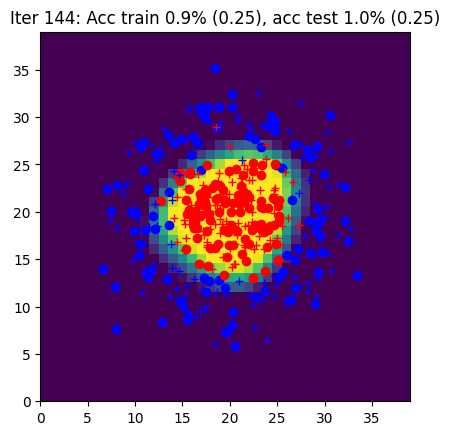

Iter 145: Acc train 0.9% (0.25), acc test 1.0% (0.25)


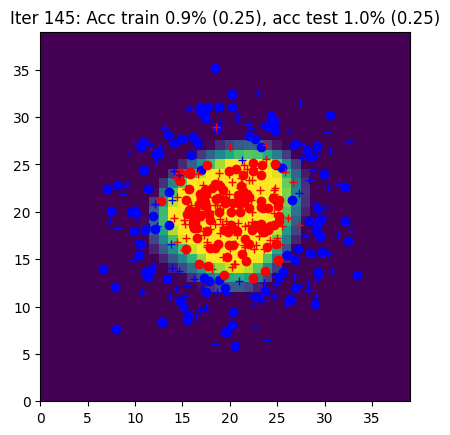

Iter 146: Acc train 0.9% (0.25), acc test 1.0% (0.24)


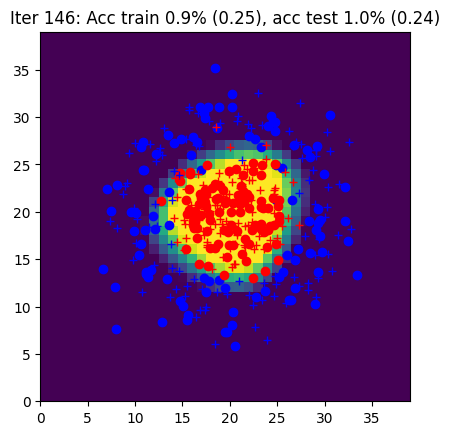

Iter 147: Acc train 0.9% (0.25), acc test 0.9% (0.24)


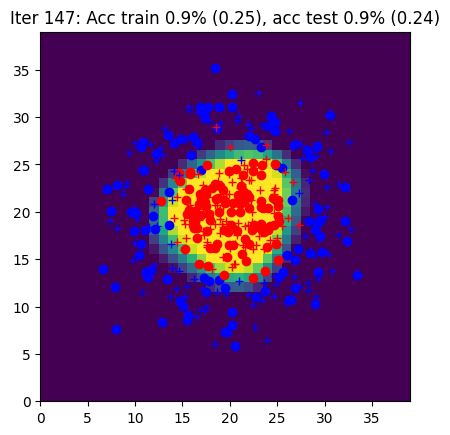

Iter 148: Acc train 0.9% (0.24), acc test 0.9% (0.24)


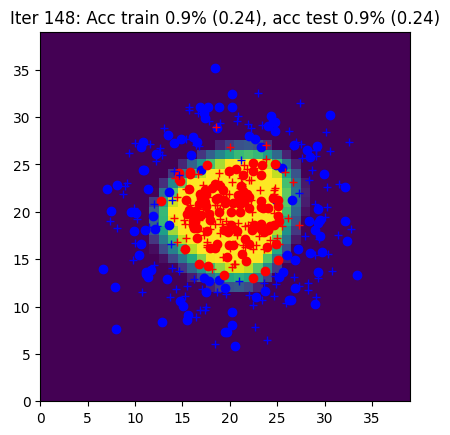

Iter 149: Acc train 0.9% (0.24), acc test 0.9% (0.24)


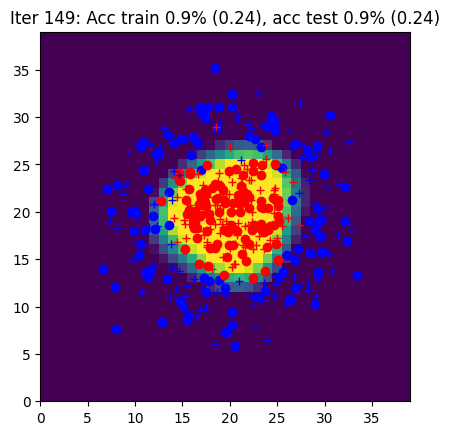

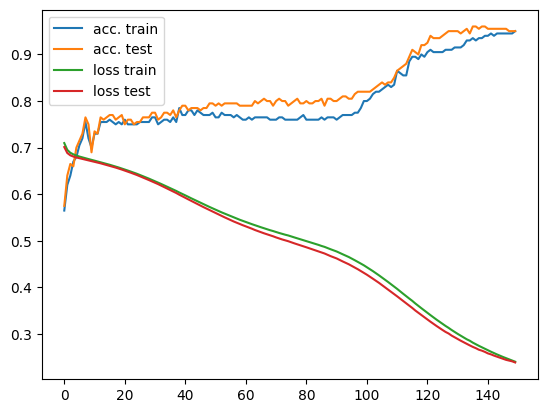

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss, optim = init_model(nx, nh, ny, eta)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code  here ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        pred = model(X)
        l_value = loss(pred, Y)
        optim.zero_grad()
        l_value.backward()
        optim.step()

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: loss_accuracy
        # the forward with the predict method from the model
        # the backward function with autograd
        # and then an optimization step

    ####################
    ##      FIN        #
    ####################


    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ygrid = model(data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 4.5 : Hyper-parameters

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tqdm

# Initialize data
data = CirclesData()
N = data.Xtrain.shape[0]

# Define batch sizes and learning rates to explore
batch_sizes = [5, 10, 20, 50]  # example batch sizes
learning_rates = [0.001, 0.01, 0.03, 0.1]  # example learning rates

# Results storage
results = {
    'batch_size': [],
    'learning_rate': [],
    'train_accuracy': [],
    'test_accuracy': [],
    'train_loss': [],
    'test_loss': [],
    'train_loss_curves': {},  # Store training loss curves for convergence speed
    'test_loss_curves': {}     # Store test loss curves for convergence speed
}

# Loop through batch sizes and learning rates
for Nbatch in batch_sizes:
    for eta in tqdm.tqdm(learning_rates):
        # Initialize the model for each combination of batch size and learning rate
        model, loss, optim = init_model(nx, nh, ny, eta)

        # Store curves for this configuration
        curves = [[], [], [], []]

        # Store loss curves for this configuration
        results['train_loss_curves'][(Nbatch, eta)] = []
        results['test_loss_curves'][(Nbatch, eta)] = []

        # Epochs
        for iteration in range(150):
            # Permute
            perm = np.random.permutation(N)
            Xtrain = data.Xtrain[perm, :]
            Ytrain = data.Ytrain[perm, :]

            # Batches
            for j in range(N // Nbatch):
                indsBatch = range(j * Nbatch, (j + 1) * Nbatch)
                X = Xtrain[indsBatch, :]
                Y = Ytrain[indsBatch, :]

                pred = model(X)
                l_value = loss(pred, Y)
                optim.zero_grad()
                l_value.backward()
                optim.step()

            # Calculate train and test accuracy and loss
            Yhat_train = model(data.Xtrain)
            Yhat_test = model(data.Xtest)
            Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
            Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)

            # Store the metrics for plotting
            curves[0].append(acctrain)
            curves[1].append(acctest)
            curves[2].append(Ltrain)
            curves[3].append(Ltest)

            # Store the current training and test loss for convergence speed
            results['train_loss_curves'][(Nbatch, eta)].append(Ltrain)
            results['test_loss_curves'][(Nbatch, eta)].append(Ltest)

        # Append results for this configuration
        results['batch_size'].append(Nbatch)
        results['learning_rate'].append(eta)
        results['train_accuracy'].append(curves[0][-1])
        results['test_accuracy'].append(curves[1][-1])
        results['train_loss'].append(curves[2][-1])
        results['test_loss'].append(curves[3][-1])



100%|██████████| 4/4 [00:03<00:00,  1.30it/s]


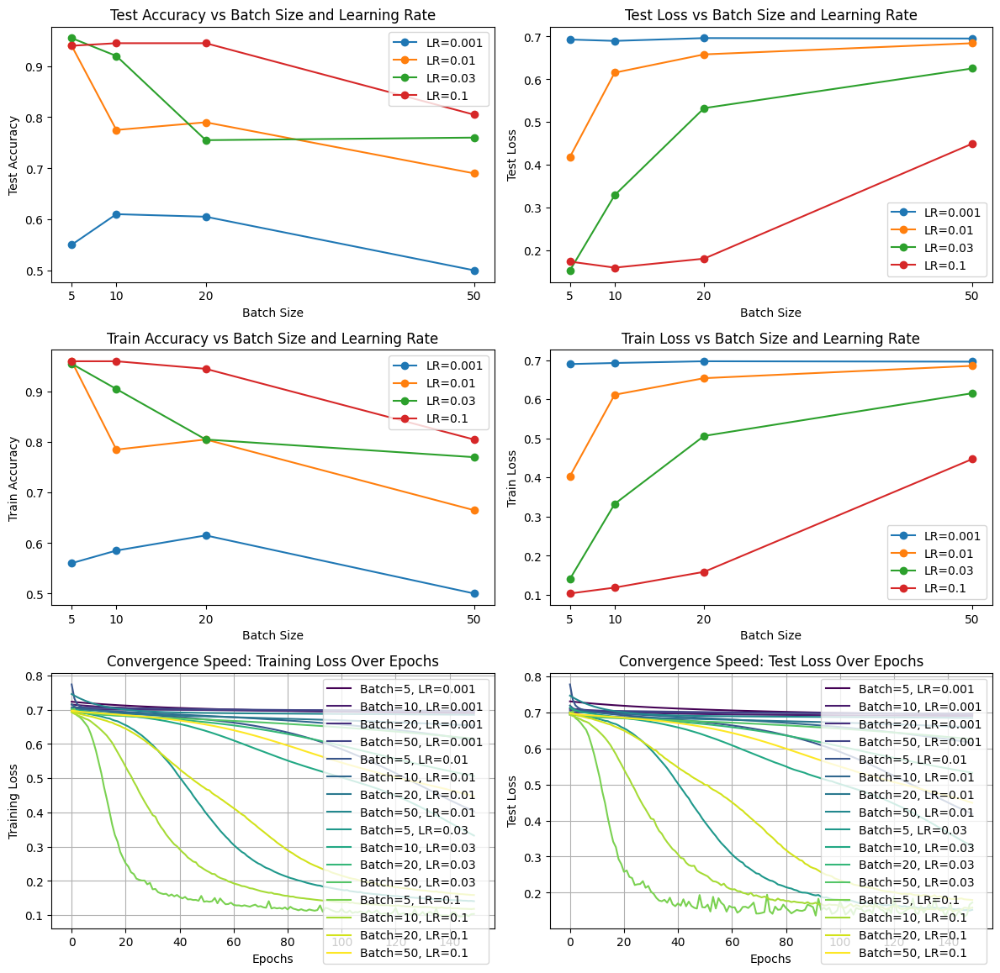

In [ ]:
# Plotting results
plt.figure(figsize=(12, 12))

# Accuracy Plot
plt.subplot(3, 2, 1)
plt.title('Test Accuracy vs Batch Size and Learning Rate')
for lr in learning_rates:
    mask = np.array(results['learning_rate']) == lr
    plt.plot(np.array(results['batch_size'])[mask], np.array(results['test_accuracy'])[mask], marker='o', label=f'LR={lr}')
plt.xlabel('Batch Size')
plt.ylabel('Test Accuracy')
plt.xticks(batch_sizes)
plt.legend()

# Loss Plot
plt.subplot(3, 2, 2)
plt.title('Test Loss vs Batch Size and Learning Rate')
for lr in learning_rates:
    mask = np.array(results['learning_rate']) == lr
    plt.plot(np.array(results['batch_size'])[mask], np.array(results['test_loss'])[mask], marker='o', label=f'LR={lr}')
plt.xlabel('Batch Size')
plt.ylabel('Test Loss')
plt.xticks(batch_sizes)
plt.legend()

# Train Accuracy Plot
plt.subplot(3, 2, 3)
plt.title('Train Accuracy vs Batch Size and Learning Rate')
for lr in learning_rates:
    mask = np.array(results['learning_rate']) == lr
    plt.plot(np.array(results['batch_size'])[mask], np.array(results['train_accuracy'])[mask], marker='o', label=f'LR={lr}')
plt.xlabel('Batch Size')
plt.ylabel('Train Accuracy')
plt.xticks(batch_sizes)
plt.legend()

# Train Loss Plot
plt.subplot(3, 2, 4)
plt.title('Train Loss vs Batch Size and Learning Rate')
for lr in learning_rates:
    mask = np.array(results['learning_rate']) == lr
    plt.plot(np.array(results['batch_size'])[mask], np.array(results['train_loss'])[mask], marker='o', label=f'LR={lr}')
plt.xlabel('Batch Size')
plt.ylabel('Train Loss')
plt.xticks(batch_sizes)
plt.legend()

# Convergence Speed: Training Loss Plot
plt.subplot(3, 2, 5)
plt.title('Convergence Speed: Training Loss Over Epochs')
colors = plt.cm.viridis(np.linspace(0, 1, len(batch_sizes) * len(learning_rates)))  # Get distinct colors
for idx, (lr, Nbatch) in enumerate([(lr, Nbatch) for lr in learning_rates for Nbatch in batch_sizes]):
    plt.plot(results['train_loss_curves'][(Nbatch, lr)], color=colors[idx], label=f'Batch={Nbatch}, LR={lr}')
plt.xlabel('Epochs')
plt.ylabel('Training Loss')
plt.legend(loc='upper right')
plt.grid()

# Convergence Speed: Test Loss Plot
plt.subplot(3, 2, 6)
plt.title('Convergence Speed: Test Loss Over Epochs')
for idx, (lr, Nbatch) in enumerate([(lr, Nbatch) for lr in learning_rates for Nbatch in batch_sizes]):
    plt.plot(results['test_loss_curves'][(Nbatch, lr)], color=colors[idx], label=f'Batch={Nbatch}, LR={lr}')
plt.xlabel('Epochs')
plt.ylabel('Test Loss')
plt.legend(loc='upper right')
plt.grid()

plt.tight_layout()
plt.show()

# Part 5 : MNIST

Apply the code from previous part code to the MNIST dataset.

Iter 0: Acc train 0.84% (0.55), acc test 0.85% (0.53)
Iter 1: Acc train 0.87% (0.46), acc test 0.87% (0.45)
Iter 2: Acc train 0.87% (0.44), acc test 0.88% (0.43)
Iter 3: Acc train 0.87% (0.43), acc test 0.88% (0.42)
Iter 4: Acc train 0.88% (0.40), acc test 0.89% (0.38)
Iter 5: Acc train 0.89% (0.38), acc test 0.89% (0.37)
Iter 6: Acc train 0.89% (0.37), acc test 0.89% (0.36)
Iter 7: Acc train 0.88% (0.40), acc test 0.88% (0.39)
Iter 8: Acc train 0.87% (0.42), acc test 0.88% (0.40)
Iter 9: Acc train 0.87% (0.45), acc test 0.87% (0.43)
Iter 10: Acc train 0.88% (0.40), acc test 0.88% (0.39)
Iter 11: Acc train 0.88% (0.39), acc test 0.88% (0.39)
Iter 12: Acc train 0.88% (0.39), acc test 0.88% (0.38)
Iter 13: Acc train 0.89% (0.37), acc test 0.89% (0.36)
Iter 14: Acc train 0.88% (0.39), acc test 0.89% (0.38)
Iter 15: Acc train 0.88% (0.38), acc test 0.89% (0.37)
Iter 16: Acc train 0.89% (0.36), acc test 0.90% (0.34)
Iter 17: Acc train 0.89% (0.37), acc test 0.89% (0.36)
Iter 18: Acc train 0

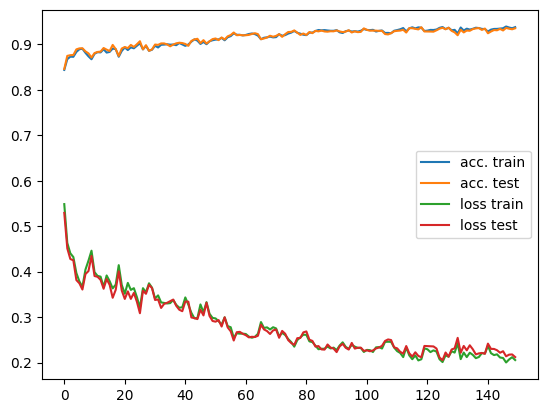

In [ ]:

def init_model(nx, nh, ny, eta):

    model = torch.nn.Sequential(
        torch.nn.Linear(nx,nh),
        torch.nn.Tanh(),
        torch.nn.Linear(nh,ny),
    )
    loss = torch.nn.CrossEntropyLoss()
    optim = torch.optim.SGD(model.parameters(),lr=eta)

    return model, loss, optim

data = MNISTData()
N = data.Xtrain.shape[0]
Nbatch = 100
nx = data.Xtrain.shape[1]
nh = 100
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss, optim = init_model(nx, nh, ny, eta)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        pred = model(X)
        l_value = loss(pred, Y)
        optim.zero_grad()
        l_value.backward()
        optim.step()

    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)

    title = 'Iter {}: Acc train {:.2f}% ({:.2f}), acc test {:.2f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 6: Bonus: SVM


Train a SVM model on the Circles dataset.

Ideas :
- First try a linear SVM (sklearn.svm.LinearSVC dans scikit-learn). Does it work well ? Why ?
- Then try more complex kernels (sklearn.svm.SVC). Which one is the best ? why ?
- Does the parameter C of regularization have an impact? Why ?

In [ ]:
# data
data = CirclesData()
Xtrain = data.Xtrain.numpy()
Ytrain = data.Ytrain[:, 0].numpy()

Xgrid = data.Xgrid.numpy()

Xtest = data.Xtest.numpy()
Ytest = data.Ytest[:, 0].numpy()

def plot_svm_predictions(data, predictions, title):
      plt.figure(2)
      plt.clf()
      plt.title(title)
      plt.imshow(np.reshape(predictions, (40,40)))
      plt.plot(data._Xtrain[data._Ytrain[:,0] == 1,0]*10+20, data._Xtrain[data._Ytrain[:,0] == 1,1]*10+20, 'bo', label="Train")
      plt.plot(data._Xtrain[data._Ytrain[:,1] == 1,0]*10+20, data._Xtrain[data._Ytrain[:,1] == 1,1]*10+20, 'ro')
      plt.plot(data._Xtest[data._Ytest[:,0] == 1,0]*10+20, data._Xtest[data._Ytest[:,0] == 1,1]*10+20, 'b+', label="Test")
      plt.plot(data._Xtest[data._Ytest[:,1] == 1,0]*10+20, data._Xtest[data._Ytest[:,1] == 1,1]*10+20, 'r+')
      plt.xlim(0,39)
      plt.ylim(0,39)
      plt.clim(0.3,0.7)
      plt.draw()
      plt.pause(1e-3)

In [ ]:
import sklearn.svm
from sklearn.metrics import classification_report


In [ ]:
def test_svm(svm, title):
    svm.fit(Xtrain, Ytrain)
    Ytest_pred = svm.predict(Xtest)
    accuracy = np.sum(Ytest == Ytest_pred) / len(Ytest)
    print(f"Accuracy : {100 * accuracy:.2f}")
    Ygrid_pred = svm.predict(Xgrid)
    plot_svm_predictions(data, Ygrid_pred, title=title)

Accuracy : 53.00


/opt/homebrew/Caskroom/miniforge/base/envs/datascience/lib/python3.10/site-packages/sklearn/svm/_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


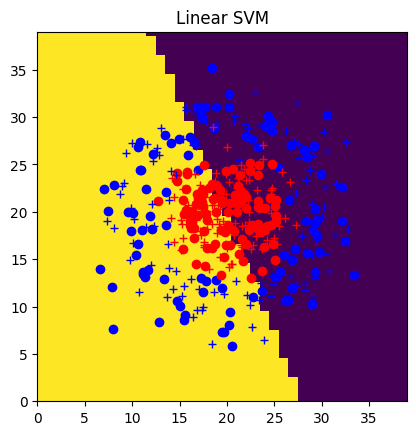

In [ ]:
svm = sklearn.svm.LinearSVC()
test_svm(svm, 'Linear SVM')

Accuracy : 94.00


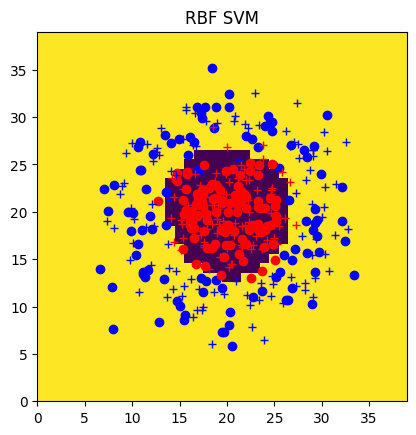

In [ ]:
svm = sklearn.svm.SVC(kernel='rbf')
test_svm(svm, 'RBF SVM')

Accuracy : 65.00


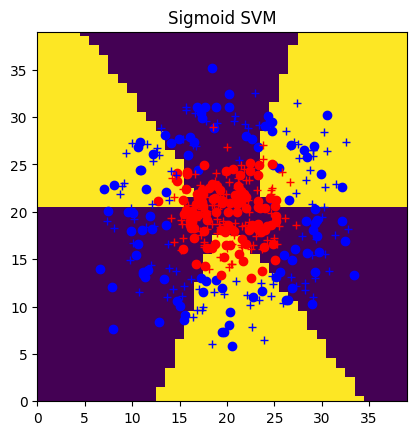

In [ ]:
svm = sklearn.svm.SVC(kernel='sigmoid')
test_svm(svm, 'Sigmoid SVM')

Accuracy : 62.00


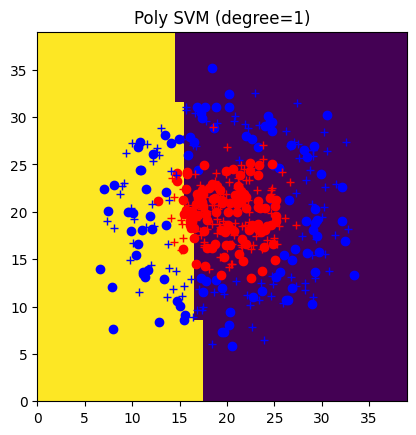

In [ ]:
svm = sklearn.svm.SVC(kernel='poly', degree=1)
test_svm(svm, 'Poly SVM (degree=1)')

Accuracy : 95.50


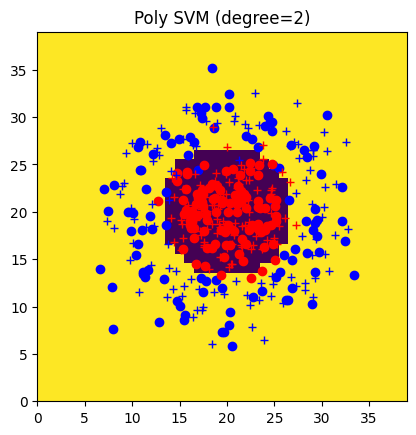

In [ ]:
svm = sklearn.svm.SVC(kernel='poly', degree=2)
test_svm(svm, 'Poly SVM (degree=2)')

Accuracy : 54.50


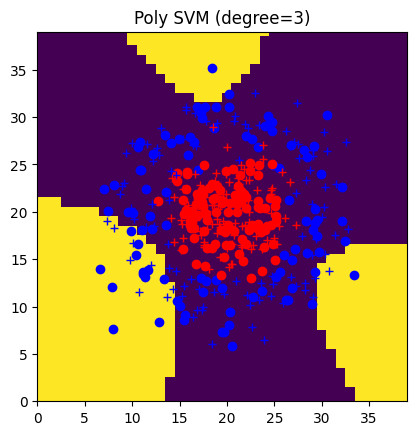

In [ ]:
svm = sklearn.svm.SVC(kernel='poly', degree=3)
test_svm(svm, 'Poly SVM (degree=3)')

Accuracy : 95.00


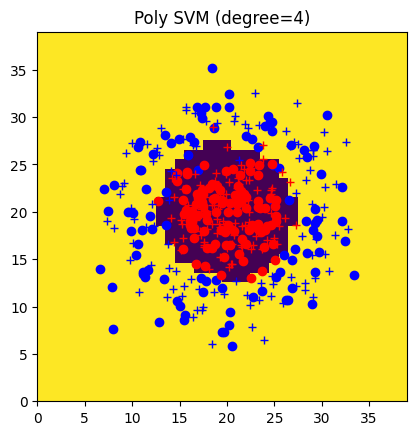

In [ ]:
svm = sklearn.svm.SVC(kernel='poly', degree=4)
test_svm(svm, 'Poly SVM (degree=4)')

Accuracy : 59.50


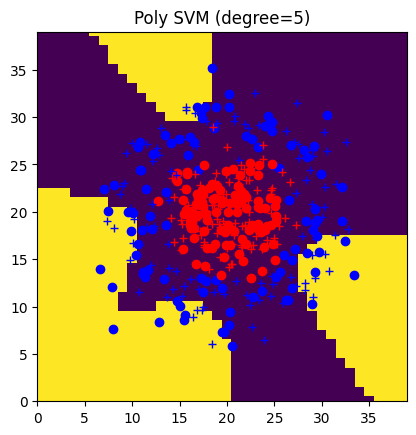

In [ ]:
svm = sklearn.svm.SVC(kernel='poly', degree=5)
test_svm(svm, 'Poly SVM (degree=5)')

Accuracy : 95.50


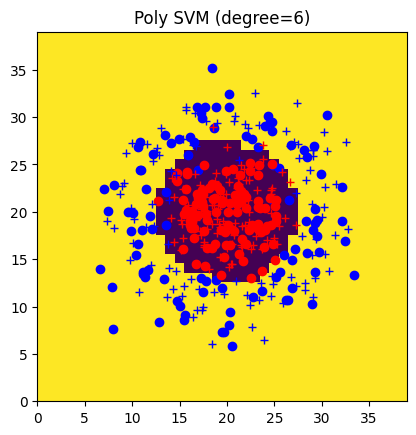

In [ ]:
svm = sklearn.svm.SVC(kernel='poly', degree=6)
test_svm(svm, 'Poly SVM (degree=6)')

Accuracy : 96.00


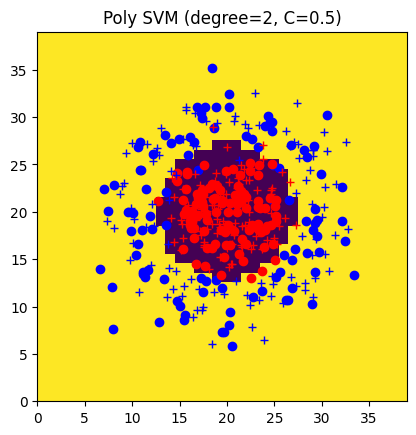

In [ ]:
svm = sklearn.svm.SVC(kernel='poly', degree=2, C=0.5)
test_svm(svm, 'Poly SVM (degree=2, C=0.5)')

Accuracy : 95.50


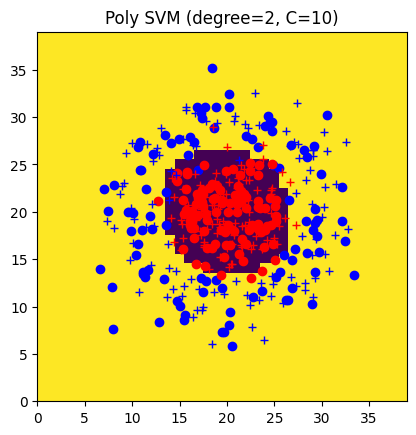

In [ ]:
svm = sklearn.svm.SVC(kernel='poly', degree=2, C=2)
test_svm(svm, 'Poly SVM (degree=2, C=10)')

Accuracy with C=0.001: 95.00%
Accuracy with C=0.01: 95.00%
Accuracy with C=0.02: 95.00%
Accuracy with C=0.05: 95.00%
Accuracy with C=0.1: 95.00%
Accuracy with C=0.2: 95.00%
Accuracy with C=0.3: 95.00%
Accuracy with C=0.5: 95.50%
Accuracy with C=0.7: 94.50%
Accuracy with C=1: 94.00%
Accuracy with C=10: 93.50%
Accuracy with C=100: 93.00%
Accuracy with C=1000: 93.00%


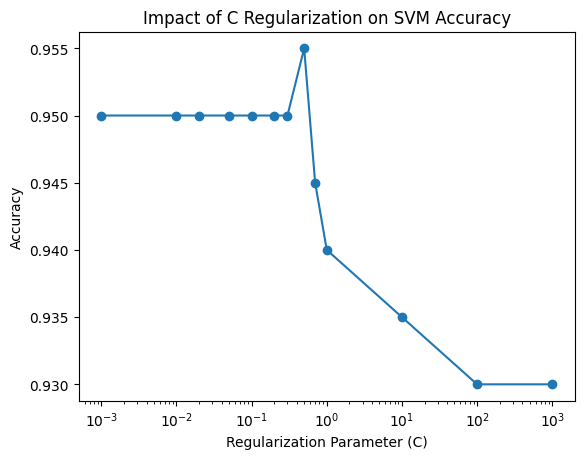

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import sklearn.svm

# Function to visualize the SVM decision boundaries and classification results
def plot_svm_predictions(data, predictions, title):
    plt.figure()
    plt.title(title)
    plt.imshow(np.reshape(predictions, (40, 40)), extent=(0, 39, 0, 39), origin='lower', cmap='coolwarm', alpha=0.6)
    plt.plot(data._Xtrain[data._Ytrain[:, 0] == 1, 0] * 10 + 20, data._Xtrain[data._Ytrain[:, 0] == 1, 1] * 10 + 20, 'bo', label="Train Class 1")
    plt.plot(data._Xtrain[data._Ytrain[:, 1] == 1, 0] * 10 + 20, data._Xtrain[data._Ytrain[:, 1] == 1, 1] * 10 + 20, 'ro', label="Train Class 2")
    plt.plot(data._Xtest[data._Ytest[:, 0] == 1, 0] * 10 + 20, data._Xtest[data._Ytest[:, 0] == 1, 1] * 10 + 20, 'b+', label="Test Class 1")
    plt.plot(data._Xtest[data._Ytest[:, 1] == 1, 0] * 10 + 20, data._Xtest[data._Ytest[:, 1] == 1, 1] * 10 + 20, 'r+', label="Test Class 2")
    plt.xlim(0, 39)
    plt.ylim(0, 39)
    plt.colorbar(label="Decision boundary")
    plt.legend()
    plt.show()

# Function to train and evaluate SVM with a specific C value and return accuracy
def test_svm_with_C(C_value):
    svm = sklearn.svm.SVC(C=C_value, kernel='rbf')  # Linear SVM
    svm.fit(Xtrain, Ytrain)
    Ytest_pred = svm.predict(Xtest)
    accuracy = np.sum(Ytest == Ytest_pred) / len(Ytest)
    print(f"Accuracy with C={C_value}: {100 * accuracy:.2f}%")
    Ygrid_pred = svm.predict(Xgrid)
    # plot_svm_predictions(data, Ygrid_pred, title=f"SVM Decision Boundary with C={C_value}")
    return accuracy

# List to store accuracy results
C_values = [0.001, 0.01, 0.02, 0.05, 0.1, 0.2, 0.3, 0.5, 0.7, 1, 10, 100, 1000]  # Different values of C to test
accuracies = []

# Evaluate and store the accuracy for each C value
for C in C_values:
    accuracy = test_svm_with_C(C)
    accuracies.append(accuracy)

# Plotting the accuracy as a function of C
plt.figure()
plt.plot(C_values, accuracies, marker='o')
plt.xscale('log')  # Use logarithmic scale for C axis for better visualization
plt.xlabel("Regularization Parameter (C)")
plt.ylabel("Accuracy")
plt.title("Impact of C Regularization on SVM Accuracy")
plt.show()
